In [2]:
from tqdm import tqdm, trange
from copy import deepcopy

import matplotlib.pyplot as plt
from matplotlib import gridspec
import numpy as np
import scipy as sp
import time
import sys
import importlib
import os
import hashlib
import subprocess
import gc

from IPython import display
from IPython.display import clear_output
import copy
from copy import deepcopy
from sklearn.metrics import roc_auc_score, roc_curve

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset

from captum.attr import IntegratedGradients
from captum.attr import LayerConductance
from captum.attr import NeuronConductance

try:
    import cPickle as pickle
except:
    import pickle
    
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:80% !important; }</style>"))

super_folder="/home/ykhalak/Projects/ML_dG/pde2_dG/generators/structures/set_4"
pocket_fit_folder=f"{super_folder}/morphing_annealing_4d09_filtered_subset/"
folder=f"{pocket_fit_folder}/prediction_step_2/"
step2_db_file=f"{pocket_fit_folder}/ddG_step_2_sigmahole_scaled_dummy_masses/stable_ligs.pickle"
all_ligs_db_file=f"{pocket_fit_folder}/filtered_subset_without_weird_chemistry_with_2D_no_core_tSNE_and_step2_dG.pickle"

settings_folder=folder+"/meta_param_search/settings/"
os.makedirs(settings_folder, exist_ok=True)


Bohr2Ang=0.529177249
RT=0.001985875*300 #kcal/mol

import sys
#sys.path.insert(0, folder)
#sys.path.insert(0, f"{pocket_fit_folder}/prediction_step_0/")
sys.path.append(folder)
sys.path.append(f"{pocket_fit_folder}/prediction_step_0/")

# debug

In [ ]:
# p_mask=np.array([[0,1,0,4],[2,3,7,4],[1,6,0,4]])
# p_mask = np.logical_and(np.logical_and(p_mask[0], p_mask[1]), p_mask[2]) # bundle mask for all axis together
# print(p_mask)

In [ ]:
# import h5py
# X=[]
# with h5py.File(pocket_fit_folder+'/2D_repr_no_core.hdf5', "r") as hdf:
#     l=hdf['2D/set4_0'][:]
#     print(type(l))

In [ ]:
# import oddt
# from oddt import toolkit, fingerprints, interactions

# protein=next(toolkit.readfile( 'pdb', f"{pocket_fit_folder}/data/setup/prot.pdb"))
# protein.protein = True

# #ligand=next(toolkit.oddt.toolkits.rdk.Molecule( set_0_ligs[0] ))
# ligand=toolkit.readstring('pdb', Chem.rdmolfiles.MolToPDBBlock(set_0_ligs[0]))
# IFP = fingerprints.InteractionFingerprint( ligand, protein)
# print(IFP)
# print(IFP.shape)

In [ ]:
# DS.no_core_PLEC_contact_filter

In [ ]:
# set_0_ligs[0].GetProp("[Q] hPDE2_pIC50")

# Define representation blocks

In [3]:
if 'custom_dataset_modular_with_binning' in sys.modules:
    importlib.reload(sys.modules['custom_dataset_modular_with_binning'])
else:
    import custom_dataset_modular_with_binning
from custom_dataset_modular_with_binning import dataBlocks, CustomMolModularDataset

base_flags=[dataBlocks.MACCS, dataBlocks.Descriptors, dataBlocks.EState_FP, dataBlocks.Graph_desc, dataBlocks.Pharmacophore_feature_map]
extras_flags=[dataBlocks.MOE, dataBlocks.MQN, dataBlocks.GETAWAY, dataBlocks.AUTOCORR2D,
              dataBlocks.AUTOCORR3D, dataBlocks.BCUT2D, dataBlocks.WHIM, dataBlocks.RDF,
              dataBlocks.USR, dataBlocks.USRCUT, dataBlocks.PEOE_VSA, dataBlocks.SMR_VSA,
              dataBlocks.SlogP_VSA, dataBlocks.MORSE]
flags_2D=[dataBlocks.MACCS, dataBlocks.Descriptors, dataBlocks.Graph_desc, dataBlocks.BCUT2D]
flags_3D=[dataBlocks.EState_FP, dataBlocks.Pharmacophore_feature_map,
          dataBlocks.MOE, dataBlocks.MQN, dataBlocks.GETAWAY, dataBlocks.AUTOCORR2D,
          dataBlocks.AUTOCORR3D, dataBlocks.WHIM, dataBlocks.RDF,
          dataBlocks.USR, dataBlocks.USRCUT, dataBlocks.PEOE_VSA, dataBlocks.SMR_VSA,
          dataBlocks.SlogP_VSA, dataBlocks.MORSE]

no_core_base_flags=[dataBlocks.no_core_MACCS, dataBlocks.no_core_Descriptors, dataBlocks.no_core_EState_FP, dataBlocks.no_core_Graph_desc, dataBlocks.no_core_Pharmacophore_feature_map]
no_core_extras_flags=[dataBlocks.no_core_MOE, dataBlocks.no_core_MQN, dataBlocks.no_core_GETAWAY, dataBlocks.no_core_AUTOCORR2D,
              dataBlocks.no_core_AUTOCORR3D, dataBlocks.no_core_BCUT2D, dataBlocks.no_core_WHIM, dataBlocks.no_core_RDF,
              dataBlocks.no_core_USR, dataBlocks.no_core_USRCUT, dataBlocks.no_core_PEOE_VSA, dataBlocks.no_core_SMR_VSA,
              dataBlocks.no_core_SlogP_VSA, dataBlocks.no_core_MORSE]
no_core_flags_2D=[dataBlocks.no_core_MACCS, dataBlocks.no_core_Descriptors, dataBlocks.no_core_Graph_desc, dataBlocks.no_core_BCUT2D]
no_core_flags_3D=[dataBlocks.no_core_EState_FP, dataBlocks.no_core_Pharmacophore_feature_map,
          dataBlocks.no_core_MOE, dataBlocks.no_core_MQN,
          # dataBlocks.no_core_GETAWAY, 
          dataBlocks.no_core_AUTOCORR2D,
          dataBlocks.no_core_AUTOCORR3D, dataBlocks.no_core_WHIM, dataBlocks.no_core_RDF,
          #dataBlocks.no_core_USR, dataBlocks.no_core_USRCUT,
          dataBlocks.no_core_PEOE_VSA, dataBlocks.no_core_SMR_VSA,
          dataBlocks.no_core_SlogP_VSA, dataBlocks.no_core_MORSE]

# prepare settings

In [4]:
normalize_x=True
shuffle_seed=12345678

n_Epochs=2000
hl_w=300
hl_depth=2
init_learning_rate=5e-3
learning_rate_decay=10000 #order of magnitude in this many epochs
weight_decay=1e-3

normalize_x=True
X_filter=None
impfilt=None

#impfilt=0.0075
#impfilt=0.01
#X_filter=folder+"/models/MACCS_w_desc2featmap_ESP_full_grid_w_atom_hot/known_1044_width_120_depth_2_trd_0_wd_0.001_norm_X/"+f"/Xfilter_importance_over_{impfilt}.pickle"
#X_filter="/home/ykhalak/Projects/ML_dG/pde2_dG/how_do_ligs_fit_in_pocket/adaptive_learning_test_from_morphed_structs/models/MACCS_w_desc2featmap_w_extras/known_2088_width_120_depth_2_trd_10000_wd_0.001_norm_X_weightedbyY_dropout0.5_shiftY/"+f"/Xfilter_importance_over_{impfilt}.pickle"

# h="82602"
# impfilt=f"hash_{h}"
# combined_filter_folder=folder+"models/MACCS_w_desc2featmap_ESP_full_grid_w_atom_hot_w_extras/"
# X_filter=combined_filter_folder+f"/Xfilter_combined_hash_{h}.pickle"
# if(not os.path.exists(X_filter)):
#     raise(Exception(f"No such file: {X_filter}"))

weighted=True
use_dropout=True
shiftY=True



# settings=[
#     representation_flags, dr_name, normalize_x, shuffle_seed,
#     n_Epochs, hl_w, hl_depth, init_learning_rate, learning_rate_decay, weight_decay,
#     impfilt, X_filter,
#     weighted, shiftY, use_dropout
# ]

# scan through representations individually (using the 99 step_1 ddG ligs)
and without caching

In [5]:
with open(step2_db_file, 'rb') as f:
    step2_ligs = pickle.load(f)

# Scan through represenatations individaually

### full ligs

In [6]:
normalize_x=True
shuffle_seed=12345678

n_Epochs=20000
#hl_w=300
hl_w=10
hl_depth=2
init_learning_rate=5e-3
learning_rate_decay=10000 #order of magnitude in this many epochs
weight_decay=1e-3

normalize_x=True
X_filter=None
impfilt=None

weighted=True    
use_dropout=True
shiftY=True

redo=False

block_names_full=["2D_3D", "PLEC_filtered", "MDenerg", "MDenerg_long_cut", "MDenerg_binned", "MDenerg_long_cut_binned", "atom_hot", "atom_hot_surf"]
import itertools
l = [False, True]
combs=list(itertools.product(l, repeat=len(block_names_full)))
print(len(combs))
#raise()

for c in combs:
    b_2D_3D, b_PLEC_filt, b_MDenerg, b_MDenerg_lc, b_MDenerg_binned, b_MDenerg_lc_binned, b_ah, b_ah_vdw = c
    if np.count_nonzero(c)==0:
        continue # skip the case with no active reperesenations
        
    if(b_ah and b_ah_vdw):
        continue # skip if both atom hot forms are active

    representation_flags=[0]*len(dataBlocks)
    
    nMDenerg_repr=0
    nah_repr=0
    ntot_repr=0
    
    if(b_2D_3D):
        for b in flags_2D:
            representation_flags[int(b)]=1
        for b in flags_3D:
            representation_flags[int(b)]=1
        ntot_repr+=1
    if(b_PLEC_filt):
        representation_flags[int(dataBlocks.PLEC_filtered)]=1
        ntot_repr+=1
    if(b_MDenerg):
        representation_flags[int(dataBlocks.MDenerg)]=1
        nMDenerg_repr+=1
        ntot_repr+=1
    if(b_MDenerg_lc):
        representation_flags[int(dataBlocks.MDenerg_longcut)]=1
        nMDenerg_repr+=1
        ntot_repr+=1
    if(b_MDenerg_binned):
        representation_flags[int(dataBlocks.MDenerg_binned)]=1
        nMDenerg_repr+=1
        ntot_repr+=1
    if(b_MDenerg_lc_binned):
        representation_flags[int(dataBlocks.MDenerg_longcut_binned)]=1
        nMDenerg_repr+=1
        ntot_repr+=1
    if(b_ah):
        representation_flags[int(dataBlocks.atom_hot)]=1
        nah_repr+=1
        ntot_repr+=1
    if(b_ah_vdw):
        representation_flags[int(dataBlocks.atom_hot_on_vdw_surf)]=1
        nah_repr+=1
        ntot_repr+=1
        
    if(nMDenerg_repr>1 or nah_repr>1):
        continue
    if(ntot_repr>1):
        continue

    dr_name=""
#     for i in range(len(representation_flags)):
#         if representation_flags[i]:
#             dr_name+=dataBlocks(i).name+'_'
    for i in range(len(c)):
        if c[i]:
            dr_name+=block_names_full[i]+'_'
    dr_name=dr_name[:-1]
    
    settings=[
        representation_flags, dr_name, normalize_x, shuffle_seed,
        n_Epochs, hl_w, hl_depth, init_learning_rate, learning_rate_decay, weight_decay,
        impfilt, X_filter,
        weighted, shiftY, use_dropout
        ]
    
    
    sha = hashlib.sha256()
    sha.update(pickle.dumps(settings))
    settings_hash=dr_name+"_"+sha.hexdigest()[:10]

    settings_fname=settings_folder+f"{settings_hash}.pickle"
    if(os.path.exists(settings_fname)):
        with open(settings_fname, 'rb') as f:
            settings_loaded, metrics = pickle.load(f)
            if(metrics is not None and not redo):
                print(f"{settings_fname} is already trained.")
            else:
                print(f"{settings_fname} exists but is not trained yet.")
    else:
        pickle.dump( (settings, None), open( settings_fname, "wb" ) )

256


### R-Groups

In [7]:
normalize_x=True
shuffle_seed=12345678

n_Epochs=20000
#hl_w=300
hl_w=10
hl_depth=2
init_learning_rate=5e-3
learning_rate_decay=10000 #order of magnitude in this many epochs
weight_decay=1e-3

normalize_x=True
X_filter=None
impfilt=None

weighted=True    
use_dropout=True
shiftY=True

redo=False

block_names_no_core=["no_core_2D_3D", "no_core_PLEC_filtered", "no_core_MDenerg",
                     "no_core_MDenerg_long_cut", "no_core_MDenerg_binned",
                     "no_core_MDenerg_long_cut_binned",
                     "no_core_atom_hot", "no_core_atom_hot_surf"]
import itertools
l = [False, True]
combs=list(itertools.product(l, repeat=len(block_names_no_core)))
print(len(combs))
#raise()

for c in combs:
    b_2D_3D, b_PLEC_filt, b_MDenerg, b_MDenerg_lc, b_MDenerg_binned, b_MDenerg_lc_binned, b_ah, b_ah_vdw = c
    if np.count_nonzero(c)==0:
        continue # skip the case with no active reperesenations
        
    if(b_ah and b_ah_vdw):
        continue # skip if both atom hot forms are active

    representation_flags=[0]*len(dataBlocks)
    
    nMDenerg_repr=0
    nah_repr=0
    ntot_repr=0
    
    if(b_2D_3D):
        for b in no_core_flags_2D:
            representation_flags[int(b)]=1
        for b in no_core_flags_3D:
            representation_flags[int(b)]=1
        ntot_repr+=1
    if(b_PLEC_filt):
        representation_flags[int(dataBlocks.no_core_PLEC_filtered)]=1
        ntot_repr+=1
    if(b_MDenerg):
        representation_flags[int(dataBlocks.no_core_MDenerg)]=1
        nMDenerg_repr+=1
        ntot_repr+=1
    if(b_MDenerg_lc):
        representation_flags[int(dataBlocks.no_core_MDenerg_longcut)]=1
        nMDenerg_repr+=1
        ntot_repr+=1
    if(b_MDenerg_binned):
        representation_flags[int(dataBlocks.no_core_MDenerg_binned)]=1
        nMDenerg_repr+=1
        ntot_repr+=1
    if(b_MDenerg_lc_binned):
        representation_flags[int(dataBlocks.no_core_MDenerg_longcut_binned)]=1
        nMDenerg_repr+=1
        ntot_repr+=1
    if(b_ah):
        representation_flags[int(dataBlocks.no_core_atom_hot)]=1
        nah_repr+=1
        ntot_repr+=1
    if(b_ah_vdw):
        representation_flags[int(dataBlocks.no_core_atom_hot_on_vdw_surf)]=1
        nah_repr+=1
        ntot_repr+=1
        
    if(nMDenerg_repr>1 or nah_repr>1):
        continue
    if(ntot_repr>1):
        continue

    dr_name=""
#     for i in range(len(representation_flags)):
#         if representation_flags[i]:
#             dr_name+=dataBlocks(i).name+'_'
    for i in range(len(c)):
        if c[i]:
            dr_name+=block_names_no_core[i]+'_'
    dr_name=dr_name[:-1]
    
    settings=[
        representation_flags, dr_name, normalize_x, shuffle_seed,
        n_Epochs, hl_w, hl_depth, init_learning_rate, learning_rate_decay, weight_decay,
        impfilt, X_filter,
        weighted, shiftY, use_dropout
        ]
    
    
    sha = hashlib.sha256()
    sha.update(pickle.dumps(settings))
    settings_hash=dr_name+"_"+sha.hexdigest()[:10]

    settings_fname=settings_folder+f"{settings_hash}.pickle"
    if(os.path.exists(settings_fname)):
        with open(settings_fname, 'rb') as f:
            settings_loaded, metrics = pickle.load(f)
            if(metrics is not None and not redo):
                print(f"{settings_fname} is already trained.")
            else:
                print(f"{settings_fname} exists but is not trained yet.")
    else:
        pickle.dump( (settings, None), open( settings_fname, "wb" ) )

256


# import training script

In [11]:
if 'owl_trainer_w_params_step_2' in sys.modules:
    importlib.reload(sys.modules['owl_trainer_w_params_step_2'])
else:
    import owl_trainer_w_params_step_2
from owl_trainer_w_params_step_2 import *

# Run locally

100%|██████████| 16/16 [00:00<00:00, 950.32it/s]

previously_done: 1 	 out of: 16
settings left: 15 	 # workers: 15 	 # settings/worker: 1




Representation is: atom_hot


# of training ligands found: 297 2022-01-25 13:05:59.803029
# starting ligands: 297 2022-01-25 13:05:59.920460
Finished setting up weights 2022-01-25 13:05:59.921481
Building the internal_filtered_cache needs 2771.6063385009766 MB, more than the 512.0 MB limit. SKIPPING and will read samples from HDD each time instead.
Found normalization factors across all ligands 2022-01-25 13:06:58.594050
Start setting up models 2022-01-25 13:06:58.594844
Finished setup for model 0 2022-01-25 13:06:58.931020
Finished setup for model 1 2022-01-25 13:06:59.053842
Finished setup for model 2 2022-01-25 13:06:59.166480
Finished setup for model 3 2022-01-25 13:06:59.283236
Finished setup for model 4 2022-01-25 13:06:59.393628
Training for 20000 epochs 2022-01-25 13:06:59.393742
	Epoch: 0	 train_loss=4.946348714828491	 XVal_RMSE=7.6681671142578125
	Epoch: 9	 train_loss=2.2765397787094117	 XVal_RMSE=5.07833194732666
	Epoch: 19	 train_loss=1.442217218875885	 XVal_RMSE=4.275228500366211
	Epoch: 29	 train_loss

	Epoch: 1019	 train_loss=0.12255441248416901	 XVal_RMSE=2.8476507663726807
	Epoch: 1029	 train_loss=0.12030850499868392	 XVal_RMSE=2.844027519226074
	Epoch: 1039	 train_loss=0.13091813027858734	 XVal_RMSE=2.83137845993042
	Epoch: 1049	 train_loss=0.1219710186123848	 XVal_RMSE=2.839871883392334
	Epoch: 1059	 train_loss=0.13321270942687988	 XVal_RMSE=2.843113660812378
	Epoch: 1069	 train_loss=0.11959179639816284	 XVal_RMSE=2.8276889324188232
	Epoch: 1079	 train_loss=0.12231640219688415	 XVal_RMSE=2.8302295207977295
	Epoch: 1089	 train_loss=0.11574811190366745	 XVal_RMSE=2.8236827850341797
	Epoch: 1099	 train_loss=0.1179663896560669	 XVal_RMSE=2.8280632495880127
	Epoch: 1109	 train_loss=0.126591232419014	 XVal_RMSE=2.8245632648468018
	Epoch: 1119	 train_loss=0.12164788246154785	 XVal_RMSE=2.824537515640259
	Epoch: 1129	 train_loss=0.13099177330732345	 XVal_RMSE=2.81489634513855
	Epoch: 1139	 train_loss=0.1274792566895485	 XVal_RMSE=2.8127641677856445
	Epoch: 1149	 train_loss=0.12886167317

	Epoch: 2119	 train_loss=0.10994343906641006	 XVal_RMSE=2.7007851600646973
	Epoch: 2129	 train_loss=0.10936367809772492	 XVal_RMSE=2.6934309005737305
	Epoch: 2139	 train_loss=0.11043449193239212	 XVal_RMSE=2.692983865737915
	Epoch: 2149	 train_loss=0.1048022523522377	 XVal_RMSE=2.696634531021118
	Epoch: 2159	 train_loss=0.11273358017206192	 XVal_RMSE=2.689068555831909
	Epoch: 2169	 train_loss=0.10786120593547821	 XVal_RMSE=2.695280075073242
	Epoch: 2179	 train_loss=0.10225345641374588	 XVal_RMSE=2.6903460025787354
	Epoch: 2189	 train_loss=0.10724775940179825	 XVal_RMSE=2.6901912689208984
	Epoch: 2199	 train_loss=0.10723123252391815	 XVal_RMSE=2.6902854442596436
	Epoch: 2209	 train_loss=0.10668281763792038	 XVal_RMSE=2.691201686859131
	Epoch: 2219	 train_loss=0.10592240393161774	 XVal_RMSE=2.688100576400757
	Epoch: 2229	 train_loss=0.10684229135513305	 XVal_RMSE=2.6895599365234375
	Epoch: 2239	 train_loss=0.10373819470405579	 XVal_RMSE=2.688455820083618
	Epoch: 2249	 train_loss=0.100850

	Epoch: 3219	 train_loss=0.0992244653403759	 XVal_RMSE=2.611098051071167
	Epoch: 3229	 train_loss=0.09302526265382767	 XVal_RMSE=2.6125662326812744
	Epoch: 3239	 train_loss=0.09477708861231804	 XVal_RMSE=2.608827829360962
	Epoch: 3249	 train_loss=0.09316703453660011	 XVal_RMSE=2.609917402267456
	Epoch: 3259	 train_loss=0.09051119759678841	 XVal_RMSE=2.6102113723754883
	Epoch: 3269	 train_loss=0.09473810493946075	 XVal_RMSE=2.609020948410034
	Epoch: 3279	 train_loss=0.0931527242064476	 XVal_RMSE=2.6073806285858154
	Epoch: 3289	 train_loss=0.09677086248993874	 XVal_RMSE=2.6109378337860107
	Epoch: 3299	 train_loss=0.09805186316370965	 XVal_RMSE=2.607334852218628
	Epoch: 3309	 train_loss=0.10269740372896194	 XVal_RMSE=2.60811448097229
	Epoch: 3319	 train_loss=0.08839336484670639	 XVal_RMSE=2.6073272228240967
	Epoch: 3329	 train_loss=0.0953173279762268	 XVal_RMSE=2.6063551902770996
	Epoch: 3339	 train_loss=0.09430728480219841	 XVal_RMSE=2.6062920093536377
	Epoch: 3349	 train_loss=0.08927232

	Epoch: 4319	 train_loss=0.08877175822854041	 XVal_RMSE=2.5582919120788574
	Epoch: 4329	 train_loss=0.08723905012011528	 XVal_RMSE=2.5593674182891846
	Epoch: 4339	 train_loss=0.08867042735219002	 XVal_RMSE=2.5591893196105957
	Epoch: 4349	 train_loss=0.08570372238755226	 XVal_RMSE=2.555631399154663
	Epoch: 4359	 train_loss=0.09125129133462906	 XVal_RMSE=2.561056613922119
	Epoch: 4369	 train_loss=0.08566338941454887	 XVal_RMSE=2.555441379547119
	Epoch: 4379	 train_loss=0.08459587097167968	 XVal_RMSE=2.557249069213867
	Epoch: 4389	 train_loss=0.08780215755105018	 XVal_RMSE=2.5546000003814697
	Epoch: 4399	 train_loss=0.08643644973635674	 XVal_RMSE=2.556432008743286
	Epoch: 4409	 train_loss=0.09057382643222808	 XVal_RMSE=2.554295301437378
	Epoch: 4419	 train_loss=0.08446304872632027	 XVal_RMSE=2.555546998977661
	Epoch: 4429	 train_loss=0.0840125747025013	 XVal_RMSE=2.554985523223877
	Epoch: 4439	 train_loss=0.08494019657373428	 XVal_RMSE=2.5550615787506104
	Epoch: 4449	 train_loss=0.0851733

	Epoch: 5419	 train_loss=0.08156016021966934	 XVal_RMSE=2.523940086364746
	Epoch: 5429	 train_loss=0.07952325344085694	 XVal_RMSE=2.526682138442993
	Epoch: 5439	 train_loss=0.08040544018149376	 XVal_RMSE=2.525383472442627
	Epoch: 5449	 train_loss=0.08223223350942135	 XVal_RMSE=2.5258243083953857
	Epoch: 5459	 train_loss=0.08277378231287003	 XVal_RMSE=2.525425434112549
	Epoch: 5469	 train_loss=0.08116850256919861	 XVal_RMSE=2.525906562805176
	Epoch: 5479	 train_loss=0.08172581009566784	 XVal_RMSE=2.525972843170166
	Epoch: 5489	 train_loss=0.08544658794999123	 XVal_RMSE=2.525613307952881
	Epoch: 5499	 train_loss=0.08261396773159504	 XVal_RMSE=2.5234556198120117
	Epoch: 5509	 train_loss=0.08032299913465976	 XVal_RMSE=2.5244970321655273
	Epoch: 5519	 train_loss=0.08431250080466271	 XVal_RMSE=2.5231688022613525
	Epoch: 5529	 train_loss=0.08017511442303657	 XVal_RMSE=2.5226893424987793
	Epoch: 5539	 train_loss=0.08025015294551849	 XVal_RMSE=2.523477554321289
	Epoch: 5549	 train_loss=0.081253

	Epoch: 6519	 train_loss=0.08126328065991402	 XVal_RMSE=2.5079307556152344
	Epoch: 6529	 train_loss=0.07648750469088554	 XVal_RMSE=2.508417844772339
	Epoch: 6539	 train_loss=0.07858349233865738	 XVal_RMSE=2.5076744556427
	Epoch: 6549	 train_loss=0.07619277164340019	 XVal_RMSE=2.5066020488739014
	Epoch: 6559	 train_loss=0.07611848562955856	 XVal_RMSE=2.5065958499908447
	Epoch: 6569	 train_loss=0.07605991810560227	 XVal_RMSE=2.5072083473205566
	Epoch: 6579	 train_loss=0.07645296938717365	 XVal_RMSE=2.5060994625091553
	Epoch: 6589	 train_loss=0.07582111358642578	 XVal_RMSE=2.5063304901123047
	Epoch: 6599	 train_loss=0.0780018225312233	 XVal_RMSE=2.5057899951934814
	Epoch: 6609	 train_loss=0.07735931426286698	 XVal_RMSE=2.507892608642578
	Epoch: 6619	 train_loss=0.08062430024147034	 XVal_RMSE=2.5080578327178955
	Epoch: 6629	 train_loss=0.07890330702066421	 XVal_RMSE=2.506622314453125
	Epoch: 6639	 train_loss=0.07670296803116798	 XVal_RMSE=2.5078039169311523
	Epoch: 6649	 train_loss=0.07517

	Epoch: 7619	 train_loss=0.07470861338078975	 XVal_RMSE=2.500060796737671
	Epoch: 7629	 train_loss=0.07484799362719059	 XVal_RMSE=2.49981689453125
	Epoch: 7639	 train_loss=0.07595408633351326	 XVal_RMSE=2.5002338886260986
	Epoch: 7649	 train_loss=0.07448323555290699	 XVal_RMSE=2.498964548110962
	Epoch: 7659	 train_loss=0.07562546469271184	 XVal_RMSE=2.499321460723877
	Epoch: 7669	 train_loss=0.07454352416098117	 XVal_RMSE=2.4992079734802246
	Epoch: 7679	 train_loss=0.07556541860103608	 XVal_RMSE=2.500175714492798
	Epoch: 7689	 train_loss=0.07549028135836125	 XVal_RMSE=2.499699354171753
	Epoch: 7699	 train_loss=0.07590249180793762	 XVal_RMSE=2.498854875564575
	Epoch: 7709	 train_loss=0.07580948024988174	 XVal_RMSE=2.497957706451416
	Epoch: 7719	 train_loss=0.07709125839173794	 XVal_RMSE=2.5001306533813477
	Epoch: 7729	 train_loss=0.07342245876789093	 XVal_RMSE=2.4996895790100098
	Epoch: 7739	 train_loss=0.07447742447257041	 XVal_RMSE=2.4985604286193848
	Epoch: 7749	 train_loss=0.0769890

	Epoch: 8719	 train_loss=0.0733033325523138	 XVal_RMSE=2.493741273880005
	Epoch: 8729	 train_loss=0.07269270531833172	 XVal_RMSE=2.4941506385803223
	Epoch: 8739	 train_loss=0.07276553772389889	 XVal_RMSE=2.493715286254883
	Epoch: 8749	 train_loss=0.07120121642947197	 XVal_RMSE=2.4942924976348877
	Epoch: 8759	 train_loss=0.07244601510465146	 XVal_RMSE=2.493818521499634
	Epoch: 8769	 train_loss=0.07377689927816392	 XVal_RMSE=2.493330955505371
	Epoch: 8779	 train_loss=0.07313587293028831	 XVal_RMSE=2.4941298961639404
	Epoch: 8789	 train_loss=0.07303912751376629	 XVal_RMSE=2.4926891326904297
	Epoch: 8799	 train_loss=0.07377342022955417	 XVal_RMSE=2.492279291152954
	Epoch: 8809	 train_loss=0.07270928956568241	 XVal_RMSE=2.493724822998047
	Epoch: 8819	 train_loss=0.07241706475615502	 XVal_RMSE=2.49294114112854
	Epoch: 8829	 train_loss=0.0728830449283123	 XVal_RMSE=2.492917776107788
	Epoch: 8839	 train_loss=0.07341585829854011	 XVal_RMSE=2.493802309036255
	Epoch: 8849	 train_loss=0.0722992334

	Epoch: 9819	 train_loss=0.073113352060318	 XVal_RMSE=2.4883315563201904
	Epoch: 9829	 train_loss=0.07191074192523957	 XVal_RMSE=2.4871785640716553
	Epoch: 9839	 train_loss=0.07218655496835709	 XVal_RMSE=2.4882009029388428
	Epoch: 9849	 train_loss=0.07179103679955005	 XVal_RMSE=2.4879062175750732
	Epoch: 9859	 train_loss=0.07101001888513565	 XVal_RMSE=2.487361192703247
	Epoch: 9869	 train_loss=0.07008899897336959	 XVal_RMSE=2.4881200790405273
	Epoch: 9879	 train_loss=0.0703506026417017	 XVal_RMSE=2.4876465797424316
	Epoch: 9889	 train_loss=0.07181063331663609	 XVal_RMSE=2.488504409790039
	Epoch: 9899	 train_loss=0.07038689609616995	 XVal_RMSE=2.4883103370666504
	Epoch: 9909	 train_loss=0.07052158191800117	 XVal_RMSE=2.4879825115203857
	Epoch: 9919	 train_loss=0.07033754382282495	 XVal_RMSE=2.487966537475586
	Epoch: 9929	 train_loss=0.07070657536387444	 XVal_RMSE=2.487934112548828
	Epoch: 9939	 train_loss=0.0705945985391736	 XVal_RMSE=2.4879684448242188
	Epoch: 9949	 train_loss=0.071380

	Epoch: 10909	 train_loss=0.06968387495726347	 XVal_RMSE=2.484380006790161
	Epoch: 10919	 train_loss=0.0696418322622776	 XVal_RMSE=2.483797311782837
	Epoch: 10929	 train_loss=0.06893488969653845	 XVal_RMSE=2.483771562576294
	Epoch: 10939	 train_loss=0.06979057937860489	 XVal_RMSE=2.4835522174835205
	Epoch: 10949	 train_loss=0.06917142439633608	 XVal_RMSE=2.483815908432007
	Epoch: 10959	 train_loss=0.06861109808087348	 XVal_RMSE=2.483997344970703
	Epoch: 10969	 train_loss=0.06939507499337197	 XVal_RMSE=2.4837307929992676
	Epoch: 10979	 train_loss=0.06929683052003384	 XVal_RMSE=2.4840593338012695
	Epoch: 10989	 train_loss=0.06895674373954534	 XVal_RMSE=2.483635187149048
	Epoch: 10999	 train_loss=0.06885772198438644	 XVal_RMSE=2.4838345050811768
Epoch 10999. Backing up models.
	Epoch: 11009	 train_loss=0.06939623188227415	 XVal_RMSE=2.4838109016418457
	Epoch: 11019	 train_loss=0.06910850666463375	 XVal_RMSE=2.483748435974121
	Epoch: 11029	 train_loss=0.06887057609856129	 XVal_RMSE=2.48359

	Epoch: 11999	 train_loss=0.068542755022645	 XVal_RMSE=2.481088161468506
Epoch 11999. Backing up models.
	Epoch: 12009	 train_loss=0.06847293190658092	 XVal_RMSE=2.4809515476226807
	Epoch: 12019	 train_loss=0.06825245879590511	 XVal_RMSE=2.4808998107910156
	Epoch: 12029	 train_loss=0.06863177679479122	 XVal_RMSE=2.4808530807495117
	Epoch: 12039	 train_loss=0.06843424327671528	 XVal_RMSE=2.481180429458618
	Epoch: 12049	 train_loss=0.06863628458231688	 XVal_RMSE=2.481123924255371
	Epoch: 12059	 train_loss=0.06827933322638273	 XVal_RMSE=2.480806589126587
	Epoch: 12069	 train_loss=0.06822406277060508	 XVal_RMSE=2.4806275367736816
	Epoch: 12079	 train_loss=0.0688221262767911	 XVal_RMSE=2.480990409851074
	Epoch: 12089	 train_loss=0.06825144980102778	 XVal_RMSE=2.480713367462158
	Epoch: 12099	 train_loss=0.06872205771505832	 XVal_RMSE=2.480989933013916
	Epoch: 12109	 train_loss=0.06875222474336624	 XVal_RMSE=2.48063588142395
	Epoch: 12119	 train_loss=0.0685768697410822	 XVal_RMSE=2.4808397293

	Epoch: 13079	 train_loss=0.06871196124702691	 XVal_RMSE=2.478590965270996
	Epoch: 13089	 train_loss=0.06807819567620754	 XVal_RMSE=2.478691339492798
	Epoch: 13099	 train_loss=0.06812084559351206	 XVal_RMSE=2.4788105487823486
	Epoch: 13109	 train_loss=0.06802796311676503	 XVal_RMSE=2.478590965270996
	Epoch: 13119	 train_loss=0.06810000464320183	 XVal_RMSE=2.4788260459899902
	Epoch: 13129	 train_loss=0.06811503563076257	 XVal_RMSE=2.4789979457855225
	Epoch: 13139	 train_loss=0.06812616549432278	 XVal_RMSE=2.4783897399902344
	Epoch: 13149	 train_loss=0.06803699564188719	 XVal_RMSE=2.4789187908172607
	Epoch: 13159	 train_loss=0.06772282160818577	 XVal_RMSE=2.4790005683898926
	Epoch: 13169	 train_loss=0.06811281125992537	 XVal_RMSE=2.4784281253814697
	Epoch: 13179	 train_loss=0.0677589301019907	 XVal_RMSE=2.4787330627441406
	Epoch: 13189	 train_loss=0.06826983131468296	 XVal_RMSE=2.478827714920044
	Epoch: 13199	 train_loss=0.06811468452215194	 XVal_RMSE=2.478435516357422
	Epoch: 13209	 tra

	Epoch: 14169	 train_loss=0.06763875018805265	 XVal_RMSE=2.4772512912750244
	Epoch: 14179	 train_loss=0.0678776765242219	 XVal_RMSE=2.4775121212005615
	Epoch: 14189	 train_loss=0.06736442614346742	 XVal_RMSE=2.4771928787231445
	Epoch: 14199	 train_loss=0.06716077812016011	 XVal_RMSE=2.4772884845733643
	Epoch: 14209	 train_loss=0.06728315409272909	 XVal_RMSE=2.4773383140563965
	Epoch: 14219	 train_loss=0.06738021317869425	 XVal_RMSE=2.4771578311920166
	Epoch: 14229	 train_loss=0.06732644364237786	 XVal_RMSE=2.4770843982696533
	Epoch: 14239	 train_loss=0.06743259523063898	 XVal_RMSE=2.477269411087036
	Epoch: 14249	 train_loss=0.06715341545641422	 XVal_RMSE=2.4770445823669434
	Epoch: 14259	 train_loss=0.0675101637840271	 XVal_RMSE=2.477159261703491
	Epoch: 14269	 train_loss=0.06752424202859401	 XVal_RMSE=2.477198362350464
	Epoch: 14279	 train_loss=0.06730720810592175	 XVal_RMSE=2.4772703647613525
	Epoch: 14289	 train_loss=0.06747856251895427	 XVal_RMSE=2.4770314693450928
	Epoch: 14299	 tr

	Epoch: 15259	 train_loss=0.06684570908546447	 XVal_RMSE=2.4761476516723633
	Epoch: 15269	 train_loss=0.06666183304041624	 XVal_RMSE=2.4760594367980957
	Epoch: 15279	 train_loss=0.06677992697805166	 XVal_RMSE=2.476036310195923
	Epoch: 15289	 train_loss=0.0667843148112297	 XVal_RMSE=2.4761335849761963
	Epoch: 15299	 train_loss=0.06667470131069422	 XVal_RMSE=2.47605037689209
	Epoch: 15309	 train_loss=0.06679468750953674	 XVal_RMSE=2.475961923599243
	Epoch: 15319	 train_loss=0.06694655138999224	 XVal_RMSE=2.475961923599243
	Epoch: 15329	 train_loss=0.06670331805944443	 XVal_RMSE=2.476137638092041
	Epoch: 15339	 train_loss=0.06676947567611932	 XVal_RMSE=2.4758970737457275
	Epoch: 15349	 train_loss=0.06683018822222948	 XVal_RMSE=2.4760520458221436
	Epoch: 15359	 train_loss=0.06679075267165899	 XVal_RMSE=2.4759323596954346
	Epoch: 15369	 train_loss=0.06685203984379769	 XVal_RMSE=2.4760053157806396
	Epoch: 15379	 train_loss=0.06677364073693752	 XVal_RMSE=2.4758434295654297
	Epoch: 15389	 trai

	Epoch: 16349	 train_loss=0.06657098568975925	 XVal_RMSE=2.4751367568969727
	Epoch: 16359	 train_loss=0.06658641397953033	 XVal_RMSE=2.475027084350586
	Epoch: 16369	 train_loss=0.06677567046135664	 XVal_RMSE=2.474944829940796
	Epoch: 16379	 train_loss=0.0667636064812541	 XVal_RMSE=2.4750475883483887
	Epoch: 16389	 train_loss=0.06677012071013451	 XVal_RMSE=2.4750428199768066
	Epoch: 16399	 train_loss=0.06659233309328556	 XVal_RMSE=2.4749832153320312
	Epoch: 16409	 train_loss=0.06664467677474022	 XVal_RMSE=2.474976062774658
	Epoch: 16419	 train_loss=0.06664615087211131	 XVal_RMSE=2.474966049194336
	Epoch: 16429	 train_loss=0.0666972266510129	 XVal_RMSE=2.4749507904052734
	Epoch: 16439	 train_loss=0.06667635180056095	 XVal_RMSE=2.474907875061035
	Epoch: 16449	 train_loss=0.06658153571188449	 XVal_RMSE=2.4750447273254395
	Epoch: 16459	 train_loss=0.06663915682584047	 XVal_RMSE=2.4750750064849854
	Epoch: 16469	 train_loss=0.06652506291866303	 XVal_RMSE=2.4751031398773193
	Epoch: 16479	 trai

	Epoch: 17439	 train_loss=0.06646826602518559	 XVal_RMSE=2.4745380878448486
	Epoch: 17449	 train_loss=0.06649826504290104	 XVal_RMSE=2.4745092391967773
	Epoch: 17459	 train_loss=0.06650422550737858	 XVal_RMSE=2.4742918014526367
	Epoch: 17469	 train_loss=0.06629101615399122	 XVal_RMSE=2.474426031112671
	Epoch: 17479	 train_loss=0.06639021672308446	 XVal_RMSE=2.4745137691497803
	Epoch: 17489	 train_loss=0.06646727826446294	 XVal_RMSE=2.474310874938965
	Epoch: 17499	 train_loss=0.06641398128122092	 XVal_RMSE=2.4743947982788086
	Epoch: 17509	 train_loss=0.06657991744577885	 XVal_RMSE=2.474447727203369
	Epoch: 17519	 train_loss=0.0665139677003026	 XVal_RMSE=2.4742884635925293
	Epoch: 17529	 train_loss=0.06645768471062183	 XVal_RMSE=2.47440242767334
	Epoch: 17539	 train_loss=0.06647458411753178	 XVal_RMSE=2.474398374557495
	Epoch: 17549	 train_loss=0.06651686169207097	 XVal_RMSE=2.474287986755371
	Epoch: 17559	 train_loss=0.06635278575122357	 XVal_RMSE=2.4743735790252686
	Epoch: 17569	 train

	Epoch: 18529	 train_loss=0.06616106014698744	 XVal_RMSE=2.4738030433654785
	Epoch: 18539	 train_loss=0.06611846815794706	 XVal_RMSE=2.473804473876953
	Epoch: 18549	 train_loss=0.06613025683909654	 XVal_RMSE=2.473844051361084
	Epoch: 18559	 train_loss=0.06610131990164518	 XVal_RMSE=2.4738545417785645
	Epoch: 18569	 train_loss=0.0661322720348835	 XVal_RMSE=2.473914623260498
	Epoch: 18579	 train_loss=0.06620819568634033	 XVal_RMSE=2.473869800567627
	Epoch: 18589	 train_loss=0.06609990298748017	 XVal_RMSE=2.4739232063293457
	Epoch: 18599	 train_loss=0.06623281612992286	 XVal_RMSE=2.4738340377807617
	Epoch: 18609	 train_loss=0.06614104565232992	 XVal_RMSE=2.4738616943359375
	Epoch: 18619	 train_loss=0.06606178227812051	 XVal_RMSE=2.473860740661621
	Epoch: 18629	 train_loss=0.06609825864434242	 XVal_RMSE=2.473794460296631
	Epoch: 18639	 train_loss=0.06617446970194578	 XVal_RMSE=2.473865270614624
	Epoch: 18649	 train_loss=0.06612806934863329	 XVal_RMSE=2.4738500118255615
	Epoch: 18659	 train

	Epoch: 19619	 train_loss=0.06605996415019036	 XVal_RMSE=2.4734973907470703
	Epoch: 19629	 train_loss=0.06613519098609685	 XVal_RMSE=2.473483085632324
	Epoch: 19639	 train_loss=0.06609681788831949	 XVal_RMSE=2.4734835624694824
	Epoch: 19649	 train_loss=0.06606768406927585	 XVal_RMSE=2.4734349250793457
	Epoch: 19659	 train_loss=0.06609440688043833	 XVal_RMSE=2.4735124111175537
	Epoch: 19669	 train_loss=0.06608821041882038	 XVal_RMSE=2.473421812057495
	Epoch: 19679	 train_loss=0.06601139679551124	 XVal_RMSE=2.473470687866211
	Epoch: 19689	 train_loss=0.06605934873223304	 XVal_RMSE=2.4734416007995605
	Epoch: 19699	 train_loss=0.06608860921114683	 XVal_RMSE=2.4734764099121094
	Epoch: 19709	 train_loss=0.06595308016985654	 XVal_RMSE=2.473452091217041
	Epoch: 19719	 train_loss=0.06614318545907735	 XVal_RMSE=2.473524332046509
	Epoch: 19729	 train_loss=0.06607988160103559	 XVal_RMSE=2.473457098007202
	Epoch: 19739	 train_loss=0.0659811170771718	 XVal_RMSE=2.4734456539154053
	Epoch: 19749	 trai

	Epoch: 629	 train_loss=0.4521884858608246	 XVal_RMSE=3.7811763286590576
	Epoch: 639	 train_loss=0.4428613245487213	 XVal_RMSE=3.781822919845581
	Epoch: 649	 train_loss=0.45219455361366273	 XVal_RMSE=3.7731969356536865
	Epoch: 659	 train_loss=0.4369810402393341	 XVal_RMSE=3.781830310821533
	Epoch: 669	 train_loss=0.4304402232170105	 XVal_RMSE=3.793778896331787
	Epoch: 679	 train_loss=0.4284315645694733	 XVal_RMSE=3.8168656826019287
	Epoch: 689	 train_loss=0.43658549785614015	 XVal_RMSE=3.7874720096588135
	Epoch: 699	 train_loss=0.4333884298801422	 XVal_RMSE=3.82497239112854
	Epoch: 709	 train_loss=0.43939465284347534	 XVal_RMSE=3.804978132247925
	Epoch: 719	 train_loss=0.43018128275871276	 XVal_RMSE=3.78312611579895
	Epoch: 729	 train_loss=0.40997983813285827	 XVal_RMSE=3.8303654193878174
	Epoch: 739	 train_loss=0.40852733254432677	 XVal_RMSE=3.839210033416748
	Epoch: 749	 train_loss=0.41188315749168397	 XVal_RMSE=3.844302177429199
	Epoch: 759	 train_loss=0.40590639114379884	 XVal_RMSE

/home/ykhalak/Projects/ML_dG/pde2_dG/generators/structures/set_4/morphing_annealing_4d09_filtered_subset/prediction_step_2/owl_trainer_w_params_step_2.py:376: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig=plt.figure(figsize=(20,8))


Epoch 999. Backing up models.
	Epoch: 1009	 train_loss=0.33682372570037844	 XVal_RMSE=4.06561803817749
	Epoch: 1019	 train_loss=0.33602460026741027	 XVal_RMSE=4.083963871002197
	Epoch: 1029	 train_loss=0.33418709635734556	 XVal_RMSE=4.1112775802612305
	Epoch: 1039	 train_loss=0.3286004364490509	 XVal_RMSE=4.143950462341309
	Epoch: 1049	 train_loss=0.3353726267814636	 XVal_RMSE=4.121278762817383
	Epoch: 1059	 train_loss=0.32501267790794375	 XVal_RMSE=4.100072860717773
	Epoch: 1069	 train_loss=0.31467612385749816	 XVal_RMSE=4.130554676055908
	Epoch: 1079	 train_loss=0.3173530638217926	 XVal_RMSE=4.1719465255737305
	Epoch: 1089	 train_loss=0.31918134689331057	 XVal_RMSE=4.196301460266113
	Epoch: 1099	 train_loss=0.3023486971855164	 XVal_RMSE=4.1956400871276855
	Epoch: 1109	 train_loss=0.30090767443180083	 XVal_RMSE=4.217862129211426
	Epoch: 1119	 train_loss=0.30577830970287323	 XVal_RMSE=4.245609760284424
	Epoch: 1129	 train_loss=0.30463812947273256	 XVal_RMSE=4.222251892089844
	Epoch: 11

	Epoch: 2119	 train_loss=0.17798186838626862	 XVal_RMSE=4.763883590698242
	Epoch: 2129	 train_loss=0.17757265269756317	 XVal_RMSE=4.784266948699951
	Epoch: 2139	 train_loss=0.17473000586032866	 XVal_RMSE=4.769056797027588
	Epoch: 2149	 train_loss=0.18973381519317628	 XVal_RMSE=4.799299240112305
	Epoch: 2159	 train_loss=0.1952647626399994	 XVal_RMSE=4.764801502227783
	Epoch: 2169	 train_loss=0.1848854273557663	 XVal_RMSE=4.798104286193848
	Epoch: 2179	 train_loss=0.17767601311206818	 XVal_RMSE=4.798270225524902
	Epoch: 2189	 train_loss=0.1816059798002243	 XVal_RMSE=4.781699180603027
	Epoch: 2199	 train_loss=0.17980691492557527	 XVal_RMSE=4.787594318389893
	Epoch: 2209	 train_loss=0.17490891516208648	 XVal_RMSE=4.811069965362549
	Epoch: 2219	 train_loss=0.1722444325685501	 XVal_RMSE=4.806578636169434
	Epoch: 2229	 train_loss=0.17896470725536345	 XVal_RMSE=4.7841362953186035
	Epoch: 2239	 train_loss=0.17865848541259766	 XVal_RMSE=4.80580997467041
	Epoch: 2249	 train_loss=0.175520297884941

	Epoch: 3229	 train_loss=0.13156266063451766	 XVal_RMSE=4.8759541511535645
	Epoch: 3239	 train_loss=0.1302505239844322	 XVal_RMSE=4.868110179901123
	Epoch: 3249	 train_loss=0.12309560030698777	 XVal_RMSE=4.878333568572998
	Epoch: 3259	 train_loss=0.12918082624673843	 XVal_RMSE=4.86038875579834
	Epoch: 3269	 train_loss=0.1335223361849785	 XVal_RMSE=4.865896701812744
	Epoch: 3279	 train_loss=0.12963083982467652	 XVal_RMSE=4.886584758758545
	Epoch: 3289	 train_loss=0.12435142695903778	 XVal_RMSE=4.872945308685303
	Epoch: 3299	 train_loss=0.12731240540742875	 XVal_RMSE=4.86255407333374
	Epoch: 3309	 train_loss=0.12580863237380982	 XVal_RMSE=4.865859031677246
	Epoch: 3319	 train_loss=0.1269502744078636	 XVal_RMSE=4.880141258239746
	Epoch: 3329	 train_loss=0.13210577964782716	 XVal_RMSE=4.871307373046875
	Epoch: 3339	 train_loss=0.12072621285915375	 XVal_RMSE=4.874787330627441
	Epoch: 3349	 train_loss=0.1254126861691475	 XVal_RMSE=4.860841751098633
	Epoch: 3359	 train_loss=0.1232511401176452

	Epoch: 4339	 train_loss=0.10095453709363937	 XVal_RMSE=4.934116840362549
	Epoch: 4349	 train_loss=0.10630002915859223	 XVal_RMSE=4.911783218383789
	Epoch: 4359	 train_loss=0.10651035904884339	 XVal_RMSE=4.920495986938477
	Epoch: 4369	 train_loss=0.10394099801778793	 XVal_RMSE=4.912212371826172
	Epoch: 4379	 train_loss=0.10317690074443817	 XVal_RMSE=4.911578178405762
	Epoch: 4389	 train_loss=0.10101213753223419	 XVal_RMSE=4.916347503662109
	Epoch: 4399	 train_loss=0.10269933193922043	 XVal_RMSE=4.920267105102539
	Epoch: 4409	 train_loss=0.10604296922683716	 XVal_RMSE=4.928552627563477
	Epoch: 4419	 train_loss=0.11007054746150971	 XVal_RMSE=4.943675518035889
	Epoch: 4429	 train_loss=0.10735934376716613	 XVal_RMSE=4.926737308502197
	Epoch: 4439	 train_loss=0.10783166438341141	 XVal_RMSE=4.9237213134765625
	Epoch: 4449	 train_loss=0.10370116978883744	 XVal_RMSE=4.922473430633545
	Epoch: 4459	 train_loss=0.09983323514461517	 XVal_RMSE=4.9235968589782715
	Epoch: 4469	 train_loss=0.101621884

	Epoch: 5449	 train_loss=0.08958900421857834	 XVal_RMSE=4.914391040802002
	Epoch: 5459	 train_loss=0.08719399273395538	 XVal_RMSE=4.912195682525635
	Epoch: 5469	 train_loss=0.08859291970729828	 XVal_RMSE=4.90608549118042
	Epoch: 5479	 train_loss=0.08514223247766495	 XVal_RMSE=4.914997100830078
	Epoch: 5489	 train_loss=0.07902946472167968	 XVal_RMSE=4.920392990112305
	Epoch: 5499	 train_loss=0.08503943979740143	 XVal_RMSE=4.919898986816406
	Epoch: 5509	 train_loss=0.08866349831223488	 XVal_RMSE=4.9115214347839355
	Epoch: 5519	 train_loss=0.08643314689397812	 XVal_RMSE=4.910090923309326
	Epoch: 5529	 train_loss=0.07913978695869446	 XVal_RMSE=4.916672229766846
	Epoch: 5539	 train_loss=0.08347363322973252	 XVal_RMSE=4.919316291809082
	Epoch: 5549	 train_loss=0.08334804028272629	 XVal_RMSE=4.909994602203369
	Epoch: 5559	 train_loss=0.08449282199144363	 XVal_RMSE=4.9151201248168945
	Epoch: 5569	 train_loss=0.08308479338884353	 XVal_RMSE=4.915576457977295
	Epoch: 5579	 train_loss=0.0834682933

	Epoch: 6559	 train_loss=0.07273669466376305	 XVal_RMSE=4.892397880554199
	Epoch: 6569	 train_loss=0.07141181603074073	 XVal_RMSE=4.8902387619018555
	Epoch: 6579	 train_loss=0.07200807854533195	 XVal_RMSE=4.888667583465576
	Epoch: 6589	 train_loss=0.06844702661037445	 XVal_RMSE=4.8807806968688965
	Epoch: 6599	 train_loss=0.07123081982135773	 XVal_RMSE=4.8837571144104
	Epoch: 6609	 train_loss=0.07194361761212349	 XVal_RMSE=4.894913673400879
	Epoch: 6619	 train_loss=0.07493208050727844	 XVal_RMSE=4.886891841888428
	Epoch: 6629	 train_loss=0.0763802669942379	 XVal_RMSE=4.896315097808838
	Epoch: 6639	 train_loss=0.07490340694785118	 XVal_RMSE=4.885264873504639
	Epoch: 6649	 train_loss=0.07364312186837196	 XVal_RMSE=4.8905415534973145
	Epoch: 6659	 train_loss=0.06899546682834626	 XVal_RMSE=4.888669967651367
	Epoch: 6669	 train_loss=0.07369528189301491	 XVal_RMSE=4.876037120819092
	Epoch: 6679	 train_loss=0.07256421521306038	 XVal_RMSE=4.888277053833008
	Epoch: 6689	 train_loss=0.07467446252

	Epoch: 7669	 train_loss=0.0622969314455986	 XVal_RMSE=4.88071870803833
	Epoch: 7679	 train_loss=0.06645972132682801	 XVal_RMSE=4.881293296813965
	Epoch: 7689	 train_loss=0.06247206330299378	 XVal_RMSE=4.879849910736084
	Epoch: 7699	 train_loss=0.06108131781220436	 XVal_RMSE=4.874661445617676
	Epoch: 7709	 train_loss=0.06147643029689789	 XVal_RMSE=4.8737664222717285
	Epoch: 7719	 train_loss=0.05969934985041618	 XVal_RMSE=4.872953414916992
	Epoch: 7729	 train_loss=0.062103725224733355	 XVal_RMSE=4.877471446990967
	Epoch: 7739	 train_loss=0.061365197598934176	 XVal_RMSE=4.868803024291992
	Epoch: 7749	 train_loss=0.06308658942580223	 XVal_RMSE=4.876232147216797
	Epoch: 7759	 train_loss=0.060894905030727385	 XVal_RMSE=4.877470016479492
	Epoch: 7769	 train_loss=0.06320146024227143	 XVal_RMSE=4.878696918487549
	Epoch: 7779	 train_loss=0.06147557720541954	 XVal_RMSE=4.878667831420898
	Epoch: 7789	 train_loss=0.06067807972431183	 XVal_RMSE=4.881597518920898
	Epoch: 7799	 train_loss=0.061421824

	Epoch: 8779	 train_loss=0.054522395879030225	 XVal_RMSE=4.879340648651123
	Epoch: 8789	 train_loss=0.05525422617793083	 XVal_RMSE=4.879042625427246
	Epoch: 8799	 train_loss=0.055864079296588896	 XVal_RMSE=4.880692958831787
	Epoch: 8809	 train_loss=0.05554593205451965	 XVal_RMSE=4.878186225891113
	Epoch: 8819	 train_loss=0.056009279936552046	 XVal_RMSE=4.8856072425842285
	Epoch: 8829	 train_loss=0.05544852465391159	 XVal_RMSE=4.879936218261719
	Epoch: 8839	 train_loss=0.05610421001911163	 XVal_RMSE=4.882011890411377
	Epoch: 8849	 train_loss=0.054423101246356964	 XVal_RMSE=4.882887363433838
	Epoch: 8859	 train_loss=0.056312869489192965	 XVal_RMSE=4.882615566253662
	Epoch: 8869	 train_loss=0.05917453393340111	 XVal_RMSE=4.8845109939575195
	Epoch: 8879	 train_loss=0.05690600648522377	 XVal_RMSE=4.886617660522461
	Epoch: 8889	 train_loss=0.05741046890616417	 XVal_RMSE=4.883421897888184
	Epoch: 8899	 train_loss=0.055929438769817354	 XVal_RMSE=4.879685401916504
	Epoch: 8909	 train_loss=0.055

	Epoch: 9879	 train_loss=0.050190018862485884	 XVal_RMSE=4.895993709564209
	Epoch: 9889	 train_loss=0.0489375751465559	 XVal_RMSE=4.894940376281738
	Epoch: 9899	 train_loss=0.04947726726531983	 XVal_RMSE=4.89863920211792
	Epoch: 9909	 train_loss=0.05175122991204262	 XVal_RMSE=4.897164821624756
	Epoch: 9919	 train_loss=0.05286117643117905	 XVal_RMSE=4.9005537033081055
	Epoch: 9929	 train_loss=0.04931386262178421	 XVal_RMSE=4.894781589508057
	Epoch: 9939	 train_loss=0.05015575662255287	 XVal_RMSE=4.898223876953125
	Epoch: 9949	 train_loss=0.04966986626386642	 XVal_RMSE=4.896340847015381
	Epoch: 9959	 train_loss=0.05180384442210197	 XVal_RMSE=4.898462772369385
	Epoch: 9969	 train_loss=0.05029256939888001	 XVal_RMSE=4.893976211547852
	Epoch: 9979	 train_loss=0.05037815496325493	 XVal_RMSE=4.896759986877441
	Epoch: 9989	 train_loss=0.0504429005086422	 XVal_RMSE=4.894708156585693
	Epoch: 9999	 train_loss=0.0498573899269104	 XVal_RMSE=4.897700309753418
Epoch 9999. Backing up models.
	Epoch: 1

	Epoch: 10969	 train_loss=0.047080764174461366	 XVal_RMSE=4.899739742279053
	Epoch: 10979	 train_loss=0.04660214744508266	 XVal_RMSE=4.897348880767822
	Epoch: 10989	 train_loss=0.04896299317479134	 XVal_RMSE=4.896924018859863
	Epoch: 10999	 train_loss=0.047200676426291464	 XVal_RMSE=4.89961576461792
Epoch 10999. Backing up models.
	Epoch: 11009	 train_loss=0.049822092056274414	 XVal_RMSE=4.896902084350586
	Epoch: 11019	 train_loss=0.04771815240383148	 XVal_RMSE=4.901917934417725
	Epoch: 11029	 train_loss=0.04667018279433251	 XVal_RMSE=4.902506351470947
	Epoch: 11039	 train_loss=0.04629188999533653	 XVal_RMSE=4.901461124420166
	Epoch: 11049	 train_loss=0.048058416694402695	 XVal_RMSE=4.90277624130249
	Epoch: 11059	 train_loss=0.046761070191860196	 XVal_RMSE=4.9030070304870605
	Epoch: 11069	 train_loss=0.04765919148921967	 XVal_RMSE=4.902132034301758
	Epoch: 11079	 train_loss=0.04556306451559067	 XVal_RMSE=4.902626991271973
	Epoch: 11089	 train_loss=0.04627258069813252	 XVal_RMSE=4.90117

	Epoch: 12059	 train_loss=0.0421559639275074	 XVal_RMSE=4.905847549438477
	Epoch: 12069	 train_loss=0.04597829431295395	 XVal_RMSE=4.907870769500732
	Epoch: 12079	 train_loss=0.045355872809886934	 XVal_RMSE=4.907638072967529
	Epoch: 12089	 train_loss=0.04500450603663921	 XVal_RMSE=4.907106876373291
	Epoch: 12099	 train_loss=0.044573353603482246	 XVal_RMSE=4.908458232879639
	Epoch: 12109	 train_loss=0.04408714883029461	 XVal_RMSE=4.908567428588867
	Epoch: 12119	 train_loss=0.043546687439084054	 XVal_RMSE=4.908987998962402
	Epoch: 12129	 train_loss=0.043751224502921106	 XVal_RMSE=4.908315658569336
	Epoch: 12139	 train_loss=0.04371667578816414	 XVal_RMSE=4.9069952964782715
	Epoch: 12149	 train_loss=0.04451615884900093	 XVal_RMSE=4.904932498931885
	Epoch: 12159	 train_loss=0.043511735275387764	 XVal_RMSE=4.907043933868408
	Epoch: 12169	 train_loss=0.044232583791017535	 XVal_RMSE=4.905949115753174
	Epoch: 12179	 train_loss=0.04282995089888573	 XVal_RMSE=4.9090471267700195
	Epoch: 12189	 tra

	Epoch: 13149	 train_loss=0.042395750805735585	 XVal_RMSE=4.910026550292969
	Epoch: 13159	 train_loss=0.04191813468933105	 XVal_RMSE=4.908178806304932
	Epoch: 13169	 train_loss=0.041992691531777385	 XVal_RMSE=4.9086737632751465
	Epoch: 13179	 train_loss=0.04176871590316296	 XVal_RMSE=4.906951904296875
	Epoch: 13189	 train_loss=0.04267245419323444	 XVal_RMSE=4.9070940017700195
	Epoch: 13199	 train_loss=0.042467035353183746	 XVal_RMSE=4.905483722686768
	Epoch: 13209	 train_loss=0.042451250925660135	 XVal_RMSE=4.906393527984619
	Epoch: 13219	 train_loss=0.041734124347567556	 XVal_RMSE=4.90648078918457
	Epoch: 13229	 train_loss=0.04209307208657265	 XVal_RMSE=4.907965183258057
	Epoch: 13239	 train_loss=0.041577202081680295	 XVal_RMSE=4.908479690551758
	Epoch: 13249	 train_loss=0.042649245262145995	 XVal_RMSE=4.9079084396362305
	Epoch: 13259	 train_loss=0.041578417643904686	 XVal_RMSE=4.906926155090332
	Epoch: 13269	 train_loss=0.042211927473545074	 XVal_RMSE=4.908507347106934
	Epoch: 13279	

	Epoch: 14239	 train_loss=0.041549885645508766	 XVal_RMSE=4.905128479003906
	Epoch: 14249	 train_loss=0.041625214368104936	 XVal_RMSE=4.905454158782959
	Epoch: 14259	 train_loss=0.040795480087399486	 XVal_RMSE=4.908094882965088
	Epoch: 14269	 train_loss=0.04030862040817738	 XVal_RMSE=4.906006813049316
	Epoch: 14279	 train_loss=0.03968495577573776	 XVal_RMSE=4.9063944816589355
	Epoch: 14289	 train_loss=0.03980112597346306	 XVal_RMSE=4.905398845672607
	Epoch: 14299	 train_loss=0.039993589743971825	 XVal_RMSE=4.9058380126953125
	Epoch: 14309	 train_loss=0.04014095105230808	 XVal_RMSE=4.906494617462158
	Epoch: 14319	 train_loss=0.04016226716339588	 XVal_RMSE=4.905980587005615
	Epoch: 14329	 train_loss=0.03992419131100178	 XVal_RMSE=4.905816078186035
	Epoch: 14339	 train_loss=0.04028340168297291	 XVal_RMSE=4.90573263168335
	Epoch: 14349	 train_loss=0.03988907895982265	 XVal_RMSE=4.9067063331604
	Epoch: 14359	 train_loss=0.04033733755350113	 XVal_RMSE=4.906749725341797
	Epoch: 14369	 train_l

	Epoch: 15329	 train_loss=0.03877985291182995	 XVal_RMSE=4.905060291290283
	Epoch: 15339	 train_loss=0.038311530649662015	 XVal_RMSE=4.9037580490112305
	Epoch: 15349	 train_loss=0.03865111991763115	 XVal_RMSE=4.905028343200684
	Epoch: 15359	 train_loss=0.03894052803516388	 XVal_RMSE=4.905618190765381
	Epoch: 15369	 train_loss=0.03858931809663772	 XVal_RMSE=4.905147552490234
	Epoch: 15379	 train_loss=0.03859814330935478	 XVal_RMSE=4.904580593109131
	Epoch: 15389	 train_loss=0.03888707123696804	 XVal_RMSE=4.905043601989746
	Epoch: 15399	 train_loss=0.03828677088022232	 XVal_RMSE=4.904386520385742
	Epoch: 15409	 train_loss=0.0383273009210825	 XVal_RMSE=4.905858993530273
	Epoch: 15419	 train_loss=0.0388279240578413	 XVal_RMSE=4.905030727386475
	Epoch: 15429	 train_loss=0.03868900537490845	 XVal_RMSE=4.905509948730469
	Epoch: 15439	 train_loss=0.03855862952768803	 XVal_RMSE=4.904993057250977
	Epoch: 15449	 train_loss=0.038855120167136194	 XVal_RMSE=4.9040093421936035
	Epoch: 15459	 train_lo

	Epoch: 16419	 train_loss=0.037697351351380345	 XVal_RMSE=4.903199195861816
	Epoch: 16429	 train_loss=0.03794167824089527	 XVal_RMSE=4.903181552886963
	Epoch: 16439	 train_loss=0.03832145296037197	 XVal_RMSE=4.903481483459473
	Epoch: 16449	 train_loss=0.03808939307928085	 XVal_RMSE=4.902547359466553
	Epoch: 16459	 train_loss=0.037807798758149144	 XVal_RMSE=4.903018951416016
	Epoch: 16469	 train_loss=0.03779489658772946	 XVal_RMSE=4.902778625488281
	Epoch: 16479	 train_loss=0.03737674131989479	 XVal_RMSE=4.902720928192139
	Epoch: 16489	 train_loss=0.037752730026841166	 XVal_RMSE=4.902456283569336
	Epoch: 16499	 train_loss=0.03742906413972378	 XVal_RMSE=4.902011871337891
	Epoch: 16509	 train_loss=0.03799182362854481	 XVal_RMSE=4.901395320892334
	Epoch: 16519	 train_loss=0.0383854404091835	 XVal_RMSE=4.901402950286865
	Epoch: 16529	 train_loss=0.03790282532572746	 XVal_RMSE=4.903082847595215
	Epoch: 16539	 train_loss=0.03801038414239884	 XVal_RMSE=4.902223110198975
	Epoch: 16549	 train_lo

	Epoch: 17509	 train_loss=0.03709631972014904	 XVal_RMSE=4.901792526245117
	Epoch: 17519	 train_loss=0.03691321909427643	 XVal_RMSE=4.9020609855651855
	Epoch: 17529	 train_loss=0.037098031118512155	 XVal_RMSE=4.901813983917236
	Epoch: 17539	 train_loss=0.03736536391079426	 XVal_RMSE=4.90231990814209
	Epoch: 17549	 train_loss=0.0370093896985054	 XVal_RMSE=4.901647090911865
	Epoch: 17559	 train_loss=0.037357428669929506	 XVal_RMSE=4.902228355407715
	Epoch: 17569	 train_loss=0.036994097754359245	 XVal_RMSE=4.902002811431885
	Epoch: 17579	 train_loss=0.03703035153448582	 XVal_RMSE=4.901693820953369
	Epoch: 17589	 train_loss=0.036648793146014214	 XVal_RMSE=4.901769161224365
	Epoch: 17599	 train_loss=0.036851730570197104	 XVal_RMSE=4.9018144607543945
	Epoch: 17609	 train_loss=0.0366080068051815	 XVal_RMSE=4.902154445648193
	Epoch: 17619	 train_loss=0.03698037266731262	 XVal_RMSE=4.902434825897217
	Epoch: 17629	 train_loss=0.036866698786616324	 XVal_RMSE=4.902408599853516
	Epoch: 17639	 train

	Epoch: 18599	 train_loss=0.03663274794816971	 XVal_RMSE=4.900317668914795
	Epoch: 18609	 train_loss=0.036413305625319484	 XVal_RMSE=4.900482654571533
	Epoch: 18619	 train_loss=0.036364102736115456	 XVal_RMSE=4.900819778442383
	Epoch: 18629	 train_loss=0.03622615374624729	 XVal_RMSE=4.900909900665283
	Epoch: 18639	 train_loss=0.036121584847569464	 XVal_RMSE=4.900892734527588
	Epoch: 18649	 train_loss=0.0361619770526886	 XVal_RMSE=4.900874614715576
	Epoch: 18659	 train_loss=0.03610531874001026	 XVal_RMSE=4.901071548461914
	Epoch: 18669	 train_loss=0.036119863390922546	 XVal_RMSE=4.900989055633545
	Epoch: 18679	 train_loss=0.03640951327979565	 XVal_RMSE=4.901402473449707
	Epoch: 18689	 train_loss=0.036083245649933815	 XVal_RMSE=4.900890350341797
	Epoch: 18699	 train_loss=0.03617652505636215	 XVal_RMSE=4.900943756103516
	Epoch: 18709	 train_loss=0.03603777773678303	 XVal_RMSE=4.9009690284729
	Epoch: 18719	 train_loss=0.03620653860270977	 XVal_RMSE=4.900850772857666
	Epoch: 18729	 train_lo

	Epoch: 19689	 train_loss=0.03561441004276276	 XVal_RMSE=4.900603771209717
	Epoch: 19699	 train_loss=0.03563179560005665	 XVal_RMSE=4.900508403778076
	Epoch: 19709	 train_loss=0.03583653904497623	 XVal_RMSE=4.900184631347656
	Epoch: 19719	 train_loss=0.03573976643383503	 XVal_RMSE=4.900167942047119
	Epoch: 19729	 train_loss=0.035763292014598845	 XVal_RMSE=4.900421142578125
	Epoch: 19739	 train_loss=0.035897692665457726	 XVal_RMSE=4.9003825187683105
	Epoch: 19749	 train_loss=0.03577754646539688	 XVal_RMSE=4.900304317474365
	Epoch: 19759	 train_loss=0.03569650277495384	 XVal_RMSE=4.90042781829834
	Epoch: 19769	 train_loss=0.035756976902484895	 XVal_RMSE=4.900551795959473
	Epoch: 19779	 train_loss=0.0356436911970377	 XVal_RMSE=4.900326251983643
	Epoch: 19789	 train_loss=0.035886739194393155	 XVal_RMSE=4.90022087097168
	Epoch: 19799	 train_loss=0.035761826857924464	 XVal_RMSE=4.9002509117126465
	Epoch: 19809	 train_loss=0.035768306255340575	 XVal_RMSE=4.900429725646973
	Epoch: 19819	 train

	Epoch: 709	 train_loss=0.23354441523551941	 XVal_RMSE=7.451720714569092
	Epoch: 719	 train_loss=0.23561689853668213	 XVal_RMSE=7.4746174812316895
	Epoch: 729	 train_loss=0.23638451397418975	 XVal_RMSE=7.4269280433654785
	Epoch: 739	 train_loss=0.2130970686674118	 XVal_RMSE=7.4460129737854
	Epoch: 749	 train_loss=0.22360592782497407	 XVal_RMSE=7.412461757659912
	Epoch: 759	 train_loss=0.21094152331352234	 XVal_RMSE=7.418510913848877
	Epoch: 769	 train_loss=0.20581284761428834	 XVal_RMSE=7.461528778076172
	Epoch: 779	 train_loss=0.21081513166427612	 XVal_RMSE=7.477622985839844
	Epoch: 789	 train_loss=0.20153278410434722	 XVal_RMSE=7.438498497009277
	Epoch: 799	 train_loss=0.20529694557189943	 XVal_RMSE=7.381373405456543
	Epoch: 809	 train_loss=0.20096341967582704	 XVal_RMSE=7.352593421936035
	Epoch: 819	 train_loss=0.19550564885139465	 XVal_RMSE=7.390599250793457
	Epoch: 829	 train_loss=0.2032654106616974	 XVal_RMSE=7.382707595825195
	Epoch: 839	 train_loss=0.19322699010372163	 XVal_RMS

	Epoch: 1829	 train_loss=0.09824566096067429	 XVal_RMSE=6.5425124168396
	Epoch: 1839	 train_loss=0.08535651564598083	 XVal_RMSE=6.5805816650390625
	Epoch: 1849	 train_loss=0.0909998208284378	 XVal_RMSE=6.545012474060059
	Epoch: 1859	 train_loss=0.09874297231435776	 XVal_RMSE=6.500795364379883
	Epoch: 1869	 train_loss=0.08664112240076065	 XVal_RMSE=6.545902252197266
	Epoch: 1879	 train_loss=0.08306517153978348	 XVal_RMSE=6.523865222930908
	Epoch: 1889	 train_loss=0.08297891169786453	 XVal_RMSE=6.494452953338623
	Epoch: 1899	 train_loss=0.08904014229774475	 XVal_RMSE=6.546896457672119
	Epoch: 1909	 train_loss=0.08909532427787781	 XVal_RMSE=6.584003448486328
	Epoch: 1919	 train_loss=0.08659957498311996	 XVal_RMSE=6.500220775604248
	Epoch: 1929	 train_loss=0.09384699761867524	 XVal_RMSE=6.517143726348877
	Epoch: 1939	 train_loss=0.0852501206099987	 XVal_RMSE=6.495570182800293
	Epoch: 1949	 train_loss=0.08137916624546052	 XVal_RMSE=6.458803176879883
	Epoch: 1959	 train_loss=0.08035119250416

	Epoch: 2939	 train_loss=0.06029277518391609	 XVal_RMSE=6.13542366027832
	Epoch: 2949	 train_loss=0.057565318793058394	 XVal_RMSE=6.13042688369751
	Epoch: 2959	 train_loss=0.060593916475772856	 XVal_RMSE=6.069484710693359
	Epoch: 2969	 train_loss=0.050964134931564334	 XVal_RMSE=6.123363971710205
	Epoch: 2979	 train_loss=0.05098392814397812	 XVal_RMSE=6.142057418823242
	Epoch: 2989	 train_loss=0.056476376950740814	 XVal_RMSE=6.116023063659668
	Epoch: 2999	 train_loss=0.05119760185480118	 XVal_RMSE=6.10508394241333
Epoch 2999. Backing up models.
	Epoch: 3009	 train_loss=0.04993860051035881	 XVal_RMSE=6.089420795440674
	Epoch: 3019	 train_loss=0.04939226284623146	 XVal_RMSE=6.096286773681641
	Epoch: 3029	 train_loss=0.0544918991625309	 XVal_RMSE=6.096582412719727
	Epoch: 3039	 train_loss=0.05400344841182232	 XVal_RMSE=6.103726387023926
	Epoch: 3049	 train_loss=0.054665557295084	 XVal_RMSE=6.0853142738342285
	Epoch: 3059	 train_loss=0.05240383595228195	 XVal_RMSE=6.094085216522217
	Epoch: 

	Epoch: 4039	 train_loss=0.04377798326313496	 XVal_RMSE=5.905787467956543
	Epoch: 4049	 train_loss=0.04161908887326717	 XVal_RMSE=5.895901679992676
	Epoch: 4059	 train_loss=0.03993890434503555	 XVal_RMSE=5.91005277633667
	Epoch: 4069	 train_loss=0.036395362392067906	 XVal_RMSE=5.887563705444336
	Epoch: 4079	 train_loss=0.04080085195600987	 XVal_RMSE=5.905290603637695
	Epoch: 4089	 train_loss=0.03948170393705368	 XVal_RMSE=5.899778366088867
	Epoch: 4099	 train_loss=0.041207263991236684	 XVal_RMSE=5.908012866973877
	Epoch: 4109	 train_loss=0.043219234049320224	 XVal_RMSE=5.881960868835449
	Epoch: 4119	 train_loss=0.04698655977845192	 XVal_RMSE=5.89963960647583
	Epoch: 4129	 train_loss=0.0458812452852726	 XVal_RMSE=5.891984939575195
	Epoch: 4139	 train_loss=0.04424863755702972	 XVal_RMSE=5.935374736785889
	Epoch: 4149	 train_loss=0.040623001754283905	 XVal_RMSE=5.9058332443237305
	Epoch: 4159	 train_loss=0.04008451886475086	 XVal_RMSE=5.9065656661987305
	Epoch: 4169	 train_loss=0.03996677

	Epoch: 5149	 train_loss=0.03159777633845806	 XVal_RMSE=5.801641941070557
	Epoch: 5159	 train_loss=0.033893142640590665	 XVal_RMSE=5.795924186706543
	Epoch: 5169	 train_loss=0.04044830016791821	 XVal_RMSE=5.780345439910889
	Epoch: 5179	 train_loss=0.03519008681178093	 XVal_RMSE=5.790577411651611
	Epoch: 5189	 train_loss=0.03199079632759094	 XVal_RMSE=5.789407253265381
	Epoch: 5199	 train_loss=0.032919266074895856	 XVal_RMSE=5.769378662109375
	Epoch: 5209	 train_loss=0.034896162897348405	 XVal_RMSE=5.777870178222656
	Epoch: 5219	 train_loss=0.035180073231458664	 XVal_RMSE=5.782818794250488
	Epoch: 5229	 train_loss=0.036632397770881654	 XVal_RMSE=5.765642166137695
	Epoch: 5239	 train_loss=0.03755455538630485	 XVal_RMSE=5.785515785217285
	Epoch: 5249	 train_loss=0.03429562970995903	 XVal_RMSE=5.773484230041504
	Epoch: 5259	 train_loss=0.03374702930450439	 XVal_RMSE=5.7806596755981445
	Epoch: 5269	 train_loss=0.03436839357018471	 XVal_RMSE=5.761711597442627
	Epoch: 5279	 train_loss=0.03610

	Epoch: 6249	 train_loss=0.02878066822886467	 XVal_RMSE=5.70747709274292
	Epoch: 6259	 train_loss=0.026919657737016676	 XVal_RMSE=5.696979522705078
	Epoch: 6269	 train_loss=0.026037277840077876	 XVal_RMSE=5.688593864440918
	Epoch: 6279	 train_loss=0.02440031003206968	 XVal_RMSE=5.691237449645996
	Epoch: 6289	 train_loss=0.023232654854655265	 XVal_RMSE=5.701974391937256
	Epoch: 6299	 train_loss=0.025119487941265107	 XVal_RMSE=5.700161933898926
	Epoch: 6309	 train_loss=0.02620365023612976	 XVal_RMSE=5.688231468200684
	Epoch: 6319	 train_loss=0.025088275596499444	 XVal_RMSE=5.6949992179870605
	Epoch: 6329	 train_loss=0.025886422768235207	 XVal_RMSE=5.7022786140441895
	Epoch: 6339	 train_loss=0.026756405457854272	 XVal_RMSE=5.703269958496094
	Epoch: 6349	 train_loss=0.023852988332509994	 XVal_RMSE=5.693177223205566
	Epoch: 6359	 train_loss=0.02655402887612581	 XVal_RMSE=5.697822093963623
	Epoch: 6369	 train_loss=0.02844173051416874	 XVal_RMSE=5.6961846351623535
	Epoch: 6379	 train_loss=0.0

	Epoch: 7349	 train_loss=0.021778902783989907	 XVal_RMSE=5.672307968139648
	Epoch: 7359	 train_loss=0.021197194419801235	 XVal_RMSE=5.661331653594971
	Epoch: 7369	 train_loss=0.021009397134184836	 XVal_RMSE=5.658226490020752
	Epoch: 7379	 train_loss=0.019671257026493548	 XVal_RMSE=5.664116859436035
	Epoch: 7389	 train_loss=0.023346456326544286	 XVal_RMSE=5.654987335205078
	Epoch: 7399	 train_loss=0.022979194298386574	 XVal_RMSE=5.665342330932617
	Epoch: 7409	 train_loss=0.02542591616511345	 XVal_RMSE=5.662651538848877
	Epoch: 7419	 train_loss=0.02481987774372101	 XVal_RMSE=5.670323371887207
	Epoch: 7429	 train_loss=0.02206288427114487	 XVal_RMSE=5.6608381271362305
	Epoch: 7439	 train_loss=0.02206958122551441	 XVal_RMSE=5.661499500274658
	Epoch: 7449	 train_loss=0.020219958387315273	 XVal_RMSE=5.660515308380127
	Epoch: 7459	 train_loss=0.020917806401848794	 XVal_RMSE=5.662980556488037
	Epoch: 7469	 train_loss=0.020922483876347542	 XVal_RMSE=5.658745288848877
	Epoch: 7479	 train_loss=0.0

	Epoch: 8449	 train_loss=0.019406262040138244	 XVal_RMSE=5.62743616104126
	Epoch: 8459	 train_loss=0.016370709985494614	 XVal_RMSE=5.622583389282227
	Epoch: 8469	 train_loss=0.01880097109824419	 XVal_RMSE=5.627696514129639
	Epoch: 8479	 train_loss=0.017373408004641534	 XVal_RMSE=5.62477970123291
	Epoch: 8489	 train_loss=0.021147065050899982	 XVal_RMSE=5.624596118927002
	Epoch: 8499	 train_loss=0.020336646214127542	 XVal_RMSE=5.625240802764893
	Epoch: 8509	 train_loss=0.018935349211096762	 XVal_RMSE=5.617800712585449
	Epoch: 8519	 train_loss=0.017772317677736283	 XVal_RMSE=5.622043609619141
	Epoch: 8529	 train_loss=0.02244225814938545	 XVal_RMSE=5.614245891571045
	Epoch: 8539	 train_loss=0.019760184921324253	 XVal_RMSE=5.622740268707275
	Epoch: 8549	 train_loss=0.02222790624946356	 XVal_RMSE=5.614283561706543
	Epoch: 8559	 train_loss=0.020568888261914255	 XVal_RMSE=5.60842752456665
	Epoch: 8569	 train_loss=0.019925552792847155	 XVal_RMSE=5.619651794433594
	Epoch: 8579	 train_loss=0.0183

	Epoch: 9549	 train_loss=0.017415578290820122	 XVal_RMSE=5.589761257171631
	Epoch: 9559	 train_loss=0.015564645268023014	 XVal_RMSE=5.592044830322266
	Epoch: 9569	 train_loss=0.0171951356343925	 XVal_RMSE=5.588726043701172
	Epoch: 9579	 train_loss=0.015895118564367296	 XVal_RMSE=5.58585786819458
	Epoch: 9589	 train_loss=0.01637089718133211	 XVal_RMSE=5.592721462249756
	Epoch: 9599	 train_loss=0.016841796226799488	 XVal_RMSE=5.588009834289551
	Epoch: 9609	 train_loss=0.016250256169587373	 XVal_RMSE=5.589656352996826
	Epoch: 9619	 train_loss=0.015454604662954808	 XVal_RMSE=5.5920257568359375
	Epoch: 9629	 train_loss=0.016480008885264397	 XVal_RMSE=5.585653305053711
	Epoch: 9639	 train_loss=0.014303376339375973	 XVal_RMSE=5.5889434814453125
	Epoch: 9649	 train_loss=0.015572946704924106	 XVal_RMSE=5.590913772583008
	Epoch: 9659	 train_loss=0.0174730122089386	 XVal_RMSE=5.589191436767578
	Epoch: 9669	 train_loss=0.015913795214146376	 XVal_RMSE=5.5890421867370605
	Epoch: 9679	 train_loss=0.0

	Epoch: 10639	 train_loss=0.01421138532459736	 XVal_RMSE=5.573458671569824
	Epoch: 10649	 train_loss=0.014220846444368362	 XVal_RMSE=5.573243618011475
	Epoch: 10659	 train_loss=0.013416162319481372	 XVal_RMSE=5.56908655166626
	Epoch: 10669	 train_loss=0.01316103832796216	 XVal_RMSE=5.571133613586426
	Epoch: 10679	 train_loss=0.013178091216832399	 XVal_RMSE=5.570476531982422
	Epoch: 10689	 train_loss=0.012171828094869852	 XVal_RMSE=5.571689128875732
	Epoch: 10699	 train_loss=0.012623437959700824	 XVal_RMSE=5.571890354156494
	Epoch: 10709	 train_loss=0.012933938764035702	 XVal_RMSE=5.570962429046631
	Epoch: 10719	 train_loss=0.015209220163524152	 XVal_RMSE=5.574487209320068
	Epoch: 10729	 train_loss=0.015308136213570833	 XVal_RMSE=5.567799091339111
	Epoch: 10739	 train_loss=0.013334227725863457	 XVal_RMSE=5.570775985717773
	Epoch: 10749	 train_loss=0.014139568898826838	 XVal_RMSE=5.571045875549316
	Epoch: 10759	 train_loss=0.014285394642502069	 XVal_RMSE=5.569922924041748
	Epoch: 10769	 

	Epoch: 11719	 train_loss=0.011131160659715533	 XVal_RMSE=5.560201168060303
	Epoch: 11729	 train_loss=0.011600374057888985	 XVal_RMSE=5.561062335968018
	Epoch: 11739	 train_loss=0.01157002579420805	 XVal_RMSE=5.559575080871582
	Epoch: 11749	 train_loss=0.011963538080453872	 XVal_RMSE=5.561666011810303
	Epoch: 11759	 train_loss=0.012394986115396023	 XVal_RMSE=5.563844680786133
	Epoch: 11769	 train_loss=0.01172176655381918	 XVal_RMSE=5.563468933105469
	Epoch: 11779	 train_loss=0.011614993587136269	 XVal_RMSE=5.562384128570557
	Epoch: 11789	 train_loss=0.011121027171611786	 XVal_RMSE=5.561709403991699
	Epoch: 11799	 train_loss=0.011402101814746856	 XVal_RMSE=5.559585094451904
	Epoch: 11809	 train_loss=0.01133157666772604	 XVal_RMSE=5.559192657470703
	Epoch: 11819	 train_loss=0.011607955861836671	 XVal_RMSE=5.563378810882568
	Epoch: 11829	 train_loss=0.011570288799703121	 XVal_RMSE=5.564078330993652
	Epoch: 11839	 train_loss=0.011522305058315396	 XVal_RMSE=5.558067321777344
	Epoch: 11849	 

	Epoch: 12799	 train_loss=0.009552032873034477	 XVal_RMSE=5.551977157592773
	Epoch: 12809	 train_loss=0.010882390197366476	 XVal_RMSE=5.549986362457275
	Epoch: 12819	 train_loss=0.009420380042865873	 XVal_RMSE=5.550763130187988
	Epoch: 12829	 train_loss=0.009828675910830498	 XVal_RMSE=5.548609733581543
	Epoch: 12839	 train_loss=0.00946820005774498	 XVal_RMSE=5.550820350646973
	Epoch: 12849	 train_loss=0.01031080586835742	 XVal_RMSE=5.552689552307129
	Epoch: 12859	 train_loss=0.00995632130652666	 XVal_RMSE=5.548634052276611
	Epoch: 12869	 train_loss=0.010705863498151303	 XVal_RMSE=5.5499444007873535
	Epoch: 12879	 train_loss=0.010580394696444274	 XVal_RMSE=5.5490264892578125
	Epoch: 12889	 train_loss=0.010316484700888395	 XVal_RMSE=5.5508551597595215
	Epoch: 12899	 train_loss=0.010914475843310355	 XVal_RMSE=5.549842357635498
	Epoch: 12909	 train_loss=0.010097302496433258	 XVal_RMSE=5.548413276672363
	Epoch: 12919	 train_loss=0.011487335478886963	 XVal_RMSE=5.550139904022217
	Epoch: 1292

	Epoch: 13879	 train_loss=0.00853012097068131	 XVal_RMSE=5.543979167938232
	Epoch: 13889	 train_loss=0.009386644698679447	 XVal_RMSE=5.544135093688965
	Epoch: 13899	 train_loss=0.008857617061585188	 XVal_RMSE=5.541403293609619
	Epoch: 13909	 train_loss=0.009075357392430306	 XVal_RMSE=5.543196201324463
	Epoch: 13919	 train_loss=0.008605033904314042	 XVal_RMSE=5.542087078094482
	Epoch: 13929	 train_loss=0.00890596336685121	 XVal_RMSE=5.54376745223999
	Epoch: 13939	 train_loss=0.009035550709813833	 XVal_RMSE=5.54146671295166
	Epoch: 13949	 train_loss=0.009353243699297308	 XVal_RMSE=5.542507171630859
	Epoch: 13959	 train_loss=0.009077630192041396	 XVal_RMSE=5.5420122146606445
	Epoch: 13969	 train_loss=0.009226898662745953	 XVal_RMSE=5.544391632080078
	Epoch: 13979	 train_loss=0.008827583026140928	 XVal_RMSE=5.5430145263671875
	Epoch: 13989	 train_loss=0.00823478470556438	 XVal_RMSE=5.541773319244385
	Epoch: 13999	 train_loss=0.008918917458504438	 XVal_RMSE=5.542247295379639
Epoch 13999. Ba

	Epoch: 14959	 train_loss=0.008230308536440134	 XVal_RMSE=5.53782844543457
	Epoch: 14969	 train_loss=0.008505930099636317	 XVal_RMSE=5.535709381103516
	Epoch: 14979	 train_loss=0.008622751571238041	 XVal_RMSE=5.536681175231934
	Epoch: 14989	 train_loss=0.00853827833198011	 XVal_RMSE=5.5370025634765625
	Epoch: 14999	 train_loss=0.008930646488443017	 XVal_RMSE=5.537332534790039
Epoch 14999. Backing up models.
	Epoch: 15009	 train_loss=0.008398133423179388	 XVal_RMSE=5.538544654846191
	Epoch: 15019	 train_loss=0.008216917887330056	 XVal_RMSE=5.538106918334961
	Epoch: 15029	 train_loss=0.008296595700085164	 XVal_RMSE=5.537997722625732
	Epoch: 15039	 train_loss=0.008718196861445903	 XVal_RMSE=5.537500858306885
	Epoch: 15049	 train_loss=0.008129587303847075	 XVal_RMSE=5.536606788635254
	Epoch: 15059	 train_loss=0.00815627258270979	 XVal_RMSE=5.536864280700684
	Epoch: 15069	 train_loss=0.008324945718050003	 XVal_RMSE=5.5385422706604
	Epoch: 15079	 train_loss=0.00856297709979117	 XVal_RMSE=5.5

	Epoch: 16039	 train_loss=0.007939569326117635	 XVal_RMSE=5.532297611236572
	Epoch: 16049	 train_loss=0.007961878646165132	 XVal_RMSE=5.533260822296143
	Epoch: 16059	 train_loss=0.0073917295783758165	 XVal_RMSE=5.532555103302002
	Epoch: 16069	 train_loss=0.007866514800116419	 XVal_RMSE=5.531649112701416
	Epoch: 16079	 train_loss=0.007581265782937408	 XVal_RMSE=5.533099174499512
	Epoch: 16089	 train_loss=0.007597064366564155	 XVal_RMSE=5.534390449523926
	Epoch: 16099	 train_loss=0.00790489031933248	 XVal_RMSE=5.531369686126709
	Epoch: 16109	 train_loss=0.007581091579049825	 XVal_RMSE=5.531956672668457
	Epoch: 16119	 train_loss=0.00762842888943851	 XVal_RMSE=5.534337043762207
	Epoch: 16129	 train_loss=0.007609600527212023	 XVal_RMSE=5.5336527824401855
	Epoch: 16139	 train_loss=0.007606846978887916	 XVal_RMSE=5.532368183135986
	Epoch: 16149	 train_loss=0.007967324741184712	 XVal_RMSE=5.53351354598999
	Epoch: 16159	 train_loss=0.007673128833994269	 XVal_RMSE=5.534270763397217
	Epoch: 16169

	Epoch: 17119	 train_loss=0.007125659706071019	 XVal_RMSE=5.530032634735107
	Epoch: 17129	 train_loss=0.006941814557649195	 XVal_RMSE=5.529866695404053
	Epoch: 17139	 train_loss=0.007087009027600288	 XVal_RMSE=5.529763221740723
	Epoch: 17149	 train_loss=0.0074626645538955925	 XVal_RMSE=5.530059337615967
	Epoch: 17159	 train_loss=0.007064580381847918	 XVal_RMSE=5.530157089233398
	Epoch: 17169	 train_loss=0.007255657762289047	 XVal_RMSE=5.53024435043335
	Epoch: 17179	 train_loss=0.007234710641205311	 XVal_RMSE=5.530399322509766
	Epoch: 17189	 train_loss=0.007283207029104233	 XVal_RMSE=5.529150009155273
	Epoch: 17199	 train_loss=0.0072643373161554335	 XVal_RMSE=5.530055999755859
	Epoch: 17209	 train_loss=0.007224337570369244	 XVal_RMSE=5.530327320098877
	Epoch: 17219	 train_loss=0.0071818856056779625	 XVal_RMSE=5.530401229858398
	Epoch: 17229	 train_loss=0.007285168790258467	 XVal_RMSE=5.529336929321289
	Epoch: 17239	 train_loss=0.007218396430835128	 XVal_RMSE=5.529546737670898
	Epoch: 17

	Epoch: 18199	 train_loss=0.006904140091501176	 XVal_RMSE=5.527314186096191
	Epoch: 18209	 train_loss=0.006936885020695627	 XVal_RMSE=5.527922630310059
	Epoch: 18219	 train_loss=0.00697165266610682	 XVal_RMSE=5.5276265144348145
	Epoch: 18229	 train_loss=0.006679266854189336	 XVal_RMSE=5.528051853179932
	Epoch: 18239	 train_loss=0.006834355322644115	 XVal_RMSE=5.529312610626221
	Epoch: 18249	 train_loss=0.006687328265979886	 XVal_RMSE=5.528660297393799
	Epoch: 18259	 train_loss=0.006659866007976234	 XVal_RMSE=5.528640270233154
	Epoch: 18269	 train_loss=0.006770607805810869	 XVal_RMSE=5.528476715087891
	Epoch: 18279	 train_loss=0.00677618426270783	 XVal_RMSE=5.52755069732666
	Epoch: 18289	 train_loss=0.006579345837235451	 XVal_RMSE=5.527667999267578
	Epoch: 18299	 train_loss=0.006796467141248286	 XVal_RMSE=5.528505802154541
	Epoch: 18309	 train_loss=0.006732112728059292	 XVal_RMSE=5.528916358947754
	Epoch: 18319	 train_loss=0.006778589100576937	 XVal_RMSE=5.527930736541748
	Epoch: 18329	

	Epoch: 19279	 train_loss=0.006579375290311873	 XVal_RMSE=5.525814533233643
	Epoch: 19289	 train_loss=0.006676313141360879	 XVal_RMSE=5.526304721832275
	Epoch: 19299	 train_loss=0.006489540496841073	 XVal_RMSE=5.526054859161377
	Epoch: 19309	 train_loss=0.006460661138407886	 XVal_RMSE=5.5259199142456055
	Epoch: 19319	 train_loss=0.006447559571824968	 XVal_RMSE=5.526627540588379
	Epoch: 19329	 train_loss=0.006548189767636358	 XVal_RMSE=5.5266900062561035
	Epoch: 19339	 train_loss=0.0064791085897013545	 XVal_RMSE=5.526530742645264
	Epoch: 19349	 train_loss=0.006637534149922431	 XVal_RMSE=5.526468276977539
	Epoch: 19359	 train_loss=0.006395532679744065	 XVal_RMSE=5.5261735916137695
	Epoch: 19369	 train_loss=0.006481263204477727	 XVal_RMSE=5.526297092437744
	Epoch: 19379	 train_loss=0.00668705147691071	 XVal_RMSE=5.526061534881592
	Epoch: 19389	 train_loss=0.00662251568865031	 XVal_RMSE=5.525674343109131
	Epoch: 19399	 train_loss=0.006529117189347744	 XVal_RMSE=5.526168346405029
	Epoch: 19

	Epoch: 269	 train_loss=0.7824959635734559	 XVal_RMSE=4.45365571975708
	Epoch: 279	 train_loss=0.7708414793014526	 XVal_RMSE=4.490927219390869
	Epoch: 289	 train_loss=0.7640490293502807	 XVal_RMSE=4.524096488952637
	Epoch: 299	 train_loss=0.7421671271324157	 XVal_RMSE=4.539266109466553
	Epoch: 309	 train_loss=0.7268706917762756	 XVal_RMSE=4.559237003326416
	Epoch: 319	 train_loss=0.7296818614006042	 XVal_RMSE=4.544174671173096
	Epoch: 329	 train_loss=0.727815318107605	 XVal_RMSE=4.579647541046143
	Epoch: 339	 train_loss=0.6921375632286072	 XVal_RMSE=4.601751327514648
	Epoch: 349	 train_loss=0.6990614891052246	 XVal_RMSE=4.616250038146973
	Epoch: 359	 train_loss=0.707156777381897	 XVal_RMSE=4.577624320983887
	Epoch: 369	 train_loss=0.6786772608757019	 XVal_RMSE=4.610980033874512
	Epoch: 379	 train_loss=0.6669871926307678	 XVal_RMSE=4.618680000305176
	Epoch: 389	 train_loss=0.6583525776863098	 XVal_RMSE=4.542284965515137
	Epoch: 399	 train_loss=0.651452362537384	 XVal_RMSE=4.575058460235

	Epoch: 1399	 train_loss=0.29408816397190096	 XVal_RMSE=4.710116863250732
	Epoch: 1409	 train_loss=0.28962683379650117	 XVal_RMSE=4.700456142425537
	Epoch: 1419	 train_loss=0.2855520874261856	 XVal_RMSE=4.67948579788208
	Epoch: 1429	 train_loss=0.3006163388490677	 XVal_RMSE=4.710251331329346
	Epoch: 1439	 train_loss=0.3037748634815216	 XVal_RMSE=4.67595911026001
	Epoch: 1449	 train_loss=0.30417860448360445	 XVal_RMSE=4.679940223693848
	Epoch: 1459	 train_loss=0.2937586307525635	 XVal_RMSE=4.704741477966309
	Epoch: 1469	 train_loss=0.2994953393936157	 XVal_RMSE=4.656277656555176
	Epoch: 1479	 train_loss=0.28711901903152465	 XVal_RMSE=4.706280708312988
	Epoch: 1489	 train_loss=0.2854850023984909	 XVal_RMSE=4.69044303894043
	Epoch: 1499	 train_loss=0.28921393752098085	 XVal_RMSE=4.685704708099365
	Epoch: 1509	 train_loss=0.29204224050045013	 XVal_RMSE=4.714754104614258
	Epoch: 1519	 train_loss=0.2776640743017197	 XVal_RMSE=4.718023777008057
	Epoch: 1529	 train_loss=0.283409520983696	 XVal

	Epoch: 2519	 train_loss=0.18968979120254517	 XVal_RMSE=4.911525726318359
	Epoch: 2529	 train_loss=0.18300570249557496	 XVal_RMSE=4.917325496673584
	Epoch: 2539	 train_loss=0.18720625340938568	 XVal_RMSE=4.895558834075928
	Epoch: 2549	 train_loss=0.182855424284935	 XVal_RMSE=4.943580627441406
	Epoch: 2559	 train_loss=0.18887060284614562	 XVal_RMSE=4.90769100189209
	Epoch: 2569	 train_loss=0.17639450430870057	 XVal_RMSE=4.9378581047058105
	Epoch: 2579	 train_loss=0.1824357658624649	 XVal_RMSE=4.965014457702637
	Epoch: 2589	 train_loss=0.18309790194034575	 XVal_RMSE=4.92909574508667
	Epoch: 2599	 train_loss=0.1804058611392975	 XVal_RMSE=4.968608379364014
	Epoch: 2609	 train_loss=0.18188223540782927	 XVal_RMSE=4.980269908905029
	Epoch: 2619	 train_loss=0.1899838387966156	 XVal_RMSE=4.947375774383545
	Epoch: 2629	 train_loss=0.17640884816646576	 XVal_RMSE=4.954322338104248
	Epoch: 2639	 train_loss=0.17861158549785613	 XVal_RMSE=4.962279319763184
	Epoch: 2649	 train_loss=0.17577294409275054

	Epoch: 3629	 train_loss=0.13142625987529755	 XVal_RMSE=5.299844264984131
	Epoch: 3639	 train_loss=0.1294742301106453	 XVal_RMSE=5.326783657073975
	Epoch: 3649	 train_loss=0.12279428541660309	 XVal_RMSE=5.285409450531006
	Epoch: 3659	 train_loss=0.12628702074289322	 XVal_RMSE=5.270016193389893
	Epoch: 3669	 train_loss=0.12538854777812958	 XVal_RMSE=5.301104545593262
	Epoch: 3679	 train_loss=0.1333250030875206	 XVal_RMSE=5.276848793029785
	Epoch: 3689	 train_loss=0.12911085337400435	 XVal_RMSE=5.2906904220581055
	Epoch: 3699	 train_loss=0.12660830169916154	 XVal_RMSE=5.306306838989258
	Epoch: 3709	 train_loss=0.13104188740253447	 XVal_RMSE=5.321199893951416
	Epoch: 3719	 train_loss=0.13469763845205307	 XVal_RMSE=5.282772541046143
	Epoch: 3729	 train_loss=0.11837436407804489	 XVal_RMSE=5.310558795928955
	Epoch: 3739	 train_loss=0.12596331238746644	 XVal_RMSE=5.295828342437744
	Epoch: 3749	 train_loss=0.11823210567235946	 XVal_RMSE=5.334011077880859
	Epoch: 3759	 train_loss=0.128352692723

	Epoch: 4739	 train_loss=0.09819831848144531	 XVal_RMSE=5.448058128356934
	Epoch: 4749	 train_loss=0.09176471084356308	 XVal_RMSE=5.439828395843506
	Epoch: 4759	 train_loss=0.09941208213567734	 XVal_RMSE=5.444894313812256
	Epoch: 4769	 train_loss=0.09682876765727996	 XVal_RMSE=5.448443412780762
	Epoch: 4779	 train_loss=0.09505925327539444	 XVal_RMSE=5.441012382507324
	Epoch: 4789	 train_loss=0.09761426895856858	 XVal_RMSE=5.437535285949707
	Epoch: 4799	 train_loss=0.10044805854558944	 XVal_RMSE=5.447290420532227
	Epoch: 4809	 train_loss=0.10019121617078781	 XVal_RMSE=5.435793876647949
	Epoch: 4819	 train_loss=0.09917020946741104	 XVal_RMSE=5.448108673095703
	Epoch: 4829	 train_loss=0.09731113016605378	 XVal_RMSE=5.446351528167725
	Epoch: 4839	 train_loss=0.09502189606428146	 XVal_RMSE=5.4423346519470215
	Epoch: 4849	 train_loss=0.0984195590019226	 XVal_RMSE=5.434113025665283
	Epoch: 4859	 train_loss=0.09585646986961364	 XVal_RMSE=5.439149379730225
	Epoch: 4869	 train_loss=0.10102263391

	Epoch: 5849	 train_loss=0.07501654103398323	 XVal_RMSE=5.515625953674316
	Epoch: 5859	 train_loss=0.08030351772904396	 XVal_RMSE=5.51165771484375
	Epoch: 5869	 train_loss=0.08032985478639602	 XVal_RMSE=5.502932071685791
	Epoch: 5879	 train_loss=0.07286370173096657	 XVal_RMSE=5.506323337554932
	Epoch: 5889	 train_loss=0.07826190441846848	 XVal_RMSE=5.501403331756592
	Epoch: 5899	 train_loss=0.07808925658464431	 XVal_RMSE=5.512680530548096
	Epoch: 5909	 train_loss=0.07458293363451958	 XVal_RMSE=5.518225193023682
	Epoch: 5919	 train_loss=0.07885958477854729	 XVal_RMSE=5.522605895996094
	Epoch: 5929	 train_loss=0.0760311760008335	 XVal_RMSE=5.509761810302734
	Epoch: 5939	 train_loss=0.0817209467291832	 XVal_RMSE=5.516246795654297
	Epoch: 5949	 train_loss=0.07324015498161315	 XVal_RMSE=5.522536277770996
	Epoch: 5959	 train_loss=0.07489028796553612	 XVal_RMSE=5.519681930541992
	Epoch: 5969	 train_loss=0.07694539576768875	 XVal_RMSE=5.52659797668457
	Epoch: 5979	 train_loss=0.071325147151947

	Epoch: 6959	 train_loss=0.06562468856573105	 XVal_RMSE=5.529580116271973
	Epoch: 6969	 train_loss=0.06823090836405754	 XVal_RMSE=5.52598762512207
	Epoch: 6979	 train_loss=0.06990929841995239	 XVal_RMSE=5.520670413970947
	Epoch: 6989	 train_loss=0.06573113277554513	 XVal_RMSE=5.519845485687256
	Epoch: 6999	 train_loss=0.06462459489703179	 XVal_RMSE=5.519943714141846
Epoch 6999. Backing up models.
	Epoch: 7009	 train_loss=0.06031004935503006	 XVal_RMSE=5.523130893707275
	Epoch: 7019	 train_loss=0.06151244938373566	 XVal_RMSE=5.515275001525879
	Epoch: 7029	 train_loss=0.0659918799996376	 XVal_RMSE=5.509571552276611
	Epoch: 7039	 train_loss=0.06655624434351921	 XVal_RMSE=5.520017623901367
	Epoch: 7049	 train_loss=0.06461393535137176	 XVal_RMSE=5.511160850524902
	Epoch: 7059	 train_loss=0.0664637565612793	 XVal_RMSE=5.518580436706543
	Epoch: 7069	 train_loss=0.06345642730593681	 XVal_RMSE=5.52467155456543
	Epoch: 7079	 train_loss=0.06236116215586662	 XVal_RMSE=5.522643566131592
	Epoch: 708

	Epoch: 8059	 train_loss=0.06498632356524467	 XVal_RMSE=5.495594501495361
	Epoch: 8069	 train_loss=0.06537978202104569	 XVal_RMSE=5.500869274139404
	Epoch: 8079	 train_loss=0.060799451917409895	 XVal_RMSE=5.503512382507324
	Epoch: 8089	 train_loss=0.06473219841718673	 XVal_RMSE=5.494313716888428
	Epoch: 8099	 train_loss=0.06544307768344879	 XVal_RMSE=5.486923694610596
	Epoch: 8109	 train_loss=0.05842200815677643	 XVal_RMSE=5.502922534942627
	Epoch: 8119	 train_loss=0.0640150025486946	 XVal_RMSE=5.506056785583496
	Epoch: 8129	 train_loss=0.061844951659441	 XVal_RMSE=5.49217414855957
	Epoch: 8139	 train_loss=0.057878652960062026	 XVal_RMSE=5.503350257873535
	Epoch: 8149	 train_loss=0.05606887564063072	 XVal_RMSE=5.4991278648376465
	Epoch: 8159	 train_loss=0.05692615807056427	 XVal_RMSE=5.498907089233398
	Epoch: 8169	 train_loss=0.0573788546025753	 XVal_RMSE=5.499791145324707
	Epoch: 8179	 train_loss=0.05725516229867935	 XVal_RMSE=5.504838466644287
	Epoch: 8189	 train_loss=0.0565610386431

	Epoch: 9169	 train_loss=0.05219039842486382	 XVal_RMSE=5.491836071014404
	Epoch: 9179	 train_loss=0.04821484684944153	 XVal_RMSE=5.489323616027832
	Epoch: 9189	 train_loss=0.049968799203634263	 XVal_RMSE=5.489480972290039
	Epoch: 9199	 train_loss=0.049629853665828706	 XVal_RMSE=5.4917683601379395
	Epoch: 9209	 train_loss=0.04875922203063965	 XVal_RMSE=5.490056037902832
	Epoch: 9219	 train_loss=0.05178347453474998	 XVal_RMSE=5.491837501525879
	Epoch: 9229	 train_loss=0.05134156048297882	 XVal_RMSE=5.487029075622559
	Epoch: 9239	 train_loss=0.051210512220859525	 XVal_RMSE=5.489856243133545
	Epoch: 9249	 train_loss=0.04903810247778893	 XVal_RMSE=5.484199047088623
	Epoch: 9259	 train_loss=0.05086492970585823	 XVal_RMSE=5.487560749053955
	Epoch: 9269	 train_loss=0.049211524054408075	 XVal_RMSE=5.4861369132995605
	Epoch: 9279	 train_loss=0.04851921796798706	 XVal_RMSE=5.487056255340576
	Epoch: 9289	 train_loss=0.0481524832546711	 XVal_RMSE=5.488402843475342
	Epoch: 9299	 train_loss=0.049386

	Epoch: 10269	 train_loss=0.04557575285434723	 XVal_RMSE=5.480941295623779
	Epoch: 10279	 train_loss=0.045081115514039996	 XVal_RMSE=5.4783244132995605
	Epoch: 10289	 train_loss=0.04600302651524544	 XVal_RMSE=5.483638763427734
	Epoch: 10299	 train_loss=0.044120651483535764	 XVal_RMSE=5.479374885559082
	Epoch: 10309	 train_loss=0.044882186502218244	 XVal_RMSE=5.480886459350586
	Epoch: 10319	 train_loss=0.04350164607167244	 XVal_RMSE=5.483038425445557
	Epoch: 10329	 train_loss=0.045135554671287534	 XVal_RMSE=5.479177951812744
	Epoch: 10339	 train_loss=0.04345189481973648	 XVal_RMSE=5.484883785247803
	Epoch: 10349	 train_loss=0.04317567944526672	 XVal_RMSE=5.480201244354248
	Epoch: 10359	 train_loss=0.04354384317994118	 XVal_RMSE=5.479388236999512
	Epoch: 10369	 train_loss=0.045594402402639386	 XVal_RMSE=5.481571674346924
	Epoch: 10379	 train_loss=0.044746474176645276	 XVal_RMSE=5.479376792907715
	Epoch: 10389	 train_loss=0.04489230737090111	 XVal_RMSE=5.481124401092529
	Epoch: 10399	 tra

	Epoch: 11359	 train_loss=0.040724536031484605	 XVal_RMSE=5.466991901397705
	Epoch: 11369	 train_loss=0.04096576794981956	 XVal_RMSE=5.464849472045898
	Epoch: 11379	 train_loss=0.040965267643332484	 XVal_RMSE=5.466771125793457
	Epoch: 11389	 train_loss=0.041330641508102416	 XVal_RMSE=5.467674732208252
	Epoch: 11399	 train_loss=0.04136553965508938	 XVal_RMSE=5.468580722808838
	Epoch: 11409	 train_loss=0.04070835299789906	 XVal_RMSE=5.467907905578613
	Epoch: 11419	 train_loss=0.04142383337020874	 XVal_RMSE=5.4667840003967285
	Epoch: 11429	 train_loss=0.04184803143143654	 XVal_RMSE=5.467740058898926
	Epoch: 11439	 train_loss=0.040664071962237355	 XVal_RMSE=5.4652628898620605
	Epoch: 11449	 train_loss=0.04065186977386474	 XVal_RMSE=5.4657440185546875
	Epoch: 11459	 train_loss=0.039989402145147325	 XVal_RMSE=5.466315746307373
	Epoch: 11469	 train_loss=0.041202370822429654	 XVal_RMSE=5.468776702880859
	Epoch: 11479	 train_loss=0.0401652630418539	 XVal_RMSE=5.467568874359131
	Epoch: 11489	 tr

	Epoch: 12449	 train_loss=0.03764487840235233	 XVal_RMSE=5.463798522949219
	Epoch: 12459	 train_loss=0.03783621564507485	 XVal_RMSE=5.462715148925781
	Epoch: 12469	 train_loss=0.037537706270813945	 XVal_RMSE=5.461437225341797
	Epoch: 12479	 train_loss=0.03726230934262276	 XVal_RMSE=5.462858200073242
	Epoch: 12489	 train_loss=0.03762271367013455	 XVal_RMSE=5.460616111755371
	Epoch: 12499	 train_loss=0.03689296059310436	 XVal_RMSE=5.462010860443115
	Epoch: 12509	 train_loss=0.03701441138982773	 XVal_RMSE=5.462981700897217
	Epoch: 12519	 train_loss=0.03838699348270893	 XVal_RMSE=5.45896577835083
	Epoch: 12529	 train_loss=0.039198294281959534	 XVal_RMSE=5.463432312011719
	Epoch: 12539	 train_loss=0.038375115394592284	 XVal_RMSE=5.4604997634887695
	Epoch: 12549	 train_loss=0.03656657561659813	 XVal_RMSE=5.462069988250732
	Epoch: 12559	 train_loss=0.03683201335370541	 XVal_RMSE=5.460511684417725
	Epoch: 12569	 train_loss=0.0370735440403223	 XVal_RMSE=5.459047317504883
	Epoch: 12579	 train_lo

	Epoch: 13539	 train_loss=0.03575659692287445	 XVal_RMSE=5.459245681762695
	Epoch: 13549	 train_loss=0.03545953407883644	 XVal_RMSE=5.458567142486572
	Epoch: 13559	 train_loss=0.036952654272317885	 XVal_RMSE=5.460887432098389
	Epoch: 13569	 train_loss=0.035112153738737106	 XVal_RMSE=5.461006164550781
	Epoch: 13579	 train_loss=0.034868476539850236	 XVal_RMSE=5.4605817794799805
	Epoch: 13589	 train_loss=0.03597322590649128	 XVal_RMSE=5.458189487457275
	Epoch: 13599	 train_loss=0.03600019291043281	 XVal_RMSE=5.459708213806152
	Epoch: 13609	 train_loss=0.03563735187053681	 XVal_RMSE=5.459260940551758
	Epoch: 13619	 train_loss=0.03708934709429741	 XVal_RMSE=5.457973003387451
	Epoch: 13629	 train_loss=0.036527490615844725	 XVal_RMSE=5.458739757537842
	Epoch: 13639	 train_loss=0.0357961468398571	 XVal_RMSE=5.459229469299316
	Epoch: 13649	 train_loss=0.036745494976639745	 XVal_RMSE=5.458942413330078
	Epoch: 13659	 train_loss=0.037273576483130455	 XVal_RMSE=5.4579973220825195
	Epoch: 13669	 tra

	Epoch: 14629	 train_loss=0.03364446796476841	 XVal_RMSE=5.45625638961792
	Epoch: 14639	 train_loss=0.03474713414907456	 XVal_RMSE=5.457308292388916
	Epoch: 14649	 train_loss=0.034021609276533124	 XVal_RMSE=5.456866264343262
	Epoch: 14659	 train_loss=0.03458036668598652	 XVal_RMSE=5.458524703979492
	Epoch: 14669	 train_loss=0.033725069090723994	 XVal_RMSE=5.45798921585083
	Epoch: 14679	 train_loss=0.033593643084168436	 XVal_RMSE=5.458231449127197
	Epoch: 14689	 train_loss=0.03399532698094845	 XVal_RMSE=5.457913875579834
	Epoch: 14699	 train_loss=0.03374632224440575	 XVal_RMSE=5.4557719230651855
	Epoch: 14709	 train_loss=0.03377861864864826	 XVal_RMSE=5.457725524902344
	Epoch: 14719	 train_loss=0.03383895717561245	 XVal_RMSE=5.456555366516113
	Epoch: 14729	 train_loss=0.03383818380534649	 XVal_RMSE=5.458728313446045
	Epoch: 14739	 train_loss=0.03349015153944492	 XVal_RMSE=5.458126068115234
	Epoch: 14749	 train_loss=0.033554946258664134	 XVal_RMSE=5.457861423492432
	Epoch: 14759	 train_l

	Epoch: 15719	 train_loss=0.03229838237166405	 XVal_RMSE=5.456520080566406
	Epoch: 15729	 train_loss=0.03226203881204128	 XVal_RMSE=5.456380367279053
	Epoch: 15739	 train_loss=0.03337780572474003	 XVal_RMSE=5.456319808959961
	Epoch: 15749	 train_loss=0.03248303756117821	 XVal_RMSE=5.456934928894043
	Epoch: 15759	 train_loss=0.032769428193569185	 XVal_RMSE=5.455380439758301
	Epoch: 15769	 train_loss=0.032569894939661025	 XVal_RMSE=5.456624507904053
	Epoch: 15779	 train_loss=0.03272089585661888	 XVal_RMSE=5.456274509429932
	Epoch: 15789	 train_loss=0.03241952806711197	 XVal_RMSE=5.456614971160889
	Epoch: 15799	 train_loss=0.031967126205563544	 XVal_RMSE=5.455913543701172
	Epoch: 15809	 train_loss=0.032254547253251074	 XVal_RMSE=5.45749568939209
	Epoch: 15819	 train_loss=0.03219494968652725	 XVal_RMSE=5.4561028480529785
	Epoch: 15829	 train_loss=0.03283766582608223	 XVal_RMSE=5.455016136169434
	Epoch: 15839	 train_loss=0.03339952304959297	 XVal_RMSE=5.457148551940918
	Epoch: 15849	 train_

	Epoch: 16809	 train_loss=0.03115743212401867	 XVal_RMSE=5.455245018005371
	Epoch: 16819	 train_loss=0.0314849816262722	 XVal_RMSE=5.454655647277832
	Epoch: 16829	 train_loss=0.0312516488134861	 XVal_RMSE=5.454680919647217
	Epoch: 16839	 train_loss=0.03155009746551514	 XVal_RMSE=5.454829692840576
	Epoch: 16849	 train_loss=0.03150934055447578	 XVal_RMSE=5.455560207366943
	Epoch: 16859	 train_loss=0.031755611300468445	 XVal_RMSE=5.456077575683594
	Epoch: 16869	 train_loss=0.03117712549865246	 XVal_RMSE=5.454361915588379
	Epoch: 16879	 train_loss=0.03126808293163776	 XVal_RMSE=5.455289840698242
	Epoch: 16889	 train_loss=0.031577641144394875	 XVal_RMSE=5.454662322998047
	Epoch: 16899	 train_loss=0.03186152055859566	 XVal_RMSE=5.455522537231445
	Epoch: 16909	 train_loss=0.031278391182422635	 XVal_RMSE=5.4542317390441895
	Epoch: 16919	 train_loss=0.030960290133953093	 XVal_RMSE=5.453557968139648
	Epoch: 16929	 train_loss=0.03189880959689617	 XVal_RMSE=5.455011367797852
	Epoch: 16939	 train_l

	Epoch: 17899	 train_loss=0.030465327948331834	 XVal_RMSE=5.453625202178955
	Epoch: 17909	 train_loss=0.030360140651464463	 XVal_RMSE=5.454084396362305
	Epoch: 17919	 train_loss=0.03072350099682808	 XVal_RMSE=5.45433235168457
	Epoch: 17929	 train_loss=0.030417239665985106	 XVal_RMSE=5.453804016113281
	Epoch: 17939	 train_loss=0.03056674189865589	 XVal_RMSE=5.454010963439941
	Epoch: 17949	 train_loss=0.030349887907505035	 XVal_RMSE=5.4539384841918945
	Epoch: 17959	 train_loss=0.030765271931886672	 XVal_RMSE=5.454189777374268
	Epoch: 17969	 train_loss=0.030470624938607214	 XVal_RMSE=5.454456806182861
	Epoch: 17979	 train_loss=0.030551166087388993	 XVal_RMSE=5.453971862792969
	Epoch: 17989	 train_loss=0.030692003667354584	 XVal_RMSE=5.4533562660217285
	Epoch: 17999	 train_loss=0.030546868219971657	 XVal_RMSE=5.453914642333984
Epoch 17999. Backing up models.
	Epoch: 18009	 train_loss=0.030754171684384345	 XVal_RMSE=5.454558372497559
	Epoch: 18019	 train_loss=0.030164652690291404	 XVal_RMSE

	Epoch: 18989	 train_loss=0.029917101934552194	 XVal_RMSE=5.453510284423828
	Epoch: 18999	 train_loss=0.02989163249731064	 XVal_RMSE=5.453321933746338
Epoch 18999. Backing up models.
	Epoch: 19009	 train_loss=0.030078452453017233	 XVal_RMSE=5.45379114151001
	Epoch: 19019	 train_loss=0.030038012936711312	 XVal_RMSE=5.4542388916015625
	Epoch: 19029	 train_loss=0.029980990290641784	 XVal_RMSE=5.453173637390137
	Epoch: 19039	 train_loss=0.02975267916917801	 XVal_RMSE=5.453819274902344
	Epoch: 19049	 train_loss=0.029728973656892775	 XVal_RMSE=5.4535017013549805
	Epoch: 19059	 train_loss=0.029913051053881645	 XVal_RMSE=5.453587532043457
	Epoch: 19069	 train_loss=0.029715653881430625	 XVal_RMSE=5.453407287597656
	Epoch: 19079	 train_loss=0.02998049631714821	 XVal_RMSE=5.453658103942871
	Epoch: 19089	 train_loss=0.029666562378406525	 XVal_RMSE=5.453980445861816
	Epoch: 19099	 train_loss=0.0297782551497221	 XVal_RMSE=5.453456401824951
	Epoch: 19109	 train_loss=0.029717189073562623	 XVal_RMSE=5.

	Epoch: 0	 train_loss=8.278783988952636	 XVal_RMSE=17.3767032623291
	Epoch: 9	 train_loss=3.741291904449463	 XVal_RMSE=9.081781387329102
	Epoch: 19	 train_loss=2.5974279403686524	 XVal_RMSE=7.048274040222168
	Epoch: 29	 train_loss=2.1421767711639403	 XVal_RMSE=6.159686088562012
	Epoch: 39	 train_loss=1.8552284717559815	 XVal_RMSE=5.495916366577148
	Epoch: 49	 train_loss=1.6387494564056397	 XVal_RMSE=5.348301887512207
	Epoch: 59	 train_loss=1.4877965450286865	 XVal_RMSE=5.2358808517456055
	Epoch: 69	 train_loss=1.378535556793213	 XVal_RMSE=5.082674026489258
	Epoch: 79	 train_loss=1.2906277418136596	 XVal_RMSE=5.174774169921875
	Epoch: 89	 train_loss=1.208303189277649	 XVal_RMSE=5.097784042358398
	Epoch: 99	 train_loss=1.1406658411026	 XVal_RMSE=5.048964500427246
	Epoch: 109	 train_loss=1.0894692659378051	 XVal_RMSE=5.142936706542969
	Epoch: 119	 train_loss=1.041539204120636	 XVal_RMSE=5.099522113800049
	Epoch: 129	 train_loss=0.9965284943580628	 XVal_RMSE=5.131372928619385
	Epoch: 139	 

	Epoch: 1129	 train_loss=0.1424787610769272	 XVal_RMSE=6.497340679168701
	Epoch: 1139	 train_loss=0.13890600055456162	 XVal_RMSE=6.511386394500732
	Epoch: 1149	 train_loss=0.13145673722028733	 XVal_RMSE=6.530457496643066
	Epoch: 1159	 train_loss=0.1441710814833641	 XVal_RMSE=6.551140308380127
	Epoch: 1169	 train_loss=0.13338375389575957	 XVal_RMSE=6.475586891174316
	Epoch: 1179	 train_loss=0.13606636971235275	 XVal_RMSE=6.594196319580078
	Epoch: 1189	 train_loss=0.1435694858431816	 XVal_RMSE=6.585404872894287
	Epoch: 1199	 train_loss=0.14715387672185898	 XVal_RMSE=6.645772933959961
	Epoch: 1209	 train_loss=0.1358710616827011	 XVal_RMSE=6.566155910491943
	Epoch: 1219	 train_loss=0.12127545922994613	 XVal_RMSE=6.5954718589782715
	Epoch: 1229	 train_loss=0.1328365057706833	 XVal_RMSE=6.601829528808594
	Epoch: 1239	 train_loss=0.13047413975000383	 XVal_RMSE=6.58693265914917
	Epoch: 1249	 train_loss=0.13388175666332244	 XVal_RMSE=6.576859951019287
	Epoch: 1259	 train_loss=0.1249923735857009

	Epoch: 2239	 train_loss=0.06631408482789994	 XVal_RMSE=6.817317008972168
	Epoch: 2249	 train_loss=0.05940222144126892	 XVal_RMSE=6.841784954071045
	Epoch: 2259	 train_loss=0.06493772119283676	 XVal_RMSE=6.8372979164123535
	Epoch: 2269	 train_loss=0.06845987513661385	 XVal_RMSE=6.8273444175720215
	Epoch: 2279	 train_loss=0.07153739705681801	 XVal_RMSE=6.846244812011719
	Epoch: 2289	 train_loss=0.07104769349098206	 XVal_RMSE=6.7830634117126465
	Epoch: 2299	 train_loss=0.07627559453248978	 XVal_RMSE=6.830798149108887
	Epoch: 2309	 train_loss=0.07590650841593742	 XVal_RMSE=6.81721305847168
	Epoch: 2319	 train_loss=0.07514300644397735	 XVal_RMSE=6.842041015625
	Epoch: 2329	 train_loss=0.0877970278263092	 XVal_RMSE=6.864293575286865
	Epoch: 2339	 train_loss=0.07665939629077911	 XVal_RMSE=6.872386932373047
	Epoch: 2349	 train_loss=0.0823159284889698	 XVal_RMSE=6.815019130706787
	Epoch: 2359	 train_loss=0.07399052307009697	 XVal_RMSE=6.869078636169434
	Epoch: 2369	 train_loss=0.06912840455770

	Epoch: 3349	 train_loss=0.042968827113509175	 XVal_RMSE=6.87018346786499
	Epoch: 3359	 train_loss=0.04350648075342178	 XVal_RMSE=6.901769161224365
	Epoch: 3369	 train_loss=0.05403464622795582	 XVal_RMSE=6.88814115524292
	Epoch: 3379	 train_loss=0.048389165103435515	 XVal_RMSE=6.868740558624268
	Epoch: 3389	 train_loss=0.04444531910121441	 XVal_RMSE=6.8676652908325195
	Epoch: 3399	 train_loss=0.04741764515638351	 XVal_RMSE=6.871050834655762
	Epoch: 3409	 train_loss=0.04472861662507057	 XVal_RMSE=6.905788421630859
	Epoch: 3419	 train_loss=0.046374634653329846	 XVal_RMSE=6.874396324157715
	Epoch: 3429	 train_loss=0.04386350139975548	 XVal_RMSE=6.894622802734375
	Epoch: 3439	 train_loss=0.04598875641822815	 XVal_RMSE=6.913492679595947
	Epoch: 3449	 train_loss=0.045523146912455556	 XVal_RMSE=6.887511253356934
	Epoch: 3459	 train_loss=0.043587356060743335	 XVal_RMSE=6.910274982452393
	Epoch: 3469	 train_loss=0.04005265273153782	 XVal_RMSE=6.88995885848999
	Epoch: 3479	 train_loss=0.04229656

	Epoch: 4449	 train_loss=0.03851398341357708	 XVal_RMSE=6.921383380889893
	Epoch: 4459	 train_loss=0.04048970602452755	 XVal_RMSE=6.909965991973877
	Epoch: 4469	 train_loss=0.03655429072678089	 XVal_RMSE=6.919374942779541
	Epoch: 4479	 train_loss=0.038251583278179166	 XVal_RMSE=6.935528755187988
	Epoch: 4489	 train_loss=0.04378470256924629	 XVal_RMSE=6.930494785308838
	Epoch: 4499	 train_loss=0.04000301994383335	 XVal_RMSE=6.897777080535889
	Epoch: 4509	 train_loss=0.049234576523303986	 XVal_RMSE=6.892207145690918
	Epoch: 4519	 train_loss=0.04169599488377571	 XVal_RMSE=6.924320697784424
	Epoch: 4529	 train_loss=0.03795323520898819	 XVal_RMSE=6.899044990539551
	Epoch: 4539	 train_loss=0.036763996630907056	 XVal_RMSE=6.90820837020874
	Epoch: 4549	 train_loss=0.04291660338640213	 XVal_RMSE=6.9100775718688965
	Epoch: 4559	 train_loss=0.03650287464261055	 XVal_RMSE=6.945112228393555
	Epoch: 4569	 train_loss=0.04144664630293846	 XVal_RMSE=6.903092861175537
	Epoch: 4579	 train_loss=0.04580620

	Epoch: 5549	 train_loss=0.03231986165046692	 XVal_RMSE=6.9185590744018555
	Epoch: 5559	 train_loss=0.03512286506593228	 XVal_RMSE=6.934911251068115
	Epoch: 5569	 train_loss=0.0340075459331274	 XVal_RMSE=6.928432941436768
	Epoch: 5579	 train_loss=0.03130749799311161	 XVal_RMSE=6.917029857635498
	Epoch: 5589	 train_loss=0.034039873629808426	 XVal_RMSE=6.925938606262207
	Epoch: 5599	 train_loss=0.0328291155397892	 XVal_RMSE=6.91446590423584
	Epoch: 5609	 train_loss=0.03626078814268112	 XVal_RMSE=6.931488037109375
	Epoch: 5619	 train_loss=0.031781702861189844	 XVal_RMSE=6.929759502410889
	Epoch: 5629	 train_loss=0.03694160580635071	 XVal_RMSE=6.91846227645874
	Epoch: 5639	 train_loss=0.035243206098675726	 XVal_RMSE=6.950594902038574
	Epoch: 5649	 train_loss=0.03238198757171631	 XVal_RMSE=6.929388523101807
	Epoch: 5659	 train_loss=0.03268868289887905	 XVal_RMSE=6.935327053070068
	Epoch: 5669	 train_loss=0.033610542118549344	 XVal_RMSE=6.9284772872924805
	Epoch: 5679	 train_loss=0.032946203

	Epoch: 6649	 train_loss=0.024115473590791227	 XVal_RMSE=6.919794082641602
	Epoch: 6659	 train_loss=0.024004155211150645	 XVal_RMSE=6.912458896636963
	Epoch: 6669	 train_loss=0.027110880240797997	 XVal_RMSE=6.912919044494629
	Epoch: 6679	 train_loss=0.025189914926886558	 XVal_RMSE=6.926164627075195
	Epoch: 6689	 train_loss=0.02517896220088005	 XVal_RMSE=6.912123680114746
	Epoch: 6699	 train_loss=0.023513719253242017	 XVal_RMSE=6.915843963623047
	Epoch: 6709	 train_loss=0.022695869393646716	 XVal_RMSE=6.923617839813232
	Epoch: 6719	 train_loss=0.02750732023268938	 XVal_RMSE=6.924935817718506
	Epoch: 6729	 train_loss=0.029340236075222494	 XVal_RMSE=6.8964033126831055
	Epoch: 6739	 train_loss=0.027223869785666467	 XVal_RMSE=6.919078350067139
	Epoch: 6749	 train_loss=0.02836157865822315	 XVal_RMSE=6.923130035400391
	Epoch: 6759	 train_loss=0.028970088064670562	 XVal_RMSE=6.896651744842529
	Epoch: 6769	 train_loss=0.02862195409834385	 XVal_RMSE=6.924947738647461
	Epoch: 6779	 train_loss=0.0

	Epoch: 7749	 train_loss=0.023557134717702866	 XVal_RMSE=6.9379425048828125
	Epoch: 7759	 train_loss=0.02237115744501352	 XVal_RMSE=6.927694797515869
	Epoch: 7769	 train_loss=0.021736379899084567	 XVal_RMSE=6.923145294189453
	Epoch: 7779	 train_loss=0.022965468280017377	 XVal_RMSE=6.927611351013184
	Epoch: 7789	 train_loss=0.024055985920131206	 XVal_RMSE=6.949809551239014
	Epoch: 7799	 train_loss=0.02013986874371767	 XVal_RMSE=6.929617404937744
	Epoch: 7809	 train_loss=0.022329154796898364	 XVal_RMSE=6.944734573364258
	Epoch: 7819	 train_loss=0.020125849358737468	 XVal_RMSE=6.928049564361572
	Epoch: 7829	 train_loss=0.02048335745930672	 XVal_RMSE=6.929421424865723
	Epoch: 7839	 train_loss=0.02065396625548601	 XVal_RMSE=6.945167541503906
	Epoch: 7849	 train_loss=0.02025940865278244	 XVal_RMSE=6.93422794342041
	Epoch: 7859	 train_loss=0.019778863713145255	 XVal_RMSE=6.937039852142334
	Epoch: 7869	 train_loss=0.017393111996352673	 XVal_RMSE=6.928511142730713
	Epoch: 7879	 train_loss=0.019

	Epoch: 8849	 train_loss=0.016238064225763082	 XVal_RMSE=6.952027797698975
	Epoch: 8859	 train_loss=0.0171657694503665	 XVal_RMSE=6.956298351287842
	Epoch: 8869	 train_loss=0.019635749422013758	 XVal_RMSE=6.949503421783447
	Epoch: 8879	 train_loss=0.018078194186091422	 XVal_RMSE=6.944399833679199
	Epoch: 8889	 train_loss=0.0169602008536458	 XVal_RMSE=6.948266983032227
	Epoch: 8899	 train_loss=0.016915016062557697	 XVal_RMSE=6.941333293914795
	Epoch: 8909	 train_loss=0.01758009660989046	 XVal_RMSE=6.952488422393799
	Epoch: 8919	 train_loss=0.018340818397700787	 XVal_RMSE=6.951007843017578
	Epoch: 8929	 train_loss=0.019996804744005205	 XVal_RMSE=6.937575340270996
	Epoch: 8939	 train_loss=0.017368727549910545	 XVal_RMSE=6.939570903778076
	Epoch: 8949	 train_loss=0.01843587663024664	 XVal_RMSE=6.949814319610596
	Epoch: 8959	 train_loss=0.019683809392154215	 XVal_RMSE=6.941990852355957
	Epoch: 8969	 train_loss=0.016806489415466787	 XVal_RMSE=6.954939842224121
	Epoch: 8979	 train_loss=0.0187

	Epoch: 9949	 train_loss=0.01335544716566801	 XVal_RMSE=6.953033447265625
	Epoch: 9959	 train_loss=0.014467211533337831	 XVal_RMSE=6.951818466186523
	Epoch: 9969	 train_loss=0.013873446546494961	 XVal_RMSE=6.960124969482422
	Epoch: 9979	 train_loss=0.014147537481039762	 XVal_RMSE=6.956334114074707
	Epoch: 9989	 train_loss=0.014802312199026346	 XVal_RMSE=6.961154460906982
	Epoch: 9999	 train_loss=0.01465920377522707	 XVal_RMSE=6.94777250289917
Epoch 9999. Backing up models.
	Epoch: 10009	 train_loss=0.016370486095547677	 XVal_RMSE=6.959414482116699
	Epoch: 10019	 train_loss=0.015079680271446705	 XVal_RMSE=6.949514389038086
	Epoch: 10029	 train_loss=0.014839443750679493	 XVal_RMSE=6.953658103942871
	Epoch: 10039	 train_loss=0.01605962384492159	 XVal_RMSE=6.954853057861328
	Epoch: 10049	 train_loss=0.015430620778352023	 XVal_RMSE=6.958613395690918
	Epoch: 10059	 train_loss=0.01565626421943307	 XVal_RMSE=6.949987888336182
	Epoch: 10069	 train_loss=0.014519227109849453	 XVal_RMSE=6.96067619

	Epoch: 11029	 train_loss=0.013092690613120794	 XVal_RMSE=6.953543186187744
	Epoch: 11039	 train_loss=0.011942135449498893	 XVal_RMSE=6.960683822631836
	Epoch: 11049	 train_loss=0.012432795763015748	 XVal_RMSE=6.95342493057251
	Epoch: 11059	 train_loss=0.013045938033610583	 XVal_RMSE=6.963714599609375
	Epoch: 11069	 train_loss=0.01354466862976551	 XVal_RMSE=6.952816009521484
	Epoch: 11079	 train_loss=0.013065040018409491	 XVal_RMSE=6.952819347381592
	Epoch: 11089	 train_loss=0.013184577785432338	 XVal_RMSE=6.953990459442139
	Epoch: 11099	 train_loss=0.012539273966103793	 XVal_RMSE=6.9615631103515625
	Epoch: 11109	 train_loss=0.012558861821889877	 XVal_RMSE=6.956099510192871
	Epoch: 11119	 train_loss=0.013685469329357148	 XVal_RMSE=6.954712390899658
	Epoch: 11129	 train_loss=0.012491731718182564	 XVal_RMSE=6.952220916748047
	Epoch: 11139	 train_loss=0.01350240046158433	 XVal_RMSE=6.964945316314697
	Epoch: 11149	 train_loss=0.013967570755630732	 XVal_RMSE=6.950527191162109
	Epoch: 11159	

	Epoch: 12109	 train_loss=0.012428198102861642	 XVal_RMSE=6.955130577087402
	Epoch: 12119	 train_loss=0.011564420815557242	 XVal_RMSE=6.955240249633789
	Epoch: 12129	 train_loss=0.011740376893430948	 XVal_RMSE=6.951839923858643
	Epoch: 12139	 train_loss=0.012205555383116008	 XVal_RMSE=6.959097385406494
	Epoch: 12149	 train_loss=0.011256410926580428	 XVal_RMSE=6.95346736907959
	Epoch: 12159	 train_loss=0.011267338600009679	 XVal_RMSE=6.956094741821289
	Epoch: 12169	 train_loss=0.011316183302551509	 XVal_RMSE=6.952116966247559
	Epoch: 12179	 train_loss=0.011713771242648363	 XVal_RMSE=6.95340633392334
	Epoch: 12189	 train_loss=0.01120339147746563	 XVal_RMSE=6.956388473510742
	Epoch: 12199	 train_loss=0.010701567307114601	 XVal_RMSE=6.952948570251465
	Epoch: 12209	 train_loss=0.011503499373793602	 XVal_RMSE=6.957886695861816
	Epoch: 12219	 train_loss=0.010792171768844127	 XVal_RMSE=6.957383632659912
	Epoch: 12229	 train_loss=0.011175229772925377	 XVal_RMSE=6.956872940063477
	Epoch: 12239	 

	Epoch: 13189	 train_loss=0.010249870363622904	 XVal_RMSE=6.9553961753845215
	Epoch: 13199	 train_loss=0.010192197281867266	 XVal_RMSE=6.953413486480713
	Epoch: 13209	 train_loss=0.010206822026520967	 XVal_RMSE=6.953189373016357
	Epoch: 13219	 train_loss=0.01095362976193428	 XVal_RMSE=6.9541425704956055
	Epoch: 13229	 train_loss=0.010292785614728928	 XVal_RMSE=6.953304290771484
	Epoch: 13239	 train_loss=0.010327694099396467	 XVal_RMSE=6.953169822692871
	Epoch: 13249	 train_loss=0.010133766522631048	 XVal_RMSE=6.955052852630615
	Epoch: 13259	 train_loss=0.009914140030741692	 XVal_RMSE=6.953543663024902
	Epoch: 13269	 train_loss=0.0106993124820292	 XVal_RMSE=6.956387519836426
	Epoch: 13279	 train_loss=0.010084188915789128	 XVal_RMSE=6.9514875411987305
	Epoch: 13289	 train_loss=0.010271792579442263	 XVal_RMSE=6.954556465148926
	Epoch: 13299	 train_loss=0.009852004144340754	 XVal_RMSE=6.954540252685547
	Epoch: 13309	 train_loss=0.010615499690175056	 XVal_RMSE=6.955402374267578
	Epoch: 1331

	Epoch: 14269	 train_loss=0.00982249490916729	 XVal_RMSE=6.952081680297852
	Epoch: 14279	 train_loss=0.009195904340595007	 XVal_RMSE=6.951709270477295
	Epoch: 14289	 train_loss=0.00976473931223154	 XVal_RMSE=6.955524921417236
	Epoch: 14299	 train_loss=0.00976127404719591	 XVal_RMSE=6.9508161544799805
	Epoch: 14309	 train_loss=0.00993297859095037	 XVal_RMSE=6.951148986816406
	Epoch: 14319	 train_loss=0.009489320637658238	 XVal_RMSE=6.955601692199707
	Epoch: 14329	 train_loss=0.009790713526308536	 XVal_RMSE=6.954800128936768
	Epoch: 14339	 train_loss=0.00959667470306158	 XVal_RMSE=6.951816558837891
	Epoch: 14349	 train_loss=0.009448973182588815	 XVal_RMSE=6.956733703613281
	Epoch: 14359	 train_loss=0.009506829455494881	 XVal_RMSE=6.952754974365234
	Epoch: 14369	 train_loss=0.009495360869914293	 XVal_RMSE=6.952674865722656
	Epoch: 14379	 train_loss=0.00969373332336545	 XVal_RMSE=6.955076694488525
	Epoch: 14389	 train_loss=0.009501061169430614	 XVal_RMSE=6.951806545257568
	Epoch: 14399	 tr

	Epoch: 15349	 train_loss=0.009366214834153652	 XVal_RMSE=6.950585842132568
	Epoch: 15359	 train_loss=0.00884324861690402	 XVal_RMSE=6.954872131347656
	Epoch: 15369	 train_loss=0.008962179347872735	 XVal_RMSE=6.95298433303833
	Epoch: 15379	 train_loss=0.009329800121486187	 XVal_RMSE=6.953704357147217
	Epoch: 15389	 train_loss=0.008958715293556452	 XVal_RMSE=6.952282428741455
	Epoch: 15399	 train_loss=0.009533286653459072	 XVal_RMSE=6.9519476890563965
	Epoch: 15409	 train_loss=0.009597646119073034	 XVal_RMSE=6.953069686889648
	Epoch: 15419	 train_loss=0.008825461193919183	 XVal_RMSE=6.952287197113037
	Epoch: 15429	 train_loss=0.009494126215577126	 XVal_RMSE=6.9543914794921875
	Epoch: 15439	 train_loss=0.009105400228872896	 XVal_RMSE=6.952803611755371
	Epoch: 15449	 train_loss=0.009105158457532524	 XVal_RMSE=6.954042911529541
	Epoch: 15459	 train_loss=0.00987175814807415	 XVal_RMSE=6.955282211303711
	Epoch: 15469	 train_loss=0.009636984020471574	 XVal_RMSE=6.953085422515869
	Epoch: 15479

	Epoch: 16429	 train_loss=0.00892314207740128	 XVal_RMSE=6.950183391571045
	Epoch: 16439	 train_loss=0.00889128320850432	 XVal_RMSE=6.952237129211426
	Epoch: 16449	 train_loss=0.008576385350897909	 XVal_RMSE=6.954317092895508
	Epoch: 16459	 train_loss=0.008739302540197969	 XVal_RMSE=6.9545111656188965
	Epoch: 16469	 train_loss=0.008545667119324207	 XVal_RMSE=6.952395915985107
	Epoch: 16479	 train_loss=0.008979211607947946	 XVal_RMSE=6.9539384841918945
	Epoch: 16489	 train_loss=0.008746105898171663	 XVal_RMSE=6.953308582305908
	Epoch: 16499	 train_loss=0.00883377338759601	 XVal_RMSE=6.953692436218262
	Epoch: 16509	 train_loss=0.008753424463793635	 XVal_RMSE=6.953743934631348
	Epoch: 16519	 train_loss=0.008424936002120376	 XVal_RMSE=6.953478813171387
	Epoch: 16529	 train_loss=0.008752832654863596	 XVal_RMSE=6.953815460205078
	Epoch: 16539	 train_loss=0.00887681874446571	 XVal_RMSE=6.955966472625732
	Epoch: 16549	 train_loss=0.008654491743072867	 XVal_RMSE=6.954435348510742
	Epoch: 16559	

	Epoch: 17509	 train_loss=0.0080739407800138	 XVal_RMSE=6.954596996307373
	Epoch: 17519	 train_loss=0.008036918286234141	 XVal_RMSE=6.955068111419678
	Epoch: 17529	 train_loss=0.008022559667006135	 XVal_RMSE=6.954834938049316
	Epoch: 17539	 train_loss=0.00800100201740861	 XVal_RMSE=6.954389572143555
	Epoch: 17549	 train_loss=0.008110829722136259	 XVal_RMSE=6.953420162200928
	Epoch: 17559	 train_loss=0.00797233865596354	 XVal_RMSE=6.953929424285889
	Epoch: 17569	 train_loss=0.007972300006076693	 XVal_RMSE=6.95423698425293
	Epoch: 17579	 train_loss=0.00815002378076315	 XVal_RMSE=6.95338249206543
	Epoch: 17589	 train_loss=0.008153498591855168	 XVal_RMSE=6.954290866851807
	Epoch: 17599	 train_loss=0.008307771012187003	 XVal_RMSE=6.954464912414551
	Epoch: 17609	 train_loss=0.008157413778826594	 XVal_RMSE=6.953718662261963
	Epoch: 17619	 train_loss=0.008238044986501335	 XVal_RMSE=6.954348564147949
	Epoch: 17629	 train_loss=0.00801067971624434	 XVal_RMSE=6.953563690185547
	Epoch: 17639	 train

	Epoch: 18589	 train_loss=0.007777374796569347	 XVal_RMSE=6.953787803649902
	Epoch: 18599	 train_loss=0.0077514194417744875	 XVal_RMSE=6.954662799835205
	Epoch: 18609	 train_loss=0.008098717592656613	 XVal_RMSE=6.954463958740234
	Epoch: 18619	 train_loss=0.008041185839101673	 XVal_RMSE=6.954441070556641
	Epoch: 18629	 train_loss=0.007805392798036337	 XVal_RMSE=6.953916549682617
	Epoch: 18639	 train_loss=0.007833417784422637	 XVal_RMSE=6.953476428985596
	Epoch: 18649	 train_loss=0.007852357160300017	 XVal_RMSE=6.9534478187561035
	Epoch: 18659	 train_loss=0.0077721293084323404	 XVal_RMSE=6.9542694091796875
	Epoch: 18669	 train_loss=0.007800847664475441	 XVal_RMSE=6.953973770141602
	Epoch: 18679	 train_loss=0.007855166262015701	 XVal_RMSE=6.953858852386475
	Epoch: 18689	 train_loss=0.007699425658211112	 XVal_RMSE=6.954164505004883
	Epoch: 18699	 train_loss=0.007934120669960975	 XVal_RMSE=6.954102516174316
	Epoch: 18709	 train_loss=0.00787657112814486	 XVal_RMSE=6.954551696777344
	Epoch: 1

	Epoch: 19669	 train_loss=0.00767129692249	 XVal_RMSE=6.954425811767578
	Epoch: 19679	 train_loss=0.007694262312725186	 XVal_RMSE=6.954028606414795
	Epoch: 19689	 train_loss=0.007660370506346226	 XVal_RMSE=6.953449249267578
	Epoch: 19699	 train_loss=0.007815027981996537	 XVal_RMSE=6.953832626342773
	Epoch: 19709	 train_loss=0.007823678012937308	 XVal_RMSE=6.953872203826904
	Epoch: 19719	 train_loss=0.007722339732572437	 XVal_RMSE=6.953890323638916
	Epoch: 19729	 train_loss=0.007641552155837417	 XVal_RMSE=6.9540934562683105
	Epoch: 19739	 train_loss=0.007796089490875601	 XVal_RMSE=6.954556941986084
	Epoch: 19749	 train_loss=0.007757198950275779	 XVal_RMSE=6.95494270324707
	Epoch: 19759	 train_loss=0.007594461785629392	 XVal_RMSE=6.953912734985352
	Epoch: 19769	 train_loss=0.0077138762455433605	 XVal_RMSE=6.953611850738525
	Epoch: 19779	 train_loss=0.00781797356903553	 XVal_RMSE=6.954794406890869
	Epoch: 19789	 train_loss=0.007693733973428607	 XVal_RMSE=6.953530788421631
	Epoch: 19799	 t

	Epoch: 689	 train_loss=1.146728754043579	 XVal_RMSE=4.234960079193115
	Epoch: 699	 train_loss=1.145825743675232	 XVal_RMSE=4.199892044067383
	Epoch: 709	 train_loss=1.1419506549835206	 XVal_RMSE=4.2442803382873535
	Epoch: 719	 train_loss=1.134803009033203	 XVal_RMSE=4.254741668701172
	Epoch: 729	 train_loss=1.1356186628341676	 XVal_RMSE=4.272159576416016
	Epoch: 739	 train_loss=1.1338359117507935	 XVal_RMSE=4.259891986846924
	Epoch: 749	 train_loss=1.1277931451797485	 XVal_RMSE=4.2552266120910645
	Epoch: 759	 train_loss=1.135315227508545	 XVal_RMSE=4.291480541229248
	Epoch: 769	 train_loss=1.1274425506591796	 XVal_RMSE=4.256711959838867
	Epoch: 779	 train_loss=1.1144456148147583	 XVal_RMSE=4.278555870056152
	Epoch: 789	 train_loss=1.1149789571762085	 XVal_RMSE=4.3032145500183105
	Epoch: 799	 train_loss=1.125468111038208	 XVal_RMSE=4.309009075164795
	Epoch: 809	 train_loss=1.1193008422851562	 XVal_RMSE=4.306412220001221
	Epoch: 819	 train_loss=1.1094245672225953	 XVal_RMSE=4.2902464866

	Epoch: 1819	 train_loss=0.9760648131370544	 XVal_RMSE=5.371109485626221
	Epoch: 1829	 train_loss=0.9879158854484558	 XVal_RMSE=5.394416332244873
	Epoch: 1839	 train_loss=0.9820063948631287	 XVal_RMSE=5.446357727050781
	Epoch: 1849	 train_loss=0.9794323444366455	 XVal_RMSE=5.428773403167725
	Epoch: 1859	 train_loss=0.9750211477279663	 XVal_RMSE=5.4388203620910645
	Epoch: 1869	 train_loss=0.975609815120697	 XVal_RMSE=5.459672927856445
	Epoch: 1879	 train_loss=0.9751888155937195	 XVal_RMSE=5.456681728363037
	Epoch: 1889	 train_loss=0.9796258330345153	 XVal_RMSE=5.493687152862549
	Epoch: 1899	 train_loss=0.9680461764335633	 XVal_RMSE=5.480291843414307
	Epoch: 1909	 train_loss=0.9761380434036255	 XVal_RMSE=5.534684181213379
	Epoch: 1919	 train_loss=0.9676856756210327	 XVal_RMSE=5.555631637573242
	Epoch: 1929	 train_loss=0.9683592557907105	 XVal_RMSE=5.511897087097168
	Epoch: 1939	 train_loss=0.9685695886611938	 XVal_RMSE=5.552765846252441
	Epoch: 1949	 train_loss=0.961710798740387	 XVal_RM

	Epoch: 2949	 train_loss=0.8843868494033813	 XVal_RMSE=6.838993072509766
	Epoch: 2959	 train_loss=0.8870877504348755	 XVal_RMSE=6.854953765869141
	Epoch: 2969	 train_loss=0.8802197098731994	 XVal_RMSE=6.8656415939331055
	Epoch: 2979	 train_loss=0.8838424682617188	 XVal_RMSE=6.883607864379883
	Epoch: 2989	 train_loss=0.8756996154785156	 XVal_RMSE=6.888639450073242
	Epoch: 2999	 train_loss=0.8785514593124389	 XVal_RMSE=6.877747058868408
Epoch 2999. Backing up models.
	Epoch: 3009	 train_loss=0.8853769540786743	 XVal_RMSE=6.8461432456970215
	Epoch: 3019	 train_loss=0.8791629791259765	 XVal_RMSE=6.902709484100342
	Epoch: 3029	 train_loss=0.8752923488616944	 XVal_RMSE=6.927795886993408
	Epoch: 3039	 train_loss=0.8770737051963806	 XVal_RMSE=6.885504722595215
	Epoch: 3049	 train_loss=0.8760623931884766	 XVal_RMSE=6.9431891441345215
	Epoch: 3059	 train_loss=0.8736528277397155	 XVal_RMSE=6.947387218475342
	Epoch: 3069	 train_loss=0.878811240196228	 XVal_RMSE=6.935277938842773
	Epoch: 3079	 trai

	Epoch: 4069	 train_loss=0.8161208033561707	 XVal_RMSE=8.07533073425293
	Epoch: 4079	 train_loss=0.8096778750419616	 XVal_RMSE=8.063044548034668
	Epoch: 4089	 train_loss=0.8160578489303589	 XVal_RMSE=8.05046272277832
	Epoch: 4099	 train_loss=0.8095317363739014	 XVal_RMSE=8.08905029296875
	Epoch: 4109	 train_loss=0.8057015419006348	 XVal_RMSE=8.087943077087402
	Epoch: 4119	 train_loss=0.8119478225708008	 XVal_RMSE=8.11435317993164
	Epoch: 4129	 train_loss=0.807397186756134	 XVal_RMSE=8.1093111038208
	Epoch: 4139	 train_loss=0.813204026222229	 XVal_RMSE=8.129350662231445
	Epoch: 4149	 train_loss=0.8170223474502564	 XVal_RMSE=8.139443397521973
	Epoch: 4159	 train_loss=0.8166105389595032	 XVal_RMSE=8.116386413574219
	Epoch: 4169	 train_loss=0.8136302590370178	 XVal_RMSE=8.129557609558105
	Epoch: 4179	 train_loss=0.8075134515762329	 XVal_RMSE=8.151456832885742
	Epoch: 4189	 train_loss=0.8100970268249512	 XVal_RMSE=8.182833671569824
	Epoch: 4199	 train_loss=0.8097097277641296	 XVal_RMSE=8.20

	Epoch: 5199	 train_loss=0.7694222211837769	 XVal_RMSE=8.894567489624023
	Epoch: 5209	 train_loss=0.7729318499565124	 XVal_RMSE=8.875722885131836
	Epoch: 5219	 train_loss=0.7707581639289856	 XVal_RMSE=8.901518821716309
	Epoch: 5229	 train_loss=0.7673092603683471	 XVal_RMSE=8.918845176696777
	Epoch: 5239	 train_loss=0.7680348753929138	 XVal_RMSE=8.901719093322754
	Epoch: 5249	 train_loss=0.7692917346954345	 XVal_RMSE=8.935994148254395
	Epoch: 5259	 train_loss=0.766802716255188	 XVal_RMSE=8.930887222290039
	Epoch: 5269	 train_loss=0.7740304946899415	 XVal_RMSE=8.94222640991211
	Epoch: 5279	 train_loss=0.7699718594551086	 XVal_RMSE=8.926194190979004
	Epoch: 5289	 train_loss=0.7652725338935852	 XVal_RMSE=8.94871711730957
	Epoch: 5299	 train_loss=0.7718316555023194	 XVal_RMSE=8.959074020385742
	Epoch: 5309	 train_loss=0.7661813855171203	 XVal_RMSE=8.927449226379395
	Epoch: 5319	 train_loss=0.7715292096138	 XVal_RMSE=8.952781677246094
	Epoch: 5329	 train_loss=0.7694198727607727	 XVal_RMSE=8.

	Epoch: 6329	 train_loss=0.7473090052604675	 XVal_RMSE=9.093597412109375
	Epoch: 6339	 train_loss=0.7490689873695373	 XVal_RMSE=9.073967933654785
	Epoch: 6349	 train_loss=0.7419556856155396	 XVal_RMSE=9.081646919250488
	Epoch: 6359	 train_loss=0.7441864252090454	 XVal_RMSE=9.083646774291992
	Epoch: 6369	 train_loss=0.7425700783729553	 XVal_RMSE=9.084498405456543
	Epoch: 6379	 train_loss=0.7438161134719848	 XVal_RMSE=9.094637870788574
	Epoch: 6389	 train_loss=0.7411601066589355	 XVal_RMSE=9.098260879516602
	Epoch: 6399	 train_loss=0.7460510492324829	 XVal_RMSE=9.08000659942627
	Epoch: 6409	 train_loss=0.7417988300323486	 XVal_RMSE=9.090378761291504
	Epoch: 6419	 train_loss=0.7406914353370666	 XVal_RMSE=9.101162910461426
	Epoch: 6429	 train_loss=0.7442546010017395	 XVal_RMSE=9.108100891113281
	Epoch: 6439	 train_loss=0.742250657081604	 XVal_RMSE=9.100789070129395
	Epoch: 6449	 train_loss=0.7418560028076172	 XVal_RMSE=9.11313533782959
	Epoch: 6459	 train_loss=0.7399710536003112	 XVal_RMSE

	Epoch: 7459	 train_loss=0.725033986568451	 XVal_RMSE=9.260381698608398
	Epoch: 7469	 train_loss=0.7260266661643981	 XVal_RMSE=9.245329856872559
	Epoch: 7479	 train_loss=0.7261200666427612	 XVal_RMSE=9.254830360412598
	Epoch: 7489	 train_loss=0.7235182404518128	 XVal_RMSE=9.248260498046875
	Epoch: 7499	 train_loss=0.7273365259170532	 XVal_RMSE=9.253829002380371
	Epoch: 7509	 train_loss=0.7228691577911377	 XVal_RMSE=9.266260147094727
	Epoch: 7519	 train_loss=0.7244166016578675	 XVal_RMSE=9.245349884033203
	Epoch: 7529	 train_loss=0.7259906530380249	 XVal_RMSE=9.2582368850708
	Epoch: 7539	 train_loss=0.7224300861358642	 XVal_RMSE=9.252331733703613
	Epoch: 7549	 train_loss=0.7246190786361695	 XVal_RMSE=9.26024341583252
	Epoch: 7559	 train_loss=0.7229794979095459	 XVal_RMSE=9.249624252319336
	Epoch: 7569	 train_loss=0.7212499618530274	 XVal_RMSE=9.253663063049316
	Epoch: 7579	 train_loss=0.7237064003944397	 XVal_RMSE=9.260235786437988
	Epoch: 7589	 train_loss=0.7224604249000549	 XVal_RMSE=

	Epoch: 8589	 train_loss=0.7125818848609924	 XVal_RMSE=9.375351905822754
	Epoch: 8599	 train_loss=0.7104308843612671	 XVal_RMSE=9.377696990966797
	Epoch: 8609	 train_loss=0.7124416828155518	 XVal_RMSE=9.381531715393066
	Epoch: 8619	 train_loss=0.7120086312294006	 XVal_RMSE=9.387327194213867
	Epoch: 8629	 train_loss=0.7122891545295715	 XVal_RMSE=9.377367973327637
	Epoch: 8639	 train_loss=0.7104016423225403	 XVal_RMSE=9.371322631835938
	Epoch: 8649	 train_loss=0.7110944986343384	 XVal_RMSE=9.378357887268066
	Epoch: 8659	 train_loss=0.7115768790245056	 XVal_RMSE=9.378576278686523
	Epoch: 8669	 train_loss=0.7121960043907165	 XVal_RMSE=9.36861801147461
	Epoch: 8679	 train_loss=0.7105528354644776	 XVal_RMSE=9.374241828918457
	Epoch: 8689	 train_loss=0.7099931836128235	 XVal_RMSE=9.378396987915039
	Epoch: 8699	 train_loss=0.7114763736724854	 XVal_RMSE=9.37803840637207
	Epoch: 8709	 train_loss=0.7104249715805053	 XVal_RMSE=9.384260177612305
	Epoch: 8719	 train_loss=0.7115494012832642	 XVal_RMS

	Epoch: 9719	 train_loss=0.6998301863670349	 XVal_RMSE=9.453855514526367
	Epoch: 9729	 train_loss=0.7025760650634766	 XVal_RMSE=9.45000171661377
	Epoch: 9739	 train_loss=0.6998124599456788	 XVal_RMSE=9.448564529418945
	Epoch: 9749	 train_loss=0.7021497011184692	 XVal_RMSE=9.458100318908691
	Epoch: 9759	 train_loss=0.7004518151283264	 XVal_RMSE=9.459957122802734
	Epoch: 9769	 train_loss=0.7013124585151672	 XVal_RMSE=9.461383819580078
	Epoch: 9779	 train_loss=0.7005598187446594	 XVal_RMSE=9.466130256652832
	Epoch: 9789	 train_loss=0.7012352824211121	 XVal_RMSE=9.470780372619629
	Epoch: 9799	 train_loss=0.6996564269065857	 XVal_RMSE=9.468901634216309
	Epoch: 9809	 train_loss=0.6996855854988098	 XVal_RMSE=9.46608829498291
	Epoch: 9819	 train_loss=0.7013339996337891	 XVal_RMSE=9.459716796875
	Epoch: 9829	 train_loss=0.6997858762741089	 XVal_RMSE=9.46204948425293
	Epoch: 9839	 train_loss=0.6994922876358032	 XVal_RMSE=9.458990097045898
	Epoch: 9849	 train_loss=0.7006459712982178	 XVal_RMSE=9.

	Epoch: 10839	 train_loss=0.6906012892723083	 XVal_RMSE=9.519272804260254
	Epoch: 10849	 train_loss=0.6928294777870179	 XVal_RMSE=9.520020484924316
	Epoch: 10859	 train_loss=0.6904179811477661	 XVal_RMSE=9.51912784576416
	Epoch: 10869	 train_loss=0.6910831332206726	 XVal_RMSE=9.520812034606934
	Epoch: 10879	 train_loss=0.6930230736732483	 XVal_RMSE=9.520652770996094
	Epoch: 10889	 train_loss=0.6910139799118042	 XVal_RMSE=9.520955085754395
	Epoch: 10899	 train_loss=0.6923162698745727	 XVal_RMSE=9.518376350402832
	Epoch: 10909	 train_loss=0.6911526322364807	 XVal_RMSE=9.521628379821777
	Epoch: 10919	 train_loss=0.6920758008956909	 XVal_RMSE=9.519126892089844
	Epoch: 10929	 train_loss=0.6910101413726807	 XVal_RMSE=9.521092414855957
	Epoch: 10939	 train_loss=0.690665316581726	 XVal_RMSE=9.519229888916016
	Epoch: 10949	 train_loss=0.6904894828796386	 XVal_RMSE=9.5193510055542
	Epoch: 10959	 train_loss=0.6902065515518189	 XVal_RMSE=9.525464057922363
	Epoch: 10969	 train_loss=0.69029742479324

	Epoch: 11949	 train_loss=0.6845664262771607	 XVal_RMSE=9.542939186096191
	Epoch: 11959	 train_loss=0.6847514629364013	 XVal_RMSE=9.546429634094238
	Epoch: 11969	 train_loss=0.6837886929512024	 XVal_RMSE=9.54274845123291
	Epoch: 11979	 train_loss=0.6852673292160034	 XVal_RMSE=9.543307304382324
	Epoch: 11989	 train_loss=0.6850362181663513	 XVal_RMSE=9.546635627746582
	Epoch: 11999	 train_loss=0.6841899037361145	 XVal_RMSE=9.546666145324707
Epoch 11999. Backing up models.
	Epoch: 12009	 train_loss=0.6856092572212219	 XVal_RMSE=9.547977447509766
	Epoch: 12019	 train_loss=0.6842810034751892	 XVal_RMSE=9.544431686401367
	Epoch: 12029	 train_loss=0.6845622897148133	 XVal_RMSE=9.54327392578125
	Epoch: 12039	 train_loss=0.684926164150238	 XVal_RMSE=9.544363975524902
	Epoch: 12049	 train_loss=0.6841484904289246	 XVal_RMSE=9.546381950378418
	Epoch: 12059	 train_loss=0.6845513701438903	 XVal_RMSE=9.543085098266602
	Epoch: 12069	 train_loss=0.6838291406631469	 XVal_RMSE=9.549878120422363
	Epoch: 1

	Epoch: 13059	 train_loss=0.6804053068161011	 XVal_RMSE=9.573941230773926
	Epoch: 13069	 train_loss=0.6807087421417236	 XVal_RMSE=9.56757926940918
	Epoch: 13079	 train_loss=0.6797710299491883	 XVal_RMSE=9.566533088684082
	Epoch: 13089	 train_loss=0.680186414718628	 XVal_RMSE=9.564132690429688
	Epoch: 13099	 train_loss=0.6791997909545898	 XVal_RMSE=9.56767463684082
	Epoch: 13109	 train_loss=0.6798918128013611	 XVal_RMSE=9.566596031188965
	Epoch: 13119	 train_loss=0.6795513868331909	 XVal_RMSE=9.5670804977417
	Epoch: 13129	 train_loss=0.6799506068229675	 XVal_RMSE=9.567313194274902
	Epoch: 13139	 train_loss=0.6797993659973145	 XVal_RMSE=9.565102577209473
	Epoch: 13149	 train_loss=0.6801039934158325	 XVal_RMSE=9.574928283691406
	Epoch: 13159	 train_loss=0.6800798892974853	 XVal_RMSE=9.570565223693848
	Epoch: 13169	 train_loss=0.6794163703918457	 XVal_RMSE=9.571331977844238
	Epoch: 13179	 train_loss=0.6796944499015808	 XVal_RMSE=9.565664291381836
	Epoch: 13189	 train_loss=0.680223679542541

	Epoch: 14169	 train_loss=0.6764433741569519	 XVal_RMSE=9.580209732055664
	Epoch: 14179	 train_loss=0.6754775166511535	 XVal_RMSE=9.57896900177002
	Epoch: 14189	 train_loss=0.6764271020889282	 XVal_RMSE=9.578545570373535
	Epoch: 14199	 train_loss=0.6764899015426635	 XVal_RMSE=9.581077575683594
	Epoch: 14209	 train_loss=0.6758472323417664	 XVal_RMSE=9.580580711364746
	Epoch: 14219	 train_loss=0.675260603427887	 XVal_RMSE=9.582304954528809
	Epoch: 14229	 train_loss=0.6755125761032105	 XVal_RMSE=9.576850891113281
	Epoch: 14239	 train_loss=0.6757580637931824	 XVal_RMSE=9.583952903747559
	Epoch: 14249	 train_loss=0.6758437633514405	 XVal_RMSE=9.58454418182373
	Epoch: 14259	 train_loss=0.6754102945327759	 XVal_RMSE=9.585598945617676
	Epoch: 14269	 train_loss=0.6756508946418762	 XVal_RMSE=9.584151268005371
	Epoch: 14279	 train_loss=0.6755153894424438	 XVal_RMSE=9.57861042022705
	Epoch: 14289	 train_loss=0.6758502125740051	 XVal_RMSE=9.580495834350586
	Epoch: 14299	 train_loss=0.67560157775878

	Epoch: 15279	 train_loss=0.6737589836120605	 XVal_RMSE=9.598430633544922
	Epoch: 15289	 train_loss=0.6730709314346314	 XVal_RMSE=9.596630096435547
	Epoch: 15299	 train_loss=0.6737361073493957	 XVal_RMSE=9.597728729248047
	Epoch: 15309	 train_loss=0.6735404133796692	 XVal_RMSE=9.595678329467773
	Epoch: 15319	 train_loss=0.6728902935981751	 XVal_RMSE=9.596717834472656
	Epoch: 15329	 train_loss=0.6728690147399903	 XVal_RMSE=9.596177101135254
	Epoch: 15339	 train_loss=0.6731305718421936	 XVal_RMSE=9.598224639892578
	Epoch: 15349	 train_loss=0.6739327073097229	 XVal_RMSE=9.599472045898438
	Epoch: 15359	 train_loss=0.6734209656715393	 XVal_RMSE=9.597448348999023
	Epoch: 15369	 train_loss=0.6736472249031067	 XVal_RMSE=9.601107597351074
	Epoch: 15379	 train_loss=0.672892963886261	 XVal_RMSE=9.598048210144043
	Epoch: 15389	 train_loss=0.6728215694427491	 XVal_RMSE=9.599371910095215
	Epoch: 15399	 train_loss=0.6728471159934998	 XVal_RMSE=9.598885536193848
	Epoch: 15409	 train_loss=0.67290693521

	Epoch: 16389	 train_loss=0.6708164691925049	 XVal_RMSE=9.610339164733887
	Epoch: 16399	 train_loss=0.670962679386139	 XVal_RMSE=9.61158561706543
	Epoch: 16409	 train_loss=0.6710471749305725	 XVal_RMSE=9.610655784606934
	Epoch: 16419	 train_loss=0.6702871561050415	 XVal_RMSE=9.611202239990234
	Epoch: 16429	 train_loss=0.6706178307533264	 XVal_RMSE=9.60942268371582
	Epoch: 16439	 train_loss=0.6708407521247863	 XVal_RMSE=9.61229419708252
	Epoch: 16449	 train_loss=0.6708932638168335	 XVal_RMSE=9.61004638671875
	Epoch: 16459	 train_loss=0.6708828091621399	 XVal_RMSE=9.611235618591309
	Epoch: 16469	 train_loss=0.6708615303039551	 XVal_RMSE=9.611725807189941
	Epoch: 16479	 train_loss=0.6708148360252381	 XVal_RMSE=9.61260986328125
	Epoch: 16489	 train_loss=0.6708874464035034	 XVal_RMSE=9.610318183898926
	Epoch: 16499	 train_loss=0.6705267310142518	 XVal_RMSE=9.611947059631348
	Epoch: 16509	 train_loss=0.6704344987869263	 XVal_RMSE=9.611942291259766
	Epoch: 16519	 train_loss=0.6710249662399292

	Epoch: 17499	 train_loss=0.6691543459892273	 XVal_RMSE=9.621827125549316
	Epoch: 17509	 train_loss=0.6691020488739013	 XVal_RMSE=9.624095916748047
	Epoch: 17519	 train_loss=0.6690918207168579	 XVal_RMSE=9.624002456665039
	Epoch: 17529	 train_loss=0.6688852310180664	 XVal_RMSE=9.623665809631348
	Epoch: 17539	 train_loss=0.6691733717918396	 XVal_RMSE=9.623391151428223
	Epoch: 17549	 train_loss=0.6690001487731934	 XVal_RMSE=9.623640060424805
	Epoch: 17559	 train_loss=0.668812608718872	 XVal_RMSE=9.625060081481934
	Epoch: 17569	 train_loss=0.6689608335494995	 XVal_RMSE=9.624990463256836
	Epoch: 17579	 train_loss=0.66913343667984	 XVal_RMSE=9.623735427856445
	Epoch: 17589	 train_loss=0.6689376354217529	 XVal_RMSE=9.625325202941895
	Epoch: 17599	 train_loss=0.6691469073295593	 XVal_RMSE=9.625349998474121
	Epoch: 17609	 train_loss=0.6689913988113403	 XVal_RMSE=9.62520980834961
	Epoch: 17619	 train_loss=0.6688802599906921	 XVal_RMSE=9.625155448913574
	Epoch: 17629	 train_loss=0.66916227340698

	Epoch: 18609	 train_loss=0.6680290937423706	 XVal_RMSE=9.62522029876709
	Epoch: 18619	 train_loss=0.6677824020385742	 XVal_RMSE=9.624411582946777
	Epoch: 18629	 train_loss=0.6678906202316284	 XVal_RMSE=9.624542236328125
	Epoch: 18639	 train_loss=0.6676001191139221	 XVal_RMSE=9.62503719329834
	Epoch: 18649	 train_loss=0.6679668545722961	 XVal_RMSE=9.625201225280762
	Epoch: 18659	 train_loss=0.6678075194358826	 XVal_RMSE=9.62593936920166
	Epoch: 18669	 train_loss=0.6680125236511231	 XVal_RMSE=9.625760078430176
	Epoch: 18679	 train_loss=0.6677200436592102	 XVal_RMSE=9.626113891601562
	Epoch: 18689	 train_loss=0.6681774497032166	 XVal_RMSE=9.624971389770508
	Epoch: 18699	 train_loss=0.6678080320358276	 XVal_RMSE=9.624760627746582
	Epoch: 18709	 train_loss=0.667930543422699	 XVal_RMSE=9.624397277832031
	Epoch: 18719	 train_loss=0.6677996516227722	 XVal_RMSE=9.625375747680664
	Epoch: 18729	 train_loss=0.6679716587066651	 XVal_RMSE=9.624185562133789
	Epoch: 18739	 train_loss=0.66770635843276

	Epoch: 19719	 train_loss=0.6669860720634461	 XVal_RMSE=9.62314224243164
	Epoch: 19729	 train_loss=0.6668602705001831	 XVal_RMSE=9.623823165893555
	Epoch: 19739	 train_loss=0.666984224319458	 XVal_RMSE=9.624053001403809
	Epoch: 19749	 train_loss=0.6669112205505371	 XVal_RMSE=9.623737335205078
	Epoch: 19759	 train_loss=0.6668830394744873	 XVal_RMSE=9.623533248901367
	Epoch: 19769	 train_loss=0.6670573353767395	 XVal_RMSE=9.623217582702637
	Epoch: 19779	 train_loss=0.6669107437133789	 XVal_RMSE=9.623499870300293
	Epoch: 19789	 train_loss=0.6668423295021058	 XVal_RMSE=9.623006820678711
	Epoch: 19799	 train_loss=0.6669173240661621	 XVal_RMSE=9.623291969299316
	Epoch: 19809	 train_loss=0.6669001698493957	 XVal_RMSE=9.623936653137207
	Epoch: 19819	 train_loss=0.6668123722076416	 XVal_RMSE=9.622749328613281
	Epoch: 19829	 train_loss=0.6669643759727478	 XVal_RMSE=9.623966217041016
	Epoch: 19839	 train_loss=0.666921877861023	 XVal_RMSE=9.623485565185547
	Epoch: 19849	 train_loss=0.6668466091156

	Epoch: 719	 train_loss=0.1148560419678688	 XVal_RMSE=2.091869831085205
	Epoch: 729	 train_loss=0.11370494812726975	 XVal_RMSE=2.102140426635742
	Epoch: 739	 train_loss=0.10216999500989914	 XVal_RMSE=2.101972818374634
	Epoch: 749	 train_loss=0.10309911891818047	 XVal_RMSE=2.110779285430908
	Epoch: 759	 train_loss=0.12580772638320922	 XVal_RMSE=2.0975890159606934
	Epoch: 769	 train_loss=0.11783820539712905	 XVal_RMSE=2.0855648517608643
	Epoch: 779	 train_loss=0.09585640877485276	 XVal_RMSE=2.1115124225616455
	Epoch: 789	 train_loss=0.11840834021568299	 XVal_RMSE=2.100552797317505
	Epoch: 799	 train_loss=0.10365702509880066	 XVal_RMSE=2.0985472202301025
	Epoch: 809	 train_loss=0.13233215361833572	 XVal_RMSE=2.1025335788726807
	Epoch: 819	 train_loss=0.1495271235704422	 XVal_RMSE=2.1122241020202637
	Epoch: 829	 train_loss=0.10502475798130036	 XVal_RMSE=2.1011898517608643
	Epoch: 839	 train_loss=0.0809507466852665	 XVal_RMSE=2.103794813156128
	Epoch: 849	 train_loss=0.11088962629437446	 XV

	Epoch: 1819	 train_loss=0.06654142066836358	 XVal_RMSE=2.0343897342681885
	Epoch: 1829	 train_loss=0.06029013767838478	 XVal_RMSE=2.0206477642059326
	Epoch: 1839	 train_loss=0.07524921521544456	 XVal_RMSE=2.0300965309143066
	Epoch: 1849	 train_loss=0.07926216125488281	 XVal_RMSE=2.0355260372161865
	Epoch: 1859	 train_loss=0.09092921987175942	 XVal_RMSE=2.0285751819610596
	Epoch: 1869	 train_loss=0.09892917200922965	 XVal_RMSE=2.0263166427612305
	Epoch: 1879	 train_loss=0.0811876818537712	 XVal_RMSE=2.021819829940796
	Epoch: 1889	 train_loss=0.07248193100094795	 XVal_RMSE=2.0284106731414795
	Epoch: 1899	 train_loss=0.07199850305914879	 XVal_RMSE=2.0182204246520996
	Epoch: 1909	 train_loss=0.07293167486786842	 XVal_RMSE=2.026439666748047
	Epoch: 1919	 train_loss=0.07761667743325233	 XVal_RMSE=2.021589756011963
	Epoch: 1929	 train_loss=0.08557479530572891	 XVal_RMSE=2.0208606719970703
	Epoch: 1939	 train_loss=0.07546702399849892	 XVal_RMSE=2.015756130218506
	Epoch: 1949	 train_loss=0.081

	Epoch: 2919	 train_loss=0.05074475258588791	 XVal_RMSE=1.9780664443969727
	Epoch: 2929	 train_loss=0.04850563406944275	 XVal_RMSE=1.9720968008041382
	Epoch: 2939	 train_loss=0.05865331143140793	 XVal_RMSE=1.985521912574768
	Epoch: 2949	 train_loss=0.05333924815058708	 XVal_RMSE=1.9752933979034424
	Epoch: 2959	 train_loss=0.056171593815088273	 XVal_RMSE=1.9731794595718384
	Epoch: 2969	 train_loss=0.0543960265815258	 XVal_RMSE=1.970560908317566
	Epoch: 2979	 train_loss=0.06188799887895584	 XVal_RMSE=1.9769498109817505
	Epoch: 2989	 train_loss=0.05429213047027588	 XVal_RMSE=1.9714703559875488
	Epoch: 2999	 train_loss=0.07252827286720276	 XVal_RMSE=1.9784705638885498
Epoch 2999. Backing up models.
	Epoch: 3009	 train_loss=0.05445548705756664	 XVal_RMSE=1.9756555557250977
	Epoch: 3019	 train_loss=0.060300078988075254	 XVal_RMSE=1.9824901819229126
	Epoch: 3029	 train_loss=0.05174529477953911	 XVal_RMSE=1.9795728921890259
	Epoch: 3039	 train_loss=0.04336479976773262	 XVal_RMSE=1.972710013389

Epoch 3999. Backing up models.
	Epoch: 4009	 train_loss=0.04757266268134117	 XVal_RMSE=1.9491119384765625
	Epoch: 4019	 train_loss=0.04437557496130466	 XVal_RMSE=1.9437428712844849
	Epoch: 4029	 train_loss=0.03449118323624134	 XVal_RMSE=1.9468610286712646
	Epoch: 4039	 train_loss=0.051332251727581026	 XVal_RMSE=1.951453685760498
	Epoch: 4049	 train_loss=0.059978722035884856	 XVal_RMSE=1.9496209621429443
	Epoch: 4059	 train_loss=0.045330950617790224	 XVal_RMSE=1.9487491846084595
	Epoch: 4069	 train_loss=0.03954785466194153	 XVal_RMSE=1.9459311962127686
	Epoch: 4079	 train_loss=0.037271711602807046	 XVal_RMSE=1.9448221921920776
	Epoch: 4089	 train_loss=0.034720510989427564	 XVal_RMSE=1.9456855058670044
	Epoch: 4099	 train_loss=0.04159853905439377	 XVal_RMSE=1.9458357095718384
	Epoch: 4109	 train_loss=0.040442525036633016	 XVal_RMSE=1.9472543001174927
	Epoch: 4119	 train_loss=0.04114293754100799	 XVal_RMSE=1.9506186246871948
	Epoch: 4129	 train_loss=0.03920419365167618	 XVal_RMSE=1.948994

	Epoch: 5099	 train_loss=0.03348471336066723	 XVal_RMSE=1.9373970031738281
	Epoch: 5109	 train_loss=0.038047445565462114	 XVal_RMSE=1.9348987340927124
	Epoch: 5119	 train_loss=0.04407622404396534	 XVal_RMSE=1.9306448698043823
	Epoch: 5129	 train_loss=0.03944862578064203	 XVal_RMSE=1.9377315044403076
	Epoch: 5139	 train_loss=0.03735745549201965	 XVal_RMSE=1.93167245388031
	Epoch: 5149	 train_loss=0.030062562227249144	 XVal_RMSE=1.9352684020996094
	Epoch: 5159	 train_loss=0.031225044652819632	 XVal_RMSE=1.933674931526184
	Epoch: 5169	 train_loss=0.030148207582533358	 XVal_RMSE=1.9322408437728882
	Epoch: 5179	 train_loss=0.03289754949510097	 XVal_RMSE=1.9335734844207764
	Epoch: 5189	 train_loss=0.034248334169387815	 XVal_RMSE=1.9347429275512695
	Epoch: 5199	 train_loss=0.03673371784389019	 XVal_RMSE=1.9327059984207153
	Epoch: 5209	 train_loss=0.034226500615477565	 XVal_RMSE=1.9323844909667969
	Epoch: 5219	 train_loss=0.03439466580748558	 XVal_RMSE=1.9283936023712158
	Epoch: 5229	 train_lo

	Epoch: 6189	 train_loss=0.03732137978076935	 XVal_RMSE=1.9221444129943848
	Epoch: 6199	 train_loss=0.029784179106354714	 XVal_RMSE=1.9199440479278564
	Epoch: 6209	 train_loss=0.03414443917572498	 XVal_RMSE=1.9240703582763672
	Epoch: 6219	 train_loss=0.039705225825309755	 XVal_RMSE=1.921868920326233
	Epoch: 6229	 train_loss=0.032009498588740824	 XVal_RMSE=1.9192702770233154
	Epoch: 6239	 train_loss=0.030681723169982432	 XVal_RMSE=1.9202951192855835
	Epoch: 6249	 train_loss=0.03328711576759815	 XVal_RMSE=1.9213566780090332
	Epoch: 6259	 train_loss=0.035433809459209445	 XVal_RMSE=1.9227787256240845
	Epoch: 6269	 train_loss=0.03138085901737213	 XVal_RMSE=1.920125961303711
	Epoch: 6279	 train_loss=0.02617807649075985	 XVal_RMSE=1.9193780422210693
	Epoch: 6289	 train_loss=0.027016022056341172	 XVal_RMSE=1.9208297729492188
	Epoch: 6299	 train_loss=0.028942856192588805	 XVal_RMSE=1.9214750528335571
	Epoch: 6309	 train_loss=0.02807973325252533	 XVal_RMSE=1.9204920530319214
	Epoch: 6319	 train_

	Epoch: 7279	 train_loss=0.023472993820905685	 XVal_RMSE=1.9154841899871826
	Epoch: 7289	 train_loss=0.01925205998122692	 XVal_RMSE=1.914276123046875
	Epoch: 7299	 train_loss=0.021439670398831368	 XVal_RMSE=1.9135067462921143
	Epoch: 7309	 train_loss=0.021608188934624194	 XVal_RMSE=1.912457823753357
	Epoch: 7319	 train_loss=0.02560843639075756	 XVal_RMSE=1.9124089479446411
	Epoch: 7329	 train_loss=0.020427524112164974	 XVal_RMSE=1.9144153594970703
	Epoch: 7339	 train_loss=0.024070175364613533	 XVal_RMSE=1.9144245386123657
	Epoch: 7349	 train_loss=0.03209930844604969	 XVal_RMSE=1.9157540798187256
	Epoch: 7359	 train_loss=0.025347434915602207	 XVal_RMSE=1.913198709487915
	Epoch: 7369	 train_loss=0.025402956828474998	 XVal_RMSE=1.9151310920715332
	Epoch: 7379	 train_loss=0.03255823329091072	 XVal_RMSE=1.9135158061981201
	Epoch: 7389	 train_loss=0.02570471167564392	 XVal_RMSE=1.912847638130188
	Epoch: 7399	 train_loss=0.024512745998799802	 XVal_RMSE=1.9141300916671753
	Epoch: 7409	 train_l

	Epoch: 8369	 train_loss=0.023163436353206633	 XVal_RMSE=1.9119203090667725
	Epoch: 8379	 train_loss=0.02449595369398594	 XVal_RMSE=1.9103018045425415
	Epoch: 8389	 train_loss=0.02088964655995369	 XVal_RMSE=1.9113500118255615
	Epoch: 8399	 train_loss=0.02285821922123432	 XVal_RMSE=1.9122912883758545
	Epoch: 8409	 train_loss=0.020703178271651267	 XVal_RMSE=1.9092416763305664
	Epoch: 8419	 train_loss=0.024087188206613062	 XVal_RMSE=1.910636067390442
	Epoch: 8429	 train_loss=0.023391854576766492	 XVal_RMSE=1.9111164808273315
	Epoch: 8439	 train_loss=0.019886337220668793	 XVal_RMSE=1.910531997680664
	Epoch: 8449	 train_loss=0.02292028460651636	 XVal_RMSE=1.9118586778640747
	Epoch: 8459	 train_loss=0.024503713473677635	 XVal_RMSE=1.9088325500488281
	Epoch: 8469	 train_loss=0.01979403179138899	 XVal_RMSE=1.9100533723831177
	Epoch: 8479	 train_loss=0.021449161507189275	 XVal_RMSE=1.9100209474563599
	Epoch: 8489	 train_loss=0.01867950428277254	 XVal_RMSE=1.9102332592010498
	Epoch: 8499	 train_

	Epoch: 9459	 train_loss=0.01841592974960804	 XVal_RMSE=1.909932255744934
	Epoch: 9469	 train_loss=0.020195342227816583	 XVal_RMSE=1.9102741479873657
	Epoch: 9479	 train_loss=0.0209523044526577	 XVal_RMSE=1.9083216190338135
	Epoch: 9489	 train_loss=0.017965089343488217	 XVal_RMSE=1.9090162515640259
	Epoch: 9499	 train_loss=0.021907244622707368	 XVal_RMSE=1.9092570543289185
	Epoch: 9509	 train_loss=0.023510364070534705	 XVal_RMSE=1.9088259935379028
	Epoch: 9519	 train_loss=0.021877690590918063	 XVal_RMSE=1.90876042842865
	Epoch: 9529	 train_loss=0.019040618278086185	 XVal_RMSE=1.9098783731460571
	Epoch: 9539	 train_loss=0.01804996058344841	 XVal_RMSE=1.9085032939910889
	Epoch: 9549	 train_loss=0.021116373501718043	 XVal_RMSE=1.9096949100494385
	Epoch: 9559	 train_loss=0.01998073421418667	 XVal_RMSE=1.9095571041107178
	Epoch: 9569	 train_loss=0.020339879672974348	 XVal_RMSE=1.9088842868804932
	Epoch: 9579	 train_loss=0.022261055931448937	 XVal_RMSE=1.908765196800232
	Epoch: 9589	 train_l

	Epoch: 10539	 train_loss=0.01895043794065714	 XVal_RMSE=1.9095008373260498
	Epoch: 10549	 train_loss=0.01921475352719426	 XVal_RMSE=1.9110033512115479
	Epoch: 10559	 train_loss=0.01674579307436943	 XVal_RMSE=1.9099501371383667
	Epoch: 10569	 train_loss=0.01797703132033348	 XVal_RMSE=1.9090819358825684
	Epoch: 10579	 train_loss=0.015138826798647642	 XVal_RMSE=1.9097779989242554
	Epoch: 10589	 train_loss=0.015966801811009644	 XVal_RMSE=1.9103597402572632
	Epoch: 10599	 train_loss=0.016995879635214806	 XVal_RMSE=1.9094433784484863
	Epoch: 10609	 train_loss=0.016458742134273053	 XVal_RMSE=1.90920889377594
	Epoch: 10619	 train_loss=0.01762121105566621	 XVal_RMSE=1.9102495908737183
	Epoch: 10629	 train_loss=0.015467117726802825	 XVal_RMSE=1.9093273878097534
	Epoch: 10639	 train_loss=0.01567101674154401	 XVal_RMSE=1.9096801280975342
	Epoch: 10649	 train_loss=0.015675927884876727	 XVal_RMSE=1.9100463390350342
	Epoch: 10659	 train_loss=0.01727287843823433	 XVal_RMSE=1.9086569547653198
	Epoch: 

	Epoch: 11609	 train_loss=0.015507140196859837	 XVal_RMSE=1.910414218902588
	Epoch: 11619	 train_loss=0.016103895381093025	 XVal_RMSE=1.9107797145843506
	Epoch: 11629	 train_loss=0.015815450437366964	 XVal_RMSE=1.9102470874786377
	Epoch: 11639	 train_loss=0.018019779585301876	 XVal_RMSE=1.9100748300552368
	Epoch: 11649	 train_loss=0.018182956986129283	 XVal_RMSE=1.9109207391738892
	Epoch: 11659	 train_loss=0.01817398741841316	 XVal_RMSE=1.9115188121795654
	Epoch: 11669	 train_loss=0.01478861253708601	 XVal_RMSE=1.9099291563034058
	Epoch: 11679	 train_loss=0.019644084572792053	 XVal_RMSE=1.9101604223251343
	Epoch: 11689	 train_loss=0.015107357501983642	 XVal_RMSE=1.9107130765914917
	Epoch: 11699	 train_loss=0.01570778712630272	 XVal_RMSE=1.9115352630615234
	Epoch: 11709	 train_loss=0.015356673020869493	 XVal_RMSE=1.9099936485290527
	Epoch: 11719	 train_loss=0.013823548052459955	 XVal_RMSE=1.911062479019165
	Epoch: 11729	 train_loss=0.015564613975584507	 XVal_RMSE=1.909709095954895
	Epoc

	Epoch: 12679	 train_loss=0.013724065944552421	 XVal_RMSE=1.9103033542633057
	Epoch: 12689	 train_loss=0.013464372046291829	 XVal_RMSE=1.9106651544570923
	Epoch: 12699	 train_loss=0.013988755457103253	 XVal_RMSE=1.9112287759780884
	Epoch: 12709	 train_loss=0.014170373044908046	 XVal_RMSE=1.9103705883026123
	Epoch: 12719	 train_loss=0.015444755926728249	 XVal_RMSE=1.9107120037078857
	Epoch: 12729	 train_loss=0.015526400320231915	 XVal_RMSE=1.9102667570114136
	Epoch: 12739	 train_loss=0.014891203306615353	 XVal_RMSE=1.911060094833374
	Epoch: 12749	 train_loss=0.014339903742074967	 XVal_RMSE=1.9108396768569946
	Epoch: 12759	 train_loss=0.015128863602876663	 XVal_RMSE=1.9099798202514648
	Epoch: 12769	 train_loss=0.01421317234635353	 XVal_RMSE=1.9112217426300049
	Epoch: 12779	 train_loss=0.012611371744424105	 XVal_RMSE=1.9110019207000732
	Epoch: 12789	 train_loss=0.013927063345909119	 XVal_RMSE=1.9102201461791992
	Epoch: 12799	 train_loss=0.013429387100040912	 XVal_RMSE=1.9111818075180054
	

	Epoch: 13749	 train_loss=0.013313997164368629	 XVal_RMSE=1.9115400314331055
	Epoch: 13759	 train_loss=0.013770836777985096	 XVal_RMSE=1.9112725257873535
	Epoch: 13769	 train_loss=0.012788857147097588	 XVal_RMSE=1.911387324333191
	Epoch: 13779	 train_loss=0.012810664623975754	 XVal_RMSE=1.9112579822540283
	Epoch: 13789	 train_loss=0.012855627201497554	 XVal_RMSE=1.911360502243042
	Epoch: 13799	 train_loss=0.012604050803929567	 XVal_RMSE=1.911134958267212
	Epoch: 13809	 train_loss=0.013161231391131878	 XVal_RMSE=1.9112447500228882
	Epoch: 13819	 train_loss=0.014146284759044647	 XVal_RMSE=1.9108985662460327
	Epoch: 13829	 train_loss=0.012987460941076279	 XVal_RMSE=1.91154944896698
	Epoch: 13839	 train_loss=0.012372981943190097	 XVal_RMSE=1.9112646579742432
	Epoch: 13849	 train_loss=0.014146987069398164	 XVal_RMSE=1.9112129211425781
	Epoch: 13859	 train_loss=0.012792330468073487	 XVal_RMSE=1.911240577697754
	Epoch: 13869	 train_loss=0.013085369486361742	 XVal_RMSE=1.9115484952926636
	Epoc

	Epoch: 14819	 train_loss=0.011895858217030764	 XVal_RMSE=1.9113779067993164
	Epoch: 14829	 train_loss=0.01179230771958828	 XVal_RMSE=1.9118242263793945
	Epoch: 14839	 train_loss=0.011322237923741341	 XVal_RMSE=1.9115426540374756
	Epoch: 14849	 train_loss=0.01195519296452403	 XVal_RMSE=1.9116711616516113
	Epoch: 14859	 train_loss=0.011511449888348579	 XVal_RMSE=1.9116679430007935
	Epoch: 14869	 train_loss=0.011854227539151907	 XVal_RMSE=1.9119104146957397
	Epoch: 14879	 train_loss=0.011449195072054863	 XVal_RMSE=1.9115619659423828
	Epoch: 14889	 train_loss=0.011931731272488833	 XVal_RMSE=1.9115251302719116
	Epoch: 14899	 train_loss=0.011794508900493383	 XVal_RMSE=1.9114563465118408
	Epoch: 14909	 train_loss=0.012211239151656627	 XVal_RMSE=1.911612868309021
	Epoch: 14919	 train_loss=0.012066447548568249	 XVal_RMSE=1.9114309549331665
	Epoch: 14929	 train_loss=0.011821769457310439	 XVal_RMSE=1.9116182327270508
	Epoch: 14939	 train_loss=0.01151508754119277	 XVal_RMSE=1.9116548299789429
	Ep

	Epoch: 15889	 train_loss=0.012117001926526427	 XVal_RMSE=1.9120252132415771
	Epoch: 15899	 train_loss=0.012245143670588732	 XVal_RMSE=1.911963939666748
	Epoch: 15909	 train_loss=0.012218614481389523	 XVal_RMSE=1.9116671085357666
	Epoch: 15919	 train_loss=0.012073963973671198	 XVal_RMSE=1.9121127128601074
	Epoch: 15929	 train_loss=0.01213765935972333	 XVal_RMSE=1.9119538068771362
	Epoch: 15939	 train_loss=0.012532723229378461	 XVal_RMSE=1.9119892120361328
	Epoch: 15949	 train_loss=0.012180655123665928	 XVal_RMSE=1.91192626953125
	Epoch: 15959	 train_loss=0.01229279157705605	 XVal_RMSE=1.9120416641235352
	Epoch: 15969	 train_loss=0.012501071207225323	 XVal_RMSE=1.9117813110351562
	Epoch: 15979	 train_loss=0.012036341847851873	 XVal_RMSE=1.9120583534240723
	Epoch: 15989	 train_loss=0.01215157569386065	 XVal_RMSE=1.911903977394104
	Epoch: 15999	 train_loss=0.012657284829765558	 XVal_RMSE=1.9119257926940918
Epoch 15999. Backing up models.
	Epoch: 16009	 train_loss=0.012196286488324404	 XVa

	Epoch: 16959	 train_loss=0.011887930426746606	 XVal_RMSE=1.9122614860534668
	Epoch: 16969	 train_loss=0.011299636401236057	 XVal_RMSE=1.912320852279663
	Epoch: 16979	 train_loss=0.011534110736101865	 XVal_RMSE=1.912248969078064
	Epoch: 16989	 train_loss=0.01170817781239748	 XVal_RMSE=1.9121885299682617
	Epoch: 16999	 train_loss=0.010844418546184897	 XVal_RMSE=1.91239595413208
Epoch 16999. Backing up models.
	Epoch: 17009	 train_loss=0.011788369063287974	 XVal_RMSE=1.9120792150497437
	Epoch: 17019	 train_loss=0.011521579325199127	 XVal_RMSE=1.9122278690338135
	Epoch: 17029	 train_loss=0.011297857947647571	 XVal_RMSE=1.912102460861206
	Epoch: 17039	 train_loss=0.01137870056554675	 XVal_RMSE=1.9120333194732666
	Epoch: 17049	 train_loss=0.011498694866895675	 XVal_RMSE=1.9121687412261963
	Epoch: 17059	 train_loss=0.010973115544766187	 XVal_RMSE=1.9121891260147095
	Epoch: 17069	 train_loss=0.011359547171741724	 XVal_RMSE=1.9120230674743652
	Epoch: 17079	 train_loss=0.011430976958945394	 XVa

	Epoch: 18029	 train_loss=0.010815100744366646	 XVal_RMSE=1.912479281425476
	Epoch: 18039	 train_loss=0.010969961620867252	 XVal_RMSE=1.9123225212097168
	Epoch: 18049	 train_loss=0.01093544727191329	 XVal_RMSE=1.9122881889343262
	Epoch: 18059	 train_loss=0.010722001595422626	 XVal_RMSE=1.912197232246399
	Epoch: 18069	 train_loss=0.011122261639684439	 XVal_RMSE=1.9123502969741821
	Epoch: 18079	 train_loss=0.010844502272084356	 XVal_RMSE=1.9122843742370605
	Epoch: 18089	 train_loss=0.010878987703472376	 XVal_RMSE=1.9124844074249268
	Epoch: 18099	 train_loss=0.01081874342635274	 XVal_RMSE=1.9123119115829468
	Epoch: 18109	 train_loss=0.011081354506313802	 XVal_RMSE=1.9122672080993652
	Epoch: 18119	 train_loss=0.010703159961849451	 XVal_RMSE=1.9124341011047363
	Epoch: 18129	 train_loss=0.010778587218374014	 XVal_RMSE=1.9123390913009644
	Epoch: 18139	 train_loss=0.010818124376237392	 XVal_RMSE=1.9123461246490479
	Epoch: 18149	 train_loss=0.010751208616420626	 XVal_RMSE=1.9124394655227661
	Ep

	Epoch: 19099	 train_loss=0.01047717798501253	 XVal_RMSE=1.912507176399231
	Epoch: 19109	 train_loss=0.010560074634850026	 XVal_RMSE=1.9126595258712769
	Epoch: 19119	 train_loss=0.010363078583031893	 XVal_RMSE=1.9125999212265015
	Epoch: 19129	 train_loss=0.010395919857546686	 XVal_RMSE=1.9125460386276245
	Epoch: 19139	 train_loss=0.010558883333578706	 XVal_RMSE=1.9125827550888062
	Epoch: 19149	 train_loss=0.010684308502823115	 XVal_RMSE=1.9126218557357788
	Epoch: 19159	 train_loss=0.010554711986333131	 XVal_RMSE=1.9125357866287231
	Epoch: 19169	 train_loss=0.010514460317790509	 XVal_RMSE=1.9125328063964844
	Epoch: 19179	 train_loss=0.010579788265749812	 XVal_RMSE=1.912618637084961
	Epoch: 19189	 train_loss=0.0104564786888659	 XVal_RMSE=1.9126073122024536
	Epoch: 19199	 train_loss=0.010510126734152437	 XVal_RMSE=1.9125761985778809
	Epoch: 19209	 train_loss=0.010652063507586717	 XVal_RMSE=1.9125198125839233
	Epoch: 19219	 train_loss=0.010491406265646219	 XVal_RMSE=1.9125759601593018
	Epo

	Epoch: 49	 train_loss=1.662760591506958	 XVal_RMSE=4.747337818145752
	Epoch: 59	 train_loss=1.4837049961090087	 XVal_RMSE=4.948041915893555
	Epoch: 69	 train_loss=1.344140887260437	 XVal_RMSE=5.0568037033081055
	Epoch: 79	 train_loss=1.2347561120986938	 XVal_RMSE=5.151305675506592
	Epoch: 89	 train_loss=1.1616220474243164	 XVal_RMSE=5.328056812286377
	Epoch: 99	 train_loss=1.082356572151184	 XVal_RMSE=5.276745319366455
	Epoch: 109	 train_loss=1.0031853199005127	 XVal_RMSE=5.348461151123047
	Epoch: 119	 train_loss=0.9501100301742553	 XVal_RMSE=5.348991870880127
	Epoch: 129	 train_loss=0.8776712536811828	 XVal_RMSE=5.3654913902282715
	Epoch: 139	 train_loss=0.8283386111259461	 XVal_RMSE=5.382381916046143
	Epoch: 149	 train_loss=0.7757749676704406	 XVal_RMSE=5.37754487991333
	Epoch: 159	 train_loss=0.7462919235229493	 XVal_RMSE=5.431152820587158
	Epoch: 169	 train_loss=0.7159967303276062	 XVal_RMSE=5.4557952880859375
	Epoch: 179	 train_loss=0.6920957326889038	 XVal_RMSE=5.481461048126221

	Epoch: 1179	 train_loss=0.28732738494873045	 XVal_RMSE=6.814152240753174
	Epoch: 1189	 train_loss=0.28997284173965454	 XVal_RMSE=6.82519006729126
	Epoch: 1199	 train_loss=0.2901065796613693	 XVal_RMSE=6.830294609069824
	Epoch: 1209	 train_loss=0.2862336754798889	 XVal_RMSE=6.838868141174316
	Epoch: 1219	 train_loss=0.28616719245910643	 XVal_RMSE=6.844973564147949
	Epoch: 1229	 train_loss=0.28962821662425997	 XVal_RMSE=6.841331958770752
	Epoch: 1239	 train_loss=0.28236390352249147	 XVal_RMSE=6.862369537353516
	Epoch: 1249	 train_loss=0.28903296291828157	 XVal_RMSE=6.864729881286621
	Epoch: 1259	 train_loss=0.283129957318306	 XVal_RMSE=6.861582279205322
	Epoch: 1269	 train_loss=0.2809386938810349	 XVal_RMSE=6.8749098777771
	Epoch: 1279	 train_loss=0.27862089276313784	 XVal_RMSE=6.86763334274292
	Epoch: 1289	 train_loss=0.2795933365821838	 XVal_RMSE=6.880164623260498
	Epoch: 1299	 train_loss=0.274349582195282	 XVal_RMSE=6.8774213790893555
	Epoch: 1309	 train_loss=0.2777757585048676	 XVal

	Epoch: 2299	 train_loss=0.20630378127098084	 XVal_RMSE=7.082786560058594
	Epoch: 2309	 train_loss=0.2063916176557541	 XVal_RMSE=7.073853969573975
	Epoch: 2319	 train_loss=0.20290736258029937	 XVal_RMSE=7.074162483215332
	Epoch: 2329	 train_loss=0.20687651634216309	 XVal_RMSE=7.073021411895752
	Epoch: 2339	 train_loss=0.20905908942222595	 XVal_RMSE=7.066747188568115
	Epoch: 2349	 train_loss=0.2017572820186615	 XVal_RMSE=7.074635028839111
	Epoch: 2359	 train_loss=0.2003883898258209	 XVal_RMSE=7.066338062286377
	Epoch: 2369	 train_loss=0.20954721570014953	 XVal_RMSE=7.066281795501709
	Epoch: 2379	 train_loss=0.20364191234111786	 XVal_RMSE=7.066013813018799
	Epoch: 2389	 train_loss=0.20205465257167815	 XVal_RMSE=7.054189682006836
	Epoch: 2399	 train_loss=0.2059367299079895	 XVal_RMSE=7.066374778747559
	Epoch: 2409	 train_loss=0.20363669395446776	 XVal_RMSE=7.056130409240723
	Epoch: 2419	 train_loss=0.20307044684886932	 XVal_RMSE=7.048612594604492
	Epoch: 2429	 train_loss=0.204127302765846

	Epoch: 3409	 train_loss=0.16722619384527207	 XVal_RMSE=6.817811965942383
	Epoch: 3419	 train_loss=0.1690738692879677	 XVal_RMSE=6.815027713775635
	Epoch: 3429	 train_loss=0.16641142070293427	 XVal_RMSE=6.816990852355957
	Epoch: 3439	 train_loss=0.16681775599718093	 XVal_RMSE=6.815340518951416
	Epoch: 3449	 train_loss=0.16661672294139862	 XVal_RMSE=6.819610595703125
	Epoch: 3459	 train_loss=0.16457291841506957	 XVal_RMSE=6.813198089599609
	Epoch: 3469	 train_loss=0.16667058914899827	 XVal_RMSE=6.808537006378174
	Epoch: 3479	 train_loss=0.1661301761865616	 XVal_RMSE=6.80600118637085
	Epoch: 3489	 train_loss=0.16660972237586974	 XVal_RMSE=6.805730819702148
	Epoch: 3499	 train_loss=0.16719765365123748	 XVal_RMSE=6.806873798370361
	Epoch: 3509	 train_loss=0.16382146775722503	 XVal_RMSE=6.802986145019531
	Epoch: 3519	 train_loss=0.1667274206876755	 XVal_RMSE=6.807687282562256
	Epoch: 3529	 train_loss=0.16615275740623475	 XVal_RMSE=6.8060407638549805
	Epoch: 3539	 train_loss=0.16535869538784

	Epoch: 4519	 train_loss=0.15015868544578553	 XVal_RMSE=6.659502983093262
	Epoch: 4529	 train_loss=0.15152183771133423	 XVal_RMSE=6.6514573097229
	Epoch: 4539	 train_loss=0.14829746186733245	 XVal_RMSE=6.649405479431152
	Epoch: 4549	 train_loss=0.1506970152258873	 XVal_RMSE=6.649532318115234
	Epoch: 4559	 train_loss=0.14963362514972686	 XVal_RMSE=6.640718460083008
	Epoch: 4569	 train_loss=0.1483621135354042	 XVal_RMSE=6.647820472717285
	Epoch: 4579	 train_loss=0.14837404787540437	 XVal_RMSE=6.6478705406188965
	Epoch: 4589	 train_loss=0.14880695194005966	 XVal_RMSE=6.640427589416504
	Epoch: 4599	 train_loss=0.14633916616439818	 XVal_RMSE=6.637800216674805
	Epoch: 4609	 train_loss=0.1498931437730789	 XVal_RMSE=6.635302543640137
	Epoch: 4619	 train_loss=0.14870912879705428	 XVal_RMSE=6.635324001312256
	Epoch: 4629	 train_loss=0.14699699729681015	 XVal_RMSE=6.629780292510986
	Epoch: 4639	 train_loss=0.14674319326877594	 XVal_RMSE=6.628353595733643
	Epoch: 4649	 train_loss=0.149190641939640

	Epoch: 5629	 train_loss=0.13930687308311462	 XVal_RMSE=6.47828483581543
	Epoch: 5639	 train_loss=0.13916961550712587	 XVal_RMSE=6.471954345703125
	Epoch: 5649	 train_loss=0.13794349282979965	 XVal_RMSE=6.471898078918457
	Epoch: 5659	 train_loss=0.1364545553922653	 XVal_RMSE=6.470401287078857
	Epoch: 5669	 train_loss=0.138023941218853	 XVal_RMSE=6.468987941741943
	Epoch: 5679	 train_loss=0.13758555799722672	 XVal_RMSE=6.469841957092285
	Epoch: 5689	 train_loss=0.13762318342924118	 XVal_RMSE=6.470663547515869
	Epoch: 5699	 train_loss=0.1361134096980095	 XVal_RMSE=6.470533847808838
	Epoch: 5709	 train_loss=0.13666679263114928	 XVal_RMSE=6.466867446899414
	Epoch: 5719	 train_loss=0.13489397317171098	 XVal_RMSE=6.464791297912598
	Epoch: 5729	 train_loss=0.13565608114004135	 XVal_RMSE=6.466139316558838
	Epoch: 5739	 train_loss=0.13577901422977448	 XVal_RMSE=6.463425159454346
	Epoch: 5749	 train_loss=0.13862516731023788	 XVal_RMSE=6.459376335144043
	Epoch: 5759	 train_loss=0.1363460794091224

	Epoch: 6739	 train_loss=0.1313300237059593	 XVal_RMSE=6.366885185241699
	Epoch: 6749	 train_loss=0.12978389412164687	 XVal_RMSE=6.365161895751953
	Epoch: 6759	 train_loss=0.13044583648443223	 XVal_RMSE=6.362962245941162
	Epoch: 6769	 train_loss=0.13210948556661606	 XVal_RMSE=6.364049434661865
	Epoch: 6779	 train_loss=0.12999245524406433	 XVal_RMSE=6.361594200134277
	Epoch: 6789	 train_loss=0.1311437174677849	 XVal_RMSE=6.3625407218933105
	Epoch: 6799	 train_loss=0.13169298321008682	 XVal_RMSE=6.359710693359375
	Epoch: 6809	 train_loss=0.1293520912528038	 XVal_RMSE=6.3593549728393555
	Epoch: 6819	 train_loss=0.1294676184654236	 XVal_RMSE=6.359091758728027
	Epoch: 6829	 train_loss=0.13084964752197265	 XVal_RMSE=6.357680320739746
	Epoch: 6839	 train_loss=0.12978124618530273	 XVal_RMSE=6.359250068664551
	Epoch: 6849	 train_loss=0.12909262925386428	 XVal_RMSE=6.3571600914001465
	Epoch: 6859	 train_loss=0.1303578495979309	 XVal_RMSE=6.357612609863281
	Epoch: 6869	 train_loss=0.1283980086445

	Epoch: 7849	 train_loss=0.12422477751970291	 XVal_RMSE=6.297954559326172
	Epoch: 7859	 train_loss=0.1245531439781189	 XVal_RMSE=6.297982692718506
	Epoch: 7869	 train_loss=0.12562282383441925	 XVal_RMSE=6.295889377593994
	Epoch: 7879	 train_loss=0.12417518645524979	 XVal_RMSE=6.293583393096924
	Epoch: 7889	 train_loss=0.12426994144916534	 XVal_RMSE=6.295943737030029
	Epoch: 7899	 train_loss=0.1255911633372307	 XVal_RMSE=6.297521114349365
	Epoch: 7909	 train_loss=0.12510786652565004	 XVal_RMSE=6.295478820800781
	Epoch: 7919	 train_loss=0.12419400811195373	 XVal_RMSE=6.293031692504883
	Epoch: 7929	 train_loss=0.12363752424716949	 XVal_RMSE=6.294612884521484
	Epoch: 7939	 train_loss=0.12431175261735916	 XVal_RMSE=6.2950873374938965
	Epoch: 7949	 train_loss=0.123872210085392	 XVal_RMSE=6.293025016784668
	Epoch: 7959	 train_loss=0.12431404441595077	 XVal_RMSE=6.294660568237305
	Epoch: 7969	 train_loss=0.12472642958164215	 XVal_RMSE=6.292514324188232
	Epoch: 7979	 train_loss=0.12268436253070

	Epoch: 8959	 train_loss=0.1190231591463089	 XVal_RMSE=6.260105133056641
	Epoch: 8969	 train_loss=0.11984243392944335	 XVal_RMSE=6.257389545440674
	Epoch: 8979	 train_loss=0.11939845830202103	 XVal_RMSE=6.258409023284912
	Epoch: 8989	 train_loss=0.11981044262647629	 XVal_RMSE=6.259320259094238
	Epoch: 8999	 train_loss=0.11973859667778015	 XVal_RMSE=6.257876396179199
Epoch 8999. Backing up models.
	Epoch: 9009	 train_loss=0.11975324749946595	 XVal_RMSE=6.25820255279541
	Epoch: 9019	 train_loss=0.11936554908752442	 XVal_RMSE=6.2582221031188965
	Epoch: 9029	 train_loss=0.1197960302233696	 XVal_RMSE=6.2553582191467285
	Epoch: 9039	 train_loss=0.11926896870136261	 XVal_RMSE=6.255743026733398
	Epoch: 9049	 train_loss=0.11953406184911727	 XVal_RMSE=6.256582260131836
	Epoch: 9059	 train_loss=0.11824294626712799	 XVal_RMSE=6.255307674407959
	Epoch: 9069	 train_loss=0.12015575468540192	 XVal_RMSE=6.25567102432251
	Epoch: 9079	 train_loss=0.11899421513080596	 XVal_RMSE=6.254286289215088
	Epoch: 9

	Epoch: 10069	 train_loss=0.11656802892684937	 XVal_RMSE=6.228190898895264
	Epoch: 10079	 train_loss=0.11702152639627457	 XVal_RMSE=6.228611946105957
	Epoch: 10089	 train_loss=0.11786874979734421	 XVal_RMSE=6.228016376495361
	Epoch: 10099	 train_loss=0.11634740680456161	 XVal_RMSE=6.226758003234863
	Epoch: 10109	 train_loss=0.11693454533815384	 XVal_RMSE=6.2276411056518555
	Epoch: 10119	 train_loss=0.11716982275247574	 XVal_RMSE=6.227558135986328
	Epoch: 10129	 train_loss=0.11642569303512573	 XVal_RMSE=6.226780414581299
	Epoch: 10139	 train_loss=0.11690863072872162	 XVal_RMSE=6.226601600646973
	Epoch: 10149	 train_loss=0.11680221557617188	 XVal_RMSE=6.227211952209473
	Epoch: 10159	 train_loss=0.1168675497174263	 XVal_RMSE=6.226383686065674
	Epoch: 10169	 train_loss=0.11701119989156723	 XVal_RMSE=6.226238250732422
	Epoch: 10179	 train_loss=0.11638648957014083	 XVal_RMSE=6.225513935089111
	Epoch: 10189	 train_loss=0.11663808375597	 XVal_RMSE=6.22613525390625
	Epoch: 10199	 train_loss=0.1

	Epoch: 11159	 train_loss=0.1143929198384285	 XVal_RMSE=6.206961631774902
	Epoch: 11169	 train_loss=0.11433437019586563	 XVal_RMSE=6.206557273864746
	Epoch: 11179	 train_loss=0.11469488441944123	 XVal_RMSE=6.20688533782959
	Epoch: 11189	 train_loss=0.11433672457933426	 XVal_RMSE=6.206724166870117
	Epoch: 11199	 train_loss=0.11446551978588104	 XVal_RMSE=6.2068281173706055
	Epoch: 11209	 train_loss=0.11418948769569397	 XVal_RMSE=6.205751419067383
	Epoch: 11219	 train_loss=0.114280104637146	 XVal_RMSE=6.206198215484619
	Epoch: 11229	 train_loss=0.1138855516910553	 XVal_RMSE=6.20560884475708
	Epoch: 11239	 train_loss=0.11439966708421707	 XVal_RMSE=6.206196308135986
	Epoch: 11249	 train_loss=0.1142556056380272	 XVal_RMSE=6.20473575592041
	Epoch: 11259	 train_loss=0.11410361081361771	 XVal_RMSE=6.204977989196777
	Epoch: 11269	 train_loss=0.11444510817527771	 XVal_RMSE=6.205684185028076
	Epoch: 11279	 train_loss=0.11424081325531006	 XVal_RMSE=6.204460144042969
	Epoch: 11289	 train_loss=0.1142

	Epoch: 12249	 train_loss=0.11287160813808442	 XVal_RMSE=6.190950393676758
	Epoch: 12259	 train_loss=0.1129131257534027	 XVal_RMSE=6.190577983856201
	Epoch: 12269	 train_loss=0.1133834809064865	 XVal_RMSE=6.190920829772949
	Epoch: 12279	 train_loss=0.11299142986536026	 XVal_RMSE=6.190163612365723
	Epoch: 12289	 train_loss=0.11296154260635376	 XVal_RMSE=6.190877914428711
	Epoch: 12299	 train_loss=0.11280311346054077	 XVal_RMSE=6.190627574920654
	Epoch: 12309	 train_loss=0.1129512682557106	 XVal_RMSE=6.190279483795166
	Epoch: 12319	 train_loss=0.11288275867700577	 XVal_RMSE=6.1910400390625
	Epoch: 12329	 train_loss=0.11336159557104111	 XVal_RMSE=6.190944671630859
	Epoch: 12339	 train_loss=0.11260123997926712	 XVal_RMSE=6.190349102020264
	Epoch: 12349	 train_loss=0.1129509836435318	 XVal_RMSE=6.191089630126953
	Epoch: 12359	 train_loss=0.11284171044826508	 XVal_RMSE=6.190121173858643
	Epoch: 12369	 train_loss=0.11283224374055863	 XVal_RMSE=6.189657211303711
	Epoch: 12379	 train_loss=0.112

	Epoch: 13349	 train_loss=0.11163080185651779	 XVal_RMSE=6.179833889007568
	Epoch: 13359	 train_loss=0.11183988749980926	 XVal_RMSE=6.179319381713867
	Epoch: 13369	 train_loss=0.11177573353052139	 XVal_RMSE=6.17933464050293
	Epoch: 13379	 train_loss=0.11172081977128982	 XVal_RMSE=6.17880392074585
	Epoch: 13389	 train_loss=0.11160120517015457	 XVal_RMSE=6.178508758544922
	Epoch: 13399	 train_loss=0.11179897636175155	 XVal_RMSE=6.17906379699707
	Epoch: 13409	 train_loss=0.11193027794361114	 XVal_RMSE=6.179828643798828
	Epoch: 13419	 train_loss=0.11146686971187592	 XVal_RMSE=6.178969383239746
	Epoch: 13429	 train_loss=0.11194969564676285	 XVal_RMSE=6.1782145500183105
	Epoch: 13439	 train_loss=0.11156598180532455	 XVal_RMSE=6.178231239318848
	Epoch: 13449	 train_loss=0.11150906383991241	 XVal_RMSE=6.178246021270752
	Epoch: 13459	 train_loss=0.11166699826717377	 XVal_RMSE=6.178665637969971
	Epoch: 13469	 train_loss=0.11158722192049027	 XVal_RMSE=6.178750514984131
	Epoch: 13479	 train_loss=0

	Epoch: 14449	 train_loss=0.11087845116853715	 XVal_RMSE=6.170586109161377
	Epoch: 14459	 train_loss=0.11058541685342789	 XVal_RMSE=6.17055082321167
	Epoch: 14469	 train_loss=0.11083581000566482	 XVal_RMSE=6.170324802398682
	Epoch: 14479	 train_loss=0.11061949282884598	 XVal_RMSE=6.1702985763549805
	Epoch: 14489	 train_loss=0.1107588991522789	 XVal_RMSE=6.169707775115967
	Epoch: 14499	 train_loss=0.11047522276639939	 XVal_RMSE=6.170034885406494
	Epoch: 14509	 train_loss=0.11058198660612106	 XVal_RMSE=6.169841289520264
	Epoch: 14519	 train_loss=0.1105662927031517	 XVal_RMSE=6.169951438903809
	Epoch: 14529	 train_loss=0.11095390021800995	 XVal_RMSE=6.170104026794434
	Epoch: 14539	 train_loss=0.11051059514284134	 XVal_RMSE=6.1699724197387695
	Epoch: 14549	 train_loss=0.11054470539093017	 XVal_RMSE=6.170032501220703
	Epoch: 14559	 train_loss=0.11039564311504364	 XVal_RMSE=6.16942834854126
	Epoch: 14569	 train_loss=0.11076425164937972	 XVal_RMSE=6.169529438018799
	Epoch: 14579	 train_loss=0

	Epoch: 15539	 train_loss=0.10986512303352355	 XVal_RMSE=6.164196014404297
	Epoch: 15549	 train_loss=0.109915229678154	 XVal_RMSE=6.163980960845947
	Epoch: 15559	 train_loss=0.11022285372018814	 XVal_RMSE=6.163765907287598
	Epoch: 15569	 train_loss=0.1098980113863945	 XVal_RMSE=6.16409158706665
	Epoch: 15579	 train_loss=0.10977020114660263	 XVal_RMSE=6.163989067077637
	Epoch: 15589	 train_loss=0.10994416624307632	 XVal_RMSE=6.16383171081543
	Epoch: 15599	 train_loss=0.10980164408683776	 XVal_RMSE=6.163787841796875
	Epoch: 15609	 train_loss=0.10986063703894615	 XVal_RMSE=6.163717746734619
	Epoch: 15619	 train_loss=0.10978886038064957	 XVal_RMSE=6.163724422454834
	Epoch: 15629	 train_loss=0.10976214855909347	 XVal_RMSE=6.163873672485352
	Epoch: 15639	 train_loss=0.10995262265205383	 XVal_RMSE=6.163614749908447
	Epoch: 15649	 train_loss=0.10989951640367508	 XVal_RMSE=6.163649082183838
	Epoch: 15659	 train_loss=0.10986051261425019	 XVal_RMSE=6.163496017456055
	Epoch: 15669	 train_loss=0.10

	Epoch: 16639	 train_loss=0.10934589728713036	 XVal_RMSE=6.159209251403809
	Epoch: 16649	 train_loss=0.10923300832509994	 XVal_RMSE=6.1592020988464355
	Epoch: 16659	 train_loss=0.10924438089132309	 XVal_RMSE=6.159151554107666
	Epoch: 16669	 train_loss=0.1094818152487278	 XVal_RMSE=6.159095764160156
	Epoch: 16679	 train_loss=0.10930483937263488	 XVal_RMSE=6.159090042114258
	Epoch: 16689	 train_loss=0.10920991897583007	 XVal_RMSE=6.159153938293457
	Epoch: 16699	 train_loss=0.10916130170226097	 XVal_RMSE=6.159235000610352
	Epoch: 16709	 train_loss=0.10919824317097664	 XVal_RMSE=6.158987522125244
	Epoch: 16719	 train_loss=0.10939594954252244	 XVal_RMSE=6.159326076507568
	Epoch: 16729	 train_loss=0.10949262753129005	 XVal_RMSE=6.15877103805542
	Epoch: 16739	 train_loss=0.10928380191326141	 XVal_RMSE=6.158658504486084
	Epoch: 16749	 train_loss=0.10934675112366676	 XVal_RMSE=6.1589484214782715
	Epoch: 16759	 train_loss=0.10940426588058472	 XVal_RMSE=6.158749580383301
	Epoch: 16769	 train_loss

	Epoch: 17739	 train_loss=0.10894628539681435	 XVal_RMSE=6.155449867248535
	Epoch: 17749	 train_loss=0.10877629145979881	 XVal_RMSE=6.155422210693359
	Epoch: 17759	 train_loss=0.10882109999656678	 XVal_RMSE=6.155490875244141
	Epoch: 17769	 train_loss=0.10882614254951477	 XVal_RMSE=6.155531406402588
	Epoch: 17779	 train_loss=0.10874712616205215	 XVal_RMSE=6.155587673187256
	Epoch: 17789	 train_loss=0.1089144267141819	 XVal_RMSE=6.15532112121582
	Epoch: 17799	 train_loss=0.10880101174116134	 XVal_RMSE=6.155385971069336
	Epoch: 17809	 train_loss=0.10874956995248794	 XVal_RMSE=6.155375957489014
	Epoch: 17819	 train_loss=0.10881836339831352	 XVal_RMSE=6.155383110046387
	Epoch: 17829	 train_loss=0.1087201178073883	 XVal_RMSE=6.1552300453186035
	Epoch: 17839	 train_loss=0.10869187489151955	 XVal_RMSE=6.155198574066162
	Epoch: 17849	 train_loss=0.10880612432956696	 XVal_RMSE=6.155285358428955
	Epoch: 17859	 train_loss=0.10880932807922364	 XVal_RMSE=6.154953956604004
	Epoch: 17869	 train_loss=0

	Epoch: 18839	 train_loss=0.10847435668110847	 XVal_RMSE=6.152794361114502
	Epoch: 18849	 train_loss=0.10846618339419364	 XVal_RMSE=6.152945041656494
	Epoch: 18859	 train_loss=0.10844198167324066	 XVal_RMSE=6.152889728546143
	Epoch: 18869	 train_loss=0.10849638432264327	 XVal_RMSE=6.152719497680664
	Epoch: 18879	 train_loss=0.10850662142038345	 XVal_RMSE=6.152695178985596
	Epoch: 18889	 train_loss=0.10847084075212479	 XVal_RMSE=6.152626037597656
	Epoch: 18899	 train_loss=0.10850232243537902	 XVal_RMSE=6.1526198387146
	Epoch: 18909	 train_loss=0.10844191014766694	 XVal_RMSE=6.152655124664307
	Epoch: 18919	 train_loss=0.1084364153444767	 XVal_RMSE=6.152580738067627
	Epoch: 18929	 train_loss=0.10846431478857994	 XVal_RMSE=6.152554988861084
	Epoch: 18939	 train_loss=0.10839601084589959	 XVal_RMSE=6.152531623840332
	Epoch: 18949	 train_loss=0.10847324579954147	 XVal_RMSE=6.152493000030518
	Epoch: 18959	 train_loss=0.10848958268761635	 XVal_RMSE=6.152527809143066
	Epoch: 18969	 train_loss=0.

	Epoch: 19939	 train_loss=0.10820411965250969	 XVal_RMSE=6.150752544403076
	Epoch: 19949	 train_loss=0.10820183083415032	 XVal_RMSE=6.15077018737793
	Epoch: 19959	 train_loss=0.10816337019205094	 XVal_RMSE=6.150622844696045
	Epoch: 19969	 train_loss=0.10817709639668464	 XVal_RMSE=6.150702476501465
	Epoch: 19979	 train_loss=0.10819821208715438	 XVal_RMSE=6.150671482086182
	Epoch: 19989	 train_loss=0.10817918702960014	 XVal_RMSE=6.150767803192139
	Epoch: 19999	 train_loss=0.10812899023294449	 XVal_RMSE=6.150589466094971
Epoch 19999. Backing up models.
Training done. Saving models.




Representation is: no_core_atom_hot
# of training ligands found: 297 2022-01-25 15:23:27.245861
# starting ligands: 297 2022-01-25 15:23:27.369041
Finished setting up weights 2022-01-25 15:23:27.370041
Building the internal_filtered_cache needs 2771.6063385009766 MB, more than the 512.0 MB limit. SKIPPING and will read samples from HDD each time instead.
Found normalization factors across all ligands 2022-0

	Epoch: 939	 train_loss=0.20863632410764693	 XVal_RMSE=3.2220733165740967
	Epoch: 949	 train_loss=0.21872957348823546	 XVal_RMSE=3.216804027557373
	Epoch: 959	 train_loss=0.22277366518974304	 XVal_RMSE=3.2111713886260986
	Epoch: 969	 train_loss=0.22339150607585906	 XVal_RMSE=3.214393138885498
	Epoch: 979	 train_loss=0.22011687159538268	 XVal_RMSE=3.2117557525634766
	Epoch: 989	 train_loss=0.22160251885652543	 XVal_RMSE=3.1974375247955322
	Epoch: 999	 train_loss=0.21108898520469666	 XVal_RMSE=3.2016658782958984
Epoch 999. Backing up models.
	Epoch: 1009	 train_loss=0.20911396890878678	 XVal_RMSE=3.1967930793762207
	Epoch: 1019	 train_loss=0.20657473504543306	 XVal_RMSE=3.1920647621154785
	Epoch: 1029	 train_loss=0.2042206734418869	 XVal_RMSE=3.189321517944336
	Epoch: 1039	 train_loss=0.20732632726430894	 XVal_RMSE=3.182985782623291
	Epoch: 1049	 train_loss=0.20474428981542586	 XVal_RMSE=3.1864733695983887
	Epoch: 1059	 train_loss=0.20613146722316741	 XVal_RMSE=3.1784110069274902
	Epoch:

	Epoch: 2039	 train_loss=0.17766983211040496	 XVal_RMSE=2.981628656387329
	Epoch: 2049	 train_loss=0.16883568614721298	 XVal_RMSE=2.9825737476348877
	Epoch: 2059	 train_loss=0.17468507289886476	 XVal_RMSE=2.980741262435913
	Epoch: 2069	 train_loss=0.17071689516305924	 XVal_RMSE=2.9795498847961426
	Epoch: 2079	 train_loss=0.17271195352077484	 XVal_RMSE=2.9743101596832275
	Epoch: 2089	 train_loss=0.16919779479503633	 XVal_RMSE=2.9708287715911865
	Epoch: 2099	 train_loss=0.16902733147144317	 XVal_RMSE=2.973127841949463
	Epoch: 2109	 train_loss=0.17106313854455948	 XVal_RMSE=2.9663426876068115
	Epoch: 2119	 train_loss=0.1765418529510498	 XVal_RMSE=2.9656929969787598
	Epoch: 2129	 train_loss=0.17260881811380385	 XVal_RMSE=2.9718143939971924
	Epoch: 2139	 train_loss=0.17686188966035843	 XVal_RMSE=2.9676928520202637
	Epoch: 2149	 train_loss=0.17337754517793655	 XVal_RMSE=2.9649689197540283
	Epoch: 2159	 train_loss=0.1675781399011612	 XVal_RMSE=2.9641265869140625
	Epoch: 2169	 train_loss=0.175

	Epoch: 3149	 train_loss=0.15295285880565643	 XVal_RMSE=2.8628251552581787
	Epoch: 3159	 train_loss=0.15244175642728805	 XVal_RMSE=2.8593337535858154
	Epoch: 3169	 train_loss=0.15078619122505188	 XVal_RMSE=2.864553689956665
	Epoch: 3179	 train_loss=0.15550179779529572	 XVal_RMSE=2.8637516498565674
	Epoch: 3189	 train_loss=0.1490298852324486	 XVal_RMSE=2.862260580062866
	Epoch: 3199	 train_loss=0.14672974944114686	 XVal_RMSE=2.8595004081726074
	Epoch: 3209	 train_loss=0.14927828013896943	 XVal_RMSE=2.8634371757507324
	Epoch: 3219	 train_loss=0.15267329663038254	 XVal_RMSE=2.856442928314209
	Epoch: 3229	 train_loss=0.151385198533535	 XVal_RMSE=2.8588063716888428
	Epoch: 3239	 train_loss=0.14867364764213561	 XVal_RMSE=2.860849142074585
	Epoch: 3249	 train_loss=0.14860049039125442	 XVal_RMSE=2.8570923805236816
	Epoch: 3259	 train_loss=0.1531940832734108	 XVal_RMSE=2.857836961746216
	Epoch: 3269	 train_loss=0.15253275334835054	 XVal_RMSE=2.856377124786377
	Epoch: 3279	 train_loss=0.14694101

	Epoch: 4259	 train_loss=0.13535682260990142	 XVal_RMSE=2.7930643558502197
	Epoch: 4269	 train_loss=0.139372356235981	 XVal_RMSE=2.794410228729248
	Epoch: 4279	 train_loss=0.13407943099737168	 XVal_RMSE=2.7922825813293457
	Epoch: 4289	 train_loss=0.13604477941989898	 XVal_RMSE=2.7948062419891357
	Epoch: 4299	 train_loss=0.13315153419971465	 XVal_RMSE=2.7912449836730957
	Epoch: 4309	 train_loss=0.13584400117397308	 XVal_RMSE=2.7911882400512695
	Epoch: 4319	 train_loss=0.1408669725060463	 XVal_RMSE=2.7898242473602295
	Epoch: 4329	 train_loss=0.1352665290236473	 XVal_RMSE=2.79105544090271
	Epoch: 4339	 train_loss=0.13316106498241426	 XVal_RMSE=2.7912590503692627
	Epoch: 4349	 train_loss=0.13734811842441558	 XVal_RMSE=2.7906339168548584
	Epoch: 4359	 train_loss=0.13699229657649994	 XVal_RMSE=2.787767171859741
	Epoch: 4369	 train_loss=0.13367830216884613	 XVal_RMSE=2.7884654998779297
	Epoch: 4379	 train_loss=0.13528919517993926	 XVal_RMSE=2.7902185916900635
	Epoch: 4389	 train_loss=0.132593

	Epoch: 5359	 train_loss=0.12073488086462021	 XVal_RMSE=2.7667269706726074
	Epoch: 5369	 train_loss=0.12165739387273788	 XVal_RMSE=2.7663331031799316
	Epoch: 5379	 train_loss=0.12133368402719498	 XVal_RMSE=2.764697790145874
	Epoch: 5389	 train_loss=0.1219408318400383	 XVal_RMSE=2.7661614418029785
	Epoch: 5399	 train_loss=0.12169260531663895	 XVal_RMSE=2.765551805496216
	Epoch: 5409	 train_loss=0.12180898487567901	 XVal_RMSE=2.7622203826904297
	Epoch: 5419	 train_loss=0.12245185822248458	 XVal_RMSE=2.7636475563049316
	Epoch: 5429	 train_loss=0.12038368880748748	 XVal_RMSE=2.7648677825927734
	Epoch: 5439	 train_loss=0.12006778120994568	 XVal_RMSE=2.763460874557495
	Epoch: 5449	 train_loss=0.12182058468461036	 XVal_RMSE=2.7627243995666504
	Epoch: 5459	 train_loss=0.12079978063702583	 XVal_RMSE=2.7623953819274902
	Epoch: 5469	 train_loss=0.12139503955841065	 XVal_RMSE=2.7620010375976562
	Epoch: 5479	 train_loss=0.1210668608546257	 XVal_RMSE=2.7625691890716553
	Epoch: 5489	 train_loss=0.121

	Epoch: 6459	 train_loss=0.11644520461559296	 XVal_RMSE=2.7566657066345215
	Epoch: 6469	 train_loss=0.11799237355589867	 XVal_RMSE=2.757387638092041
	Epoch: 6479	 train_loss=0.1179598517715931	 XVal_RMSE=2.757159948348999
	Epoch: 6489	 train_loss=0.11612629517912865	 XVal_RMSE=2.756103277206421
	Epoch: 6499	 train_loss=0.1192624807357788	 XVal_RMSE=2.7570555210113525
	Epoch: 6509	 train_loss=0.11657531335949897	 XVal_RMSE=2.7562766075134277
	Epoch: 6519	 train_loss=0.11691831946372985	 XVal_RMSE=2.7567873001098633
	Epoch: 6529	 train_loss=0.11653778478503227	 XVal_RMSE=2.756410598754883
	Epoch: 6539	 train_loss=0.11613938510417939	 XVal_RMSE=2.7545957565307617
	Epoch: 6549	 train_loss=0.11700837314128876	 XVal_RMSE=2.755728244781494
	Epoch: 6559	 train_loss=0.11700063198804855	 XVal_RMSE=2.755758762359619
	Epoch: 6569	 train_loss=0.11845500916242599	 XVal_RMSE=2.756352424621582
	Epoch: 6579	 train_loss=0.11747567132115364	 XVal_RMSE=2.7542078495025635
	Epoch: 6589	 train_loss=0.1165275

	Epoch: 7559	 train_loss=0.11366326734423637	 XVal_RMSE=2.7691993713378906
	Epoch: 7569	 train_loss=0.11289143338799476	 XVal_RMSE=2.7688724994659424
	Epoch: 7579	 train_loss=0.11233343258500099	 XVal_RMSE=2.769533634185791
	Epoch: 7589	 train_loss=0.1121495746076107	 XVal_RMSE=2.7704362869262695
	Epoch: 7599	 train_loss=0.11323821917176247	 XVal_RMSE=2.769996404647827
	Epoch: 7609	 train_loss=0.11238284111022949	 XVal_RMSE=2.771310806274414
	Epoch: 7619	 train_loss=0.11359604522585869	 XVal_RMSE=2.7708044052124023
	Epoch: 7629	 train_loss=0.11270014643669128	 XVal_RMSE=2.7713496685028076
	Epoch: 7639	 train_loss=0.11290779560804368	 XVal_RMSE=2.771782636642456
	Epoch: 7649	 train_loss=0.11252080202102661	 XVal_RMSE=2.772632122039795
	Epoch: 7659	 train_loss=0.1118456818163395	 XVal_RMSE=2.772815227508545
	Epoch: 7669	 train_loss=0.11244852170348167	 XVal_RMSE=2.772012233734131
	Epoch: 7679	 train_loss=0.11212969571352005	 XVal_RMSE=2.7713563442230225
	Epoch: 7689	 train_loss=0.1123926

	Epoch: 8659	 train_loss=0.10812409594655037	 XVal_RMSE=2.7593111991882324
	Epoch: 8669	 train_loss=0.10738619565963745	 XVal_RMSE=2.7597086429595947
	Epoch: 8679	 train_loss=0.10704443529248238	 XVal_RMSE=2.758507251739502
	Epoch: 8689	 train_loss=0.10684074535965919	 XVal_RMSE=2.7592811584472656
	Epoch: 8699	 train_loss=0.10763785168528557	 XVal_RMSE=2.7598867416381836
	Epoch: 8709	 train_loss=0.10803894698619843	 XVal_RMSE=2.7586910724639893
	Epoch: 8719	 train_loss=0.1077547051012516	 XVal_RMSE=2.75870418548584
	Epoch: 8729	 train_loss=0.10712173059582711	 XVal_RMSE=2.7578837871551514
	Epoch: 8739	 train_loss=0.10703527182340622	 XVal_RMSE=2.758045196533203
	Epoch: 8749	 train_loss=0.1075035996735096	 XVal_RMSE=2.758821725845337
	Epoch: 8759	 train_loss=0.10755695775151253	 XVal_RMSE=2.758970022201538
	Epoch: 8769	 train_loss=0.10798206254839897	 XVal_RMSE=2.7590181827545166
	Epoch: 8779	 train_loss=0.10791070535778999	 XVal_RMSE=2.757877826690674
	Epoch: 8789	 train_loss=0.1071673

	Epoch: 9759	 train_loss=0.1043699100613594	 XVal_RMSE=2.746979236602783
	Epoch: 9769	 train_loss=0.10475426316261291	 XVal_RMSE=2.746605396270752
	Epoch: 9779	 train_loss=0.1047950953245163	 XVal_RMSE=2.74592924118042
	Epoch: 9789	 train_loss=0.10470047667622566	 XVal_RMSE=2.746894121170044
	Epoch: 9799	 train_loss=0.10447475165128708	 XVal_RMSE=2.746285915374756
	Epoch: 9809	 train_loss=0.10429904013872146	 XVal_RMSE=2.746764898300171
	Epoch: 9819	 train_loss=0.10456436425447464	 XVal_RMSE=2.746220827102661
	Epoch: 9829	 train_loss=0.10564795136451721	 XVal_RMSE=2.7461211681365967
	Epoch: 9839	 train_loss=0.10590311363339425	 XVal_RMSE=2.746515989303589
	Epoch: 9849	 train_loss=0.10580189898610115	 XVal_RMSE=2.7462804317474365
	Epoch: 9859	 train_loss=0.1039794847369194	 XVal_RMSE=2.745941638946533
	Epoch: 9869	 train_loss=0.10466531664133072	 XVal_RMSE=2.745305061340332
	Epoch: 9879	 train_loss=0.10434864610433578	 XVal_RMSE=2.745471954345703
	Epoch: 9889	 train_loss=0.1043353319168

	Epoch: 10849	 train_loss=0.10378767177462578	 XVal_RMSE=2.738565683364868
	Epoch: 10859	 train_loss=0.10374673157930374	 XVal_RMSE=2.737473964691162
	Epoch: 10869	 train_loss=0.1030882552266121	 XVal_RMSE=2.7375173568725586
	Epoch: 10879	 train_loss=0.10321426317095757	 XVal_RMSE=2.737877368927002
	Epoch: 10889	 train_loss=0.10267674624919891	 XVal_RMSE=2.7375967502593994
	Epoch: 10899	 train_loss=0.10273617058992386	 XVal_RMSE=2.7374019622802734
	Epoch: 10909	 train_loss=0.10310942307114601	 XVal_RMSE=2.7373201847076416
	Epoch: 10919	 train_loss=0.10251856744289398	 XVal_RMSE=2.7372450828552246
	Epoch: 10929	 train_loss=0.10276093110442161	 XVal_RMSE=2.7367336750030518
	Epoch: 10939	 train_loss=0.103131852298975	 XVal_RMSE=2.7361674308776855
	Epoch: 10949	 train_loss=0.10283533111214638	 XVal_RMSE=2.7366268634796143
	Epoch: 10959	 train_loss=0.10332466214895249	 XVal_RMSE=2.7370309829711914
	Epoch: 10969	 train_loss=0.1027053140103817	 XVal_RMSE=2.7362678050994873
	Epoch: 10979	 trai

	Epoch: 11939	 train_loss=0.10143120512366295	 XVal_RMSE=2.730419158935547
	Epoch: 11949	 train_loss=0.10188845694065093	 XVal_RMSE=2.7304177284240723
	Epoch: 11959	 train_loss=0.10194502547383308	 XVal_RMSE=2.7296946048736572
	Epoch: 11969	 train_loss=0.10158819556236268	 XVal_RMSE=2.7296347618103027
	Epoch: 11979	 train_loss=0.1015403226017952	 XVal_RMSE=2.7301671504974365
	Epoch: 11989	 train_loss=0.10185044258832932	 XVal_RMSE=2.7298247814178467
	Epoch: 11999	 train_loss=0.10185759216547012	 XVal_RMSE=2.7295877933502197
Epoch 11999. Backing up models.
	Epoch: 12009	 train_loss=0.1016324058175087	 XVal_RMSE=2.7293224334716797
	Epoch: 12019	 train_loss=0.10157105848193168	 XVal_RMSE=2.7296273708343506
	Epoch: 12029	 train_loss=0.10250450000166893	 XVal_RMSE=2.7301454544067383
	Epoch: 12039	 train_loss=0.10177758038043976	 XVal_RMSE=2.729546308517456
	Epoch: 12049	 train_loss=0.1015925131738186	 XVal_RMSE=2.729278564453125
	Epoch: 12059	 train_loss=0.10122632756829261	 XVal_RMSE=2.729

	Epoch: 13019	 train_loss=0.10098538622260093	 XVal_RMSE=2.7244157791137695
	Epoch: 13029	 train_loss=0.10122791156172753	 XVal_RMSE=2.724858283996582
	Epoch: 13039	 train_loss=0.10094815716147423	 XVal_RMSE=2.7241370677948
	Epoch: 13049	 train_loss=0.10093783661723137	 XVal_RMSE=2.724440336227417
	Epoch: 13059	 train_loss=0.10089328661561012	 XVal_RMSE=2.724400043487549
	Epoch: 13069	 train_loss=0.10085137188434601	 XVal_RMSE=2.724482536315918
	Epoch: 13079	 train_loss=0.10099991783499718	 XVal_RMSE=2.7242348194122314
	Epoch: 13089	 train_loss=0.10072949603199959	 XVal_RMSE=2.7242536544799805
	Epoch: 13099	 train_loss=0.10095551535487175	 XVal_RMSE=2.724285125732422
	Epoch: 13109	 train_loss=0.10127186477184295	 XVal_RMSE=2.723888397216797
	Epoch: 13119	 train_loss=0.1006633423268795	 XVal_RMSE=2.723963499069214
	Epoch: 13129	 train_loss=0.10100904405117035	 XVal_RMSE=2.7243030071258545
	Epoch: 13139	 train_loss=0.10075328648090362	 XVal_RMSE=2.7239410877227783
	Epoch: 13149	 train_lo

	Epoch: 14109	 train_loss=0.10024624466896057	 XVal_RMSE=2.720168352127075
	Epoch: 14119	 train_loss=0.10012251362204552	 XVal_RMSE=2.7202491760253906
	Epoch: 14129	 train_loss=0.10023637935519218	 XVal_RMSE=2.720182180404663
	Epoch: 14139	 train_loss=0.1003230407834053	 XVal_RMSE=2.7201852798461914
	Epoch: 14149	 train_loss=0.10027165412902832	 XVal_RMSE=2.7203266620635986
	Epoch: 14159	 train_loss=0.10030751451849937	 XVal_RMSE=2.720015287399292
	Epoch: 14169	 train_loss=0.10024005249142647	 XVal_RMSE=2.71984601020813
	Epoch: 14179	 train_loss=0.10025174841284752	 XVal_RMSE=2.719747543334961
	Epoch: 14189	 train_loss=0.10000107288360596	 XVal_RMSE=2.720026969909668
	Epoch: 14199	 train_loss=0.10041101202368737	 XVal_RMSE=2.720005989074707
	Epoch: 14209	 train_loss=0.10020769834518432	 XVal_RMSE=2.7198941707611084
	Epoch: 14219	 train_loss=0.10008284077048302	 XVal_RMSE=2.7200024127960205
	Epoch: 14229	 train_loss=0.10014009177684784	 XVal_RMSE=2.7197670936584473
	Epoch: 14239	 train_

	Epoch: 15199	 train_loss=0.09982853084802627	 XVal_RMSE=2.7170114517211914
	Epoch: 15209	 train_loss=0.09999868199229241	 XVal_RMSE=2.717052936553955
	Epoch: 15219	 train_loss=0.09983793944120407	 XVal_RMSE=2.7169225215911865
	Epoch: 15229	 train_loss=0.09990707486867904	 XVal_RMSE=2.7170722484588623
	Epoch: 15239	 train_loss=0.0999169483780861	 XVal_RMSE=2.717043399810791
	Epoch: 15249	 train_loss=0.09968129768967629	 XVal_RMSE=2.716862916946411
	Epoch: 15259	 train_loss=0.09984090998768806	 XVal_RMSE=2.717012405395508
	Epoch: 15269	 train_loss=0.09969228208065033	 XVal_RMSE=2.716902256011963
	Epoch: 15279	 train_loss=0.09988912045955659	 XVal_RMSE=2.716754913330078
	Epoch: 15289	 train_loss=0.09970450401306152	 XVal_RMSE=2.71675181388855
	Epoch: 15299	 train_loss=0.0997545599937439	 XVal_RMSE=2.7168853282928467
	Epoch: 15309	 train_loss=0.09973419904708862	 XVal_RMSE=2.7167460918426514
	Epoch: 15319	 train_loss=0.09961381480097771	 XVal_RMSE=2.716628313064575
	Epoch: 15329	 train_lo

	Epoch: 16289	 train_loss=0.09930809289216995	 XVal_RMSE=2.7145252227783203
	Epoch: 16299	 train_loss=0.0994310013949871	 XVal_RMSE=2.7143349647521973
	Epoch: 16309	 train_loss=0.09926779195666313	 XVal_RMSE=2.714364767074585
	Epoch: 16319	 train_loss=0.09923010990023613	 XVal_RMSE=2.7145979404449463
	Epoch: 16329	 train_loss=0.09935196936130523	 XVal_RMSE=2.7146408557891846
	Epoch: 16339	 train_loss=0.09938047751784325	 XVal_RMSE=2.7144200801849365
	Epoch: 16349	 train_loss=0.09938250482082367	 XVal_RMSE=2.7143890857696533
	Epoch: 16359	 train_loss=0.09916158020496368	 XVal_RMSE=2.7144522666931152
	Epoch: 16369	 train_loss=0.09907782450318336	 XVal_RMSE=2.7142763137817383
	Epoch: 16379	 train_loss=0.09912041798233986	 XVal_RMSE=2.714277982711792
	Epoch: 16389	 train_loss=0.09919482916593551	 XVal_RMSE=2.7143614292144775
	Epoch: 16399	 train_loss=0.09909256249666214	 XVal_RMSE=2.714318037033081
	Epoch: 16409	 train_loss=0.09909816160798073	 XVal_RMSE=2.714250326156616
	Epoch: 16419	 tr

	Epoch: 17379	 train_loss=0.09896404221653939	 XVal_RMSE=2.712596893310547
	Epoch: 17389	 train_loss=0.0991456001996994	 XVal_RMSE=2.7125625610351562
	Epoch: 17399	 train_loss=0.09890191853046418	 XVal_RMSE=2.7125942707061768
	Epoch: 17409	 train_loss=0.0991675853729248	 XVal_RMSE=2.7125561237335205
	Epoch: 17419	 train_loss=0.09911231175065041	 XVal_RMSE=2.712476968765259
	Epoch: 17429	 train_loss=0.09890533536672592	 XVal_RMSE=2.7124955654144287
	Epoch: 17439	 train_loss=0.09921729490160942	 XVal_RMSE=2.7126364707946777
	Epoch: 17449	 train_loss=0.09915821850299836	 XVal_RMSE=2.712468385696411
	Epoch: 17459	 train_loss=0.09888969361782074	 XVal_RMSE=2.7123985290527344
	Epoch: 17469	 train_loss=0.09910222813487053	 XVal_RMSE=2.7124180793762207
	Epoch: 17479	 train_loss=0.0989118568599224	 XVal_RMSE=2.7123591899871826
	Epoch: 17489	 train_loss=0.09914565756917	 XVal_RMSE=2.7125139236450195
	Epoch: 17499	 train_loss=0.09900121316313744	 XVal_RMSE=2.7125394344329834
	Epoch: 17509	 train_

	Epoch: 18469	 train_loss=0.09877864718437195	 XVal_RMSE=2.711127996444702
	Epoch: 18479	 train_loss=0.0986352801322937	 XVal_RMSE=2.711071252822876
	Epoch: 18489	 train_loss=0.09872607961297035	 XVal_RMSE=2.711042881011963
	Epoch: 18499	 train_loss=0.09875581115484237	 XVal_RMSE=2.7110092639923096
	Epoch: 18509	 train_loss=0.09871985539793968	 XVal_RMSE=2.7110016345977783
	Epoch: 18519	 train_loss=0.09877813905477524	 XVal_RMSE=2.710933208465576
	Epoch: 18529	 train_loss=0.09888116642832756	 XVal_RMSE=2.710895299911499
	Epoch: 18539	 train_loss=0.09869122579693794	 XVal_RMSE=2.7109999656677246
	Epoch: 18549	 train_loss=0.09874163866043091	 XVal_RMSE=2.710893392562866
	Epoch: 18559	 train_loss=0.09881121441721916	 XVal_RMSE=2.7109580039978027
	Epoch: 18569	 train_loss=0.09865374639630317	 XVal_RMSE=2.710935592651367
	Epoch: 18579	 train_loss=0.0988357737660408	 XVal_RMSE=2.7108662128448486
	Epoch: 18589	 train_loss=0.09871524125337601	 XVal_RMSE=2.710981845855713
	Epoch: 18599	 train_l

	Epoch: 19559	 train_loss=0.09854651167988777	 XVal_RMSE=2.709967613220215
	Epoch: 19569	 train_loss=0.09861449897289276	 XVal_RMSE=2.7098896503448486
	Epoch: 19579	 train_loss=0.09845875427126885	 XVal_RMSE=2.7099223136901855
	Epoch: 19589	 train_loss=0.09850779697299003	 XVal_RMSE=2.709929943084717
	Epoch: 19599	 train_loss=0.09858449175953865	 XVal_RMSE=2.7098898887634277
	Epoch: 19609	 train_loss=0.0985003024339676	 XVal_RMSE=2.709951639175415
	Epoch: 19619	 train_loss=0.09855379536747932	 XVal_RMSE=2.709900140762329
	Epoch: 19629	 train_loss=0.0984831802546978	 XVal_RMSE=2.7098844051361084
	Epoch: 19639	 train_loss=0.09852254167199134	 XVal_RMSE=2.709913969039917
	Epoch: 19649	 train_loss=0.09853219464421273	 XVal_RMSE=2.709879159927368
	Epoch: 19659	 train_loss=0.09851967170834541	 XVal_RMSE=2.7098302841186523
	Epoch: 19669	 train_loss=0.09853253588080406	 XVal_RMSE=2.709857225418091
	Epoch: 19679	 train_loss=0.09856120720505715	 XVal_RMSE=2.709866762161255
	Epoch: 19689	 train_l

	Epoch: 569	 train_loss=0.5215329527854919	 XVal_RMSE=5.095602989196777
	Epoch: 579	 train_loss=0.5285986244678498	 XVal_RMSE=5.028246879577637
	Epoch: 589	 train_loss=0.5124120771884918	 XVal_RMSE=5.072121620178223
	Epoch: 599	 train_loss=0.5062575876712799	 XVal_RMSE=5.0397844314575195
	Epoch: 609	 train_loss=0.5105917036533356	 XVal_RMSE=4.95342493057251
	Epoch: 619	 train_loss=0.5066356897354126	 XVal_RMSE=4.9845733642578125
	Epoch: 629	 train_loss=0.5086155593395233	 XVal_RMSE=4.9181318283081055
	Epoch: 639	 train_loss=0.5011226534843445	 XVal_RMSE=4.930999755859375
	Epoch: 649	 train_loss=0.4867578327655792	 XVal_RMSE=4.935039043426514
	Epoch: 659	 train_loss=0.48365157246589663	 XVal_RMSE=4.983133316040039
	Epoch: 669	 train_loss=0.48204493522644043	 XVal_RMSE=4.980154991149902
	Epoch: 679	 train_loss=0.4722131729125977	 XVal_RMSE=4.955735206604004
	Epoch: 689	 train_loss=0.47018238306045534	 XVal_RMSE=4.965669631958008
	Epoch: 699	 train_loss=0.47414871454238894	 XVal_RMSE=4.96

	Epoch: 1689	 train_loss=0.2799861550331116	 XVal_RMSE=5.412723064422607
	Epoch: 1699	 train_loss=0.2777207285165787	 XVal_RMSE=5.376302242279053
	Epoch: 1709	 train_loss=0.27127510607242583	 XVal_RMSE=5.399742603302002
	Epoch: 1719	 train_loss=0.27984820008277894	 XVal_RMSE=5.38253116607666
	Epoch: 1729	 train_loss=0.26952606439590454	 XVal_RMSE=5.384821891784668
	Epoch: 1739	 train_loss=0.26606833636760713	 XVal_RMSE=5.389995098114014
	Epoch: 1749	 train_loss=0.27481610178947447	 XVal_RMSE=5.414227485656738
	Epoch: 1759	 train_loss=0.2810281693935394	 XVal_RMSE=5.355412483215332
	Epoch: 1769	 train_loss=0.2741894662380219	 XVal_RMSE=5.389725685119629
	Epoch: 1779	 train_loss=0.273376128077507	 XVal_RMSE=5.384291172027588
	Epoch: 1789	 train_loss=0.2596073031425476	 XVal_RMSE=5.372154712677002
	Epoch: 1799	 train_loss=0.2643473565578461	 XVal_RMSE=5.374377727508545
	Epoch: 1809	 train_loss=0.25949496030807495	 XVal_RMSE=5.372223377227783
	Epoch: 1819	 train_loss=0.25990156829357147	 X

	Epoch: 2799	 train_loss=0.1948578029870987	 XVal_RMSE=5.2107110023498535
	Epoch: 2809	 train_loss=0.19809244871139525	 XVal_RMSE=5.177679538726807
	Epoch: 2819	 train_loss=0.19707006514072417	 XVal_RMSE=5.229337215423584
	Epoch: 2829	 train_loss=0.19230634570121766	 XVal_RMSE=5.212577819824219
	Epoch: 2839	 train_loss=0.18535416722297668	 XVal_RMSE=5.208714485168457
	Epoch: 2849	 train_loss=0.18884661197662353	 XVal_RMSE=5.211100101470947
	Epoch: 2859	 train_loss=0.18281254470348357	 XVal_RMSE=5.208146572113037
	Epoch: 2869	 train_loss=0.18662498593330384	 XVal_RMSE=5.193231582641602
	Epoch: 2879	 train_loss=0.19516856372356414	 XVal_RMSE=5.187782287597656
	Epoch: 2889	 train_loss=0.19820823073387145	 XVal_RMSE=5.185941696166992
	Epoch: 2899	 train_loss=0.1902032047510147	 XVal_RMSE=5.19097375869751
	Epoch: 2909	 train_loss=0.193436336517334	 XVal_RMSE=5.20222282409668
	Epoch: 2919	 train_loss=0.1952345460653305	 XVal_RMSE=5.183916091918945
	Epoch: 2929	 train_loss=0.18672811686992646

	Epoch: 3909	 train_loss=0.1556447684764862	 XVal_RMSE=5.11018705368042
	Epoch: 3919	 train_loss=0.15714545845985411	 XVal_RMSE=5.130825519561768
	Epoch: 3929	 train_loss=0.1503015011548996	 XVal_RMSE=5.119622707366943
	Epoch: 3939	 train_loss=0.164905546605587	 XVal_RMSE=5.121730804443359
	Epoch: 3949	 train_loss=0.1494493991136551	 XVal_RMSE=5.1202216148376465
	Epoch: 3959	 train_loss=0.14565885215997695	 XVal_RMSE=5.096496105194092
	Epoch: 3969	 train_loss=0.1561029776930809	 XVal_RMSE=5.127597808837891
	Epoch: 3979	 train_loss=0.1436679944396019	 XVal_RMSE=5.133155345916748
	Epoch: 3989	 train_loss=0.15635669231414795	 XVal_RMSE=5.097247123718262
	Epoch: 3999	 train_loss=0.14453366100788118	 XVal_RMSE=5.104089260101318
Epoch 3999. Backing up models.
	Epoch: 4009	 train_loss=0.14785144180059434	 XVal_RMSE=5.114536285400391
	Epoch: 4019	 train_loss=0.1596185550093651	 XVal_RMSE=5.1293721199035645
	Epoch: 4029	 train_loss=0.15277694314718246	 XVal_RMSE=5.108988285064697
	Epoch: 4039	 

	Epoch: 5019	 train_loss=0.12952912449836732	 XVal_RMSE=5.165257930755615
	Epoch: 5029	 train_loss=0.12061900943517685	 XVal_RMSE=5.158973217010498
	Epoch: 5039	 train_loss=0.12595484107732774	 XVal_RMSE=5.160732746124268
	Epoch: 5049	 train_loss=0.1279225155711174	 XVal_RMSE=5.137477874755859
	Epoch: 5059	 train_loss=0.1308591514825821	 XVal_RMSE=5.15950345993042
	Epoch: 5069	 train_loss=0.1308006688952446	 XVal_RMSE=5.1546831130981445
	Epoch: 5079	 train_loss=0.12636476904153823	 XVal_RMSE=5.158039093017578
	Epoch: 5089	 train_loss=0.1262787699699402	 XVal_RMSE=5.147867202758789
	Epoch: 5099	 train_loss=0.12161011546850205	 XVal_RMSE=5.1471052169799805
	Epoch: 5109	 train_loss=0.12511026114225388	 XVal_RMSE=5.15697717666626
	Epoch: 5119	 train_loss=0.1202512800693512	 XVal_RMSE=5.150195598602295
	Epoch: 5129	 train_loss=0.12262313961982726	 XVal_RMSE=5.152904987335205
	Epoch: 5139	 train_loss=0.13397350609302522	 XVal_RMSE=5.150531768798828
	Epoch: 5149	 train_loss=0.1200242429971694

	Epoch: 6129	 train_loss=0.11020520776510238	 XVal_RMSE=5.194989204406738
	Epoch: 6139	 train_loss=0.10781284719705582	 XVal_RMSE=5.207606792449951
	Epoch: 6149	 train_loss=0.10992045253515244	 XVal_RMSE=5.197045803070068
	Epoch: 6159	 train_loss=0.1052943542599678	 XVal_RMSE=5.182640552520752
	Epoch: 6169	 train_loss=0.10443246439099312	 XVal_RMSE=5.194090366363525
	Epoch: 6179	 train_loss=0.10989126861095429	 XVal_RMSE=5.205565452575684
	Epoch: 6189	 train_loss=0.10819119513034821	 XVal_RMSE=5.197299480438232
	Epoch: 6199	 train_loss=0.10961923450231552	 XVal_RMSE=5.203164100646973
	Epoch: 6209	 train_loss=0.1053906574845314	 XVal_RMSE=5.201927661895752
	Epoch: 6219	 train_loss=0.10856066942214966	 XVal_RMSE=5.215427875518799
	Epoch: 6229	 train_loss=0.11388579308986664	 XVal_RMSE=5.201060771942139
	Epoch: 6239	 train_loss=0.11350366175174713	 XVal_RMSE=5.201344966888428
	Epoch: 6249	 train_loss=0.10851723402738571	 XVal_RMSE=5.21073579788208
	Epoch: 6259	 train_loss=0.10735747069120

	Epoch: 7239	 train_loss=0.09558281451463699	 XVal_RMSE=5.207456111907959
	Epoch: 7249	 train_loss=0.09743799343705177	 XVal_RMSE=5.197707176208496
	Epoch: 7259	 train_loss=0.09329671934247016	 XVal_RMSE=5.192240238189697
	Epoch: 7269	 train_loss=0.0971476636826992	 XVal_RMSE=5.196871280670166
	Epoch: 7279	 train_loss=0.09409908652305603	 XVal_RMSE=5.195075511932373
	Epoch: 7289	 train_loss=0.09514926075935363	 XVal_RMSE=5.192536354064941
	Epoch: 7299	 train_loss=0.0911010317504406	 XVal_RMSE=5.194814205169678
	Epoch: 7309	 train_loss=0.09362954497337342	 XVal_RMSE=5.197166919708252
	Epoch: 7319	 train_loss=0.09283421784639359	 XVal_RMSE=5.201157569885254
	Epoch: 7329	 train_loss=0.0928692989051342	 XVal_RMSE=5.197497844696045
	Epoch: 7339	 train_loss=0.09147118180990219	 XVal_RMSE=5.198368549346924
	Epoch: 7349	 train_loss=0.0942596048116684	 XVal_RMSE=5.20094633102417
	Epoch: 7359	 train_loss=0.09187383130192757	 XVal_RMSE=5.198221206665039
	Epoch: 7369	 train_loss=0.0926513835787773

	Epoch: 8349	 train_loss=0.08328429087996483	 XVal_RMSE=5.1887664794921875
	Epoch: 8359	 train_loss=0.08643432706594467	 XVal_RMSE=5.189268589019775
	Epoch: 8369	 train_loss=0.08528884872794151	 XVal_RMSE=5.191348552703857
	Epoch: 8379	 train_loss=0.08980154916644097	 XVal_RMSE=5.188238143920898
	Epoch: 8389	 train_loss=0.08971115946769714	 XVal_RMSE=5.195998191833496
	Epoch: 8399	 train_loss=0.08587329536676407	 XVal_RMSE=5.190215110778809
	Epoch: 8409	 train_loss=0.08788044154644012	 XVal_RMSE=5.194627285003662
	Epoch: 8419	 train_loss=0.08780034333467483	 XVal_RMSE=5.186895847320557
	Epoch: 8429	 train_loss=0.08404056876897811	 XVal_RMSE=5.188883304595947
	Epoch: 8439	 train_loss=0.08803014606237411	 XVal_RMSE=5.1907758712768555
	Epoch: 8449	 train_loss=0.0847246676683426	 XVal_RMSE=5.185620307922363
	Epoch: 8459	 train_loss=0.0833349347114563	 XVal_RMSE=5.192447185516357
	Epoch: 8469	 train_loss=0.08302123472094536	 XVal_RMSE=5.191505432128906
	Epoch: 8479	 train_loss=0.08545647785

	Epoch: 9459	 train_loss=0.08272043392062187	 XVal_RMSE=5.169750213623047
	Epoch: 9469	 train_loss=0.080626180768013	 XVal_RMSE=5.171432971954346
	Epoch: 9479	 train_loss=0.0793732151389122	 XVal_RMSE=5.1794867515563965
	Epoch: 9489	 train_loss=0.08067420572042465	 XVal_RMSE=5.172931671142578
	Epoch: 9499	 train_loss=0.07876322194933891	 XVal_RMSE=5.17823600769043
	Epoch: 9509	 train_loss=0.07832623645663261	 XVal_RMSE=5.173543930053711
	Epoch: 9519	 train_loss=0.08005333617329598	 XVal_RMSE=5.180861473083496
	Epoch: 9529	 train_loss=0.07868918031454086	 XVal_RMSE=5.17830753326416
	Epoch: 9539	 train_loss=0.08057239875197411	 XVal_RMSE=5.176977157592773
	Epoch: 9549	 train_loss=0.08107269406318665	 XVal_RMSE=5.176586627960205
	Epoch: 9559	 train_loss=0.0789859987795353	 XVal_RMSE=5.175416946411133
	Epoch: 9569	 train_loss=0.07916389256715775	 XVal_RMSE=5.174133777618408
	Epoch: 9579	 train_loss=0.07804478630423546	 XVal_RMSE=5.16934871673584
	Epoch: 9589	 train_loss=0.07952066957950592

	Epoch: 10559	 train_loss=0.07555526494979858	 XVal_RMSE=5.162587642669678
	Epoch: 10569	 train_loss=0.0758874200284481	 XVal_RMSE=5.161084175109863
	Epoch: 10579	 train_loss=0.07547353357076644	 XVal_RMSE=5.156895637512207
	Epoch: 10589	 train_loss=0.07653516829013825	 XVal_RMSE=5.163727760314941
	Epoch: 10599	 train_loss=0.0775384970009327	 XVal_RMSE=5.166299343109131
	Epoch: 10609	 train_loss=0.07676040306687355	 XVal_RMSE=5.157446384429932
	Epoch: 10619	 train_loss=0.07713323906064033	 XVal_RMSE=5.1582746505737305
	Epoch: 10629	 train_loss=0.0746449127793312	 XVal_RMSE=5.156573295593262
	Epoch: 10639	 train_loss=0.07437921687960625	 XVal_RMSE=5.1594696044921875
	Epoch: 10649	 train_loss=0.07365474402904511	 XVal_RMSE=5.158052444458008
	Epoch: 10659	 train_loss=0.07331608161330223	 XVal_RMSE=5.157459259033203
	Epoch: 10669	 train_loss=0.07330735623836518	 XVal_RMSE=5.163390636444092
	Epoch: 10679	 train_loss=0.07286699935793876	 XVal_RMSE=5.157242774963379
	Epoch: 10689	 train_loss=

	Epoch: 11649	 train_loss=0.07066378742456436	 XVal_RMSE=5.148636341094971
	Epoch: 11659	 train_loss=0.07121537625789642	 XVal_RMSE=5.146826267242432
	Epoch: 11669	 train_loss=0.07061277180910111	 XVal_RMSE=5.152686595916748
	Epoch: 11679	 train_loss=0.07063563615083694	 XVal_RMSE=5.148754596710205
	Epoch: 11689	 train_loss=0.0716875173151493	 XVal_RMSE=5.15126895904541
	Epoch: 11699	 train_loss=0.07098201587796212	 XVal_RMSE=5.1511945724487305
	Epoch: 11709	 train_loss=0.07004271671175957	 XVal_RMSE=5.151350975036621
	Epoch: 11719	 train_loss=0.07191099375486373	 XVal_RMSE=5.148627758026123
	Epoch: 11729	 train_loss=0.07147611901164055	 XVal_RMSE=5.1478424072265625
	Epoch: 11739	 train_loss=0.07194257751107216	 XVal_RMSE=5.151978015899658
	Epoch: 11749	 train_loss=0.0724075973033905	 XVal_RMSE=5.14876127243042
	Epoch: 11759	 train_loss=0.07409995421767235	 XVal_RMSE=5.156280517578125
	Epoch: 11769	 train_loss=0.07062992379069329	 XVal_RMSE=5.146799087524414
	Epoch: 11779	 train_loss=0

	Epoch: 12749	 train_loss=0.06890765056014062	 XVal_RMSE=5.141877174377441
	Epoch: 12759	 train_loss=0.06909888610243797	 XVal_RMSE=5.141934871673584
	Epoch: 12769	 train_loss=0.06845351532101632	 XVal_RMSE=5.142067909240723
	Epoch: 12779	 train_loss=0.06886966899037361	 XVal_RMSE=5.141024589538574
	Epoch: 12789	 train_loss=0.06859606280922889	 XVal_RMSE=5.140398979187012
	Epoch: 12799	 train_loss=0.0681863397359848	 XVal_RMSE=5.144399642944336
	Epoch: 12809	 train_loss=0.06890417709946632	 XVal_RMSE=5.142034530639648
	Epoch: 12819	 train_loss=0.07007572054862976	 XVal_RMSE=5.140601634979248
	Epoch: 12829	 train_loss=0.06845106482505799	 XVal_RMSE=5.141294002532959
	Epoch: 12839	 train_loss=0.06764513701200485	 XVal_RMSE=5.142179012298584
	Epoch: 12849	 train_loss=0.0688221201300621	 XVal_RMSE=5.140347480773926
	Epoch: 12859	 train_loss=0.06816617324948311	 XVal_RMSE=5.1418609619140625
	Epoch: 12869	 train_loss=0.06884014904499054	 XVal_RMSE=5.140020370483398
	Epoch: 12879	 train_loss=

	Epoch: 13849	 train_loss=0.06716263592243195	 XVal_RMSE=5.1348557472229
	Epoch: 13859	 train_loss=0.06593560799956322	 XVal_RMSE=5.13541316986084
	Epoch: 13869	 train_loss=0.06573812514543534	 XVal_RMSE=5.135151386260986
	Epoch: 13879	 train_loss=0.06650765463709832	 XVal_RMSE=5.1356282234191895
	Epoch: 13889	 train_loss=0.06637828573584556	 XVal_RMSE=5.136759281158447
	Epoch: 13899	 train_loss=0.06691848412156105	 XVal_RMSE=5.13457727432251
	Epoch: 13909	 train_loss=0.06651640608906746	 XVal_RMSE=5.135739803314209
	Epoch: 13919	 train_loss=0.06735712066292762	 XVal_RMSE=5.135477066040039
	Epoch: 13929	 train_loss=0.06660661101341248	 XVal_RMSE=5.134570121765137
	Epoch: 13939	 train_loss=0.0667785033583641	 XVal_RMSE=5.134932518005371
	Epoch: 13949	 train_loss=0.06688525080680847	 XVal_RMSE=5.136072635650635
	Epoch: 13959	 train_loss=0.0664197213947773	 XVal_RMSE=5.136608123779297
	Epoch: 13969	 train_loss=0.06616558358073235	 XVal_RMSE=5.1353583335876465
	Epoch: 13979	 train_loss=0.0

	Epoch: 14949	 train_loss=0.06429788619279861	 XVal_RMSE=5.129973888397217
	Epoch: 14959	 train_loss=0.0649455189704895	 XVal_RMSE=5.129448413848877
	Epoch: 14969	 train_loss=0.06498863697052001	 XVal_RMSE=5.130203723907471
	Epoch: 14979	 train_loss=0.06553285494446755	 XVal_RMSE=5.127734184265137
	Epoch: 14989	 train_loss=0.06520171463489532	 XVal_RMSE=5.129527568817139
	Epoch: 14999	 train_loss=0.06516697481274605	 XVal_RMSE=5.12943696975708
Epoch 14999. Backing up models.
	Epoch: 15009	 train_loss=0.065552768856287	 XVal_RMSE=5.129769325256348
	Epoch: 15019	 train_loss=0.0656451515853405	 XVal_RMSE=5.128689765930176
	Epoch: 15029	 train_loss=0.06521261483430862	 XVal_RMSE=5.130876541137695
	Epoch: 15039	 train_loss=0.0655199222266674	 XVal_RMSE=5.129450798034668
	Epoch: 15049	 train_loss=0.06518857777118683	 XVal_RMSE=5.129472255706787
	Epoch: 15059	 train_loss=0.06480838507413864	 XVal_RMSE=5.128274440765381
	Epoch: 15069	 train_loss=0.06544489935040473	 XVal_RMSE=5.12930154800415


	Epoch: 16039	 train_loss=0.06426329761743546	 XVal_RMSE=5.125526428222656
	Epoch: 16049	 train_loss=0.06434172131121159	 XVal_RMSE=5.126070022583008
	Epoch: 16059	 train_loss=0.06386618390679359	 XVal_RMSE=5.1256632804870605
	Epoch: 16069	 train_loss=0.06429035924375057	 XVal_RMSE=5.125014305114746
	Epoch: 16079	 train_loss=0.06437072828412056	 XVal_RMSE=5.125406742095947
	Epoch: 16089	 train_loss=0.06477208361029625	 XVal_RMSE=5.125908374786377
	Epoch: 16099	 train_loss=0.06482614427804947	 XVal_RMSE=5.12506103515625
	Epoch: 16109	 train_loss=0.065015909075737	 XVal_RMSE=5.123364448547363
	Epoch: 16119	 train_loss=0.06434183716773986	 XVal_RMSE=5.124942302703857
	Epoch: 16129	 train_loss=0.06402474194765091	 XVal_RMSE=5.125756740570068
	Epoch: 16139	 train_loss=0.06380998119711875	 XVal_RMSE=5.125380516052246
	Epoch: 16149	 train_loss=0.06400741487741471	 XVal_RMSE=5.125935077667236
	Epoch: 16159	 train_loss=0.06350496634840966	 XVal_RMSE=5.124521732330322
	Epoch: 16169	 train_loss=0

	Epoch: 17139	 train_loss=0.06314938776195049	 XVal_RMSE=5.122860431671143
	Epoch: 17149	 train_loss=0.06303846687078477	 XVal_RMSE=5.122400283813477
	Epoch: 17159	 train_loss=0.06311473473906518	 XVal_RMSE=5.122962474822998
	Epoch: 17169	 train_loss=0.06342247352004052	 XVal_RMSE=5.121725559234619
	Epoch: 17179	 train_loss=0.06305051520466805	 XVal_RMSE=5.123071193695068
	Epoch: 17189	 train_loss=0.06307073086500167	 XVal_RMSE=5.122866630554199
	Epoch: 17199	 train_loss=0.06284402012825012	 XVal_RMSE=5.121853351593018
	Epoch: 17209	 train_loss=0.06314307376742363	 XVal_RMSE=5.122026443481445
	Epoch: 17219	 train_loss=0.06419291347265244	 XVal_RMSE=5.121588230133057
	Epoch: 17229	 train_loss=0.06328273750841618	 XVal_RMSE=5.122311592102051
	Epoch: 17239	 train_loss=0.06301768757402897	 XVal_RMSE=5.122756004333496
	Epoch: 17249	 train_loss=0.06298954673111438	 XVal_RMSE=5.123138427734375
	Epoch: 17259	 train_loss=0.06317911446094512	 XVal_RMSE=5.121727466583252
	Epoch: 17269	 train_loss

	Epoch: 18229	 train_loss=0.06256872378289699	 XVal_RMSE=5.120121955871582
	Epoch: 18239	 train_loss=0.0626921109855175	 XVal_RMSE=5.119552135467529
	Epoch: 18249	 train_loss=0.06243524402379989	 XVal_RMSE=5.119422435760498
	Epoch: 18259	 train_loss=0.0625974640250206	 XVal_RMSE=5.119198799133301
	Epoch: 18269	 train_loss=0.06280528642237186	 XVal_RMSE=5.11933708190918
	Epoch: 18279	 train_loss=0.06249192580580711	 XVal_RMSE=5.118600368499756
	Epoch: 18289	 train_loss=0.06260536760091781	 XVal_RMSE=5.119848251342773
	Epoch: 18299	 train_loss=0.06230768114328385	 XVal_RMSE=5.1181559562683105
	Epoch: 18309	 train_loss=0.062407083436846734	 XVal_RMSE=5.119630336761475
	Epoch: 18319	 train_loss=0.0624242976307869	 XVal_RMSE=5.118903636932373
	Epoch: 18329	 train_loss=0.062260208278894426	 XVal_RMSE=5.118903160095215
	Epoch: 18339	 train_loss=0.06256548129022121	 XVal_RMSE=5.119518280029297
	Epoch: 18349	 train_loss=0.062477555498480795	 XVal_RMSE=5.1194562911987305
	Epoch: 18359	 train_los

	Epoch: 19319	 train_loss=0.06185164898633957	 XVal_RMSE=5.117107391357422
	Epoch: 19329	 train_loss=0.062046577036380765	 XVal_RMSE=5.116517066955566
	Epoch: 19339	 train_loss=0.061833539977669716	 XVal_RMSE=5.117186546325684
	Epoch: 19349	 train_loss=0.06217694692313671	 XVal_RMSE=5.116707801818848
	Epoch: 19359	 train_loss=0.06251232475042343	 XVal_RMSE=5.116748332977295
	Epoch: 19369	 train_loss=0.061889258399605754	 XVal_RMSE=5.117270469665527
	Epoch: 19379	 train_loss=0.0620163094252348	 XVal_RMSE=5.117162704467773
	Epoch: 19389	 train_loss=0.062156620621681216	 XVal_RMSE=5.116656303405762
	Epoch: 19399	 train_loss=0.06197139546275139	 XVal_RMSE=5.117057800292969
	Epoch: 19409	 train_loss=0.061916529387235644	 XVal_RMSE=5.116696357727051
	Epoch: 19419	 train_loss=0.06184608303010464	 XVal_RMSE=5.116387367248535
	Epoch: 19429	 train_loss=0.061833573132753374	 XVal_RMSE=5.116703987121582
	Epoch: 19439	 train_loss=0.06196759790182114	 XVal_RMSE=5.116666793823242
	Epoch: 19449	 train

	Epoch: 319	 train_loss=0.7592593312263489	 XVal_RMSE=6.060550689697266
	Epoch: 329	 train_loss=0.736605989933014	 XVal_RMSE=5.975203990936279
	Epoch: 339	 train_loss=0.7506296992301941	 XVal_RMSE=6.016683101654053
	Epoch: 349	 train_loss=0.7174229860305786	 XVal_RMSE=6.041389465332031
	Epoch: 359	 train_loss=0.7255332350730896	 XVal_RMSE=6.020748615264893
	Epoch: 369	 train_loss=0.7042706727981567	 XVal_RMSE=6.08431339263916
	Epoch: 379	 train_loss=0.6895154237747192	 XVal_RMSE=6.021268844604492
	Epoch: 389	 train_loss=0.6817730784416198	 XVal_RMSE=6.004601001739502
	Epoch: 399	 train_loss=0.6739989161491394	 XVal_RMSE=6.0283331871032715
	Epoch: 409	 train_loss=0.6772821545600891	 XVal_RMSE=5.898589134216309
	Epoch: 419	 train_loss=0.6440650701522828	 XVal_RMSE=5.9300665855407715
	Epoch: 429	 train_loss=0.648556911945343	 XVal_RMSE=5.916123867034912
	Epoch: 439	 train_loss=0.6340850949287414	 XVal_RMSE=5.965252876281738
	Epoch: 449	 train_loss=0.6219621300697327	 XVal_RMSE=5.979396343

	Epoch: 1449	 train_loss=0.3126446813344955	 XVal_RMSE=6.363638401031494
	Epoch: 1459	 train_loss=0.31150544583797457	 XVal_RMSE=6.402320384979248
	Epoch: 1469	 train_loss=0.3024639755487442	 XVal_RMSE=6.4136176109313965
	Epoch: 1479	 train_loss=0.31170042157173156	 XVal_RMSE=6.383289813995361
	Epoch: 1489	 train_loss=0.30310351550579073	 XVal_RMSE=6.403414726257324
	Epoch: 1499	 train_loss=0.2990306496620178	 XVal_RMSE=6.42946720123291
	Epoch: 1509	 train_loss=0.30451091527938845	 XVal_RMSE=6.42103910446167
	Epoch: 1519	 train_loss=0.3003511309623718	 XVal_RMSE=6.456845760345459
	Epoch: 1529	 train_loss=0.29366921484470365	 XVal_RMSE=6.460696697235107
	Epoch: 1539	 train_loss=0.2927178919315338	 XVal_RMSE=6.441296577453613
	Epoch: 1549	 train_loss=0.29246469438076017	 XVal_RMSE=6.47730827331543
	Epoch: 1559	 train_loss=0.3116322815418243	 XVal_RMSE=6.475523948669434
	Epoch: 1569	 train_loss=0.2928252249956131	 XVal_RMSE=6.512728214263916
	Epoch: 1579	 train_loss=0.28776378333568575	 X

	Epoch: 2559	 train_loss=0.19220444560050964	 XVal_RMSE=7.259775161743164
	Epoch: 2569	 train_loss=0.19510682225227355	 XVal_RMSE=7.253035068511963
	Epoch: 2579	 train_loss=0.2009572595357895	 XVal_RMSE=7.287854194641113
	Epoch: 2589	 train_loss=0.2083028733730316	 XVal_RMSE=7.242237091064453
	Epoch: 2599	 train_loss=0.2061374992132187	 XVal_RMSE=7.295204162597656
	Epoch: 2609	 train_loss=0.20004582405090332	 XVal_RMSE=7.294968128204346
	Epoch: 2619	 train_loss=0.19372470676898956	 XVal_RMSE=7.277371406555176
	Epoch: 2629	 train_loss=0.19191830456256867	 XVal_RMSE=7.279397487640381
	Epoch: 2639	 train_loss=0.1909733831882477	 XVal_RMSE=7.300937175750732
	Epoch: 2649	 train_loss=0.19112038612365723	 XVal_RMSE=7.288670063018799
	Epoch: 2659	 train_loss=0.1911259561777115	 XVal_RMSE=7.317192554473877
	Epoch: 2669	 train_loss=0.19505285620689392	 XVal_RMSE=7.298986434936523
	Epoch: 2679	 train_loss=0.1881188690662384	 XVal_RMSE=7.325777053833008
	Epoch: 2689	 train_loss=0.1897674798965454	

	Epoch: 3669	 train_loss=0.15341696739196778	 XVal_RMSE=7.758030414581299
	Epoch: 3679	 train_loss=0.14883302599191667	 XVal_RMSE=7.760507106781006
	Epoch: 3689	 train_loss=0.14395416229963304	 XVal_RMSE=7.760440826416016
	Epoch: 3699	 train_loss=0.1485850840806961	 XVal_RMSE=7.786933422088623
	Epoch: 3709	 train_loss=0.1445613756775856	 XVal_RMSE=7.765434741973877
	Epoch: 3719	 train_loss=0.14809829294681548	 XVal_RMSE=7.794419288635254
	Epoch: 3729	 train_loss=0.14700608551502228	 XVal_RMSE=7.802027225494385
	Epoch: 3739	 train_loss=0.14947838932275773	 XVal_RMSE=7.785061359405518
	Epoch: 3749	 train_loss=0.14776919186115264	 XVal_RMSE=7.819377422332764
	Epoch: 3759	 train_loss=0.1461639478802681	 XVal_RMSE=7.786735534667969
	Epoch: 3769	 train_loss=0.1451501801609993	 XVal_RMSE=7.838090419769287
	Epoch: 3779	 train_loss=0.1432413026690483	 XVal_RMSE=7.826779842376709
	Epoch: 3789	 train_loss=0.14417875856161116	 XVal_RMSE=7.836901664733887
	Epoch: 3799	 train_loss=0.1413535222411155

	Epoch: 4779	 train_loss=0.1179641142487526	 XVal_RMSE=7.972455024719238
	Epoch: 4789	 train_loss=0.12068349421024323	 XVal_RMSE=7.977245807647705
	Epoch: 4799	 train_loss=0.12353920638561249	 XVal_RMSE=8.011125564575195
	Epoch: 4809	 train_loss=0.12054232805967331	 XVal_RMSE=7.988949298858643
	Epoch: 4819	 train_loss=0.11990512758493424	 XVal_RMSE=7.977067470550537
	Epoch: 4829	 train_loss=0.12084578275680542	 XVal_RMSE=7.967597961425781
	Epoch: 4839	 train_loss=0.11378715485334397	 XVal_RMSE=7.979312896728516
	Epoch: 4849	 train_loss=0.11781702190637589	 XVal_RMSE=7.969871997833252
	Epoch: 4859	 train_loss=0.11448723822832108	 XVal_RMSE=7.990240097045898
	Epoch: 4869	 train_loss=0.11309744268655778	 XVal_RMSE=7.970463752746582
	Epoch: 4879	 train_loss=0.11750447005033493	 XVal_RMSE=7.972711563110352
	Epoch: 4889	 train_loss=0.11762145608663559	 XVal_RMSE=7.967952728271484
	Epoch: 4899	 train_loss=0.11509170830249786	 XVal_RMSE=7.965285778045654
	Epoch: 4909	 train_loss=0.117136375606

	Epoch: 5889	 train_loss=0.10674105137586594	 XVal_RMSE=7.732612133026123
	Epoch: 5899	 train_loss=0.10171006023883819	 XVal_RMSE=7.749614715576172
	Epoch: 5909	 train_loss=0.1034214437007904	 XVal_RMSE=7.764705657958984
	Epoch: 5919	 train_loss=0.09576708674430848	 XVal_RMSE=7.745107650756836
	Epoch: 5929	 train_loss=0.09706594347953797	 XVal_RMSE=7.752729415893555
	Epoch: 5939	 train_loss=0.09806010723114014	 XVal_RMSE=7.742371082305908
	Epoch: 5949	 train_loss=0.10277989953756332	 XVal_RMSE=7.7582526206970215
	Epoch: 5959	 train_loss=0.09624949246644973	 XVal_RMSE=7.743258953094482
	Epoch: 5969	 train_loss=0.0974526509642601	 XVal_RMSE=7.754065036773682
	Epoch: 5979	 train_loss=0.09526670426130295	 XVal_RMSE=7.746368408203125
	Epoch: 5989	 train_loss=0.09665954560041427	 XVal_RMSE=7.758438587188721
	Epoch: 5999	 train_loss=0.09730275571346284	 XVal_RMSE=7.745286464691162
Epoch 5999. Backing up models.
	Epoch: 6009	 train_loss=0.09606864005327224	 XVal_RMSE=7.758376598358154
	Epoch: 

	Epoch: 6999	 train_loss=0.08210439085960389	 XVal_RMSE=7.744290351867676
Epoch 6999. Backing up models.
	Epoch: 7009	 train_loss=0.08275528699159622	 XVal_RMSE=7.741321563720703
	Epoch: 7019	 train_loss=0.08219963014125824	 XVal_RMSE=7.7438435554504395
	Epoch: 7029	 train_loss=0.0821506604552269	 XVal_RMSE=7.733246326446533
	Epoch: 7039	 train_loss=0.08687079250812531	 XVal_RMSE=7.743978023529053
	Epoch: 7049	 train_loss=0.08520381599664688	 XVal_RMSE=7.731001377105713
	Epoch: 7059	 train_loss=0.08332786709070206	 XVal_RMSE=7.739405155181885
	Epoch: 7069	 train_loss=0.08402233868837357	 XVal_RMSE=7.730799674987793
	Epoch: 7079	 train_loss=0.08661831319332122	 XVal_RMSE=7.738722324371338
	Epoch: 7089	 train_loss=0.08306286334991456	 XVal_RMSE=7.73210334777832
	Epoch: 7099	 train_loss=0.08708316534757614	 XVal_RMSE=7.7389044761657715
	Epoch: 7109	 train_loss=0.08421783298254013	 XVal_RMSE=7.733532905578613
	Epoch: 7119	 train_loss=0.08405172526836395	 XVal_RMSE=7.743120193481445
	Epoch:

	Epoch: 8109	 train_loss=0.07454258501529694	 XVal_RMSE=7.751986026763916
	Epoch: 8119	 train_loss=0.07632224634289742	 XVal_RMSE=7.755438327789307
	Epoch: 8129	 train_loss=0.0743433691561222	 XVal_RMSE=7.753238201141357
	Epoch: 8139	 train_loss=0.07425505816936492	 XVal_RMSE=7.75852632522583
	Epoch: 8149	 train_loss=0.07565382868051529	 XVal_RMSE=7.754129409790039
	Epoch: 8159	 train_loss=0.07439911738038063	 XVal_RMSE=7.755712985992432
	Epoch: 8169	 train_loss=0.0737385019659996	 XVal_RMSE=7.751867294311523
	Epoch: 8179	 train_loss=0.0737010344862938	 XVal_RMSE=7.758994102478027
	Epoch: 8189	 train_loss=0.07260055243968963	 XVal_RMSE=7.75978946685791
	Epoch: 8199	 train_loss=0.07448147758841514	 XVal_RMSE=7.761168956756592
	Epoch: 8209	 train_loss=0.0746980294585228	 XVal_RMSE=7.74302864074707
	Epoch: 8219	 train_loss=0.07299337908625603	 XVal_RMSE=7.761913776397705
	Epoch: 8229	 train_loss=0.07367224767804145	 XVal_RMSE=7.747050762176514
	Epoch: 8239	 train_loss=0.07501118481159211	

	Epoch: 9219	 train_loss=0.0690869927406311	 XVal_RMSE=7.748277187347412
	Epoch: 9229	 train_loss=0.06822562441229821	 XVal_RMSE=7.758936882019043
	Epoch: 9239	 train_loss=0.0689352311193943	 XVal_RMSE=7.747378349304199
	Epoch: 9249	 train_loss=0.07246158942580223	 XVal_RMSE=7.755026817321777
	Epoch: 9259	 train_loss=0.06904440075159073	 XVal_RMSE=7.757486820220947
	Epoch: 9269	 train_loss=0.0698722057044506	 XVal_RMSE=7.749606132507324
	Epoch: 9279	 train_loss=0.0725727453827858	 XVal_RMSE=7.7415995597839355
	Epoch: 9289	 train_loss=0.06854569241404533	 XVal_RMSE=7.760220527648926
	Epoch: 9299	 train_loss=0.06903209760785103	 XVal_RMSE=7.744745254516602
	Epoch: 9309	 train_loss=0.06871412396430969	 XVal_RMSE=7.753367900848389
	Epoch: 9319	 train_loss=0.068878785520792	 XVal_RMSE=7.747703552246094
	Epoch: 9329	 train_loss=0.07148171588778496	 XVal_RMSE=7.746791839599609
	Epoch: 9339	 train_loss=0.07140940502285957	 XVal_RMSE=7.743513584136963
	Epoch: 9349	 train_loss=0.0669157117605209

	Epoch: 10329	 train_loss=0.06517123058438301	 XVal_RMSE=7.730637550354004
	Epoch: 10339	 train_loss=0.06279300749301911	 XVal_RMSE=7.72559928894043
	Epoch: 10349	 train_loss=0.06484175249934196	 XVal_RMSE=7.729541778564453
	Epoch: 10359	 train_loss=0.0635538138449192	 XVal_RMSE=7.7253828048706055
	Epoch: 10369	 train_loss=0.06437256038188935	 XVal_RMSE=7.729185581207275
	Epoch: 10379	 train_loss=0.06458298414945603	 XVal_RMSE=7.719532012939453
	Epoch: 10389	 train_loss=0.06326793059706688	 XVal_RMSE=7.725273132324219
	Epoch: 10399	 train_loss=0.06407935321331024	 XVal_RMSE=7.719796657562256
	Epoch: 10409	 train_loss=0.06416686698794365	 XVal_RMSE=7.7262959480285645
	Epoch: 10419	 train_loss=0.06373730897903443	 XVal_RMSE=7.717040538787842
	Epoch: 10429	 train_loss=0.06515755653381347	 XVal_RMSE=7.721158981323242
	Epoch: 10439	 train_loss=0.065426055341959	 XVal_RMSE=7.7267985343933105
	Epoch: 10449	 train_loss=0.06489102467894554	 XVal_RMSE=7.727824687957764
	Epoch: 10459	 train_loss=

	Epoch: 11419	 train_loss=0.05970917716622352	 XVal_RMSE=7.709959030151367
	Epoch: 11429	 train_loss=0.06007482334971428	 XVal_RMSE=7.7144927978515625
	Epoch: 11439	 train_loss=0.06152021214365959	 XVal_RMSE=7.711170196533203
	Epoch: 11449	 train_loss=0.061638931185007094	 XVal_RMSE=7.71355676651001
	Epoch: 11459	 train_loss=0.060638727247715	 XVal_RMSE=7.713486671447754
	Epoch: 11469	 train_loss=0.06044537574052811	 XVal_RMSE=7.7176995277404785
	Epoch: 11479	 train_loss=0.060573851317167283	 XVal_RMSE=7.7132248878479
	Epoch: 11489	 train_loss=0.05922859087586403	 XVal_RMSE=7.711651802062988
	Epoch: 11499	 train_loss=0.06134449392557144	 XVal_RMSE=7.709458827972412
	Epoch: 11509	 train_loss=0.06030312180519104	 XVal_RMSE=7.715478897094727
	Epoch: 11519	 train_loss=0.059790023416280744	 XVal_RMSE=7.709981918334961
	Epoch: 11529	 train_loss=0.060499515384435654	 XVal_RMSE=7.712993144989014
	Epoch: 11539	 train_loss=0.06034646481275559	 XVal_RMSE=7.712479591369629
	Epoch: 11549	 train_los

	Epoch: 12509	 train_loss=0.05798034965991974	 XVal_RMSE=7.6996049880981445
	Epoch: 12519	 train_loss=0.05825935378670692	 XVal_RMSE=7.700067520141602
	Epoch: 12529	 train_loss=0.05853645950555801	 XVal_RMSE=7.702911853790283
	Epoch: 12539	 train_loss=0.05814402848482132	 XVal_RMSE=7.6961894035339355
	Epoch: 12549	 train_loss=0.057657703012228015	 XVal_RMSE=7.698053359985352
	Epoch: 12559	 train_loss=0.05883665382862091	 XVal_RMSE=7.696549415588379
	Epoch: 12569	 train_loss=0.057653450220823285	 XVal_RMSE=7.700642108917236
	Epoch: 12579	 train_loss=0.05858046486973763	 XVal_RMSE=7.697679042816162
	Epoch: 12589	 train_loss=0.05838484987616539	 XVal_RMSE=7.698463439941406
	Epoch: 12599	 train_loss=0.057989423722028734	 XVal_RMSE=7.698024749755859
	Epoch: 12609	 train_loss=0.05785864144563675	 XVal_RMSE=7.701539993286133
	Epoch: 12619	 train_loss=0.05791449546813965	 XVal_RMSE=7.697968006134033
	Epoch: 12629	 train_loss=0.05732701793313026	 XVal_RMSE=7.701396465301514
	Epoch: 12639	 train

	Epoch: 13599	 train_loss=0.05573905408382416	 XVal_RMSE=7.689790725708008
	Epoch: 13609	 train_loss=0.05591267943382263	 XVal_RMSE=7.693296432495117
	Epoch: 13619	 train_loss=0.05563163906335831	 XVal_RMSE=7.690886497497559
	Epoch: 13629	 train_loss=0.05569209977984428	 XVal_RMSE=7.693660736083984
	Epoch: 13639	 train_loss=0.05586165934801102	 XVal_RMSE=7.694113731384277
	Epoch: 13649	 train_loss=0.05540814623236656	 XVal_RMSE=7.69074010848999
	Epoch: 13659	 train_loss=0.05541353151202202	 XVal_RMSE=7.692763328552246
	Epoch: 13669	 train_loss=0.05503713563084602	 XVal_RMSE=7.691732883453369
	Epoch: 13679	 train_loss=0.05540761649608612	 XVal_RMSE=7.6944708824157715
	Epoch: 13689	 train_loss=0.05490838065743446	 XVal_RMSE=7.6939191818237305
	Epoch: 13699	 train_loss=0.055842924118041995	 XVal_RMSE=7.6947526931762695
	Epoch: 13709	 train_loss=0.055894666165113446	 XVal_RMSE=7.692553520202637
	Epoch: 13719	 train_loss=0.05520308688282967	 XVal_RMSE=7.691550254821777
	Epoch: 13729	 train_

	Epoch: 14689	 train_loss=0.0542676530778408	 XVal_RMSE=7.686141014099121
	Epoch: 14699	 train_loss=0.05407675355672836	 XVal_RMSE=7.685162544250488
	Epoch: 14709	 train_loss=0.054230150580406186	 XVal_RMSE=7.688948154449463
	Epoch: 14719	 train_loss=0.05396495535969734	 XVal_RMSE=7.6894683837890625
	Epoch: 14729	 train_loss=0.0545003280043602	 XVal_RMSE=7.686911106109619
	Epoch: 14739	 train_loss=0.05414113402366638	 XVal_RMSE=7.691448211669922
	Epoch: 14749	 train_loss=0.05392545461654663	 XVal_RMSE=7.686327934265137
	Epoch: 14759	 train_loss=0.05404597297310829	 XVal_RMSE=7.685965061187744
	Epoch: 14769	 train_loss=0.053907479345798495	 XVal_RMSE=7.689940929412842
	Epoch: 14779	 train_loss=0.05401498079299927	 XVal_RMSE=7.687530994415283
	Epoch: 14789	 train_loss=0.054257281869649884	 XVal_RMSE=7.6869707107543945
	Epoch: 14799	 train_loss=0.05467754676938057	 XVal_RMSE=7.690840244293213
	Epoch: 14809	 train_loss=0.05420307740569115	 XVal_RMSE=7.6878743171691895
	Epoch: 14819	 train_

	Epoch: 15779	 train_loss=0.052332617342472076	 XVal_RMSE=7.684831619262695
	Epoch: 15789	 train_loss=0.05254006162285805	 XVal_RMSE=7.68659782409668
	Epoch: 15799	 train_loss=0.052308660745620725	 XVal_RMSE=7.685473918914795
	Epoch: 15809	 train_loss=0.05260152444243431	 XVal_RMSE=7.687254905700684
	Epoch: 15819	 train_loss=0.052390923351049425	 XVal_RMSE=7.685088634490967
	Epoch: 15829	 train_loss=0.05235956609249115	 XVal_RMSE=7.685990333557129
	Epoch: 15839	 train_loss=0.05238601565361023	 XVal_RMSE=7.684866905212402
	Epoch: 15849	 train_loss=0.05244686007499695	 XVal_RMSE=7.687793731689453
	Epoch: 15859	 train_loss=0.05239516943693161	 XVal_RMSE=7.685657024383545
	Epoch: 15869	 train_loss=0.05287913307547569	 XVal_RMSE=7.687956809997559
	Epoch: 15879	 train_loss=0.05234403684735298	 XVal_RMSE=7.684938907623291
	Epoch: 15889	 train_loss=0.05300254225730896	 XVal_RMSE=7.683289527893066
	Epoch: 15899	 train_loss=0.052431206405162814	 XVal_RMSE=7.685500144958496
	Epoch: 15909	 train_l

	Epoch: 16869	 train_loss=0.05169228166341781	 XVal_RMSE=7.680770397186279
	Epoch: 16879	 train_loss=0.05161603093147278	 XVal_RMSE=7.680545330047607
	Epoch: 16889	 train_loss=0.0514616571366787	 XVal_RMSE=7.680253505706787
	Epoch: 16899	 train_loss=0.051320402324199675	 XVal_RMSE=7.6794843673706055
	Epoch: 16909	 train_loss=0.05180215984582901	 XVal_RMSE=7.681776523590088
	Epoch: 16919	 train_loss=0.05196524560451508	 XVal_RMSE=7.678853988647461
	Epoch: 16929	 train_loss=0.051436232030391695	 XVal_RMSE=7.68037748336792
	Epoch: 16939	 train_loss=0.05177818015217781	 XVal_RMSE=7.679677486419678
	Epoch: 16949	 train_loss=0.05169602110981941	 XVal_RMSE=7.6802496910095215
	Epoch: 16959	 train_loss=0.05150410830974579	 XVal_RMSE=7.680146217346191
	Epoch: 16969	 train_loss=0.051401867717504504	 XVal_RMSE=7.68113374710083
	Epoch: 16979	 train_loss=0.05167474672198295	 XVal_RMSE=7.6804609298706055
	Epoch: 16989	 train_loss=0.051516753435134885	 XVal_RMSE=7.681198596954346
	Epoch: 16999	 train_

	Epoch: 17959	 train_loss=0.0508239783346653	 XVal_RMSE=7.67616081237793
	Epoch: 17969	 train_loss=0.051103321462869646	 XVal_RMSE=7.676813125610352
	Epoch: 17979	 train_loss=0.0510282464325428	 XVal_RMSE=7.677566051483154
	Epoch: 17989	 train_loss=0.05071705132722855	 XVal_RMSE=7.6764912605285645
	Epoch: 17999	 train_loss=0.05110533609986305	 XVal_RMSE=7.676741123199463
Epoch 17999. Backing up models.
	Epoch: 18009	 train_loss=0.05106623545289039	 XVal_RMSE=7.676713466644287
	Epoch: 18019	 train_loss=0.050810858607292175	 XVal_RMSE=7.677038669586182
	Epoch: 18029	 train_loss=0.0511211633682251	 XVal_RMSE=7.6768670082092285
	Epoch: 18039	 train_loss=0.05106310844421387	 XVal_RMSE=7.677305698394775
	Epoch: 18049	 train_loss=0.0509983092546463	 XVal_RMSE=7.6777448654174805
	Epoch: 18059	 train_loss=0.05104984045028686	 XVal_RMSE=7.677736759185791
	Epoch: 18069	 train_loss=0.050948568433523175	 XVal_RMSE=7.676515579223633
	Epoch: 18079	 train_loss=0.05082815960049629	 XVal_RMSE=7.67716789

	Epoch: 19039	 train_loss=0.0506312683224678	 XVal_RMSE=7.6748151779174805
	Epoch: 19049	 train_loss=0.050283795595169066	 XVal_RMSE=7.675292491912842
	Epoch: 19059	 train_loss=0.050438045710325244	 XVal_RMSE=7.674997329711914
	Epoch: 19069	 train_loss=0.05052422061562538	 XVal_RMSE=7.673872470855713
	Epoch: 19079	 train_loss=0.050421204417943954	 XVal_RMSE=7.67488956451416
	Epoch: 19089	 train_loss=0.05039682686328888	 XVal_RMSE=7.675631046295166
	Epoch: 19099	 train_loss=0.05041952058672905	 XVal_RMSE=7.675268173217773
	Epoch: 19109	 train_loss=0.05032191127538681	 XVal_RMSE=7.674093246459961
	Epoch: 19119	 train_loss=0.05032531097531319	 XVal_RMSE=7.674313545227051
	Epoch: 19129	 train_loss=0.05049561560153961	 XVal_RMSE=7.6749372482299805
	Epoch: 19139	 train_loss=0.05021727457642555	 XVal_RMSE=7.674927711486816
	Epoch: 19149	 train_loss=0.05050001442432404	 XVal_RMSE=7.673848628997803
	Epoch: 19159	 train_loss=0.050437480211257935	 XVal_RMSE=7.67510986328125
	Epoch: 19169	 train_l

	Epoch: 29	 train_loss=2.0576353788375856	 XVal_RMSE=3.435321569442749
	Epoch: 39	 train_loss=1.7973657131195069	 XVal_RMSE=3.2141823768615723
	Epoch: 49	 train_loss=1.633102011680603	 XVal_RMSE=3.1774353981018066
	Epoch: 59	 train_loss=1.5203789234161378	 XVal_RMSE=3.2387969493865967
	Epoch: 69	 train_loss=1.43073410987854	 XVal_RMSE=3.3129281997680664
	Epoch: 79	 train_loss=1.346829628944397	 XVal_RMSE=3.279616117477417
	Epoch: 89	 train_loss=1.2937528610229492	 XVal_RMSE=3.2902004718780518
	Epoch: 99	 train_loss=1.2458324670791625	 XVal_RMSE=3.312340259552002
	Epoch: 109	 train_loss=1.2004109859466552	 XVal_RMSE=3.3432812690734863
	Epoch: 119	 train_loss=1.150992488861084	 XVal_RMSE=3.329549789428711
	Epoch: 129	 train_loss=1.1105096340179443	 XVal_RMSE=3.378340721130371
	Epoch: 139	 train_loss=1.0785048842430114	 XVal_RMSE=3.365798234939575
	Epoch: 149	 train_loss=1.070125412940979	 XVal_RMSE=3.4163103103637695
	Epoch: 159	 train_loss=1.0355539321899414	 XVal_RMSE=3.443216323852539

	Epoch: 1169	 train_loss=0.38325749039649964	 XVal_RMSE=4.778428077697754
	Epoch: 1179	 train_loss=0.3891162395477295	 XVal_RMSE=4.704537391662598
	Epoch: 1189	 train_loss=0.3852954268455505	 XVal_RMSE=4.778541564941406
	Epoch: 1199	 train_loss=0.3908263385295868	 XVal_RMSE=4.714114665985107
	Epoch: 1209	 train_loss=0.3862051784992218	 XVal_RMSE=4.728991985321045
	Epoch: 1219	 train_loss=0.37919318675994873	 XVal_RMSE=4.753491401672363
	Epoch: 1229	 train_loss=0.3973888158798218	 XVal_RMSE=4.778036117553711
	Epoch: 1239	 train_loss=0.38598530888557436	 XVal_RMSE=4.755882740020752
	Epoch: 1249	 train_loss=0.38046435713768006	 XVal_RMSE=4.749491214752197
	Epoch: 1259	 train_loss=0.37131495475769044	 XVal_RMSE=4.773159980773926
	Epoch: 1269	 train_loss=0.3732121825218201	 XVal_RMSE=4.76922607421875
	Epoch: 1279	 train_loss=0.3649321675300598	 XVal_RMSE=4.740018844604492
	Epoch: 1289	 train_loss=0.36149142384529115	 XVal_RMSE=4.824673652648926
	Epoch: 1299	 train_loss=0.359897768497467	 XV

	Epoch: 2289	 train_loss=0.254480841755867	 XVal_RMSE=4.943151473999023
	Epoch: 2299	 train_loss=0.24446719586849214	 XVal_RMSE=4.924699783325195
	Epoch: 2309	 train_loss=0.2456352561712265	 XVal_RMSE=4.93670129776001
	Epoch: 2319	 train_loss=0.24385677576065062	 XVal_RMSE=4.928164005279541
	Epoch: 2329	 train_loss=0.25209983587265017	 XVal_RMSE=4.953196048736572
	Epoch: 2339	 train_loss=0.250177264213562	 XVal_RMSE=4.914768695831299
	Epoch: 2349	 train_loss=0.2452509433031082	 XVal_RMSE=4.95152473449707
	Epoch: 2359	 train_loss=0.2518168121576309	 XVal_RMSE=4.960087299346924
	Epoch: 2369	 train_loss=0.24731910228729248	 XVal_RMSE=4.885480880737305
	Epoch: 2379	 train_loss=0.2382136344909668	 XVal_RMSE=4.9704484939575195
	Epoch: 2389	 train_loss=0.2443831354379654	 XVal_RMSE=4.941418647766113
	Epoch: 2399	 train_loss=0.24681568443775176	 XVal_RMSE=4.962217807769775
	Epoch: 2409	 train_loss=0.2352639466524124	 XVal_RMSE=4.937614440917969
	Epoch: 2419	 train_loss=0.23526568412780763	 XVa

	Epoch: 3399	 train_loss=0.1926680773496628	 XVal_RMSE=5.1406426429748535
	Epoch: 3409	 train_loss=0.18101523518562318	 XVal_RMSE=5.187856674194336
	Epoch: 3419	 train_loss=0.19572964906692505	 XVal_RMSE=5.172598361968994
	Epoch: 3429	 train_loss=0.1846254587173462	 XVal_RMSE=5.1931071281433105
	Epoch: 3439	 train_loss=0.18803957998752593	 XVal_RMSE=5.188423156738281
	Epoch: 3449	 train_loss=0.18623101115226745	 XVal_RMSE=5.176973342895508
	Epoch: 3459	 train_loss=0.1824737787246704	 XVal_RMSE=5.185577392578125
	Epoch: 3469	 train_loss=0.1814483016729355	 XVal_RMSE=5.204495906829834
	Epoch: 3479	 train_loss=0.1782675176858902	 XVal_RMSE=5.14454460144043
	Epoch: 3489	 train_loss=0.18646419048309326	 XVal_RMSE=5.170335292816162
	Epoch: 3499	 train_loss=0.19303330183029174	 XVal_RMSE=5.2090373039245605
	Epoch: 3509	 train_loss=0.1968339592218399	 XVal_RMSE=5.1625752449035645
	Epoch: 3519	 train_loss=0.18373836278915406	 XVal_RMSE=5.203730583190918
	Epoch: 3529	 train_loss=0.19182297289371

	Epoch: 4509	 train_loss=0.14108775407075883	 XVal_RMSE=5.279031276702881
	Epoch: 4519	 train_loss=0.14331871122121811	 XVal_RMSE=5.269463062286377
	Epoch: 4529	 train_loss=0.14149969667196274	 XVal_RMSE=5.274197578430176
	Epoch: 4539	 train_loss=0.14516009539365768	 XVal_RMSE=5.2909722328186035
	Epoch: 4549	 train_loss=0.13876695483922957	 XVal_RMSE=5.29538106918335
	Epoch: 4559	 train_loss=0.15374584197998048	 XVal_RMSE=5.29721212387085
	Epoch: 4569	 train_loss=0.1552392691373825	 XVal_RMSE=5.3026299476623535
	Epoch: 4579	 train_loss=0.1406261742115021	 XVal_RMSE=5.290471076965332
	Epoch: 4589	 train_loss=0.14448705911636353	 XVal_RMSE=5.297265529632568
	Epoch: 4599	 train_loss=0.1438927710056305	 XVal_RMSE=5.304817199707031
	Epoch: 4609	 train_loss=0.14035980999469758	 XVal_RMSE=5.2839131355285645
	Epoch: 4619	 train_loss=0.14403580278158187	 XVal_RMSE=5.295755386352539
	Epoch: 4629	 train_loss=0.14170893132686616	 XVal_RMSE=5.276483535766602
	Epoch: 4639	 train_loss=0.1454045161604

	Epoch: 5619	 train_loss=0.11933475881814956	 XVal_RMSE=5.329159259796143
	Epoch: 5629	 train_loss=0.12515372186899185	 XVal_RMSE=5.282189846038818
	Epoch: 5639	 train_loss=0.12073591947555543	 XVal_RMSE=5.313790321350098
	Epoch: 5649	 train_loss=0.12404776215553284	 XVal_RMSE=5.308011054992676
	Epoch: 5659	 train_loss=0.12212212532758712	 XVal_RMSE=5.336583137512207
	Epoch: 5669	 train_loss=0.12207780033349991	 XVal_RMSE=5.321650981903076
	Epoch: 5679	 train_loss=0.12476313561201095	 XVal_RMSE=5.299900531768799
	Epoch: 5689	 train_loss=0.12632710635662078	 XVal_RMSE=5.300562858581543
	Epoch: 5699	 train_loss=0.11963007301092148	 XVal_RMSE=5.325032711029053
	Epoch: 5709	 train_loss=0.12094000279903412	 XVal_RMSE=5.306736946105957
	Epoch: 5719	 train_loss=0.12959386706352233	 XVal_RMSE=5.31869649887085
	Epoch: 5729	 train_loss=0.12287649363279343	 XVal_RMSE=5.307526111602783
	Epoch: 5739	 train_loss=0.11783236861228943	 XVal_RMSE=5.31026554107666
	Epoch: 5749	 train_loss=0.1249068334698

	Epoch: 6729	 train_loss=0.10234951227903366	 XVal_RMSE=5.234926700592041
	Epoch: 6739	 train_loss=0.10277407765388488	 XVal_RMSE=5.22386360168457
	Epoch: 6749	 train_loss=0.10653449892997742	 XVal_RMSE=5.215564250946045
	Epoch: 6759	 train_loss=0.11048716008663177	 XVal_RMSE=5.238086700439453
	Epoch: 6769	 train_loss=0.10558051317930221	 XVal_RMSE=5.240790843963623
	Epoch: 6779	 train_loss=0.10370535552501678	 XVal_RMSE=5.218031406402588
	Epoch: 6789	 train_loss=0.10266419798135758	 XVal_RMSE=5.230931758880615
	Epoch: 6799	 train_loss=0.10642973631620407	 XVal_RMSE=5.241349697113037
	Epoch: 6809	 train_loss=0.10308134108781815	 XVal_RMSE=5.215172290802002
	Epoch: 6819	 train_loss=0.10275720059871674	 XVal_RMSE=5.235809803009033
	Epoch: 6829	 train_loss=0.10581826865673065	 XVal_RMSE=5.22076416015625
	Epoch: 6839	 train_loss=0.09967235326766968	 XVal_RMSE=5.218550682067871
	Epoch: 6849	 train_loss=0.1055648922920227	 XVal_RMSE=5.205197811126709
	Epoch: 6859	 train_loss=0.10074819177389

	Epoch: 7839	 train_loss=0.09337884187698364	 XVal_RMSE=5.125919342041016
	Epoch: 7849	 train_loss=0.09679196774959564	 XVal_RMSE=5.138740062713623
	Epoch: 7859	 train_loss=0.10352703332901	 XVal_RMSE=5.11858606338501
	Epoch: 7869	 train_loss=0.09313591793179513	 XVal_RMSE=5.142029762268066
	Epoch: 7879	 train_loss=0.09456301927566528	 XVal_RMSE=5.13178825378418
	Epoch: 7889	 train_loss=0.09611601084470749	 XVal_RMSE=5.1428961753845215
	Epoch: 7899	 train_loss=0.09356473088264465	 XVal_RMSE=5.134083271026611
	Epoch: 7909	 train_loss=0.0924728699028492	 XVal_RMSE=5.135520935058594
	Epoch: 7919	 train_loss=0.09832646697759628	 XVal_RMSE=5.118958950042725
	Epoch: 7929	 train_loss=0.09610998928546906	 XVal_RMSE=5.1429829597473145
	Epoch: 7939	 train_loss=0.09655119627714157	 XVal_RMSE=5.131163597106934
	Epoch: 7949	 train_loss=0.09065458700060844	 XVal_RMSE=5.131892681121826
	Epoch: 7959	 train_loss=0.09465125352144241	 XVal_RMSE=5.131709575653076
	Epoch: 7969	 train_loss=0.097582891583442

	Epoch: 8949	 train_loss=0.08549048602581025	 XVal_RMSE=5.090953826904297
	Epoch: 8959	 train_loss=0.08381634578108788	 XVal_RMSE=5.0928473472595215
	Epoch: 8969	 train_loss=0.08448443785309792	 XVal_RMSE=5.0867767333984375
	Epoch: 8979	 train_loss=0.0850264310836792	 XVal_RMSE=5.089967727661133
	Epoch: 8989	 train_loss=0.08399553447961808	 XVal_RMSE=5.093472480773926
	Epoch: 8999	 train_loss=0.08668710365891456	 XVal_RMSE=5.088881015777588
Epoch 8999. Backing up models.
	Epoch: 9009	 train_loss=0.0849596306681633	 XVal_RMSE=5.078811168670654
	Epoch: 9019	 train_loss=0.0857078030705452	 XVal_RMSE=5.084879398345947
	Epoch: 9029	 train_loss=0.08388025686144829	 XVal_RMSE=5.087902069091797
	Epoch: 9039	 train_loss=0.086289893835783	 XVal_RMSE=5.081113338470459
	Epoch: 9049	 train_loss=0.08554477244615555	 XVal_RMSE=5.064872741699219
	Epoch: 9059	 train_loss=0.08544649034738541	 XVal_RMSE=5.080297470092773
	Epoch: 9069	 train_loss=0.08461658656597137	 XVal_RMSE=5.085551738739014
	Epoch: 90

	Epoch: 10059	 train_loss=0.07845445573329926	 XVal_RMSE=5.047296047210693
	Epoch: 10069	 train_loss=0.07675044909119606	 XVal_RMSE=5.053074359893799
	Epoch: 10079	 train_loss=0.07695665881037712	 XVal_RMSE=5.0484843254089355
	Epoch: 10089	 train_loss=0.0798175573348999	 XVal_RMSE=5.053232669830322
	Epoch: 10099	 train_loss=0.07764617577195168	 XVal_RMSE=5.052099704742432
	Epoch: 10109	 train_loss=0.07768293023109436	 XVal_RMSE=5.0445966720581055
	Epoch: 10119	 train_loss=0.0781541034579277	 XVal_RMSE=5.0452752113342285
	Epoch: 10129	 train_loss=0.0777013748884201	 XVal_RMSE=5.051427364349365
	Epoch: 10139	 train_loss=0.07802376002073289	 XVal_RMSE=5.0536980628967285
	Epoch: 10149	 train_loss=0.07685798928141593	 XVal_RMSE=5.0520100593566895
	Epoch: 10159	 train_loss=0.0785908043384552	 XVal_RMSE=5.0498785972595215
	Epoch: 10169	 train_loss=0.07679336592555046	 XVal_RMSE=5.048786163330078
	Epoch: 10179	 train_loss=0.07927493676543236	 XVal_RMSE=5.043475151062012
	Epoch: 10189	 train_lo

	Epoch: 11149	 train_loss=0.07265082374215126	 XVal_RMSE=5.022791862487793
	Epoch: 11159	 train_loss=0.07187741547822953	 XVal_RMSE=5.023070812225342
	Epoch: 11169	 train_loss=0.07173254936933518	 XVal_RMSE=5.020045280456543
	Epoch: 11179	 train_loss=0.07220093905925751	 XVal_RMSE=5.021085262298584
	Epoch: 11189	 train_loss=0.07214536592364311	 XVal_RMSE=5.014825344085693
	Epoch: 11199	 train_loss=0.07289741933345795	 XVal_RMSE=5.012640476226807
	Epoch: 11209	 train_loss=0.07260912805795669	 XVal_RMSE=5.020657062530518
	Epoch: 11219	 train_loss=0.07364479079842567	 XVal_RMSE=5.017978668212891
	Epoch: 11229	 train_loss=0.07264097109436989	 XVal_RMSE=5.020990371704102
	Epoch: 11239	 train_loss=0.07188878580927849	 XVal_RMSE=5.025169372558594
	Epoch: 11249	 train_loss=0.07024673074483871	 XVal_RMSE=5.015925407409668
	Epoch: 11259	 train_loss=0.07189734056591987	 XVal_RMSE=5.018949031829834
	Epoch: 11269	 train_loss=0.07220133319497109	 XVal_RMSE=5.019267559051514
	Epoch: 11279	 train_loss

	Epoch: 12239	 train_loss=0.0707310289144516	 XVal_RMSE=4.994048595428467
	Epoch: 12249	 train_loss=0.06825028657913208	 XVal_RMSE=4.998911380767822
	Epoch: 12259	 train_loss=0.06947280690073968	 XVal_RMSE=4.9922332763671875
	Epoch: 12269	 train_loss=0.07127417773008346	 XVal_RMSE=4.992345809936523
	Epoch: 12279	 train_loss=0.07200382575392723	 XVal_RMSE=4.995962619781494
	Epoch: 12289	 train_loss=0.06983608081936836	 XVal_RMSE=4.995059013366699
	Epoch: 12299	 train_loss=0.0696895681321621	 XVal_RMSE=4.993870258331299
	Epoch: 12309	 train_loss=0.06991404369473457	 XVal_RMSE=4.995660305023193
	Epoch: 12319	 train_loss=0.0690421923995018	 XVal_RMSE=4.996432304382324
	Epoch: 12329	 train_loss=0.07012350335717202	 XVal_RMSE=4.991984844207764
	Epoch: 12339	 train_loss=0.07130682691931725	 XVal_RMSE=5.0019707679748535
	Epoch: 12349	 train_loss=0.07083573862910271	 XVal_RMSE=4.991851329803467
	Epoch: 12359	 train_loss=0.07006788849830628	 XVal_RMSE=4.992193698883057
	Epoch: 12369	 train_loss=

	Epoch: 13339	 train_loss=0.06632866561412812	 XVal_RMSE=4.9774088859558105
	Epoch: 13349	 train_loss=0.0664487786591053	 XVal_RMSE=4.9820237159729
	Epoch: 13359	 train_loss=0.0661033645272255	 XVal_RMSE=4.981873035430908
	Epoch: 13369	 train_loss=0.06654996499419212	 XVal_RMSE=4.982144832611084
	Epoch: 13379	 train_loss=0.06704968512058258	 XVal_RMSE=4.9749674797058105
	Epoch: 13389	 train_loss=0.06721119061112404	 XVal_RMSE=4.980653762817383
	Epoch: 13399	 train_loss=0.0674855187535286	 XVal_RMSE=4.978545188903809
	Epoch: 13409	 train_loss=0.06692755147814751	 XVal_RMSE=4.979928970336914
	Epoch: 13419	 train_loss=0.0661459743976593	 XVal_RMSE=4.9783148765563965
	Epoch: 13429	 train_loss=0.06576615273952484	 XVal_RMSE=4.978283405303955
	Epoch: 13439	 train_loss=0.06559818014502525	 XVal_RMSE=4.975734233856201
	Epoch: 13449	 train_loss=0.06699553206562996	 XVal_RMSE=4.978734970092773
	Epoch: 13459	 train_loss=0.06739883050322533	 XVal_RMSE=4.9781107902526855
	Epoch: 13469	 train_loss=0

	Epoch: 14439	 train_loss=0.06409171000123023	 XVal_RMSE=4.969419479370117
	Epoch: 14449	 train_loss=0.06360300071537495	 XVal_RMSE=4.96835470199585
	Epoch: 14459	 train_loss=0.06424742043018342	 XVal_RMSE=4.968605995178223
	Epoch: 14469	 train_loss=0.06383696496486664	 XVal_RMSE=4.966631889343262
	Epoch: 14479	 train_loss=0.06394753605127335	 XVal_RMSE=4.966704368591309
	Epoch: 14489	 train_loss=0.06408042311668397	 XVal_RMSE=4.96765661239624
	Epoch: 14499	 train_loss=0.06406467780470848	 XVal_RMSE=4.967028617858887
	Epoch: 14509	 train_loss=0.06388224959373474	 XVal_RMSE=4.967439651489258
	Epoch: 14519	 train_loss=0.063914904743433	 XVal_RMSE=4.9649338722229
	Epoch: 14529	 train_loss=0.06406292356550694	 XVal_RMSE=4.96743631362915
	Epoch: 14539	 train_loss=0.0636078167706728	 XVal_RMSE=4.9662766456604
	Epoch: 14549	 train_loss=0.06435627415776253	 XVal_RMSE=4.964996814727783
	Epoch: 14559	 train_loss=0.06399170234799385	 XVal_RMSE=4.964654445648193
	Epoch: 14569	 train_loss=0.0638576

	Epoch: 15539	 train_loss=0.062197213247418406	 XVal_RMSE=4.955496311187744
	Epoch: 15549	 train_loss=0.06179172396659851	 XVal_RMSE=4.957117080688477
	Epoch: 15559	 train_loss=0.06180050149559975	 XVal_RMSE=4.955801486968994
	Epoch: 15569	 train_loss=0.06243025623261929	 XVal_RMSE=4.955403804779053
	Epoch: 15579	 train_loss=0.062187859416008	 XVal_RMSE=4.955121994018555
	Epoch: 15589	 train_loss=0.06240667104721069	 XVal_RMSE=4.9551472663879395
	Epoch: 15599	 train_loss=0.06177148856222629	 XVal_RMSE=4.955469131469727
	Epoch: 15609	 train_loss=0.061900436878204346	 XVal_RMSE=4.955380916595459
	Epoch: 15619	 train_loss=0.06172459870576859	 XVal_RMSE=4.955751895904541
	Epoch: 15629	 train_loss=0.06225600801408291	 XVal_RMSE=4.954936504364014
	Epoch: 15639	 train_loss=0.06197054870426655	 XVal_RMSE=4.954579830169678
	Epoch: 15649	 train_loss=0.062254805490374564	 XVal_RMSE=4.9567790031433105
	Epoch: 15659	 train_loss=0.062118493020534515	 XVal_RMSE=4.956282615661621
	Epoch: 15669	 train_

	Epoch: 16629	 train_loss=0.06043163910508156	 XVal_RMSE=4.944422245025635
	Epoch: 16639	 train_loss=0.06072147712111473	 XVal_RMSE=4.944765567779541
	Epoch: 16649	 train_loss=0.060852240025997165	 XVal_RMSE=4.945636749267578
	Epoch: 16659	 train_loss=0.06096929311752319	 XVal_RMSE=4.945501327514648
	Epoch: 16669	 train_loss=0.0608487781137228	 XVal_RMSE=4.945366382598877
	Epoch: 16679	 train_loss=0.061187488958239555	 XVal_RMSE=4.945182800292969
	Epoch: 16689	 train_loss=0.0613910123705864	 XVal_RMSE=4.946256160736084
	Epoch: 16699	 train_loss=0.060581973567605016	 XVal_RMSE=4.945167541503906
	Epoch: 16709	 train_loss=0.061346810311079025	 XVal_RMSE=4.945669651031494
	Epoch: 16719	 train_loss=0.061529287695884706	 XVal_RMSE=4.945517063140869
	Epoch: 16729	 train_loss=0.06038108170032501	 XVal_RMSE=4.944846153259277
	Epoch: 16739	 train_loss=0.06156413592398167	 XVal_RMSE=4.944715976715088
	Epoch: 16749	 train_loss=0.061487948149442674	 XVal_RMSE=4.945173740386963
	Epoch: 16759	 train_

	Epoch: 17719	 train_loss=0.05979696698486805	 XVal_RMSE=4.938419342041016
	Epoch: 17729	 train_loss=0.059757592901587483	 XVal_RMSE=4.937724590301514
	Epoch: 17739	 train_loss=0.059881335124373436	 XVal_RMSE=4.938238620758057
	Epoch: 17749	 train_loss=0.05964854061603546	 XVal_RMSE=4.937553405761719
	Epoch: 17759	 train_loss=0.0599562082439661	 XVal_RMSE=4.9387431144714355
	Epoch: 17769	 train_loss=0.059997855126857756	 XVal_RMSE=4.936098098754883
	Epoch: 17779	 train_loss=0.05963509231805801	 XVal_RMSE=4.937824249267578
	Epoch: 17789	 train_loss=0.05997442975640297	 XVal_RMSE=4.938508987426758
	Epoch: 17799	 train_loss=0.05976970419287682	 XVal_RMSE=4.937473773956299
	Epoch: 17809	 train_loss=0.05986242555081844	 XVal_RMSE=4.937407493591309
	Epoch: 17819	 train_loss=0.05972493439912796	 XVal_RMSE=4.93765115737915
	Epoch: 17829	 train_loss=0.05985153093934059	 XVal_RMSE=4.936202526092529
	Epoch: 17839	 train_loss=0.05980358198285103	 XVal_RMSE=4.936494827270508
	Epoch: 17849	 train_lo

	Epoch: 18809	 train_loss=0.059084690362215045	 XVal_RMSE=4.931817054748535
	Epoch: 18819	 train_loss=0.058796968311071396	 XVal_RMSE=4.932094097137451
	Epoch: 18829	 train_loss=0.059115252643823626	 XVal_RMSE=4.931610584259033
	Epoch: 18839	 train_loss=0.05905352458357811	 XVal_RMSE=4.932279109954834
	Epoch: 18849	 train_loss=0.059030819311738016	 XVal_RMSE=4.932355880737305
	Epoch: 18859	 train_loss=0.05896429158747196	 XVal_RMSE=4.93214225769043
	Epoch: 18869	 train_loss=0.058758408203721045	 XVal_RMSE=4.931329727172852
	Epoch: 18879	 train_loss=0.05915897339582443	 XVal_RMSE=4.9301581382751465
	Epoch: 18889	 train_loss=0.05916762165725231	 XVal_RMSE=4.931797981262207
	Epoch: 18899	 train_loss=0.058785765618085864	 XVal_RMSE=4.932365894317627
	Epoch: 18909	 train_loss=0.05872686468064785	 XVal_RMSE=4.931983470916748
	Epoch: 18919	 train_loss=0.0588533241301775	 XVal_RMSE=4.9313225746154785
	Epoch: 18929	 train_loss=0.05861812569200993	 XVal_RMSE=4.932048320770264
	Epoch: 18939	 trai

	Epoch: 19899	 train_loss=0.05837093591690064	 XVal_RMSE=4.927424907684326
	Epoch: 19909	 train_loss=0.05835444331169128	 XVal_RMSE=4.927643299102783
	Epoch: 19919	 train_loss=0.05850695557892323	 XVal_RMSE=4.92810583114624
	Epoch: 19929	 train_loss=0.05854835920035839	 XVal_RMSE=4.92734956741333
	Epoch: 19939	 train_loss=0.058510114625096324	 XVal_RMSE=4.927980422973633
	Epoch: 19949	 train_loss=0.058241135254502294	 XVal_RMSE=4.927804946899414
	Epoch: 19959	 train_loss=0.058204106613993646	 XVal_RMSE=4.927677631378174
	Epoch: 19969	 train_loss=0.05813511162996292	 XVal_RMSE=4.927996635437012
	Epoch: 19979	 train_loss=0.05826878622174263	 XVal_RMSE=4.926578044891357
	Epoch: 19989	 train_loss=0.05836937800049782	 XVal_RMSE=4.92752742767334
	Epoch: 19999	 train_loss=0.05837194621562958	 XVal_RMSE=4.926853179931641
Epoch 19999. Backing up models.
Training done. Saving models.




Representation is: no_core_MDenerg
# of training ligands found: 297 2022-01-25 16:10:26.321074
# starting lig

	Epoch: 929	 train_loss=0.4736893892288208	 XVal_RMSE=8.256908416748047
	Epoch: 939	 train_loss=0.44838427305221557	 XVal_RMSE=8.306863784790039
	Epoch: 949	 train_loss=0.4579862952232361	 XVal_RMSE=8.316723823547363
	Epoch: 959	 train_loss=0.4617981016635895	 XVal_RMSE=8.375791549682617
	Epoch: 969	 train_loss=0.4552721917629242	 XVal_RMSE=8.36855411529541
	Epoch: 979	 train_loss=0.4495332479476929	 XVal_RMSE=8.4110689163208
	Epoch: 989	 train_loss=0.4545439839363098	 XVal_RMSE=8.39310359954834
	Epoch: 999	 train_loss=0.44845322966575624	 XVal_RMSE=8.403359413146973
Epoch 999. Backing up models.
	Epoch: 1009	 train_loss=0.4462128758430481	 XVal_RMSE=8.46998119354248
	Epoch: 1019	 train_loss=0.4435960233211517	 XVal_RMSE=8.553564071655273
	Epoch: 1029	 train_loss=0.4377870917320251	 XVal_RMSE=8.603619575500488
	Epoch: 1039	 train_loss=0.4479981064796448	 XVal_RMSE=8.59662914276123
	Epoch: 1049	 train_loss=0.43652466535568235	 XVal_RMSE=8.625829696655273
	Epoch: 1059	 train_loss=0.43980

	Epoch: 2049	 train_loss=0.2747544765472412	 XVal_RMSE=9.601160049438477
	Epoch: 2059	 train_loss=0.26289190351963043	 XVal_RMSE=9.642292976379395
	Epoch: 2069	 train_loss=0.26460038125514984	 XVal_RMSE=9.586134910583496
	Epoch: 2079	 train_loss=0.2733976811170578	 XVal_RMSE=9.566500663757324
	Epoch: 2089	 train_loss=0.2743304163217545	 XVal_RMSE=9.600674629211426
	Epoch: 2099	 train_loss=0.27332192063331606	 XVal_RMSE=9.599495887756348
	Epoch: 2109	 train_loss=0.27582640647888185	 XVal_RMSE=9.570304870605469
	Epoch: 2119	 train_loss=0.2632793575525284	 XVal_RMSE=9.618714332580566
	Epoch: 2129	 train_loss=0.2610641896724701	 XVal_RMSE=9.588212013244629
	Epoch: 2139	 train_loss=0.26439054012298585	 XVal_RMSE=9.640137672424316
	Epoch: 2149	 train_loss=0.25984578728675845	 XVal_RMSE=9.574511528015137
	Epoch: 2159	 train_loss=0.26053390502929685	 XVal_RMSE=9.586320877075195
	Epoch: 2169	 train_loss=0.2663370341062546	 XVal_RMSE=9.587394714355469
	Epoch: 2179	 train_loss=0.26105397045612333

	Epoch: 3169	 train_loss=0.19580339789390563	 XVal_RMSE=9.83545207977295
	Epoch: 3179	 train_loss=0.20143495500087738	 XVal_RMSE=9.866886138916016
	Epoch: 3189	 train_loss=0.1952821433544159	 XVal_RMSE=9.867294311523438
	Epoch: 3199	 train_loss=0.20499773025512696	 XVal_RMSE=9.843360900878906
	Epoch: 3209	 train_loss=0.19119739532470703	 XVal_RMSE=9.905136108398438
	Epoch: 3219	 train_loss=0.19883961975574493	 XVal_RMSE=9.85126781463623
	Epoch: 3229	 train_loss=0.19006842970848084	 XVal_RMSE=9.837421417236328
	Epoch: 3239	 train_loss=0.1867423415184021	 XVal_RMSE=9.83815860748291
	Epoch: 3249	 train_loss=0.19450324773788452	 XVal_RMSE=9.873892784118652
	Epoch: 3259	 train_loss=0.1909327507019043	 XVal_RMSE=9.840999603271484
	Epoch: 3269	 train_loss=0.1973426580429077	 XVal_RMSE=9.86080265045166
	Epoch: 3279	 train_loss=0.19336957335472107	 XVal_RMSE=9.8738431930542
	Epoch: 3289	 train_loss=0.20023103058338165	 XVal_RMSE=9.867444038391113
	Epoch: 3299	 train_loss=0.19058431088924407	 XV

	Epoch: 4279	 train_loss=0.15566188097000122	 XVal_RMSE=11.158018112182617
	Epoch: 4289	 train_loss=0.1523977890610695	 XVal_RMSE=11.190857887268066
	Epoch: 4299	 train_loss=0.1542784735560417	 XVal_RMSE=11.193209648132324
	Epoch: 4309	 train_loss=0.15818525105714798	 XVal_RMSE=11.261265754699707
	Epoch: 4319	 train_loss=0.16406546533107758	 XVal_RMSE=11.261488914489746
	Epoch: 4329	 train_loss=0.1565499484539032	 XVal_RMSE=11.314908981323242
	Epoch: 4339	 train_loss=0.1565972775220871	 XVal_RMSE=11.273835182189941
	Epoch: 4349	 train_loss=0.1556732550263405	 XVal_RMSE=11.33734130859375
	Epoch: 4359	 train_loss=0.1481265366077423	 XVal_RMSE=11.332890510559082
	Epoch: 4369	 train_loss=0.15145660638809205	 XVal_RMSE=11.365446090698242
	Epoch: 4379	 train_loss=0.15235968083143234	 XVal_RMSE=11.226663589477539
	Epoch: 4389	 train_loss=0.15192891061306	 XVal_RMSE=11.229500770568848
	Epoch: 4399	 train_loss=0.1509232759475708	 XVal_RMSE=11.206877708435059
	Epoch: 4409	 train_loss=0.157877823

	Epoch: 5379	 train_loss=0.12506522089242936	 XVal_RMSE=12.775518417358398
	Epoch: 5389	 train_loss=0.1265660896897316	 XVal_RMSE=12.80933952331543
	Epoch: 5399	 train_loss=0.1256941795349121	 XVal_RMSE=12.83534049987793
	Epoch: 5409	 train_loss=0.122520212829113	 XVal_RMSE=12.826906204223633
	Epoch: 5419	 train_loss=0.12115554809570313	 XVal_RMSE=12.82438850402832
	Epoch: 5429	 train_loss=0.12432161271572113	 XVal_RMSE=12.872228622436523
	Epoch: 5439	 train_loss=0.12140116691589356	 XVal_RMSE=12.883678436279297
	Epoch: 5449	 train_loss=0.12312387824058532	 XVal_RMSE=12.893621444702148
	Epoch: 5459	 train_loss=0.12229114472866058	 XVal_RMSE=12.901455879211426
	Epoch: 5469	 train_loss=0.12367354482412338	 XVal_RMSE=12.947505950927734
	Epoch: 5479	 train_loss=0.12363537102937698	 XVal_RMSE=13.017932891845703
	Epoch: 5489	 train_loss=0.12381366342306137	 XVal_RMSE=12.978338241577148
	Epoch: 5499	 train_loss=0.12499024569988251	 XVal_RMSE=13.008803367614746
	Epoch: 5509	 train_loss=0.12791

	Epoch: 6479	 train_loss=0.10484805256128311	 XVal_RMSE=14.090301513671875
	Epoch: 6489	 train_loss=0.11311073303222656	 XVal_RMSE=14.117400169372559
	Epoch: 6499	 train_loss=0.10768090039491654	 XVal_RMSE=14.159211158752441
	Epoch: 6509	 train_loss=0.10536769926548004	 XVal_RMSE=14.1270751953125
	Epoch: 6519	 train_loss=0.10389347225427628	 XVal_RMSE=14.162256240844727
	Epoch: 6529	 train_loss=0.1059470683336258	 XVal_RMSE=14.205341339111328
	Epoch: 6539	 train_loss=0.10261238515377044	 XVal_RMSE=14.200544357299805
	Epoch: 6549	 train_loss=0.1119992420077324	 XVal_RMSE=14.166858673095703
	Epoch: 6559	 train_loss=0.10781761407852172	 XVal_RMSE=14.199067115783691
	Epoch: 6569	 train_loss=0.10411725789308549	 XVal_RMSE=14.226441383361816
	Epoch: 6579	 train_loss=0.10755077600479127	 XVal_RMSE=14.22641372680664
	Epoch: 6589	 train_loss=0.10498845875263214	 XVal_RMSE=14.211122512817383
	Epoch: 6599	 train_loss=0.10624276697635651	 XVal_RMSE=14.253217697143555
	Epoch: 6609	 train_loss=0.103

	Epoch: 7579	 train_loss=0.09766513407230377	 XVal_RMSE=14.879003524780273
	Epoch: 7589	 train_loss=0.09596745520830155	 XVal_RMSE=14.899134635925293
	Epoch: 7599	 train_loss=0.09420847743749619	 XVal_RMSE=14.873186111450195
	Epoch: 7609	 train_loss=0.0972395271062851	 XVal_RMSE=14.888141632080078
	Epoch: 7619	 train_loss=0.09661913514137269	 XVal_RMSE=14.876266479492188
	Epoch: 7629	 train_loss=0.09605869948863983	 XVal_RMSE=14.891157150268555
	Epoch: 7639	 train_loss=0.09750683456659318	 XVal_RMSE=14.879525184631348
	Epoch: 7649	 train_loss=0.09485142230987549	 XVal_RMSE=14.90190315246582
	Epoch: 7659	 train_loss=0.09476902186870576	 XVal_RMSE=14.921006202697754
	Epoch: 7669	 train_loss=0.09320415258407592	 XVal_RMSE=14.909059524536133
	Epoch: 7679	 train_loss=0.09189520627260209	 XVal_RMSE=14.91239070892334
	Epoch: 7689	 train_loss=0.09536235928535461	 XVal_RMSE=14.922282218933105
	Epoch: 7699	 train_loss=0.09345874190330505	 XVal_RMSE=14.912485122680664
	Epoch: 7709	 train_loss=0.0

	Epoch: 8679	 train_loss=0.0880181223154068	 XVal_RMSE=15.248315811157227
	Epoch: 8689	 train_loss=0.08579111248254775	 XVal_RMSE=15.250406265258789
	Epoch: 8699	 train_loss=0.08977584540843964	 XVal_RMSE=15.258572578430176
	Epoch: 8709	 train_loss=0.08763527572154999	 XVal_RMSE=15.242959976196289
	Epoch: 8719	 train_loss=0.08611260950565339	 XVal_RMSE=15.284775733947754
	Epoch: 8729	 train_loss=0.08685223609209061	 XVal_RMSE=15.231729507446289
	Epoch: 8739	 train_loss=0.08802725970745087	 XVal_RMSE=15.25622272491455
	Epoch: 8749	 train_loss=0.08939585536718368	 XVal_RMSE=15.26656436920166
	Epoch: 8759	 train_loss=0.08779604434967041	 XVal_RMSE=15.274703979492188
	Epoch: 8769	 train_loss=0.08698572367429733	 XVal_RMSE=15.244535446166992
	Epoch: 8779	 train_loss=0.08654715716838837	 XVal_RMSE=15.265083312988281
	Epoch: 8789	 train_loss=0.08901869058609009	 XVal_RMSE=15.260099411010742
	Epoch: 8799	 train_loss=0.08650103211402893	 XVal_RMSE=15.257640838623047
	Epoch: 8809	 train_loss=0.0

	Epoch: 9779	 train_loss=0.08207678943872451	 XVal_RMSE=15.456554412841797
	Epoch: 9789	 train_loss=0.08125936165452004	 XVal_RMSE=15.455416679382324
	Epoch: 9799	 train_loss=0.08271130844950676	 XVal_RMSE=15.46288013458252
	Epoch: 9809	 train_loss=0.08080836683511734	 XVal_RMSE=15.457691192626953
	Epoch: 9819	 train_loss=0.08182322457432747	 XVal_RMSE=15.469019889831543
	Epoch: 9829	 train_loss=0.08052185326814651	 XVal_RMSE=15.460259437561035
	Epoch: 9839	 train_loss=0.08220580965280533	 XVal_RMSE=15.458695411682129
	Epoch: 9849	 train_loss=0.08061818256974221	 XVal_RMSE=15.485087394714355
	Epoch: 9859	 train_loss=0.08290752917528152	 XVal_RMSE=15.469456672668457
	Epoch: 9869	 train_loss=0.07864852249622345	 XVal_RMSE=15.454581260681152
	Epoch: 9879	 train_loss=0.08121181130409241	 XVal_RMSE=15.472134590148926
	Epoch: 9889	 train_loss=0.07967080548405647	 XVal_RMSE=15.475274085998535
	Epoch: 9899	 train_loss=0.08027151301503181	 XVal_RMSE=15.47337532043457
	Epoch: 9909	 train_loss=0.

	Epoch: 10869	 train_loss=0.07479575052857398	 XVal_RMSE=15.652070045471191
	Epoch: 10879	 train_loss=0.07644466161727906	 XVal_RMSE=15.66130542755127
	Epoch: 10889	 train_loss=0.0750790812075138	 XVal_RMSE=15.665364265441895
	Epoch: 10899	 train_loss=0.07623573318123818	 XVal_RMSE=15.653413772583008
	Epoch: 10909	 train_loss=0.07699733898043633	 XVal_RMSE=15.667342185974121
	Epoch: 10919	 train_loss=0.0771212823688984	 XVal_RMSE=15.660843849182129
	Epoch: 10929	 train_loss=0.07659335806965828	 XVal_RMSE=15.676994323730469
	Epoch: 10939	 train_loss=0.07721948549151421	 XVal_RMSE=15.640827178955078
	Epoch: 10949	 train_loss=0.07589179202914238	 XVal_RMSE=15.641393661499023
	Epoch: 10959	 train_loss=0.07631341069936752	 XVal_RMSE=15.644183158874512
	Epoch: 10969	 train_loss=0.07525154054164887	 XVal_RMSE=15.64464282989502
	Epoch: 10979	 train_loss=0.07608493939042091	 XVal_RMSE=15.625622749328613
	Epoch: 10989	 train_loss=0.0770982563495636	 XVal_RMSE=15.657312393188477
	Epoch: 10999	 tr

	Epoch: 11949	 train_loss=0.07222340106964112	 XVal_RMSE=15.80075454711914
	Epoch: 11959	 train_loss=0.07208452001214027	 XVal_RMSE=15.791158676147461
	Epoch: 11969	 train_loss=0.0725953757762909	 XVal_RMSE=15.79498291015625
	Epoch: 11979	 train_loss=0.07435116022825242	 XVal_RMSE=15.790373802185059
	Epoch: 11989	 train_loss=0.07571153789758682	 XVal_RMSE=15.794148445129395
	Epoch: 11999	 train_loss=0.0732592523097992	 XVal_RMSE=15.79343032836914
Epoch 11999. Backing up models.
	Epoch: 12009	 train_loss=0.07320577427744865	 XVal_RMSE=15.803228378295898
	Epoch: 12019	 train_loss=0.0744332380592823	 XVal_RMSE=15.797372817993164
	Epoch: 12029	 train_loss=0.07266391590237617	 XVal_RMSE=15.799405097961426
	Epoch: 12039	 train_loss=0.07184997126460076	 XVal_RMSE=15.789661407470703
	Epoch: 12049	 train_loss=0.07360129281878472	 XVal_RMSE=15.800270080566406
	Epoch: 12059	 train_loss=0.07339523360133171	 XVal_RMSE=15.807214736938477
	Epoch: 12069	 train_loss=0.07249497845768929	 XVal_RMSE=15.79

	Epoch: 13029	 train_loss=0.06941705867648125	 XVal_RMSE=15.902670860290527
	Epoch: 13039	 train_loss=0.0696864128112793	 XVal_RMSE=15.913756370544434
	Epoch: 13049	 train_loss=0.06961607486009598	 XVal_RMSE=15.908397674560547
	Epoch: 13059	 train_loss=0.06917416080832481	 XVal_RMSE=15.913348197937012
	Epoch: 13069	 train_loss=0.06912185326218605	 XVal_RMSE=15.909706115722656
	Epoch: 13079	 train_loss=0.06951253935694694	 XVal_RMSE=15.916036605834961
	Epoch: 13089	 train_loss=0.06892583370208741	 XVal_RMSE=15.914042472839355
	Epoch: 13099	 train_loss=0.0689287818968296	 XVal_RMSE=15.912130355834961
	Epoch: 13109	 train_loss=0.06953274384140969	 XVal_RMSE=15.92351245880127
	Epoch: 13119	 train_loss=0.06893600299954414	 XVal_RMSE=15.91431713104248
	Epoch: 13129	 train_loss=0.06921152845025062	 XVal_RMSE=15.922935485839844
	Epoch: 13139	 train_loss=0.06865023821592331	 XVal_RMSE=15.922891616821289
	Epoch: 13149	 train_loss=0.06901205927133561	 XVal_RMSE=15.920507431030273
	Epoch: 13159	 t

	Epoch: 14109	 train_loss=0.06736894696950912	 XVal_RMSE=15.993206024169922
	Epoch: 14119	 train_loss=0.06769105345010758	 XVal_RMSE=15.987933158874512
	Epoch: 14129	 train_loss=0.06717193052172661	 XVal_RMSE=15.993557929992676
	Epoch: 14139	 train_loss=0.06680555045604705	 XVal_RMSE=15.9916410446167
	Epoch: 14149	 train_loss=0.0676695890724659	 XVal_RMSE=15.9932861328125
	Epoch: 14159	 train_loss=0.06774641573429108	 XVal_RMSE=16.000761032104492
	Epoch: 14169	 train_loss=0.06838371753692626	 XVal_RMSE=15.994428634643555
	Epoch: 14179	 train_loss=0.067374287545681	 XVal_RMSE=16.00054359436035
	Epoch: 14189	 train_loss=0.06714642569422721	 XVal_RMSE=15.992987632751465
	Epoch: 14199	 train_loss=0.06754768639802933	 XVal_RMSE=15.99957275390625
	Epoch: 14209	 train_loss=0.06733843013644218	 XVal_RMSE=16.00442886352539
	Epoch: 14219	 train_loss=0.06718446761369705	 XVal_RMSE=16.006622314453125
	Epoch: 14229	 train_loss=0.06751924082636833	 XVal_RMSE=15.999711990356445
	Epoch: 14239	 train_l

	Epoch: 15199	 train_loss=0.06593996435403823	 XVal_RMSE=16.060489654541016
	Epoch: 15209	 train_loss=0.06571315973997116	 XVal_RMSE=16.061689376831055
	Epoch: 15219	 train_loss=0.06586528941988945	 XVal_RMSE=16.063899993896484
	Epoch: 15229	 train_loss=0.06593937501311302	 XVal_RMSE=16.059118270874023
	Epoch: 15239	 train_loss=0.06582523509860039	 XVal_RMSE=16.06314468383789
	Epoch: 15249	 train_loss=0.06528788208961486	 XVal_RMSE=16.065834045410156
	Epoch: 15259	 train_loss=0.0655019000172615	 XVal_RMSE=16.06209373474121
	Epoch: 15269	 train_loss=0.06576900333166122	 XVal_RMSE=16.064788818359375
	Epoch: 15279	 train_loss=0.06600480899214745	 XVal_RMSE=16.067224502563477
	Epoch: 15289	 train_loss=0.06565289124846459	 XVal_RMSE=16.064783096313477
	Epoch: 15299	 train_loss=0.06493813842535019	 XVal_RMSE=16.068098068237305
	Epoch: 15309	 train_loss=0.06531161442399025	 XVal_RMSE=16.066007614135742
	Epoch: 15319	 train_loss=0.06529914662241935	 XVal_RMSE=16.07085418701172
	Epoch: 15329	 t

	Epoch: 16289	 train_loss=0.06344903558492661	 XVal_RMSE=16.113861083984375
	Epoch: 16299	 train_loss=0.06437420845031738	 XVal_RMSE=16.112092971801758
	Epoch: 16309	 train_loss=0.06389559358358383	 XVal_RMSE=16.114959716796875
	Epoch: 16319	 train_loss=0.06376254782080651	 XVal_RMSE=16.112565994262695
	Epoch: 16329	 train_loss=0.06392504498362542	 XVal_RMSE=16.11297607421875
	Epoch: 16339	 train_loss=0.06399178504943848	 XVal_RMSE=16.114765167236328
	Epoch: 16349	 train_loss=0.0636411115527153	 XVal_RMSE=16.115646362304688
	Epoch: 16359	 train_loss=0.06412529349327087	 XVal_RMSE=16.11200714111328
	Epoch: 16369	 train_loss=0.06424411609768868	 XVal_RMSE=16.11920166015625
	Epoch: 16379	 train_loss=0.06447314843535423	 XVal_RMSE=16.116979598999023
	Epoch: 16389	 train_loss=0.06348901689052582	 XVal_RMSE=16.11382484436035
	Epoch: 16399	 train_loss=0.06399668827652931	 XVal_RMSE=16.116626739501953
	Epoch: 16409	 train_loss=0.06399689987301826	 XVal_RMSE=16.116857528686523
	Epoch: 16419	 tr

	Epoch: 17379	 train_loss=0.06324541792273522	 XVal_RMSE=16.150800704956055
	Epoch: 17389	 train_loss=0.06327927187085151	 XVal_RMSE=16.15281867980957
	Epoch: 17399	 train_loss=0.0629584401845932	 XVal_RMSE=16.151325225830078
	Epoch: 17409	 train_loss=0.06267606243491172	 XVal_RMSE=16.152511596679688
	Epoch: 17419	 train_loss=0.06308004334568977	 XVal_RMSE=16.154285430908203
	Epoch: 17429	 train_loss=0.06306011378765106	 XVal_RMSE=16.15441131591797
	Epoch: 17439	 train_loss=0.06282884776592254	 XVal_RMSE=16.153894424438477
	Epoch: 17449	 train_loss=0.06275333017110825	 XVal_RMSE=16.158323287963867
	Epoch: 17459	 train_loss=0.0630876898765564	 XVal_RMSE=16.153127670288086
	Epoch: 17469	 train_loss=0.06268320083618165	 XVal_RMSE=16.156435012817383
	Epoch: 17479	 train_loss=0.06283827647566795	 XVal_RMSE=16.153913497924805
	Epoch: 17489	 train_loss=0.06275425106287003	 XVal_RMSE=16.157861709594727
	Epoch: 17499	 train_loss=0.06292550936341286	 XVal_RMSE=16.155284881591797
	Epoch: 17509	 t

	Epoch: 18459	 train_loss=0.06209696829319	 XVal_RMSE=16.17902183532715
	Epoch: 18469	 train_loss=0.06222620978951454	 XVal_RMSE=16.181156158447266
	Epoch: 18479	 train_loss=0.062067572772502896	 XVal_RMSE=16.18010711669922
	Epoch: 18489	 train_loss=0.0618740513920784	 XVal_RMSE=16.18205451965332
	Epoch: 18499	 train_loss=0.062210986763238905	 XVal_RMSE=16.180191040039062
	Epoch: 18509	 train_loss=0.06201061829924583	 XVal_RMSE=16.1815185546875
	Epoch: 18519	 train_loss=0.06199231967329979	 XVal_RMSE=16.182632446289062
	Epoch: 18529	 train_loss=0.06208641678094864	 XVal_RMSE=16.181947708129883
	Epoch: 18539	 train_loss=0.06193929761648178	 XVal_RMSE=16.181955337524414
	Epoch: 18549	 train_loss=0.062012863159179685	 XVal_RMSE=16.182422637939453
	Epoch: 18559	 train_loss=0.06230763867497444	 XVal_RMSE=16.183469772338867
	Epoch: 18569	 train_loss=0.06174787953495979	 XVal_RMSE=16.183273315429688
	Epoch: 18579	 train_loss=0.06185756027698517	 XVal_RMSE=16.182937622070312
	Epoch: 18589	 tra

	Epoch: 19539	 train_loss=0.06139108836650849	 XVal_RMSE=16.201406478881836
	Epoch: 19549	 train_loss=0.06163267567753792	 XVal_RMSE=16.200580596923828
	Epoch: 19559	 train_loss=0.061725811660289766	 XVal_RMSE=16.201383590698242
	Epoch: 19569	 train_loss=0.06135940998792648	 XVal_RMSE=16.20285415649414
	Epoch: 19579	 train_loss=0.06140845715999603	 XVal_RMSE=16.202953338623047
	Epoch: 19589	 train_loss=0.061556975543498996	 XVal_RMSE=16.201574325561523
	Epoch: 19599	 train_loss=0.06115925908088684	 XVal_RMSE=16.202552795410156
	Epoch: 19609	 train_loss=0.06133006140589714	 XVal_RMSE=16.20256996154785
	Epoch: 19619	 train_loss=0.061388424783945086	 XVal_RMSE=16.201372146606445
	Epoch: 19629	 train_loss=0.06129709482192993	 XVal_RMSE=16.20391273498535
	Epoch: 19639	 train_loss=0.06129087135195732	 XVal_RMSE=16.203519821166992
	Epoch: 19649	 train_loss=0.06148800328373909	 XVal_RMSE=16.204221725463867
	Epoch: 19659	 train_loss=0.061402028799057005	 XVal_RMSE=16.20157814025879
	Epoch: 1966

	Epoch: 549	 train_loss=1.327624297142029	 XVal_RMSE=9.064403533935547
	Epoch: 559	 train_loss=1.3342950582504272	 XVal_RMSE=8.988189697265625
	Epoch: 569	 train_loss=1.3292369842529297	 XVal_RMSE=9.110937118530273
	Epoch: 579	 train_loss=1.3376172065734864	 XVal_RMSE=9.017746925354004
	Epoch: 589	 train_loss=1.3281669855117797	 XVal_RMSE=9.09560489654541
	Epoch: 599	 train_loss=1.329869556427002	 XVal_RMSE=8.88140869140625
	Epoch: 609	 train_loss=1.3333462953567505	 XVal_RMSE=8.954408645629883
	Epoch: 619	 train_loss=1.3307788848876954	 XVal_RMSE=8.833586692810059
	Epoch: 629	 train_loss=1.3288103818893433	 XVal_RMSE=8.732466697692871
	Epoch: 639	 train_loss=1.329654049873352	 XVal_RMSE=8.640362739562988
	Epoch: 649	 train_loss=1.3340240478515626	 XVal_RMSE=8.510242462158203
	Epoch: 659	 train_loss=1.3352556228637695	 XVal_RMSE=8.383060455322266
	Epoch: 669	 train_loss=1.3336849689483643	 XVal_RMSE=8.391792297363281
	Epoch: 679	 train_loss=1.3344807863235473	 XVal_RMSE=8.3433551788330

	Epoch: 1679	 train_loss=1.3348841190338134	 XVal_RMSE=7.220213413238525
	Epoch: 1689	 train_loss=1.3315900802612304	 XVal_RMSE=7.224555015563965
	Epoch: 1699	 train_loss=1.334999966621399	 XVal_RMSE=7.193861961364746
	Epoch: 1709	 train_loss=1.3200146913528443	 XVal_RMSE=7.2306742668151855
	Epoch: 1719	 train_loss=1.3208266019821167	 XVal_RMSE=7.227104663848877
	Epoch: 1729	 train_loss=1.3227359533309937	 XVal_RMSE=7.224839210510254
	Epoch: 1739	 train_loss=1.329569363594055	 XVal_RMSE=7.2116618156433105
	Epoch: 1749	 train_loss=1.3261080980300903	 XVal_RMSE=7.199766635894775
	Epoch: 1759	 train_loss=1.3341840028762817	 XVal_RMSE=7.2878313064575195
	Epoch: 1769	 train_loss=1.3322928190231322	 XVal_RMSE=7.210214138031006
	Epoch: 1779	 train_loss=1.3326533794403077	 XVal_RMSE=7.317111968994141
	Epoch: 1789	 train_loss=1.3319988965988159	 XVal_RMSE=7.289339542388916
	Epoch: 1799	 train_loss=1.3340136289596558	 XVal_RMSE=7.27763032913208
	Epoch: 1809	 train_loss=1.3269436359405518	 XVal_R

	Epoch: 2809	 train_loss=1.2946602821350097	 XVal_RMSE=8.821669578552246
	Epoch: 2819	 train_loss=1.2925465106964111	 XVal_RMSE=8.912850379943848
	Epoch: 2829	 train_loss=1.2899210929870606	 XVal_RMSE=8.892282485961914
	Epoch: 2839	 train_loss=1.2900838136672974	 XVal_RMSE=8.867507934570312
	Epoch: 2849	 train_loss=1.2841758251190185	 XVal_RMSE=8.930716514587402
	Epoch: 2859	 train_loss=1.2819577932357789	 XVal_RMSE=8.932443618774414
	Epoch: 2869	 train_loss=1.2809128284454345	 XVal_RMSE=8.971502304077148
	Epoch: 2879	 train_loss=1.2770432233810425	 XVal_RMSE=8.991453170776367
	Epoch: 2889	 train_loss=1.2828638315200807	 XVal_RMSE=9.033692359924316
	Epoch: 2899	 train_loss=1.2778391599655152	 XVal_RMSE=8.973429679870605
	Epoch: 2909	 train_loss=1.2820682525634766	 XVal_RMSE=9.071487426757812
	Epoch: 2919	 train_loss=1.2850598096847534	 XVal_RMSE=9.035651206970215
	Epoch: 2929	 train_loss=1.2782224655151366	 XVal_RMSE=9.11701488494873
	Epoch: 2939	 train_loss=1.2769263505935669	 XVal_RM

	Epoch: 3939	 train_loss=1.2416110992431642	 XVal_RMSE=10.31877613067627
	Epoch: 3949	 train_loss=1.2418607473373413	 XVal_RMSE=10.424976348876953
	Epoch: 3959	 train_loss=1.2370159387588502	 XVal_RMSE=10.384662628173828
	Epoch: 3969	 train_loss=1.2384924173355103	 XVal_RMSE=10.409858703613281
	Epoch: 3979	 train_loss=1.2289017200469972	 XVal_RMSE=10.416159629821777
	Epoch: 3989	 train_loss=1.2365691900253295	 XVal_RMSE=10.446154594421387
	Epoch: 3999	 train_loss=1.231030774116516	 XVal_RMSE=10.450045585632324
Epoch 3999. Backing up models.
	Epoch: 4009	 train_loss=1.238139533996582	 XVal_RMSE=10.506256103515625
	Epoch: 4019	 train_loss=1.2410433530807494	 XVal_RMSE=10.48825454711914
	Epoch: 4029	 train_loss=1.235309648513794	 XVal_RMSE=10.469809532165527
	Epoch: 4039	 train_loss=1.23883855342865	 XVal_RMSE=10.448379516601562
	Epoch: 4049	 train_loss=1.2334446668624879	 XVal_RMSE=10.472216606140137
	Epoch: 4059	 train_loss=1.2298304557800293	 XVal_RMSE=10.495105743408203
	Epoch: 4069	 

	Epoch: 5049	 train_loss=1.2102590799331665	 XVal_RMSE=11.38977336883545
	Epoch: 5059	 train_loss=1.2128978729248048	 XVal_RMSE=11.481236457824707
	Epoch: 5069	 train_loss=1.209674596786499	 XVal_RMSE=11.444252014160156
	Epoch: 5079	 train_loss=1.2093649864196778	 XVal_RMSE=11.416029930114746
	Epoch: 5089	 train_loss=1.2140624284744264	 XVal_RMSE=11.441184997558594
	Epoch: 5099	 train_loss=1.2103471517562867	 XVal_RMSE=11.481222152709961
	Epoch: 5109	 train_loss=1.2123637199401855	 XVal_RMSE=11.409136772155762
	Epoch: 5119	 train_loss=1.2066388607025147	 XVal_RMSE=11.441141128540039
	Epoch: 5129	 train_loss=1.209597635269165	 XVal_RMSE=11.459025382995605
	Epoch: 5139	 train_loss=1.2137823343276977	 XVal_RMSE=11.47513198852539
	Epoch: 5149	 train_loss=1.2125538825988769	 XVal_RMSE=11.511942863464355
	Epoch: 5159	 train_loss=1.2085670948028564	 XVal_RMSE=11.497682571411133
	Epoch: 5169	 train_loss=1.2086233139038085	 XVal_RMSE=11.459089279174805
	Epoch: 5179	 train_loss=1.206739616394043

	Epoch: 6159	 train_loss=1.1978177070617675	 XVal_RMSE=12.162759780883789
	Epoch: 6169	 train_loss=1.1920131206512452	 XVal_RMSE=12.222329139709473
	Epoch: 6179	 train_loss=1.1939072132110595	 XVal_RMSE=12.194701194763184
	Epoch: 6189	 train_loss=1.194502592086792	 XVal_RMSE=12.214014053344727
	Epoch: 6199	 train_loss=1.1931835651397704	 XVal_RMSE=12.202969551086426
	Epoch: 6209	 train_loss=1.1927497386932373	 XVal_RMSE=12.225399017333984
	Epoch: 6219	 train_loss=1.1921483755111695	 XVal_RMSE=12.222618103027344
	Epoch: 6229	 train_loss=1.1909089803695678	 XVal_RMSE=12.235316276550293
	Epoch: 6239	 train_loss=1.1889709949493408	 XVal_RMSE=12.2299222946167
	Epoch: 6249	 train_loss=1.1933699369430542	 XVal_RMSE=12.273907661437988
	Epoch: 6259	 train_loss=1.1931493043899537	 XVal_RMSE=12.228165626525879
	Epoch: 6269	 train_loss=1.1937060117721559	 XVal_RMSE=12.238978385925293
	Epoch: 6279	 train_loss=1.1907299995422362	 XVal_RMSE=12.23867130279541
	Epoch: 6289	 train_loss=1.192405343055725

	Epoch: 7269	 train_loss=1.1713587522506714	 XVal_RMSE=12.676239967346191
	Epoch: 7279	 train_loss=1.1686862468719483	 XVal_RMSE=12.657417297363281
	Epoch: 7289	 train_loss=1.1701496839523315	 XVal_RMSE=12.700359344482422
	Epoch: 7299	 train_loss=1.171981406211853	 XVal_RMSE=12.711699485778809
	Epoch: 7309	 train_loss=1.1708996534347533	 XVal_RMSE=12.711414337158203
	Epoch: 7319	 train_loss=1.1720754146575927	 XVal_RMSE=12.708772659301758
	Epoch: 7329	 train_loss=1.1714438438415526	 XVal_RMSE=12.673857688903809
	Epoch: 7339	 train_loss=1.1741931676864623	 XVal_RMSE=12.690814018249512
	Epoch: 7349	 train_loss=1.1685129165649415	 XVal_RMSE=12.690011978149414
	Epoch: 7359	 train_loss=1.1708040237426758	 XVal_RMSE=12.712837219238281
	Epoch: 7369	 train_loss=1.1716195106506349	 XVal_RMSE=12.703089714050293
	Epoch: 7379	 train_loss=1.1712950468063354	 XVal_RMSE=12.707837104797363
	Epoch: 7389	 train_loss=1.16802077293396	 XVal_RMSE=12.735616683959961
	Epoch: 7399	 train_loss=1.17303297519683

	Epoch: 8379	 train_loss=1.1552208423614503	 XVal_RMSE=13.113428115844727
	Epoch: 8389	 train_loss=1.1572427034378052	 XVal_RMSE=13.125307083129883
	Epoch: 8399	 train_loss=1.159171986579895	 XVal_RMSE=13.124789237976074
	Epoch: 8409	 train_loss=1.1570543766021728	 XVal_RMSE=13.130030632019043
	Epoch: 8419	 train_loss=1.1586330890655518	 XVal_RMSE=13.142915725708008
	Epoch: 8429	 train_loss=1.1570613384246826	 XVal_RMSE=13.132528305053711
	Epoch: 8439	 train_loss=1.1554800033569337	 XVal_RMSE=13.133865356445312
	Epoch: 8449	 train_loss=1.1589756965637208	 XVal_RMSE=13.127805709838867
	Epoch: 8459	 train_loss=1.1613136291503907	 XVal_RMSE=13.147368431091309
	Epoch: 8469	 train_loss=1.1583413362503052	 XVal_RMSE=13.14707088470459
	Epoch: 8479	 train_loss=1.1574438333511352	 XVal_RMSE=13.160578727722168
	Epoch: 8489	 train_loss=1.1558552980422974	 XVal_RMSE=13.152273178100586
	Epoch: 8499	 train_loss=1.1584451913833618	 XVal_RMSE=13.183356285095215
	Epoch: 8509	 train_loss=1.1567846059799

	Epoch: 9489	 train_loss=1.1486037492752075	 XVal_RMSE=13.403294563293457
	Epoch: 9499	 train_loss=1.1470447540283204	 XVal_RMSE=13.435492515563965
	Epoch: 9509	 train_loss=1.1454053163528441	 XVal_RMSE=13.447601318359375
	Epoch: 9519	 train_loss=1.1464078903198243	 XVal_RMSE=13.429802894592285
	Epoch: 9529	 train_loss=1.1482503414154053	 XVal_RMSE=13.42200756072998
	Epoch: 9539	 train_loss=1.1456965446472167	 XVal_RMSE=13.437289237976074
	Epoch: 9549	 train_loss=1.1429602384567261	 XVal_RMSE=13.438460350036621
	Epoch: 9559	 train_loss=1.147422695159912	 XVal_RMSE=13.425782203674316
	Epoch: 9569	 train_loss=1.1455109357833861	 XVal_RMSE=13.423736572265625
	Epoch: 9579	 train_loss=1.145452094078064	 XVal_RMSE=13.432088851928711
	Epoch: 9589	 train_loss=1.1452628135681153	 XVal_RMSE=13.452960968017578
	Epoch: 9599	 train_loss=1.145085096359253	 XVal_RMSE=13.430023193359375
	Epoch: 9609	 train_loss=1.1451686382293702	 XVal_RMSE=13.420403480529785
	Epoch: 9619	 train_loss=1.144594144821167

	Epoch: 10599	 train_loss=1.1395747900009154	 XVal_RMSE=13.619043350219727
	Epoch: 10609	 train_loss=1.1388829708099366	 XVal_RMSE=13.616117477416992
	Epoch: 10619	 train_loss=1.1364784240722656	 XVal_RMSE=13.617751121520996
	Epoch: 10629	 train_loss=1.1370362281799316	 XVal_RMSE=13.61844539642334
	Epoch: 10639	 train_loss=1.1380343198776246	 XVal_RMSE=13.623635292053223
	Epoch: 10649	 train_loss=1.1383511304855347	 XVal_RMSE=13.623495101928711
	Epoch: 10659	 train_loss=1.138417911529541	 XVal_RMSE=13.628692626953125
	Epoch: 10669	 train_loss=1.137945294380188	 XVal_RMSE=13.635793685913086
	Epoch: 10679	 train_loss=1.1382506132125854	 XVal_RMSE=13.63487434387207
	Epoch: 10689	 train_loss=1.1383032560348512	 XVal_RMSE=13.633606910705566
	Epoch: 10699	 train_loss=1.139754629135132	 XVal_RMSE=13.647285461425781
	Epoch: 10709	 train_loss=1.1370058536529541	 XVal_RMSE=13.620831489562988
	Epoch: 10719	 train_loss=1.1375131368637086	 XVal_RMSE=13.62657642364502
	Epoch: 10729	 train_loss=1.136

	Epoch: 11699	 train_loss=1.131873893737793	 XVal_RMSE=13.767024993896484
	Epoch: 11709	 train_loss=1.132806372642517	 XVal_RMSE=13.768858909606934
	Epoch: 11719	 train_loss=1.1299766540527343	 XVal_RMSE=13.769120216369629
	Epoch: 11729	 train_loss=1.131644058227539	 XVal_RMSE=13.781692504882812
	Epoch: 11739	 train_loss=1.1308024168014525	 XVal_RMSE=13.783866882324219
	Epoch: 11749	 train_loss=1.1310337781906128	 XVal_RMSE=13.78245735168457
	Epoch: 11759	 train_loss=1.1310837030410767	 XVal_RMSE=13.78502082824707
	Epoch: 11769	 train_loss=1.1315331935882569	 XVal_RMSE=13.778260231018066
	Epoch: 11779	 train_loss=1.131768035888672	 XVal_RMSE=13.785202026367188
	Epoch: 11789	 train_loss=1.132179284095764	 XVal_RMSE=13.77888011932373
	Epoch: 11799	 train_loss=1.1305509805679321	 XVal_RMSE=13.785785675048828
	Epoch: 11809	 train_loss=1.1303462266921998	 XVal_RMSE=13.77926254272461
	Epoch: 11819	 train_loss=1.131619644165039	 XVal_RMSE=13.779491424560547
	Epoch: 11829	 train_loss=1.1326144

	Epoch: 12799	 train_loss=1.1273374795913695	 XVal_RMSE=13.773831367492676
	Epoch: 12809	 train_loss=1.1276546478271485	 XVal_RMSE=13.77343463897705
	Epoch: 12819	 train_loss=1.1275422811508178	 XVal_RMSE=13.777441024780273
	Epoch: 12829	 train_loss=1.1272513389587402	 XVal_RMSE=13.777392387390137
	Epoch: 12839	 train_loss=1.127054786682129	 XVal_RMSE=13.777777671813965
	Epoch: 12849	 train_loss=1.12650306224823	 XVal_RMSE=13.774092674255371
	Epoch: 12859	 train_loss=1.1273816585540772	 XVal_RMSE=13.775834083557129
	Epoch: 12869	 train_loss=1.1271793842315674	 XVal_RMSE=13.775697708129883
	Epoch: 12879	 train_loss=1.1273273229599	 XVal_RMSE=13.769843101501465
	Epoch: 12889	 train_loss=1.1266162633895873	 XVal_RMSE=13.766971588134766
	Epoch: 12899	 train_loss=1.1274346113204956	 XVal_RMSE=13.769136428833008
	Epoch: 12909	 train_loss=1.126486110687256	 XVal_RMSE=13.77014446258545
	Epoch: 12919	 train_loss=1.1262477159500122	 XVal_RMSE=13.76499080657959
	Epoch: 12929	 train_loss=1.1268691

	Epoch: 13899	 train_loss=1.1241010189056397	 XVal_RMSE=13.757031440734863
	Epoch: 13909	 train_loss=1.1247222661972045	 XVal_RMSE=13.765981674194336
	Epoch: 13919	 train_loss=1.1236628532409667	 XVal_RMSE=13.759875297546387
	Epoch: 13929	 train_loss=1.1241865158081055	 XVal_RMSE=13.761366844177246
	Epoch: 13939	 train_loss=1.1233618021011353	 XVal_RMSE=13.756617546081543
	Epoch: 13949	 train_loss=1.1240093946456908	 XVal_RMSE=13.759868621826172
	Epoch: 13959	 train_loss=1.1246663808822632	 XVal_RMSE=13.753067016601562
	Epoch: 13969	 train_loss=1.124497389793396	 XVal_RMSE=13.751972198486328
	Epoch: 13979	 train_loss=1.1257341861724854	 XVal_RMSE=13.756905555725098
	Epoch: 13989	 train_loss=1.1242404222488402	 XVal_RMSE=13.751602172851562
	Epoch: 13999	 train_loss=1.124264621734619	 XVal_RMSE=13.759100914001465
Epoch 13999. Backing up models.
	Epoch: 14009	 train_loss=1.1245234727859497	 XVal_RMSE=13.762377738952637
	Epoch: 14019	 train_loss=1.1239757776260375	 XVal_RMSE=13.76194572448

	Epoch: 14999	 train_loss=1.1218937873840331	 XVal_RMSE=13.75605297088623
Epoch 14999. Backing up models.
	Epoch: 15009	 train_loss=1.1220707178115845	 XVal_RMSE=13.762518882751465
	Epoch: 15019	 train_loss=1.1218397855758666	 XVal_RMSE=13.761979103088379
	Epoch: 15029	 train_loss=1.121732521057129	 XVal_RMSE=13.765227317810059
	Epoch: 15039	 train_loss=1.1223809003829956	 XVal_RMSE=13.762077331542969
	Epoch: 15049	 train_loss=1.1223840236663818	 XVal_RMSE=13.757740020751953
	Epoch: 15059	 train_loss=1.122240138053894	 XVal_RMSE=13.759428977966309
	Epoch: 15069	 train_loss=1.1212886333465577	 XVal_RMSE=13.763794898986816
	Epoch: 15079	 train_loss=1.1224613666534424	 XVal_RMSE=13.756880760192871
	Epoch: 15089	 train_loss=1.1219850063323975	 XVal_RMSE=13.756807327270508
	Epoch: 15099	 train_loss=1.1213612794876098	 XVal_RMSE=13.753348350524902
	Epoch: 15109	 train_loss=1.1213264465332031	 XVal_RMSE=13.764622688293457
	Epoch: 15119	 train_loss=1.1220706939697265	 XVal_RMSE=13.765482902526

	Epoch: 16089	 train_loss=1.1206291913986206	 XVal_RMSE=13.749180793762207
	Epoch: 16099	 train_loss=1.1211893796920775	 XVal_RMSE=13.748193740844727
	Epoch: 16109	 train_loss=1.1208467483520508	 XVal_RMSE=13.744315147399902
	Epoch: 16119	 train_loss=1.1202954530715943	 XVal_RMSE=13.746721267700195
	Epoch: 16129	 train_loss=1.1199358463287354	 XVal_RMSE=13.746615409851074
	Epoch: 16139	 train_loss=1.1196852207183838	 XVal_RMSE=13.743531227111816
	Epoch: 16149	 train_loss=1.1201843976974488	 XVal_RMSE=13.744558334350586
	Epoch: 16159	 train_loss=1.1199005126953125	 XVal_RMSE=13.748885154724121
	Epoch: 16169	 train_loss=1.1206247091293335	 XVal_RMSE=13.745035171508789
	Epoch: 16179	 train_loss=1.1204373598098756	 XVal_RMSE=13.744383811950684
	Epoch: 16189	 train_loss=1.1201050996780395	 XVal_RMSE=13.744823455810547
	Epoch: 16199	 train_loss=1.1199581146240234	 XVal_RMSE=13.746914863586426
	Epoch: 16209	 train_loss=1.11982901096344	 XVal_RMSE=13.746607780456543
	Epoch: 16219	 train_loss=1

	Epoch: 17189	 train_loss=1.1181775331497192	 XVal_RMSE=13.737645149230957
	Epoch: 17199	 train_loss=1.1182283639907837	 XVal_RMSE=13.736174583435059
	Epoch: 17209	 train_loss=1.1179658889770507	 XVal_RMSE=13.733903884887695
	Epoch: 17219	 train_loss=1.1188722133636475	 XVal_RMSE=13.734854698181152
	Epoch: 17229	 train_loss=1.1181358575820923	 XVal_RMSE=13.736543655395508
	Epoch: 17239	 train_loss=1.1182982683181764	 XVal_RMSE=13.733445167541504
	Epoch: 17249	 train_loss=1.1183971166610718	 XVal_RMSE=13.73515796661377
	Epoch: 17259	 train_loss=1.1181775093078614	 XVal_RMSE=13.73778247833252
	Epoch: 17269	 train_loss=1.1183110475540161	 XVal_RMSE=13.733158111572266
	Epoch: 17279	 train_loss=1.1181985139846802	 XVal_RMSE=13.731490135192871
	Epoch: 17289	 train_loss=1.11840660572052	 XVal_RMSE=13.733113288879395
	Epoch: 17299	 train_loss=1.1182769060134887	 XVal_RMSE=13.736504554748535
	Epoch: 17309	 train_loss=1.1186986923217774	 XVal_RMSE=13.73723316192627
	Epoch: 17319	 train_loss=1.11

	Epoch: 18289	 train_loss=1.1171940803527831	 XVal_RMSE=13.730400085449219
	Epoch: 18299	 train_loss=1.1173157930374145	 XVal_RMSE=13.730384826660156
	Epoch: 18309	 train_loss=1.1170930862426758	 XVal_RMSE=13.731284141540527
	Epoch: 18319	 train_loss=1.1175284147262574	 XVal_RMSE=13.72964859008789
	Epoch: 18329	 train_loss=1.1174413681030273	 XVal_RMSE=13.729257583618164
	Epoch: 18339	 train_loss=1.1173059701919557	 XVal_RMSE=13.729951858520508
	Epoch: 18349	 train_loss=1.117149543762207	 XVal_RMSE=13.729865074157715
	Epoch: 18359	 train_loss=1.1175376176834106	 XVal_RMSE=13.730457305908203
	Epoch: 18369	 train_loss=1.1173896551132203	 XVal_RMSE=13.73365306854248
	Epoch: 18379	 train_loss=1.1171504974365234	 XVal_RMSE=13.731887817382812
	Epoch: 18389	 train_loss=1.1170825958251953	 XVal_RMSE=13.728885650634766
	Epoch: 18399	 train_loss=1.1174922227859496	 XVal_RMSE=13.72990608215332
	Epoch: 18409	 train_loss=1.1169972181320191	 XVal_RMSE=13.730271339416504
	Epoch: 18419	 train_loss=1.1

	Epoch: 19389	 train_loss=1.1167029857635498	 XVal_RMSE=13.72781753540039
	Epoch: 19399	 train_loss=1.1170303106307984	 XVal_RMSE=13.72978401184082
	Epoch: 19409	 train_loss=1.1168460845947266	 XVal_RMSE=13.729527473449707
	Epoch: 19419	 train_loss=1.1169326543807983	 XVal_RMSE=13.727988243103027
	Epoch: 19429	 train_loss=1.1166233777999879	 XVal_RMSE=13.729836463928223
	Epoch: 19439	 train_loss=1.1166351795196534	 XVal_RMSE=13.729419708251953
	Epoch: 19449	 train_loss=1.1165013074874879	 XVal_RMSE=13.729415893554688
	Epoch: 19459	 train_loss=1.1165966033935546	 XVal_RMSE=13.729632377624512
	Epoch: 19469	 train_loss=1.1166909694671632	 XVal_RMSE=13.730131149291992
	Epoch: 19479	 train_loss=1.1165881156921387	 XVal_RMSE=13.73057746887207
	Epoch: 19489	 train_loss=1.1165814638137816	 XVal_RMSE=13.729089736938477
	Epoch: 19499	 train_loss=1.1163636684417724	 XVal_RMSE=13.728377342224121
	Epoch: 19509	 train_loss=1.1165425300598144	 XVal_RMSE=13.729361534118652
	Epoch: 19519	 train_loss=1.

/home/ykhalak/soft/anaconda3/envs/python3_ML_v2/lib/python3.6/site-packages/numpy/core/_methods.py:205: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)


Found normalization factors across all ligands 2022-01-25 16:40:50.790636
Start setting up models 2022-01-25 16:40:50.792144
Finished setup for model 0 2022-01-25 16:40:51.119143
Finished setup for model 1 2022-01-25 16:40:51.162906
Finished setup for model 2 2022-01-25 16:40:51.193015
Finished setup for model 3 2022-01-25 16:40:51.222673
Finished setup for model 4 2022-01-25 16:40:51.252527
Training for 20000 epochs 2022-01-25 16:40:51.252621
	Epoch: 0	 train_loss=6.273825359344483	 XVal_RMSE=19.003334045410156
	Epoch: 9	 train_loss=2.440747117996216	 XVal_RMSE=7.315316200256348
	Epoch: 19	 train_loss=1.582383894920349	 XVal_RMSE=4.086666584014893
	Epoch: 29	 train_loss=1.2112560987472534	 XVal_RMSE=3.883141279220581
	Epoch: 39	 train_loss=1.019833791255951	 XVal_RMSE=3.7639710903167725
	Epoch: 49	 train_loss=0.8755241155624389	 XVal_RMSE=3.736250162124634
	Epoch: 59	 train_loss=0.7548555850982666	 XVal_RMSE=3.6369667053222656
	Epoch: 69	 train_loss=0.6885908126831055	 XVal_RMSE=3.610

	Epoch: 1069	 train_loss=0.0982776015996933	 XVal_RMSE=4.795126914978027
	Epoch: 1079	 train_loss=0.11180226132273674	 XVal_RMSE=4.80398416519165
	Epoch: 1089	 train_loss=0.10095758736133575	 XVal_RMSE=4.865958213806152
	Epoch: 1099	 train_loss=0.11939088776707649	 XVal_RMSE=4.744729995727539
	Epoch: 1109	 train_loss=0.08236230686306953	 XVal_RMSE=4.796602249145508
	Epoch: 1119	 train_loss=0.08266531080007553	 XVal_RMSE=4.857463359832764
	Epoch: 1129	 train_loss=0.10229568630456924	 XVal_RMSE=4.8631415367126465
	Epoch: 1139	 train_loss=0.09161763414740562	 XVal_RMSE=4.804247856140137
	Epoch: 1149	 train_loss=0.1054624930024147	 XVal_RMSE=4.852450370788574
	Epoch: 1159	 train_loss=0.07957881838083267	 XVal_RMSE=4.865965843200684
	Epoch: 1169	 train_loss=0.07496452257037163	 XVal_RMSE=4.793734550476074
	Epoch: 1179	 train_loss=0.11620114967226983	 XVal_RMSE=4.862514019012451
	Epoch: 1189	 train_loss=0.14118701368570327	 XVal_RMSE=4.8154168128967285
	Epoch: 1199	 train_loss=0.091294701397

	Epoch: 2179	 train_loss=0.06241093575954437	 XVal_RMSE=4.860315799713135
	Epoch: 2189	 train_loss=0.09315438754856586	 XVal_RMSE=4.813565731048584
	Epoch: 2199	 train_loss=0.07290801629424096	 XVal_RMSE=4.936221599578857
	Epoch: 2209	 train_loss=0.06890076175332069	 XVal_RMSE=4.898050785064697
	Epoch: 2219	 train_loss=0.048316093534231185	 XVal_RMSE=4.889132499694824
	Epoch: 2229	 train_loss=0.08324189074337482	 XVal_RMSE=4.914071083068848
	Epoch: 2239	 train_loss=0.08939878754317761	 XVal_RMSE=4.936248779296875
	Epoch: 2249	 train_loss=0.0660855934023857	 XVal_RMSE=4.930976390838623
	Epoch: 2259	 train_loss=0.07267755046486854	 XVal_RMSE=4.899954795837402
	Epoch: 2269	 train_loss=0.09734600894153118	 XVal_RMSE=4.8178300857543945
	Epoch: 2279	 train_loss=0.06309658139944077	 XVal_RMSE=4.88928747177124
	Epoch: 2289	 train_loss=0.0969065111130476	 XVal_RMSE=4.7776007652282715
	Epoch: 2299	 train_loss=0.07806265205144883	 XVal_RMSE=4.937563896179199
	Epoch: 2309	 train_loss=0.08738834783

	Epoch: 3289	 train_loss=0.05369248352944851	 XVal_RMSE=4.8871684074401855
	Epoch: 3299	 train_loss=0.04943200834095478	 XVal_RMSE=4.854681968688965
	Epoch: 3309	 train_loss=0.06385567560791969	 XVal_RMSE=4.885296821594238
	Epoch: 3319	 train_loss=0.06585938036441803	 XVal_RMSE=4.841657638549805
	Epoch: 3329	 train_loss=0.054675621539354326	 XVal_RMSE=4.848771095275879
	Epoch: 3339	 train_loss=0.052567195147275925	 XVal_RMSE=4.853034973144531
	Epoch: 3349	 train_loss=0.055651523545384406	 XVal_RMSE=4.819430828094482
	Epoch: 3359	 train_loss=0.05124102532863617	 XVal_RMSE=4.857515811920166
	Epoch: 3369	 train_loss=0.05633910335600376	 XVal_RMSE=4.865599155426025
	Epoch: 3379	 train_loss=0.04837957471609115	 XVal_RMSE=4.829733371734619
	Epoch: 3389	 train_loss=0.04705328494310379	 XVal_RMSE=4.820903778076172
	Epoch: 3399	 train_loss=0.05112728588283062	 XVal_RMSE=4.835748672485352
	Epoch: 3409	 train_loss=0.04580796025693416	 XVal_RMSE=4.877479553222656
	Epoch: 3419	 train_loss=0.0567658

	Epoch: 4389	 train_loss=0.04749993532896042	 XVal_RMSE=4.848771095275879
	Epoch: 4399	 train_loss=0.04922533482313156	 XVal_RMSE=4.785005569458008
	Epoch: 4409	 train_loss=0.055895423516631126	 XVal_RMSE=4.8488264083862305
	Epoch: 4419	 train_loss=0.049415860697627066	 XVal_RMSE=4.806821346282959
	Epoch: 4429	 train_loss=0.05305645987391472	 XVal_RMSE=4.792744159698486
	Epoch: 4439	 train_loss=0.04790719076991081	 XVal_RMSE=4.771011829376221
	Epoch: 4449	 train_loss=0.04116807617247105	 XVal_RMSE=4.7959370613098145
	Epoch: 4459	 train_loss=0.040404413267970084	 XVal_RMSE=4.8122639656066895
	Epoch: 4469	 train_loss=0.04691225774586201	 XVal_RMSE=4.801691055297852
	Epoch: 4479	 train_loss=0.03614826537668705	 XVal_RMSE=4.808170318603516
	Epoch: 4489	 train_loss=0.0539277795702219	 XVal_RMSE=4.76118803024292
	Epoch: 4499	 train_loss=0.03728521261364222	 XVal_RMSE=4.793642044067383
	Epoch: 4509	 train_loss=0.041344675794243814	 XVal_RMSE=4.79905366897583
	Epoch: 4519	 train_loss=0.0386846

	Epoch: 5489	 train_loss=0.04295038804411888	 XVal_RMSE=4.770473480224609
	Epoch: 5499	 train_loss=0.03405298124998808	 XVal_RMSE=4.788625240325928
	Epoch: 5509	 train_loss=0.03570837024599314	 XVal_RMSE=4.785192489624023
	Epoch: 5519	 train_loss=0.03910490944981575	 XVal_RMSE=4.799299716949463
	Epoch: 5529	 train_loss=0.035143318399786946	 XVal_RMSE=4.809312343597412
	Epoch: 5539	 train_loss=0.028970343247056007	 XVal_RMSE=4.7907538414001465
	Epoch: 5549	 train_loss=0.03495621122419834	 XVal_RMSE=4.765226364135742
	Epoch: 5559	 train_loss=0.038244567811489105	 XVal_RMSE=4.773725986480713
	Epoch: 5569	 train_loss=0.04152452703565359	 XVal_RMSE=4.777992248535156
	Epoch: 5579	 train_loss=0.032461751438677314	 XVal_RMSE=4.798637390136719
	Epoch: 5589	 train_loss=0.03684310019016266	 XVal_RMSE=4.805370330810547
	Epoch: 5599	 train_loss=0.03689713552594185	 XVal_RMSE=4.783132076263428
	Epoch: 5609	 train_loss=0.03114083707332611	 XVal_RMSE=4.795546531677246
	Epoch: 5619	 train_loss=0.035040

	Epoch: 6589	 train_loss=0.03251112923026085	 XVal_RMSE=4.806211471557617
	Epoch: 6599	 train_loss=0.034851247631013396	 XVal_RMSE=4.7944655418396
	Epoch: 6609	 train_loss=0.030601587519049643	 XVal_RMSE=4.786539077758789
	Epoch: 6619	 train_loss=0.03423602841794491	 XVal_RMSE=4.783841133117676
	Epoch: 6629	 train_loss=0.028091302327811717	 XVal_RMSE=4.770204544067383
	Epoch: 6639	 train_loss=0.03347974605858326	 XVal_RMSE=4.777008056640625
	Epoch: 6649	 train_loss=0.027262675017118453	 XVal_RMSE=4.777245998382568
	Epoch: 6659	 train_loss=0.02937396951019764	 XVal_RMSE=4.772192478179932
	Epoch: 6669	 train_loss=0.02729470394551754	 XVal_RMSE=4.775223731994629
	Epoch: 6679	 train_loss=0.03737656287848949	 XVal_RMSE=4.798373699188232
	Epoch: 6689	 train_loss=0.03245210498571396	 XVal_RMSE=4.761597156524658
	Epoch: 6699	 train_loss=0.027100975066423415	 XVal_RMSE=4.773634910583496
	Epoch: 6709	 train_loss=0.03218205720186233	 XVal_RMSE=4.768401145935059
	Epoch: 6719	 train_loss=0.02600697

	Epoch: 7689	 train_loss=0.022496097721159458	 XVal_RMSE=4.768423557281494
	Epoch: 7699	 train_loss=0.023025599122047425	 XVal_RMSE=4.774240016937256
	Epoch: 7709	 train_loss=0.02060567941516638	 XVal_RMSE=4.774012088775635
	Epoch: 7719	 train_loss=0.027162988483905793	 XVal_RMSE=4.746871471405029
	Epoch: 7729	 train_loss=0.025108809024095534	 XVal_RMSE=4.768202781677246
	Epoch: 7739	 train_loss=0.020558023266494273	 XVal_RMSE=4.75870418548584
	Epoch: 7749	 train_loss=0.020609290152788163	 XVal_RMSE=4.7558274269104
	Epoch: 7759	 train_loss=0.023412439599633218	 XVal_RMSE=4.7586894035339355
	Epoch: 7769	 train_loss=0.024772178567945956	 XVal_RMSE=4.759033679962158
	Epoch: 7779	 train_loss=0.02331754509359598	 XVal_RMSE=4.767127990722656
	Epoch: 7789	 train_loss=0.03149326927959919	 XVal_RMSE=4.750110626220703
	Epoch: 7799	 train_loss=0.025964540243148804	 XVal_RMSE=4.774772644042969
	Epoch: 7809	 train_loss=0.02585067879408598	 XVal_RMSE=4.783199310302734
	Epoch: 7819	 train_loss=0.0305

	Epoch: 8789	 train_loss=0.02373050693422556	 XVal_RMSE=4.773561000823975
	Epoch: 8799	 train_loss=0.022851310297846796	 XVal_RMSE=4.757725238800049
	Epoch: 8809	 train_loss=0.024623932503163814	 XVal_RMSE=4.75231409072876
	Epoch: 8819	 train_loss=0.025464591570198536	 XVal_RMSE=4.777248859405518
	Epoch: 8829	 train_loss=0.022416620701551437	 XVal_RMSE=4.759407043457031
	Epoch: 8839	 train_loss=0.021062696166336537	 XVal_RMSE=4.750265598297119
	Epoch: 8849	 train_loss=0.022247275151312352	 XVal_RMSE=4.773599147796631
	Epoch: 8859	 train_loss=0.020020453631877898	 XVal_RMSE=4.757635116577148
	Epoch: 8869	 train_loss=0.02117717284709215	 XVal_RMSE=4.756393909454346
	Epoch: 8879	 train_loss=0.0215868191793561	 XVal_RMSE=4.7813401222229
	Epoch: 8889	 train_loss=0.017735519632697105	 XVal_RMSE=4.7629289627075195
	Epoch: 8899	 train_loss=0.01802578317001462	 XVal_RMSE=4.762608051300049
	Epoch: 8909	 train_loss=0.016964815370738507	 XVal_RMSE=4.768855094909668
	Epoch: 8919	 train_loss=0.01734

	Epoch: 9889	 train_loss=0.014921681070700289	 XVal_RMSE=4.764535427093506
	Epoch: 9899	 train_loss=0.014977750554680824	 XVal_RMSE=4.769229888916016
	Epoch: 9909	 train_loss=0.01446267869323492	 XVal_RMSE=4.760865211486816
	Epoch: 9919	 train_loss=0.01485632425174117	 XVal_RMSE=4.770254135131836
	Epoch: 9929	 train_loss=0.017403733916580677	 XVal_RMSE=4.759928226470947
	Epoch: 9939	 train_loss=0.014186930935829878	 XVal_RMSE=4.768862247467041
	Epoch: 9949	 train_loss=0.019394929194822906	 XVal_RMSE=4.779873847961426
	Epoch: 9959	 train_loss=0.019272042252123357	 XVal_RMSE=4.781752109527588
	Epoch: 9969	 train_loss=0.014307445101439952	 XVal_RMSE=4.765227794647217
	Epoch: 9979	 train_loss=0.018220265954732896	 XVal_RMSE=4.773557186126709
	Epoch: 9989	 train_loss=0.016307501308619975	 XVal_RMSE=4.763489723205566
	Epoch: 9999	 train_loss=0.015326554793864489	 XVal_RMSE=4.766379356384277
Epoch 9999. Backing up models.
	Epoch: 10009	 train_loss=0.020213034469634295	 XVal_RMSE=4.75655651092

	Epoch: 10979	 train_loss=0.014672856964170932	 XVal_RMSE=4.766334533691406
	Epoch: 10989	 train_loss=0.01575927119702101	 XVal_RMSE=4.764998912811279
	Epoch: 10999	 train_loss=0.016767129022628068	 XVal_RMSE=4.765622138977051
Epoch 10999. Backing up models.
	Epoch: 11009	 train_loss=0.016818825714290143	 XVal_RMSE=4.76889705657959
	Epoch: 11019	 train_loss=0.01449629720300436	 XVal_RMSE=4.76474142074585
	Epoch: 11029	 train_loss=0.014523804187774658	 XVal_RMSE=4.766770839691162
	Epoch: 11039	 train_loss=0.014930533524602652	 XVal_RMSE=4.763110160827637
	Epoch: 11049	 train_loss=0.01516813887283206	 XVal_RMSE=4.768826961517334
	Epoch: 11059	 train_loss=0.012700412143021821	 XVal_RMSE=4.760357856750488
	Epoch: 11069	 train_loss=0.014700426254421473	 XVal_RMSE=4.766277313232422
	Epoch: 11079	 train_loss=0.012723244540393353	 XVal_RMSE=4.762942790985107
	Epoch: 11089	 train_loss=0.012535178661346435	 XVal_RMSE=4.765164852142334
	Epoch: 11099	 train_loss=0.013958416134119033	 XVal_RMSE=4.7

	Epoch: 12059	 train_loss=0.014825288206338882	 XVal_RMSE=4.766123294830322
	Epoch: 12069	 train_loss=0.014421280566602945	 XVal_RMSE=4.774816513061523
	Epoch: 12079	 train_loss=0.014543260540813207	 XVal_RMSE=4.765420913696289
	Epoch: 12089	 train_loss=0.013464335352182388	 XVal_RMSE=4.772029399871826
	Epoch: 12099	 train_loss=0.013666165713220834	 XVal_RMSE=4.771673679351807
	Epoch: 12109	 train_loss=0.014350196346640587	 XVal_RMSE=4.766676902770996
	Epoch: 12119	 train_loss=0.013502098992466927	 XVal_RMSE=4.763651371002197
	Epoch: 12129	 train_loss=0.013501541502773762	 XVal_RMSE=4.764865875244141
	Epoch: 12139	 train_loss=0.014634581468999385	 XVal_RMSE=4.76624870300293
	Epoch: 12149	 train_loss=0.013275384530425071	 XVal_RMSE=4.765830039978027
	Epoch: 12159	 train_loss=0.014911381900310517	 XVal_RMSE=4.769412994384766
	Epoch: 12169	 train_loss=0.013658455200493335	 XVal_RMSE=4.769663333892822
	Epoch: 12179	 train_loss=0.013272799644619226	 XVal_RMSE=4.77210807800293
	Epoch: 12189	

	Epoch: 13139	 train_loss=0.01258514984510839	 XVal_RMSE=4.7717719078063965
	Epoch: 13149	 train_loss=0.011544270953163505	 XVal_RMSE=4.769591331481934
	Epoch: 13159	 train_loss=0.012857681512832642	 XVal_RMSE=4.76754093170166
	Epoch: 13169	 train_loss=0.011304766079410911	 XVal_RMSE=4.76959753036499
	Epoch: 13179	 train_loss=0.011881441995501518	 XVal_RMSE=4.7705793380737305
	Epoch: 13189	 train_loss=0.011926597263664008	 XVal_RMSE=4.772441864013672
	Epoch: 13199	 train_loss=0.011391566763632	 XVal_RMSE=4.768771171569824
	Epoch: 13209	 train_loss=0.011718383431434632	 XVal_RMSE=4.770810127258301
	Epoch: 13219	 train_loss=0.012060867948457598	 XVal_RMSE=4.76662540435791
	Epoch: 13229	 train_loss=0.012195689231157303	 XVal_RMSE=4.768934726715088
	Epoch: 13239	 train_loss=0.013266810309141874	 XVal_RMSE=4.772595405578613
	Epoch: 13249	 train_loss=0.011660677939653396	 XVal_RMSE=4.7681074142456055
	Epoch: 13259	 train_loss=0.0122299131937325	 XVal_RMSE=4.772746562957764
	Epoch: 13269	 tra

	Epoch: 14219	 train_loss=0.011477694660425187	 XVal_RMSE=4.771099090576172
	Epoch: 14229	 train_loss=0.010739289363846183	 XVal_RMSE=4.77292013168335
	Epoch: 14239	 train_loss=0.01175987059250474	 XVal_RMSE=4.766960620880127
	Epoch: 14249	 train_loss=0.012564443750306964	 XVal_RMSE=4.775416374206543
	Epoch: 14259	 train_loss=0.01107925665564835	 XVal_RMSE=4.768885612487793
	Epoch: 14269	 train_loss=0.01138574886135757	 XVal_RMSE=4.769477367401123
	Epoch: 14279	 train_loss=0.01225026692263782	 XVal_RMSE=4.775135517120361
	Epoch: 14289	 train_loss=0.010776781151071191	 XVal_RMSE=4.7700090408325195
	Epoch: 14299	 train_loss=0.01145957070402801	 XVal_RMSE=4.768515110015869
	Epoch: 14309	 train_loss=0.01241195690818131	 XVal_RMSE=4.775672912597656
	Epoch: 14319	 train_loss=0.011032811924815178	 XVal_RMSE=4.769680976867676
	Epoch: 14329	 train_loss=0.011483864020556211	 XVal_RMSE=4.76793098449707
	Epoch: 14339	 train_loss=0.012047041207551956	 XVal_RMSE=4.774655818939209
	Epoch: 14349	 trai

	Epoch: 15299	 train_loss=0.009902091324329376	 XVal_RMSE=4.770633220672607
	Epoch: 15309	 train_loss=0.01021242355927825	 XVal_RMSE=4.772460460662842
	Epoch: 15319	 train_loss=0.010481569264084101	 XVal_RMSE=4.770948886871338
	Epoch: 15329	 train_loss=0.009528647153638303	 XVal_RMSE=4.773468017578125
	Epoch: 15339	 train_loss=0.010281991725787521	 XVal_RMSE=4.770455837249756
	Epoch: 15349	 train_loss=0.010431170696392655	 XVal_RMSE=4.77311897277832
	Epoch: 15359	 train_loss=0.010378435254096985	 XVal_RMSE=4.771646022796631
	Epoch: 15369	 train_loss=0.010131011530756951	 XVal_RMSE=4.772547245025635
	Epoch: 15379	 train_loss=0.011211590096354484	 XVal_RMSE=4.77140998840332
	Epoch: 15389	 train_loss=0.010382147785276175	 XVal_RMSE=4.772749423980713
	Epoch: 15399	 train_loss=0.010315017262473702	 XVal_RMSE=4.770838737487793
	Epoch: 15409	 train_loss=0.011232618801295757	 XVal_RMSE=4.774561405181885
	Epoch: 15419	 train_loss=0.010542165325023233	 XVal_RMSE=4.770816326141357
	Epoch: 15429	 

	Epoch: 16379	 train_loss=0.010724748577922582	 XVal_RMSE=4.770689010620117
	Epoch: 16389	 train_loss=0.009631268423981964	 XVal_RMSE=4.77406120300293
	Epoch: 16399	 train_loss=0.010333955939859151	 XVal_RMSE=4.774587154388428
	Epoch: 16409	 train_loss=0.010158539982512593	 XVal_RMSE=4.770752906799316
	Epoch: 16419	 train_loss=0.009984339890070259	 XVal_RMSE=4.774258136749268
	Epoch: 16429	 train_loss=0.009605447389185428	 XVal_RMSE=4.775004863739014
	Epoch: 16439	 train_loss=0.010772746987640858	 XVal_RMSE=4.771341800689697
	Epoch: 16449	 train_loss=0.009852544916793705	 XVal_RMSE=4.774031639099121
	Epoch: 16459	 train_loss=0.009962628223001957	 XVal_RMSE=4.77448844909668
	Epoch: 16469	 train_loss=0.010571557516232132	 XVal_RMSE=4.771427631378174
	Epoch: 16479	 train_loss=0.010088345035910606	 XVal_RMSE=4.774822235107422
	Epoch: 16489	 train_loss=0.009601903147995472	 XVal_RMSE=4.774800777435303
	Epoch: 16499	 train_loss=0.010336735425516963	 XVal_RMSE=4.7712931632995605
	Epoch: 16509

	Epoch: 17459	 train_loss=0.00911310319788754	 XVal_RMSE=4.773920059204102
	Epoch: 17469	 train_loss=0.009222045890055597	 XVal_RMSE=4.774786472320557
	Epoch: 17479	 train_loss=0.009562635887414217	 XVal_RMSE=4.775574207305908
	Epoch: 17489	 train_loss=0.009765725117176771	 XVal_RMSE=4.772404670715332
	Epoch: 17499	 train_loss=0.00908743783365935	 XVal_RMSE=4.774363994598389
	Epoch: 17509	 train_loss=0.00934543930925429	 XVal_RMSE=4.773356914520264
	Epoch: 17519	 train_loss=0.009808563464321195	 XVal_RMSE=4.7738847732543945
	Epoch: 17529	 train_loss=0.009324815799482166	 XVal_RMSE=4.7742533683776855
	Epoch: 17539	 train_loss=0.009349838620983065	 XVal_RMSE=4.774148464202881
	Epoch: 17549	 train_loss=0.009160245372913777	 XVal_RMSE=4.77418327331543
	Epoch: 17559	 train_loss=0.009871282591484487	 XVal_RMSE=4.774606704711914
	Epoch: 17569	 train_loss=0.009226279810536652	 XVal_RMSE=4.774162292480469
	Epoch: 17579	 train_loss=0.009463340975344181	 XVal_RMSE=4.774545192718506
	Epoch: 17589	

	Epoch: 18539	 train_loss=0.009089835267513991	 XVal_RMSE=4.774773597717285
	Epoch: 18549	 train_loss=0.009181283041834831	 XVal_RMSE=4.7739362716674805
	Epoch: 18559	 train_loss=0.009373412933200598	 XVal_RMSE=4.775102138519287
	Epoch: 18569	 train_loss=0.009101697080768644	 XVal_RMSE=4.774353504180908
	Epoch: 18579	 train_loss=0.008990726480260492	 XVal_RMSE=4.77495002746582
	Epoch: 18589	 train_loss=0.008828915667254477	 XVal_RMSE=4.774181842803955
	Epoch: 18599	 train_loss=0.00895925669465214	 XVal_RMSE=4.774804592132568
	Epoch: 18609	 train_loss=0.009318316413555294	 XVal_RMSE=4.7742838859558105
	Epoch: 18619	 train_loss=0.009216246986761689	 XVal_RMSE=4.77560567855835
	Epoch: 18629	 train_loss=0.009069723531138153	 XVal_RMSE=4.774186611175537
	Epoch: 18639	 train_loss=0.009435424080584199	 XVal_RMSE=4.775053024291992
	Epoch: 18649	 train_loss=0.009126765304245055	 XVal_RMSE=4.773970127105713
	Epoch: 18659	 train_loss=0.00934693543240428	 XVal_RMSE=4.774829387664795
	Epoch: 18669	

	Epoch: 19619	 train_loss=0.009352970065083354	 XVal_RMSE=4.775672435760498
	Epoch: 19629	 train_loss=0.009183819813188165	 XVal_RMSE=4.774688720703125
	Epoch: 19639	 train_loss=0.009034168778453023	 XVal_RMSE=4.7754740715026855
	Epoch: 19649	 train_loss=0.009114790533203632	 XVal_RMSE=4.77459192276001
	Epoch: 19659	 train_loss=0.00924259100575	 XVal_RMSE=4.775614261627197
	Epoch: 19669	 train_loss=0.00921470825560391	 XVal_RMSE=4.774703502655029
	Epoch: 19679	 train_loss=0.009130505891516805	 XVal_RMSE=4.775325775146484
	Epoch: 19689	 train_loss=0.009387517627328635	 XVal_RMSE=4.774385929107666
	Epoch: 19699	 train_loss=0.009162580268457532	 XVal_RMSE=4.775854587554932
	Epoch: 19709	 train_loss=0.009197128738742321	 XVal_RMSE=4.774943828582764
	Epoch: 19719	 train_loss=0.009332501469179988	 XVal_RMSE=4.775338172912598
	Epoch: 19729	 train_loss=0.009038380859419704	 XVal_RMSE=4.775054931640625
	Epoch: 19739	 train_loss=0.008877346199005843	 XVal_RMSE=4.775620937347412
	Epoch: 19749	 tr

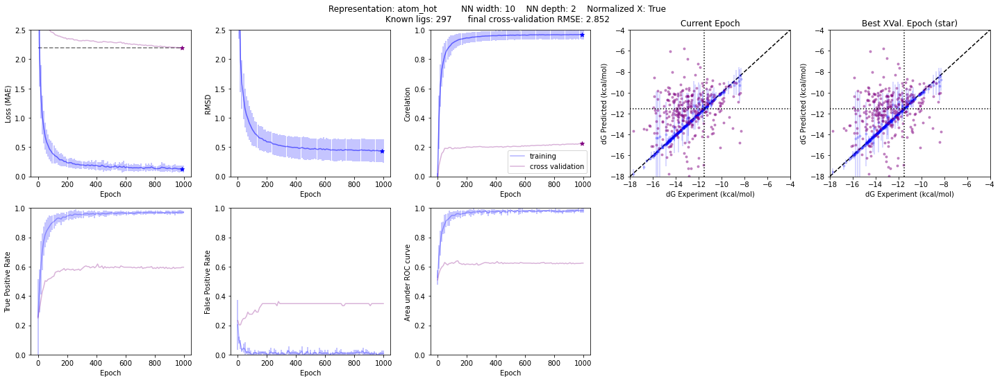

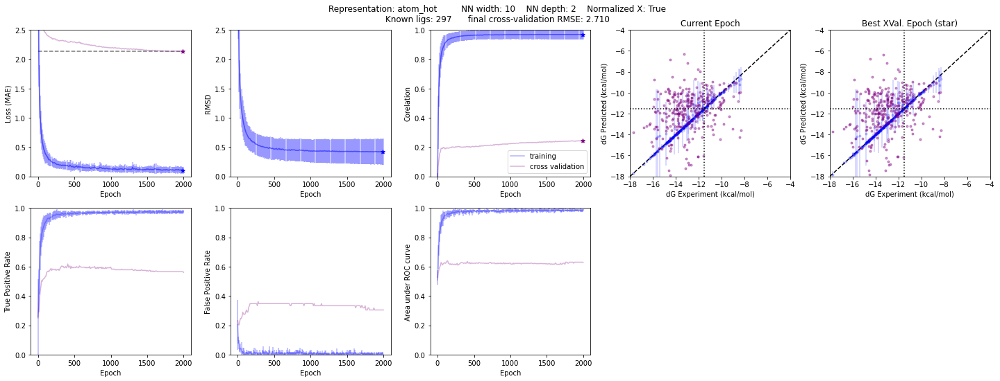

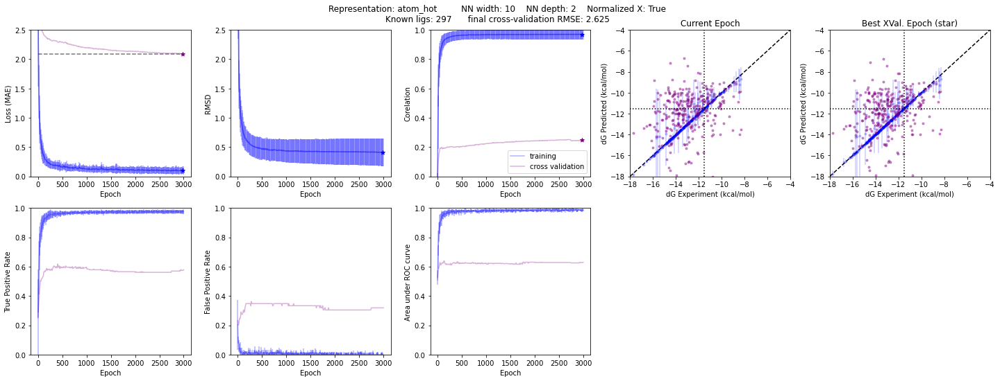

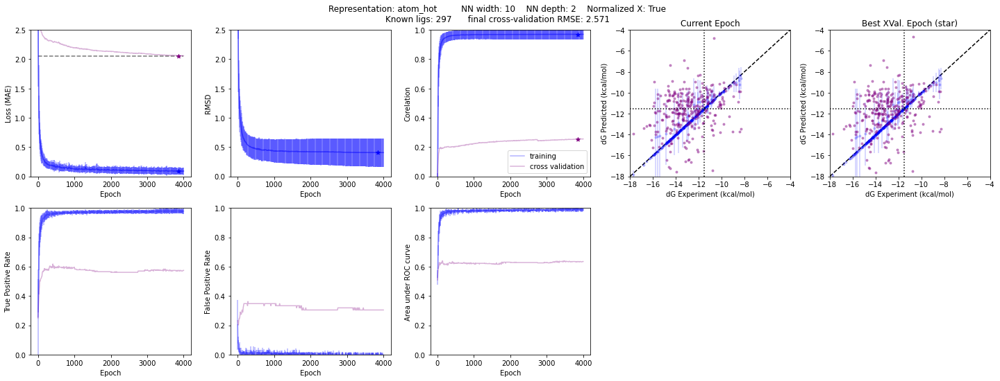

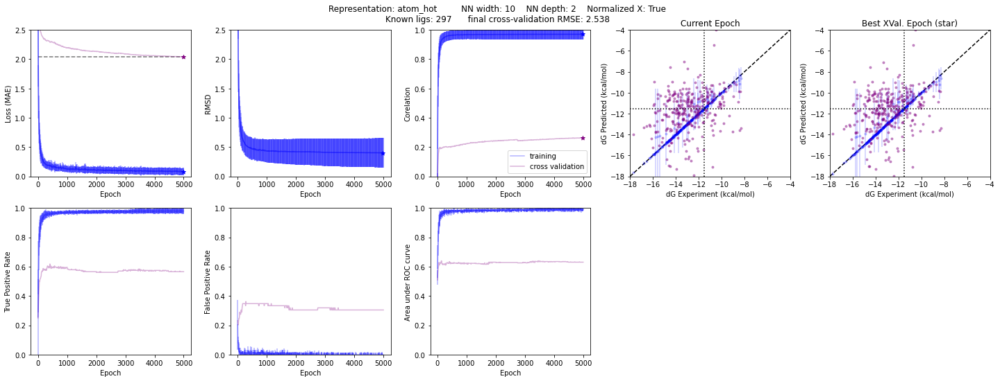

...

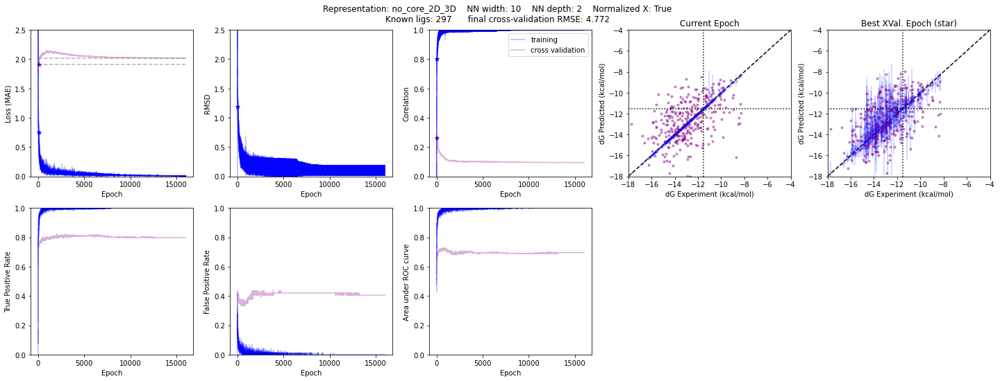

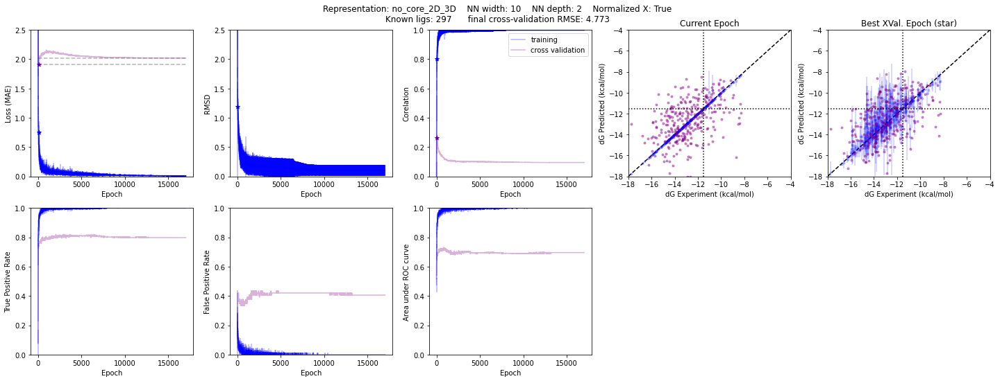

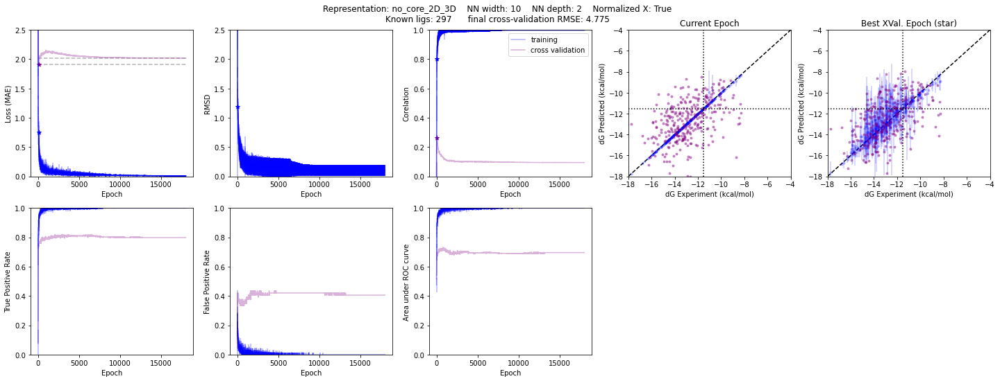

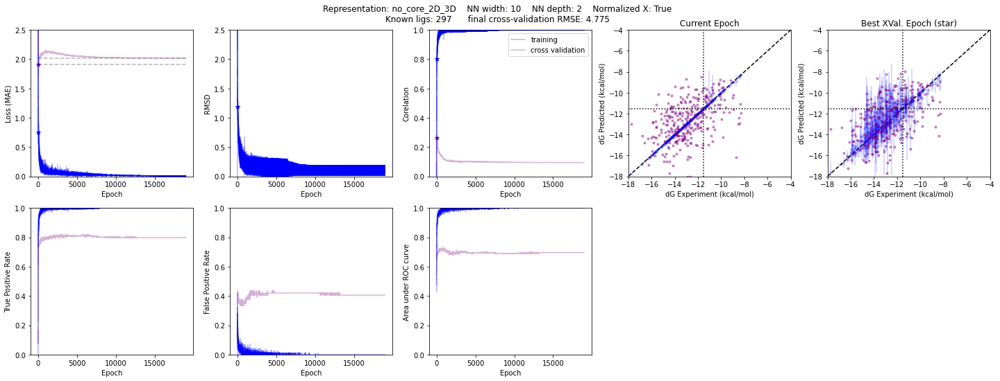

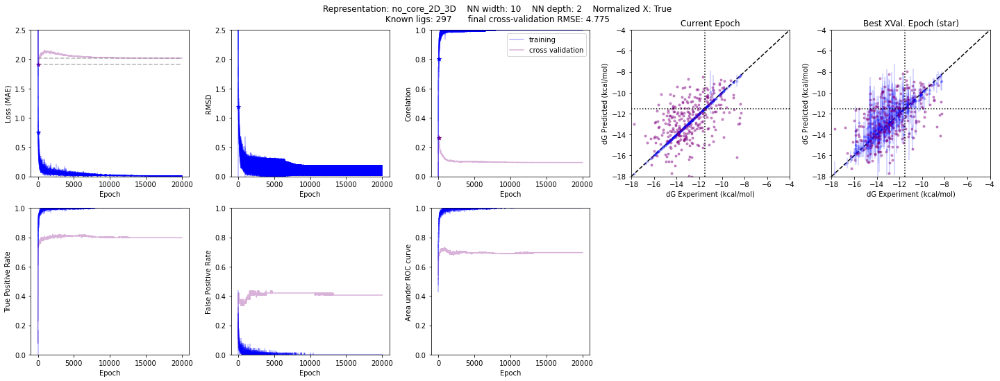

In [18]:
import queue
import threading

previously_done=0
max_debug_evals=10e8

sfiles = next(os.walk(settings_folder), (None, None, []))[2]  # [] if no file
sfiles=[f for f in sfiles if f[0]!='.'] # skip hidden files like .directory

q = queue.Queue()
for f in tqdm(sfiles):
    settings_fname=settings_folder+"/"+f
    with open(settings_fname, 'rb') as f:
        settings_loaded, metrics = pickle.load(f)
        if(metrics is None):
            q.put(settings_fname)
            #print(settings_fname)
            if(q.qsize()>=max_debug_evals):
                break;
        else:
            previously_done+=1

print("previously_done:", previously_done, "\t out of:", len(sfiles), flush=True)
nleft=len(sfiles)-previously_done
nworkers=max(min(30, nleft), 1)
n_per_worker=int(np.ceil(float(nleft)/nworkers))
print("settings left:", nleft, "\t # workers:", nworkers, "\t # settings/worker:", n_per_worker)

# raise()

cwd=folder+"/meta_param_search/local_runs/"
cmd_str=f"source /etc/profile; module load sge; cd {cwd};"
cmd_str_SLURM=f"source /etc/profile; cd {cwd};"

def worker(job_id):
    ligands_str=""
    for l in range(n_per_worker):
        fname = q.get()
        if fname is None:  # EOF?
            break
        ligands_str+=" "+fname
    os.makedirs(cwd, exist_ok=True)
#     jobscript_str=f"""#!/bin/bash

# source ~/.ML_v2_profile

# export NSLOTS=4
# export OMP_NUM_THREADS=$NSLOTS
# export MKL_NUM_THREADS=$NSLOTS

# #echo NHOSTS=$NSLOTS
# #echo OMP_NUM_THREADS=$OMP_NUM_THREADS

# cd {cwd}

# python /home/ykhalak/Projects/ML_dG/pde2_dG/generators/structures/set_4/morphing_annealing_4d09_filtered_subset/prediction_step_1/owl_trainer_w_params.py -v -f {ligands_str} > {cwd}/joblog_{job_id}.log 2>&1

# """
#     jobscript_fn=cwd+"/jobscript_{}".format(job_id)
#     with open(jobscript_fn,"w") as f:
#         f.write(jobscript_str)

#     print("Running job_id", job_id, ligands_str)
#     process = subprocess.Popen(["bash", jobscript_fn], stdout=subprocess.PIPE, stderr=subprocess.STDOUT)
#     outs, _ = process.communicate()
#     print()
#     print(outs.decode('utf-8'))
#     process.wait()
# #     raise()

    train_model_with_settings(ligands_str[1:], False,
                              torch.device("cpu"), #torch.device("cuda:0"),
                              True, datafolder="/home/ykhalak/Projects/ML_dG/pde2_dG/generators/structures/set_4/morphing_annealing_4d09_filtered_subset/prediction_step_0")
#     raise()

for job_id in range(nworkers):
    q.put(None)
    worker(job_id)

print("Done.")

# submit to owl or moa

In [ ]:
import queue
import threading

previously_done=0
max_debug_evals=10e8

sfiles = next(os.walk(settings_folder), (None, None, []))[2]  # [] if no file
sfiles=[f for f in sfiles if f[0]!='.'] # skip hidden files like .directory

q = queue.Queue()
for f in tqdm(sfiles):
    settings_fname=settings_folder+"/"+f
    with open(settings_fname, 'rb') as f:
        settings_loaded, metrics = pickle.load(f)
        if(metrics is None):
            q.put(settings_fname)
            #print(settings_fname)
            if(q.qsize()>=max_debug_evals):
                break;
        else:
            previously_done+=1

print("previously_done:", previously_done, "\t out of:", len(sfiles), flush=True)
nleft=len(sfiles)-previously_done
nworkers=max(min(30, nleft), 1)
n_per_worker=int(np.ceil(float(nleft)/nworkers))
print("settings left:", nleft, "\t # workers:", nworkers, "\t # settings/worker:", n_per_worker)

# raise()

cwd=folder+"/meta_param_search/jobscripts/"
cmd_str=f"source /etc/profile; module load sge; cd {cwd};"
cmd_str_SLURM=f"source /etc/profile; cd {cwd};"

def worker(job_id):
    ligands_str=""
    for l in range(n_per_worker):
        fname = q.get()
        if fname is None:  # EOF?
            break
        ligands_str+=" "+fname
    os.makedirs(cwd, exist_ok=True)
    jobscript_str=f"""#!/bin/bash
    
#$ -S /bin/bash
#$ -pe openmp_fast 1
#$ -q *
#$ -N pytorch_GPU_worker_{job_id}
#$ -M ykhalak@gwdg.de
#$ -m n
#$ -l h_rt=3:00:00
#$ -wd {cwd}

#SBATCH --job-name=pytorch_SLURM_GPU_worker_{job_id}
#SBATCH --get-user-env
#SBATCH --gres=gpu:1              # number of GPUs requested
#SBATCH --ntasks=1                # Number of MPI process
#SBATCH --cpus-per-task=1         # CPU cores per MPI process
#SBATCH -p p24,p20,p16,p10,p08,p06    # partitions to use
#SBATCH -t 3:00:0                 # hours:min:sec
#SBATCH --chdir={cwd}
#SBATCH -e repr_scan_{job_id}-%j.err
#SBATCH -o repr_scan_{job_id}-%j.out

if [ -n "$NHOSTS" ]; then
    echo "Env. variable NHOSTS found, assuming we are using SGE."
    module load shared                           # access to modules in /cm/shared
else
    echo "Env. variable NHOSTS not set, assuming we are using SLURM."
    export NHOSTS=$SLURM_JOB_NUM_NODES
    export NSLOTS=$SLURM_CPUS_PER_TASK
fi

export OMP_NUM_THREADS=$NSLOTS
export MKL_NUM_THREADS=$NSLOTS

source ~/.ML_v2_profile

cp /home/ykhalak/Projects/ML_dG/pde2_dG/generators/structures/set_4/morphing_annealing_4d09_filtered_subset/prediction_step_0/modular_repr_cache.tar.gz $TMPDIR/.
cd $TMPDIR
tar -zxf modular_repr_cache.tar.gz
cd {cwd}

python /home/ykhalak/Projects/ML_dG/pde2_dG/generators/structures/set_4/morphing_annealing_4d09_filtered_subset/prediction_step_0/repr_scan_step_0_on_preliminary_calc_ddG/owl_trainer_w_params.py -v -f {ligands_str} --datafolder $TMPDIR

"""
    jobscript_fn=cwd+"/jobscript_{}".format(job_id)
    with open(jobscript_fn,"w") as f:
        f.write(jobscript_str)

    global cmd_str, cmd_str_SLURM
    cmd_str+=" qsub {};".format(jobscript_fn)
    cmd_str_SLURM+=" sbatch {};".format(jobscript_fn)

for job_id in range(nworkers):
    q.put(None)
    worker(job_id)
    
#raise()

print("Submitting.")
ssh_cmd_arr=["ssh", "owl", cmd_str]
# ssh_cmd_arr=["ssh", "moa1", cmd_str_SLURM]
process = subprocess.Popen(ssh_cmd_arr, stdout=subprocess.PIPE, stderr=subprocess.STDOUT)
outs, _ = process.communicate()
process.wait()
print('== subprocess exited with rc =', process.returncode)
print(outs.decode('utf-8'))
print("Done.")

# Find the ddG values of the validation ligands

### which ones are the validation ligs?

In [12]:
from rdkit import Chem
from rdkit.Chem import rdRGroupDecomposition as rdRGD
from contextlib import contextmanager,redirect_stderr,redirect_stdout
from os import devnull

@contextmanager
def suppress_stdout_stderr():
    """A context manager that redirects stdout and stderr to devnull"""
    with open(devnull, 'w') as fnull:
        with redirect_stderr(fnull) as err, redirect_stdout(fnull) as out:
            yield (err, out)

core_smiles="c7(C)nc8ccccc8n8c(c6c(Cl)[cH][cH][cH][cH]6)nnc78"
core=Chem.MolFromSmiles(core_smiles)

# find validation and non-validation ligands
training_databse_fn="/home/ykhalak/Projects/ML_dG/pde2_dG//aligned_w_pmx_library_new_structures_similar2xrays.pickle"
with open(training_databse_fn, 'rb') as f:
    expt_ligs = pickle.load(f)
expt_ligs=[l for l in expt_ligs if not("<" in l.GetProp("[Q] hPDE2_pIC50") or ">" in l.GetProp("[Q] hPDE2_pIC50"))]

with suppress_stdout_stderr():
    res,unmatched = rdRGD.RGroupDecompose([core], expt_ligs, asSmiles=True)# print(unmatched)
matched_expt_ligs=[expt_ligs[i] for i in range(len(expt_ligs)) if not i in unmatched]

#filter out H's as R-groups
validation_ligs=[]
for i,l in enumerate(tqdm(res)):
    new_l={}
    for rg in l:
        if rg=='Core':
            continue;
        if l[rg][:3]!='[H]':
            new_l[rg]=l[rg]
    if(len(new_l)==1):
        validation_ligs.append(matched_expt_ligs[i])
print(f"found {len(validation_ligs)} validation ligands")

del expt_ligs, matched_expt_ligs
_=gc.collect()

100%|██████████| 136/136 [00:00<00:00, 285070.14it/s]

found 69 validation ligands


In [13]:
from rdkit.Chem import rdmolops
validation_smiles=[Chem.MolToSmiles(rdmolops.RemoveHs(lig)) for lig in validation_ligs]

validation_ids_in_set4f=[]
validation_ids_in_validation_subset=[]
unmeasured_ids_in_set4f=[]
measured_ids_in_set4f=[]

#load only if not curretly loaded
try:
    ligs_set4f
except NameError:
    with open(all_ligs_db_file, 'rb') as f:
        ligs_set4f = pickle.load(f)

for i,lig in enumerate(tqdm(ligs_set4f)):
    smi=Chem.MolToSmiles(rdmolops.RemoveHs(lig))
    if(smi in validation_smiles):
        validation_ids_in_set4f.append(i)
        j=validation_smiles.index(smi)
        validation_ids_in_validation_subset.append(j)
    elif(not lig.HasProp('dG')):
        unmeasured_ids_in_set4f.append(i)
    else:
        measured_ids_in_set4f.append(i)
        
validation_ids_in_set4f=np.array(validation_ids_in_set4f)
validation_ids_in_validation_subset=np.array(validation_ids_in_validation_subset)
unmeasured_ids_in_set4f=np.array(unmeasured_ids_in_set4f)
measured_ids_in_set4f=np.array(measured_ids_in_set4f)

print(f"found {len(validation_ids_in_set4f)} validation ligands")
print(f"found {len(unmeasured_ids_in_set4f)} unmeasured ligands")
print(f"found {len(measured_ids_in_set4f)} measured ligands")

100%|██████████| 34114/34114 [00:09<00:00, 3663.27it/s]

found 55 validation ligands
found 33762 unmeasured ligands
found 297 measured ligands


### validation ligs experimental values

In [14]:
RT=0.001985875*300 #kcal/mol
validation_dGs=-RT*(np.array([float(validation_ligs[j].GetProp('[V] hPDE2_pIC50')) for j in validation_ids_in_validation_subset ]))*np.log(10) #kcal/mol
print(validation_dGs)

[-12.63422137 -11.94832445 -12.70281106 -12.09922177 -11.72883743
 -11.13896607 -11.75627331 -11.93460651 -11.60537598 -11.35845309
 -11.33101721 -10.933197   -11.31729927 -11.27614546 -10.61768441
 -10.08268481 -11.30358134 -10.80973555 -10.90576112 -13.29268242
 -13.16922097 -12.74396488 -12.33242672 -12.62050343 -12.07178589
 -12.67537519 -11.94832445 -11.90717063 -11.85229888 -10.56281266
 -11.92088857 -11.83858094 -11.1115302  -11.19383783 -10.87832524
 -11.39960691 -11.26242752 -11.24870958 -11.38588897 -11.34473515
 -10.78229967  -9.93178748 -11.33101721 -10.57653059 -11.08409432
 -11.53678629 -11.15268401 -10.48050503 -11.0429405  -10.91947906
 -10.82345349 -10.54909472 -11.45447866 -12.16781146 -11.30358134]


# what has the best XVal RMSE?

100%|██████████| 16/16 [00:00<00:00, 16.47it/s]


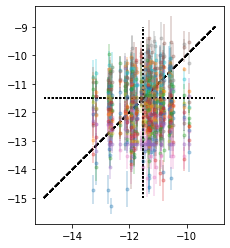

In [19]:
from utils import *
high_binder_cutoff=-5*np.log(10)



traning_RMSE={}
XVals_RMSE={}
XVals_Cor={}
XVals_KT={}
XVals_TPR={}

Val_RMSE={}
Val_Cor={}
Val_KT={}
Val_TPR={}


sfiles = next(os.walk(settings_folder), (None, None, []))[2]  # [] if no file
# old_settings_folder=folder+"/meta_param_search/~settings/"
# sfiles = next(os.walk(old_settings_folder), (None, None, []))[2]  # [] if no file
sfiles=[f for f in sfiles if f[0]!='.'] # skip hidden files like .directory
for fn in tqdm(sfiles):
    settings_fname=settings_folder+"/"+fn
#     settings_fname=old_settings_folder+"/"+fn
    with open(settings_fname, 'rb') as f:
        metrics=None
        try:
            settings_loaded, metrics = pickle.load(f)
        except Exception:
            print(f"problem with {fn}")
        if(metrics is not None):
            if(settings_loaded[5]!=10):
                continue
#                 key=settings_loaded[1]
            key=f"{settings_loaded[1]}_hlw{settings_loaded[5]}"
            bi=np.argmin(metrics.loss_XVal)
            #bi=-1

            XVals_RMSE[key]=metrics.RMSD_XVal[bi]
            traning_RMSE[key]=metrics.RMSD_Train[bi]
            XVals_Cor[key]=metrics.Cor_XVal[bi]
            XVals_KT[key]=metrics.kendalltau_XVal[bi]
            XVals_TPR[key]=metrics.TP_XVal[bi]

            # Find predictions for validation ligands
            val_lig_P = metrics.best_pred[0][validation_ids_in_set4f]
            val_lig_uncert = metrics.best_pred[1][validation_ids_in_set4f]
            
            diag = np.linspace(-15,-9, 10)
            plt.plot(diag, diag, '--k', zorder=0)
            plt.vlines(high_binder_cutoff, -15,-9, colors='k', linestyles='dotted', label='')
            plt.hlines(high_binder_cutoff, -15,-9, colors='k', linestyles='dotted', label='')
            plt.errorbar(validation_dGs, val_lig_P, yerr=val_lig_uncert, marker=".", ls='', alpha=0.3)
            plt.gca().set_aspect('equal', 'box')
            
            # compute metrics for validation ligands
            se = np.square(validation_dGs-val_lig_P)
            Val_RMSE[key] = np.sqrt(np.mean(se))
            Val_Cor[key] = np.corrcoef(validation_dGs, val_lig_P)[0,1]
            Val_KT[key] = sp.stats.kendalltau(validation_dGs, val_lig_P)[0]
            _,Val_TPR[key],_ = get_FPR_TPR_AUC(validation_dGs, val_lig_P, high_binder_cutoff)
#             raise()



In [20]:
sorted_scan=dict(sorted(XVals_RMSE.items(), key=lambda item: item[1]))
#print(sorted_scan)
#print(list(sorted_scan.keys())[0])
#print(sorted_scan[list(sorted_scan.keys())[0]])

sorted_keys=list(sorted_scan.keys())
#print(f"{'REPRESENTATION':^40}\t{'XVal RMSE':^10}\t{'Train RMSE':^10}\t{'XVal Cor':^10}\t{'XVal Ken.-t':^10}\t{'XVal TPR':^10}")
print(f"{'REPRESENTATION':^40}\t{'XVal RMSE':^10}\t{'XVal Cor':^10}\t{'XVal Ken.-t':^10}\t{'XVal TPR':^10}")
#for i in range(min(10,len(sorted_scan))):
for i in range(len(sorted_scan)):
    key=sorted_keys[i]
    #if('hlw10' in key):
    #print(f"{key:40}\t{XVals_RMSE[key]:.4f}\t\t{traning_RMSE[key]:.4f}\t\t{XVals_Cor[key]:.4f}\t\t{XVals_KT[key]:.4f}\t\t{XVals_TPR[key]:.4f}")
    print(f"{key:40}\t{XVals_RMSE[key]:.4f}\t\t{XVals_Cor[key]:.4f}\t\t{XVals_KT[key]:.4f}\t\t{XVals_TPR[key]:.4f}")

             REPRESENTATION             	XVal RMSE 	 XVal Cor 	XVal Ken.-t	 XVal TPR 
2D_3D_hlw10                             	1.9095		0.5180		0.3834		0.7719
atom_hot_hlw10                          	2.4734		0.2773		0.1952		0.5570
no_core_atom_hot_hlw10                  	2.7095		0.2007		0.1633		0.5833
no_core_MDenerg_long_cut_hlw10          	3.1774		0.0631		0.0813		0.6316
MDenerg_long_cut_binned_hlw10           	3.4672		0.0895		0.0915		0.8026
no_core_2D_3D_hlw10                     	3.6370		0.2624		0.3281		0.7456
atom_hot_surf_hlw10                     	3.7051		0.0630		0.1365		0.7018
MDenerg_long_cut_hlw10                  	4.5497		0.0131		0.1155		0.7675
no_core_MDenerg_long_cut_binned_hlw10   	4.6435		0.2097		0.1616		0.7807
PLEC_filtered_hlw10                     	4.6443		-0.0597		-0.0086		0.8333
MDenerg_hlw10                           	5.0490		-0.0831		0.0152		0.6096
no_core_atom_hot_surf_hlw10             	5.3775		0.0763		0.1119		0.7675
MDenerg_binned_hlw10                    	5.5250

In [ ]:
# replace nans with high numbers


## rank by the 4 indicators

In [21]:
sorted_RMSE=dict(sorted(XVals_RMSE.items(), key=lambda item: item[1]))
sorted_Cor= dict(sorted(XVals_Cor.items(), key=lambda item: item[1]))
sorted_KT=  dict(sorted(XVals_KT.items(), key=lambda item: item[1]))
sorted_TPR= dict(sorted(XVals_TPR.items(), key=lambda item: item[1]))

#RMSE
# rank_RMSE={}
# keys=list(sorted_RMSE.keys())
# start_key=keys[0]
# cur_rank=0
# for i in range(len(sorted_RMSE)):
#     key=keys[i]
#     dif=abs(XVals_RMSE[key]-XVals_RMSE[start_key])
#     err=np.sqrt(traning_RMSE[key]**2+traning_RMSE[start_key]**2)
#     if(dif>err):
#         #new rank
#         cur_rank+=1
#         start_key=key
#     rank_RMSE[key]=cur_rank

from sklearn.cluster import KMeans
nranks=5
#def rank_by_kmeans(d, nranks=10):
def rank_by_kmeans(d, nranks=nranks):
    X = np.array([[v[1]] for v in d.items()])
    kmeans = KMeans(n_clusters=nranks, random_state=0).fit(X)
    sorted_cl_ids=np.argsort(kmeans.cluster_centers_.flatten())
    #print(kmeans.cluster_centers_[sorted_cl_ids])
    rank_from_cl_id={}
    for i,j in enumerate(sorted_cl_ids):
        rank_from_cl_id[j]=i
    
    ret={}
    for i,key in enumerate(d.keys()):
        ret[key]=rank_from_cl_id[kmeans.labels_[i]]
    return(ret)

rank_RMSE=rank_by_kmeans(sorted_RMSE)
rank_Cor=rank_by_kmeans(sorted_Cor)
rank_KT=rank_by_kmeans(sorted_KT)
rank_TPR=rank_by_kmeans(sorted_TPR)


rank={}
for key in rank_RMSE.keys():
    rank[key]=rank_RMSE[key]+(nranks-1-rank_Cor[key])+(nranks-1-rank_KT[key])+(nranks-1-rank_TPR[key])

sorted_rank= dict(sorted(rank.items(), key=lambda item: item[1]))
keys=list(sorted_rank.keys())

#print(f"{'RANK':^4}\t{'REPRESENTATION':^40}\t{'XVal RMSE':^10}\t{'Train RMSE':^10}\t{'XVal Cor':^10}\t{'XVal Ken.-t':^10}\t{'XVal TPR':^10}")
print(f"{'RANK':^4}\t{'REPRESENTATION':^40}\t{'XVal RMSE':^10}\t{'XVal Cor':^10}\t{'XVal Ken.-t':^10}\t{'XVal TPR':^10}\t|\t{'Val RMSE':^10}\t{'Val Cor':^10}\t{'Val Ken.-t':^10}\t{'Val TPR':^10}")
for i in range(len(sorted_RMSE)):
    key=keys[i]
    #print(f"{rank[key]:4}\t{key:40}\t{XVals_RMSE[key]:.4f}\t\t{traning_RMSE[key]:.4f}\t\t{XVals_Cor[key]:.4f}\t\t{XVals_KT[key]:.4f}\t\t{XVals_TPR[key]:.4f}")
    #print(f"{rank[key]:4}\t{key:40}\t{XVals_RMSE[key]:.4f}\t\t{XVals_Cor[key]:.4f}\t\t{XVals_KT[key]:.4f}\t\t{XVals_TPR[key]:.4f}")
    r=rank[key]
    print(f"{r:4}\t{key:40}\t{XVals_RMSE[key]:.4f}\t\t{XVals_Cor[key]:.4f}\t\t{XVals_KT[key]:.4f}\t\t{XVals_TPR[key]:.4f}\t\t"+
          f"|\t{Val_RMSE[key]:.4f}\t\t{Val_Cor[key]:.4f}\t\t{Val_KT[key]:.4f}\t\t{Val_TPR[key]:.4f}")

RANK	             REPRESENTATION             	XVal RMSE 	 XVal Cor 	XVal Ken.-t	 XVal TPR 	|	 Val RMSE 	 Val Cor  	Val Ken.-t	 Val TPR  
   2	2D_3D_hlw10                             	1.9095		0.5180		0.3834		0.7719		|	1.0638		0.4928		0.3155		0.1818
   4	no_core_2D_3D_hlw10                     	3.6370		0.2624		0.3281		0.7456		|	1.1036		0.3114		0.2481		0.1818
   6	atom_hot_hlw10                          	2.4734		0.2773		0.1952		0.5570		|	1.0812		0.0924		0.0162		0.0455
   7	no_core_atom_hot_hlw10                  	2.7095		0.2007		0.1633		0.5833		|	1.0581		-0.0628		-0.0634		0.0455
   7	MDenerg_long_cut_binned_hlw10           	3.4672		0.0895		0.0915		0.8026		|	1.3981		-0.1472		-0.1186		0.5909
   7	no_core_MDenerg_long_cut_binned_hlw10   	4.6435		0.2097		0.1616		0.7807		|	0.9976		-0.1400		-0.0971		0.6364
   8	atom_hot_surf_hlw10                     	3.7051		0.0630		0.1365		0.7018		|	1.6567		0.4161		0.2845		0.9091
   8	no_core_MDenerg_binned_hlw10            	5.8986		0.0812		0.2544		0.7895		|	

# Select step_2 ligands
Use hlw=10, depth=2. Top 5 representations are:
<pre>
RANK	             REPRESENTATION             	XVal RMSE 	 XVal Cor 	XVal Ken.-t	 XVal TPR 	|	 Val RMSE 	 Val Cor  	Val Ken.-t	 Val TPR  
   2	2D_3D_hlw10                             	1.9095		0.5180		0.3834		0.7719		|	1.0638		0.4928		0.3155		0.1818
   4	no_core_2D_3D_hlw10                     	3.6370		0.2624		0.3281		0.7456		|	1.1036		0.3114		0.2481		0.1818
   6	atom_hot_hlw10                          	2.4734		0.2773		0.1952		0.5570		|	1.0812		0.0924		0.0162		0.0455
   7	no_core_atom_hot_hlw10                  	2.7095		0.2007		0.1633		0.5833		|	1.0581		-0.0628		-0.0634		0.0455
   7	MDenerg_long_cut_binned_hlw10           	3.4672		0.0895		0.0915		0.8026		|	1.3981		-0.1472		-0.1186		0.5909
</pre>

In [22]:
best_keys=['2D_3D_hlw10', '', 'no_core_2D_3D_hlw10', 'atom_hot_hlw10', 'no_core_atom_hot_hlw10', 'MDenerg_long_cut_binned_hlw10']
print(best_keys)

['2D_3D_hlw10', '', 'no_core_2D_3D_hlw10', 'atom_hot_hlw10', 'no_core_atom_hot_hlw10', 'MDenerg_long_cut_binned_hlw10']


In [23]:
sfiles = next(os.walk(settings_folder), (None, None, []))[2]  # [] if no file
sfiles=[f for f in sfiles if f[0]!='.'] # skip hidden files like .directory

new_lig_ids=[]
for fn in tqdm(sfiles):
    settings_fname=settings_folder+"/"+fn
    with open(settings_fname, 'rb') as f:
        metrics=None
        try:
            settings_loaded, metrics = pickle.load(f)
        except Exception:
            print(f"problem with {fn}")
        if(metrics is not None):
            key=f"{settings_loaded[1]}_hlw{settings_loaded[5]}"
            if(key in best_keys):
                print(key)
                unmeasured_P = metrics.best_pred[0][unmeasured_ids_in_set4f]
                unmeasured_uncert = metrics.best_pred[1][unmeasured_ids_in_set4f]
                
                sorted_unmeasured_ids=unmeasured_ids_in_set4f[np.argsort(unmeasured_P)]
#                 print(metrics.best_pred[0][sorted_unmeasured_ids[:20]])
                selected=0
                n=0
                attempted_duplicates=0
                attempted_duplicates_by_repr=[0 for i in range(5)]
                while selected<20 and n<len(sorted_unmeasured_ids):
                    if(sorted_unmeasured_ids[n] not in new_lig_ids):
                        new_lig_ids.append(sorted_unmeasured_ids[n])
                        selected+=1
                    else:
                        attempted_duplicates+=1
                        prev_repr=int(np.floor(new_lig_ids.index(sorted_unmeasured_ids[n])/20))
                        attempted_duplicates_by_repr[prev_repr]+=1
                    n+=1
                print(len(new_lig_ids), attempted_duplicates, attempted_duplicates_by_repr)
#                 raise()


100%|██████████| 16/16 [00:00<00:00, 85.54it/s]

atom_hot_hlw10
20 0 [0, 0, 0, 0, 0]
MDenerg_long_cut_binned_hlw10
40 0 [0, 0, 0, 0, 0]
2D_3D_hlw10
60 0 [0, 0, 0, 0, 0]
no_core_atom_hot_hlw10
80 5 [5, 0, 0, 0, 0]
no_core_2D_3D_hlw10
100 2 [2, 0, 0, 0, 0]


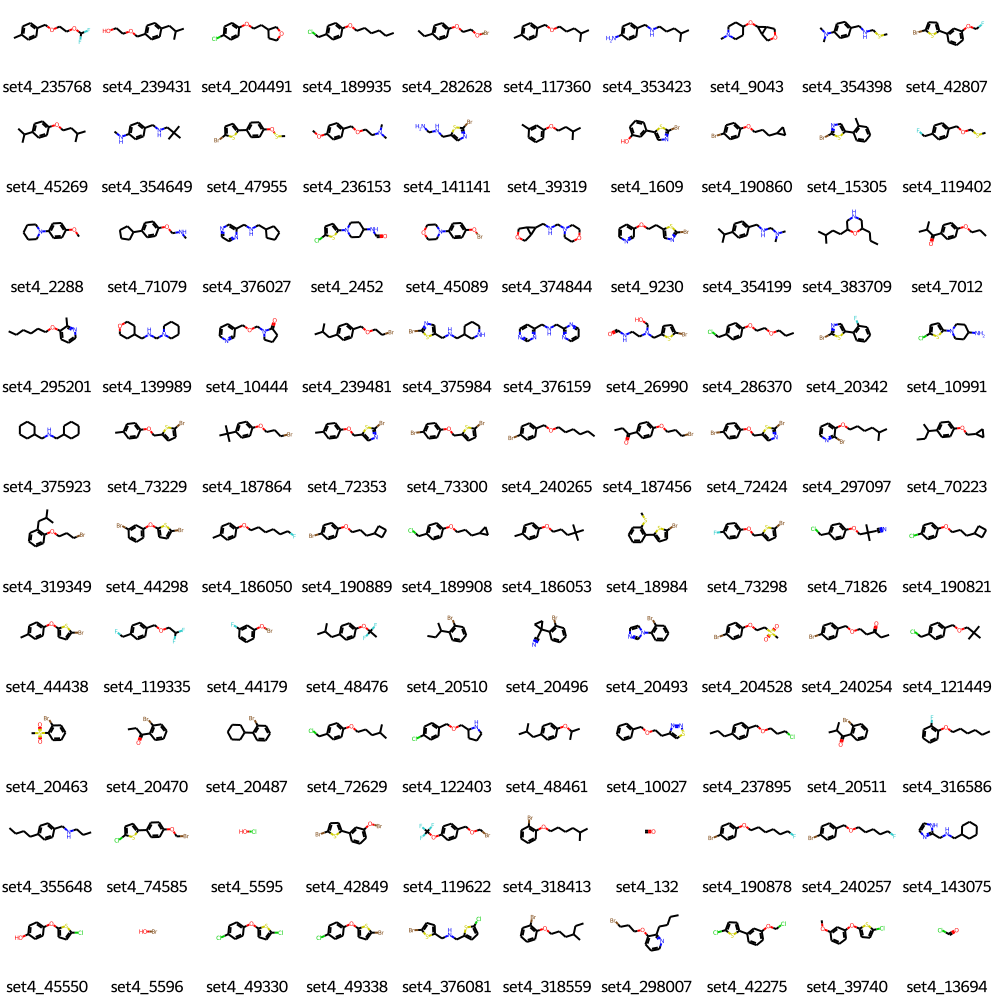

In [24]:
all_ligs_db_file=f"{pocket_fit_folder}/filtered_subset_without_weird_chemistry_with_2D_no_core_tSNE_and_step2_dG.pickle"
all_no_core_ligs_db_file=f"{pocket_fit_folder}/filtered_subset_without_weird_chemistry_no_core_ligs_with_step2_dG.pickle"

with open(all_ligs_db_file, 'rb') as f:
    ligs_set4f = pickle.load(f)
    
with open(all_no_core_ligs_db_file, 'rb') as f:
    no_core_ligs_set4f = pickle.load(f)


selected_ligs=[ligs_set4f[i] for i in new_lig_ids]
legends=[f"{l.GetProp('ID')}" for l in selected_ligs]

selected_RGroups=[Chem.MolFromSmiles(Chem.MolToSmiles(no_core_ligs_set4f[i])) for i in new_lig_ids]
Draw.MolsToGridImage(selected_RGroups, legends=legends,
                     subImgSize = (100,100), molsPerRow=10, maxMols=100)


In [25]:
with open( pocket_fit_folder+"/step_3_picks.pickle", "wb" ) as f:
    pickle.dump(selected_ligs, f)

In [26]:
del all_ligs_db_file, all_no_core_ligs_db_file
_=gc.collect()

# Validation accuracy history so far

In [27]:
from rdkit.Chem import rdmolops
validation_smiles=[Chem.MolToSmiles(rdmolops.RemoveHs(lig)) for lig in validation_ligs]

validation_ids_in_set4f=[]
validation_ids_in_validation_subset=[]
unmeasured_ids_in_set4f=[]
measured_ids_in_set4f=[]

#load only if not curretly loaded
try:
    ligs_set4f
except NameError:
    with open(all_ligs_db_file, 'rb') as f:
        ligs_set4f = pickle.load(f)

for i,lig in enumerate(tqdm(ligs_set4f)):
    smi=Chem.MolToSmiles(rdmolops.RemoveHs(lig))
    if(smi in validation_smiles):
        validation_ids_in_set4f.append(i)
        j=validation_smiles.index(smi)
        validation_ids_in_validation_subset.append(j)
    elif(not lig.HasProp('dG')):
        unmeasured_ids_in_set4f.append(i)
    else:
        measured_ids_in_set4f.append(i)
        
validation_ids_in_set4f=np.array(validation_ids_in_set4f)
validation_ids_in_validation_subset=np.array(validation_ids_in_validation_subset)
unmeasured_ids_in_set4f=np.array(unmeasured_ids_in_set4f)
measured_ids_in_set4f=np.array(measured_ids_in_set4f)

print(f"found {len(validation_ids_in_set4f)} validation ligands")
print(f"found {len(unmeasured_ids_in_set4f)} unmeasured ligands")
print(f"found {len(measured_ids_in_set4f)} measured ligands")

RT=0.001985875*300 #kcal/mol
validation_dGs=-RT*(np.array([float(validation_ligs[j].GetProp('[V] hPDE2_pIC50')) for j in validation_ids_in_validation_subset ]))*np.log(10) #kcal/mol

100%|██████████| 34114/34114 [00:09<00:00, 3516.90it/s]

found 55 validation ligands
found 33762 unmeasured ligands
found 297 measured ligands


### verify that validation ligand indeces are correct

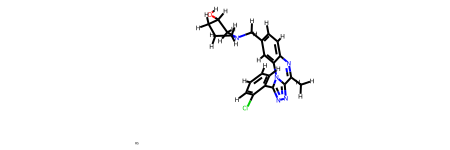

In [88]:
validation_ligs[validation_ids_in_validation_subset[10]]

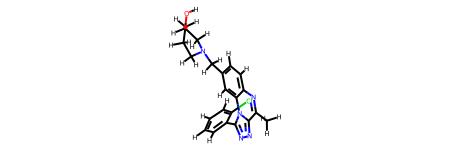

In [87]:
ligs_set4f[validation_ids_in_set4f[10]]

### Load the data for models across multiple steps

In [37]:
if(not f"{pocket_fit_folder}/prediction_step_1/" in sys.path ):
    sys.path.append(f"{pocket_fit_folder}/prediction_step_1/")    

In [41]:
steps_folders=[
    f"{pocket_fit_folder}/prediction_step_0/repr_scan_step_0_on_preliminary_calc_ddG/meta_param_search/settings",
    f"{pocket_fit_folder}/prediction_step_1/meta_param_search/settings",
    f"{pocket_fit_folder}/prediction_step_2/meta_param_search/settings",
]

knownligs_by_step=[99,198,297]

import pandas as pd
df = pd.DataFrame()

# sfiles = next(os.walk(steps_folders[-1]), (None, None, []))[2]  # [] if no file
# sfiles=[f for f in sfiles if f[0]!='.'] # skip hidden files like .directory

Val_RMSE_hist={}
Val_Cor_hist={}
Val_KT_hist={}
Val_TPR_hist={}

known_ligs_hist={}

for step in range(len(steps_folders)):
    sfiles = next(os.walk(steps_folders[step]), (None, None, []))[2]  # [] if no file
    sfiles=[f for f in sfiles if f[0]!='.'] # skip hidden files like .directory
    for fn in sfiles:
        fold=steps_folders[step]
        settings_fname=fold+"/"+fn
        with open(settings_fname, 'rb') as f:
            metrics=None
            try:
                settings_loaded, metrics = pickle.load(f)
            except Exception as e:
                print(f"problem with {fn}")
                raise(e)
            if(metrics is not None):
                if(settings_loaded[5]!=10):
                    continue
                key=f"{settings_loaded[1]}_hlw{settings_loaded[5]}"
                bi=np.argmin(metrics.loss_XVal)
                
                # Find predictions for validation ligands
                val_lig_P = metrics.best_pred[0][validation_ids_in_set4f]
                val_lig_uncert = metrics.best_pred[1][validation_ids_in_set4f]
                
                if(not key in Val_RMSE_hist):
                    Val_RMSE_hist[key]=[]
                    Val_Cor_hist[key]=[]
                    Val_KT_hist[key]=[]
                    Val_TPR_hist[key]=[]
                    known_ligs_hist[key]=[]

                # compute metrics for validation ligands
                se = np.square(validation_dGs-val_lig_P)
                Val_RMSE_hist[key].append(np.sqrt(np.mean(se)))
                Val_Cor_hist[key].append( np.corrcoef(validation_dGs, val_lig_P)[0,1] )
                Val_KT_hist[key].append( sp.stats.kendalltau(validation_dGs, val_lig_P)[0])
                Val_TPR_hist[key].append( get_FPR_TPR_AUC(validation_dGs, val_lig_P, high_binder_cutoff)[1])
                
                known_ligs_hist[key].append(knownligs_by_step[step])
    #             raise()
    




## Plot everything in one figure

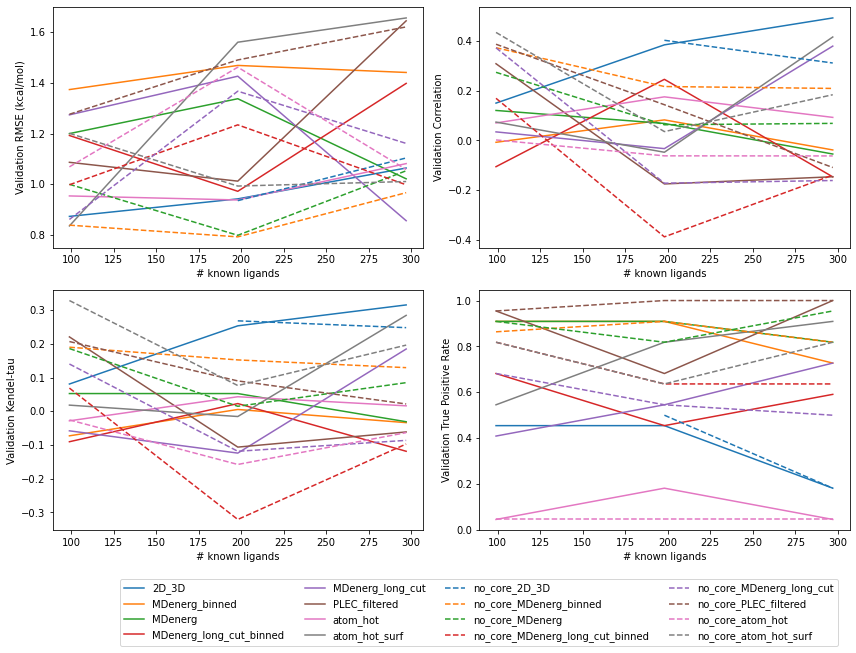

In [96]:
fig, axs = plt.subplots(2, 2, figsize=[12, 8], facecolor='w')
# fig, axs = plt.subplots(2, 2)

plt.sca(axs[0,0])
plt.xlabel("# known ligands")
plt.ylabel("Validation RMSE (kcal/mol)")
cnum=0
for key in sorted(Val_RMSE_hist.keys()):
    ls="solid"
    if("no_core" in key):
        ls="dashed"
    if(cnum>=len(Val_RMSE_hist.keys())/2):
        cnum=0
    
    plt.plot(known_ligs_hist[key], Val_RMSE_hist[key], label=key[:-6], linestyle=ls, c=f"C{cnum}")
    cnum+=1
    
plt.sca(axs[0,1])
plt.xlabel("# known ligands")
plt.ylabel("Validation Correlation")
cnum=0
for key in sorted(Val_RMSE_hist.keys()):
    ls="solid"
    if("no_core" in key):
        ls="dashed"
    if(cnum>=len(Val_RMSE_hist.keys())/2):
        cnum=0
    
    plt.plot(known_ligs_hist[key], Val_Cor_hist[key], label=key[:-6], linestyle=ls, c=f"C{cnum}")
    cnum+=1

plt.sca(axs[1,0])
plt.xlabel("# known ligands")
plt.ylabel("Validation Kendel-tau")
cnum=0
for key in sorted(Val_RMSE_hist.keys()):
    ls="solid"
    if("no_core" in key):
        ls="dashed"
    if(cnum>=len(Val_RMSE_hist.keys())/2):
        cnum=0
    
    plt.plot(known_ligs_hist[key], Val_KT_hist[key], label=key[:-6], linestyle=ls, c=f"C{cnum}")
    cnum+=1
    
plt.sca(axs[1,1])
plt.xlabel("# known ligands")
plt.ylabel("Validation True Poisitive Rate")
cnum=0
for key in sorted(Val_RMSE_hist.keys()):
    ls="solid"
    if("no_core" in key):
        ls="dashed"
    if(cnum>=len(Val_RMSE_hist.keys())/2):
        cnum=0
    
    plt.plot(known_ligs_hist[key], Val_TPR_hist[key], label=key[:-6], linestyle=ls, c=f"C{cnum}")
    cnum+=1


plt.tight_layout()

plt.legend(loc='lower center', bbox_to_anchor=(0, -0.5), ncol=4)
plt.show()

## Separate into core and no_core figures
Also add a line with target accuracy (best representation model trained on validation ligands)
<pre>
             REPRESENTATION             	XVal RMSE 	 XVal Cor 	XVal Ken.-t	 XVal TPR 
2D_3D_hlw10                             	0.5748		0.6381		0.4812		0.5455
</pre>

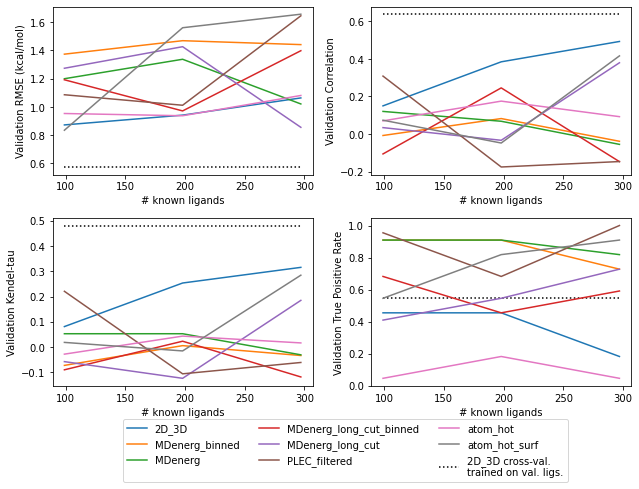

In [118]:
fig, axs = plt.subplots(2, 2, figsize=[9, 6], facecolor='w')
# fig, axs = plt.subplots(2, 2)

plt.sca(axs[0,0])
plt.xlabel("# known ligands")
plt.ylabel("Validation RMSE (kcal/mol)")
cnum=0
for key in sorted(Val_RMSE_hist.keys()):
    ls="solid"
    if("no_core" in key):
        ls="dashed"
        continue
    if(cnum>=len(Val_RMSE_hist.keys())/2):
        cnum=0
    
    plt.plot(known_ligs_hist[key], Val_RMSE_hist[key], label=key[:-6], linestyle=ls, c=f"C{cnum}")
    cnum+=1
plt.hlines(0.5748, min(knownligs_by_step), max(knownligs_by_step), colors="black", linestyles='dotted')
    
    
plt.sca(axs[0,1])
plt.xlabel("# known ligands")
plt.ylabel("Validation Correlation")
cnum=0
for key in sorted(Val_RMSE_hist.keys()):
    ls="solid"
    if("no_core" in key):
        ls="dashed"
        continue
    if(cnum>=len(Val_RMSE_hist.keys())/2):
        cnum=0
    
    plt.plot(known_ligs_hist[key], Val_Cor_hist[key], label=key[:-6], linestyle=ls, c=f"C{cnum}")
    cnum+=1
plt.hlines(0.6381, min(knownligs_by_step), max(knownligs_by_step), colors="black", linestyles='dotted')

plt.sca(axs[1,0])
plt.xlabel("# known ligands")
plt.ylabel("Validation Kendel-tau")
cnum=0
for key in sorted(Val_RMSE_hist.keys()):
    ls="solid"
    if("no_core" in key):
        ls="dashed"
        continue
    if(cnum>=len(Val_RMSE_hist.keys())/2):
        cnum=0
    
    plt.plot(known_ligs_hist[key], Val_KT_hist[key], label=key[:-6], linestyle=ls, c=f"C{cnum}")
    cnum+=1
plt.hlines(0.4812, min(knownligs_by_step), max(knownligs_by_step), colors="black", linestyles='dotted')
    
plt.sca(axs[1,1])
plt.xlabel("# known ligands")
plt.ylabel("Validation True Poisitive Rate")
cnum=0
for key in sorted(Val_RMSE_hist.keys()):
    ls="solid"
    if("no_core" in key):
        ls="dashed"
        continue
    if(cnum>=len(Val_RMSE_hist.keys())/2):
        cnum=0
    
    plt.plot(known_ligs_hist[key], Val_TPR_hist[key], label=key[:-6], linestyle=ls, c=f"C{cnum}")
    cnum+=1
plt.hlines(0.5455, min(knownligs_by_step), max(knownligs_by_step), colors="black", linestyles='dotted', label='2D_3D cross-val.\ntrained on val. ligs.')


plt.tight_layout()

plt.legend(loc='lower center', bbox_to_anchor=(-0.1, -0.6), ncol=3)
plt.show()

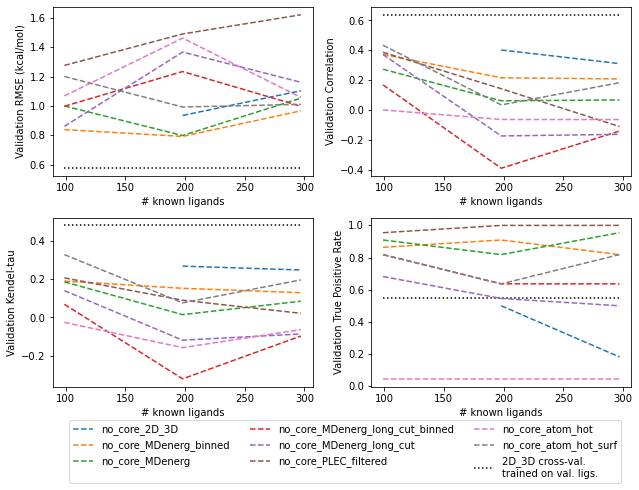

In [119]:
fig, axs = plt.subplots(2, 2, figsize=[9, 6], facecolor='w')
# fig, axs = plt.subplots(2, 2)

plt.sca(axs[0,0])
plt.xlabel("# known ligands")
plt.ylabel("Validation RMSE (kcal/mol)")
cnum=0
for key in sorted(Val_RMSE_hist.keys()):
    ls="dashed"
    if(not "no_core" in key):
        continue
    if(cnum>=len(Val_RMSE_hist.keys())/2):
        cnum=0
    
    plt.plot(known_ligs_hist[key], Val_RMSE_hist[key], label=key[:-6], linestyle=ls, c=f"C{cnum}")
    cnum+=1
plt.hlines(0.5748, min(knownligs_by_step), max(knownligs_by_step), colors="black", linestyles='dotted')
    
plt.sca(axs[0,1])
plt.xlabel("# known ligands")
plt.ylabel("Validation Correlation")
cnum=0
for key in sorted(Val_RMSE_hist.keys()):
    ls="dashed"
    if(not "no_core" in key):
        continue
    if(cnum>=len(Val_RMSE_hist.keys())/2):
        cnum=0
    
    plt.plot(known_ligs_hist[key], Val_Cor_hist[key], label=key[:-6], linestyle=ls, c=f"C{cnum}")
    cnum+=1
plt.hlines(0.6381, min(knownligs_by_step), max(knownligs_by_step), colors="black", linestyles='dotted')

plt.sca(axs[1,0])
plt.xlabel("# known ligands")
plt.ylabel("Validation Kendel-tau")
cnum=0
for key in sorted(Val_RMSE_hist.keys()):
    ls="dashed"
    if(not "no_core" in key):
        continue
    if(cnum>=len(Val_RMSE_hist.keys())/2):
        cnum=0
    
    plt.plot(known_ligs_hist[key], Val_KT_hist[key], label=key[:-6], linestyle=ls, c=f"C{cnum}")
    cnum+=1
plt.hlines(0.4812, min(knownligs_by_step), max(knownligs_by_step), colors="black", linestyles='dotted')
    
plt.sca(axs[1,1])
plt.xlabel("# known ligands")
plt.ylabel("Validation True Poisitive Rate")
cnum=0
for key in sorted(Val_RMSE_hist.keys()):
    ls="dashed"
    if(not "no_core" in key):
        continue
    if(cnum>=len(Val_RMSE_hist.keys())/2):
        cnum=0
    
    plt.plot(known_ligs_hist[key], Val_TPR_hist[key], label=key[:-6], linestyle=ls, c=f"C{cnum}")
    cnum+=1
plt.hlines(0.5455, min(knownligs_by_step), max(knownligs_by_step), colors="black", linestyles='dotted', label='2D_3D cross-val.\ntrained on val. ligs.')


plt.tight_layout()

plt.legend(loc='lower center', bbox_to_anchor=(-0.1, -0.6), ncol=3)
plt.show()